# CUDA GPU Environment

In [62]:
!nvidia-smi

Thu Feb 27 16:59:15 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.120                Driver Version: 550.120        CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce RTX 3050 ...    Off |   00000000:01:00.0  On |                  N/A |
| N/A   45C    P8             12W /   80W |     691MiB /   4096MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [63]:
import torch
print("CUDA Available:", torch.cuda.is_available())
print("CUDA Version:", torch.version.cuda)
print("GPU Count:", torch.cuda.device_count())
print("GPU Name:", torch.cuda.get_device_name(0) if torch.cuda.is_available() else "No GPU")

CUDA Available: True
CUDA Version: 12.6
GPU Count: 1
GPU Name: NVIDIA GeForce RTX 3050 Laptop GPU


# Dependencies

In [64]:
import pdb
import matplotlib.pyplot as plt

from torch.utils.data import DataLoader
from torch import nn
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from tqdm.auto import tqdm

# Visualization function

In [65]:
def show(tensor, ch=1, size=(28,28), num=16):
    # tensor.shape = (128, 784)
    data = tensor.detach().cpu().view(-1, ch, *size) # 128 x 1 x 28 x 28
    grid = make_grid(data[:num], nrow=4).permute(1, 2, 0) # 1 x 28 x 28
    plt.imshow(grid)
    plt.show()

# Setup of the main parameters and hyperparameters

In [76]:
epochs = 500
cur_step = 0
info_step = 300
mean_gen_loss = 0
mean_disc_loss = 0
z_dim = 64
lr = 0.00001
loss_func = nn.BCEWithLogitsLoss()
bs = 128
device = "cuda"
data_loader = DataLoader(MNIST(".", 
                               download=True, 
                               transform=transforms.ToTensor()),
                         shuffle=True,
                         batch_size=bs)

# Number of steps = 60000 / 128 = 468.75

# Generator

In [67]:
class Generator(nn.Module):
    def __init__(self, z_dim, h_dim=128, i_dim=784):
        super().__init__()
        self.gen = nn.Sequential(
            genBlock(z_dim, h_dim), # 64, 128
            genBlock(h_dim, h_dim*2), # 128, 256
            genBlock(h_dim*2, h_dim*4), # 256, 512
            genBlock(h_dim*4, h_dim*8), # 512, 1024
            nn.Linear(h_dim*8, i_dim), # 1024, 784
            nn.Sigmoid()
        )

    def forward(self, noise):
        return self.gen(noise)

def genBlock(input, output):
    return nn.Sequential(
        nn.Linear(input, output),
        nn.BatchNorm1d(output),
        nn.ReLU(inplace=True)
    )

def genNoise(num, z_dim):
    return torch.randn(num, z_dim).to(device)

# Discriminator

In [68]:
class Discriminator(nn.Module):
    def __init__(self, i_dim=784, h_dim=256):
        super().__init__()
        self.disc = nn.Sequential(
            discBlock(i_dim, h_dim*4), # 784, 1024
            discBlock(h_dim*4, h_dim*2), # 1024, 512
            discBlock(h_dim*2, h_dim), # 512, 256
            nn.Linear(h_dim, 1) # 256, 1
        )

    def forward(self, img):
        return self.disc(img)

def discBlock(input, output):
    return nn.Sequential(
        nn.Linear(input, output),
        nn.LeakyReLU(0.2)
    )

# Models

In [78]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator().to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

In [70]:
gen

Generator(
  (gen): Sequential(
    (0): Sequential(
      (0): Linear(in_features=64, out_features=128, bias=True)
      (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (1): Sequential(
      (0): Linear(in_features=128, out_features=256, bias=True)
      (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (2): Sequential(
      (0): Linear(in_features=256, out_features=512, bias=True)
      (1): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (3): Sequential(
      (0): Linear(in_features=512, out_features=1024, bias=True)
      (1): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (4): Linear(in_features=1024, out_features=784, bias=True)
    (5): Sigmoid()
  )
)

In [71]:
disc

Discriminator(
  (disc): Sequential(
    (0): Sequential(
      (0): Linear(in_features=784, out_features=1024, bias=True)
      (1): LeakyReLU(negative_slope=0.2)
    )
    (1): Sequential(
      (0): Linear(in_features=1024, out_features=512, bias=True)
      (1): LeakyReLU(negative_slope=0.2)
    )
    (2): Sequential(
      (0): Linear(in_features=512, out_features=256, bias=True)
      (1): LeakyReLU(negative_slope=0.2)
    )
    (3): Linear(in_features=256, out_features=1, bias=True)
  )
)

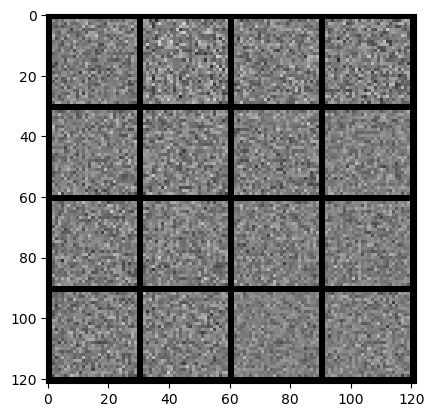

In [72]:
x, y = next(iter(data_loader))
noise = genNoise(bs, z_dim)
fake = gen(noise)
show(fake)

In [73]:
print(f"x shape: {x.shape} \ny shape: {y.shape}")
print("y[:10] = ", y[:10])

x shape: torch.Size([128, 1, 28, 28]) 
y shape: torch.Size([128])
y[:10] =  tensor([6, 7, 9, 5, 3, 1, 6, 5, 0, 8])


# Calculating the loss

In [74]:
def calc_gen_loss(loss_func, gen, disc, num, z_dim):
    noise = genNoise(num, z_dim)
    fake = gen(noise)
    pred = disc(fake)
    targets = torch.ones_like(pred)
    gen_loss = loss_func(pred, targets)

    return gen_loss

def clac_disc_loss(loss_func, gen, disc, num, real, z_dim):
    noise = genNoise(num, z_dim)
    fake = gen(noise)
    
    disc_fake = disc(fake.detach())
    disc_fake_targets = torch.zeros_like(disc_fake)
    disc_fake_loss = loss_func(disc_fake, disc_fake_targets)
    
    disc_real = disc(real)
    disc_real_targets = torch.ones_like(disc_real)
    disc_real_loss = loss_func(disc_real, disc_real_targets)
    
    disc_loss = (disc_fake_loss + disc_real_loss) / 2
    return disc_loss

# Training loop

  0%|          | 0/469 [00:00<?, ?it/s]

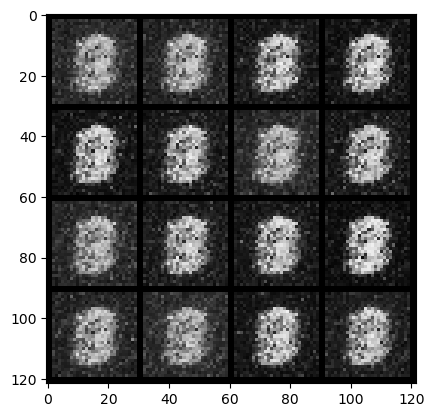

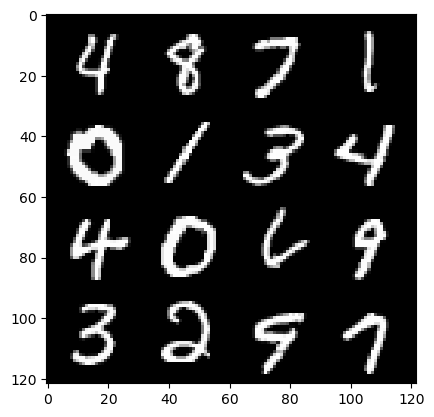

epoch: 0, step: 300, gen loss: 1.9218775987625112, disc loss: 0.34735204870502184.


  0%|          | 0/469 [00:00<?, ?it/s]

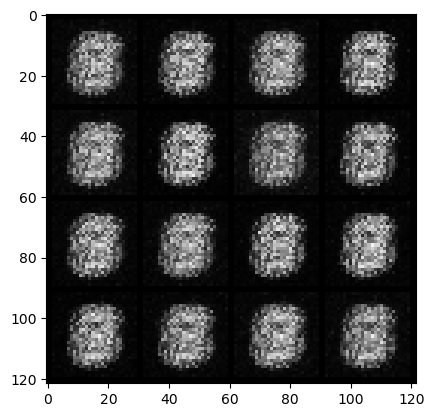

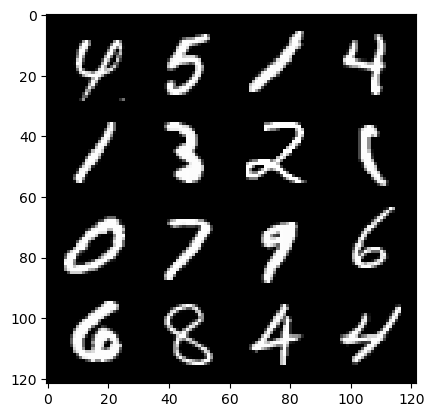

epoch: 1, step: 600, gen loss: 3.4367958641052225, disc loss: 0.1164537315318983.


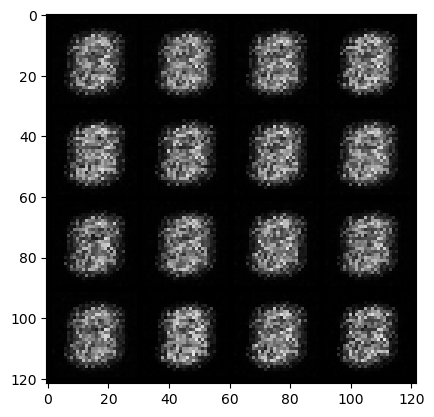

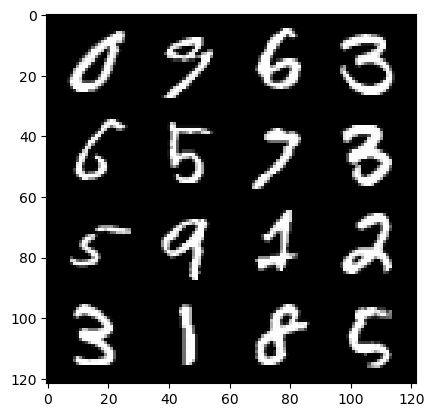

epoch: 1, step: 900, gen loss: 3.5123932139078753, disc loss: 0.050010971911251575.


  0%|          | 0/469 [00:00<?, ?it/s]

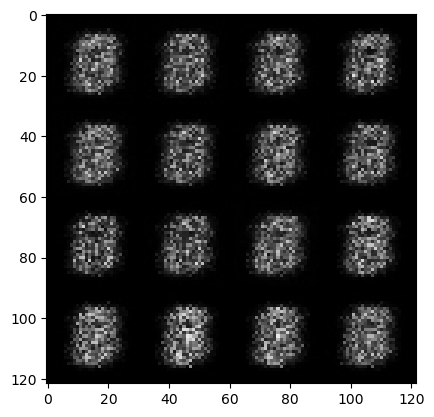

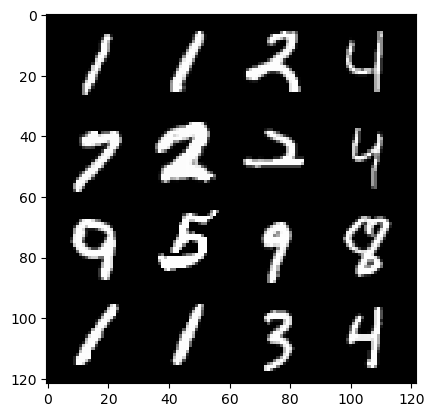

epoch: 2, step: 1200, gen loss: 3.591100811958316, disc loss: 0.03507251378769678.


  0%|          | 0/469 [00:00<?, ?it/s]

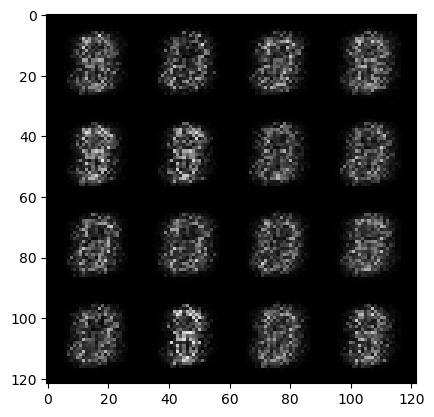

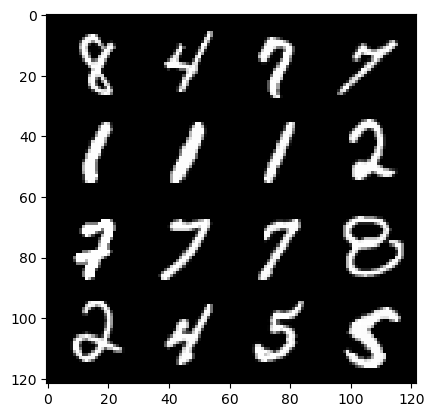

epoch: 3, step: 1500, gen loss: 3.4226118803024286, disc loss: 0.042903901543468244.


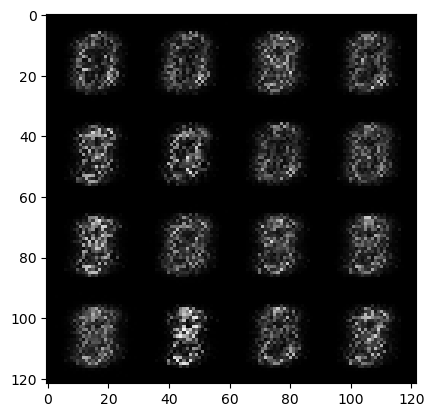

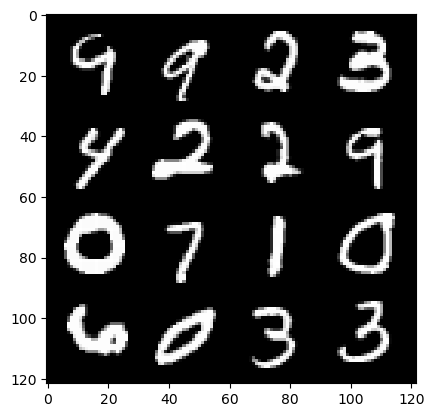

epoch: 3, step: 1800, gen loss: 3.3733885963757815, disc loss: 0.052562567020456.


  0%|          | 0/469 [00:00<?, ?it/s]

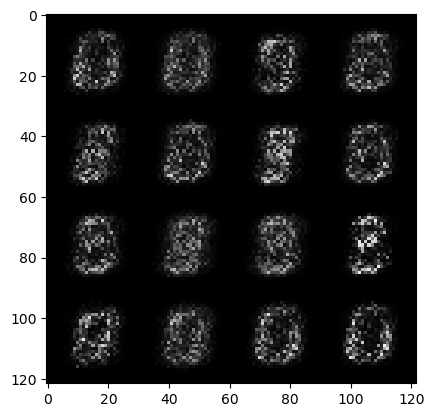

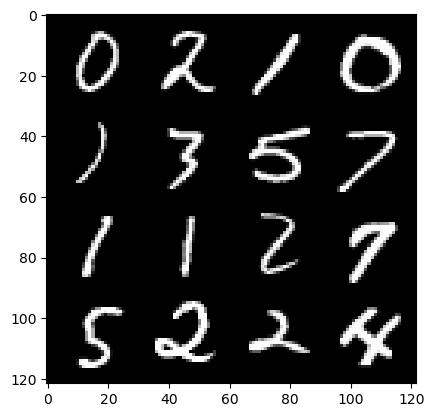

epoch: 4, step: 2100, gen loss: 3.506303189595539, disc loss: 0.052126834802329554.


  0%|          | 0/469 [00:00<?, ?it/s]

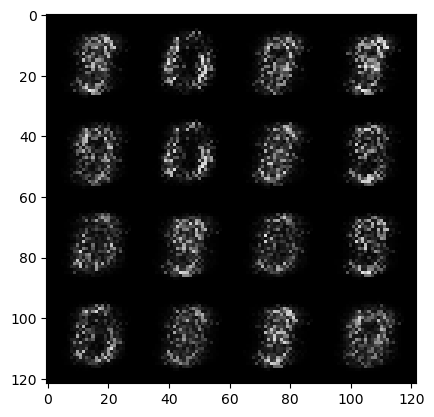

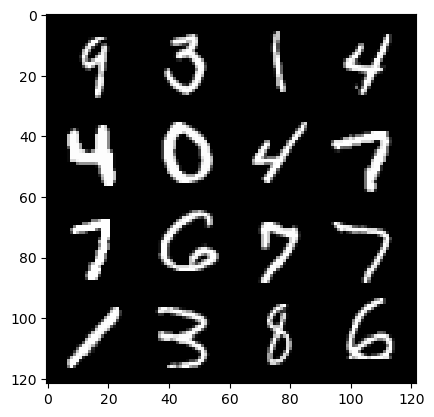

epoch: 5, step: 2400, gen loss: 3.798579223950707, disc loss: 0.043294672767321275.


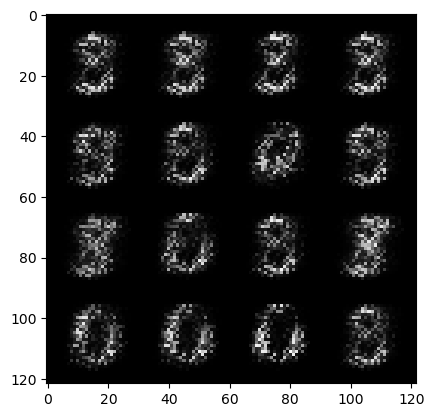

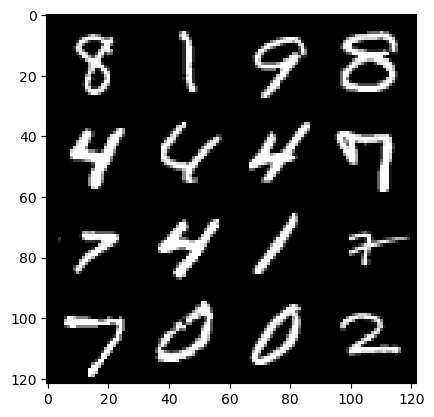

epoch: 5, step: 2700, gen loss: 4.112812994321187, disc loss: 0.03417062943180401.


  0%|          | 0/469 [00:00<?, ?it/s]

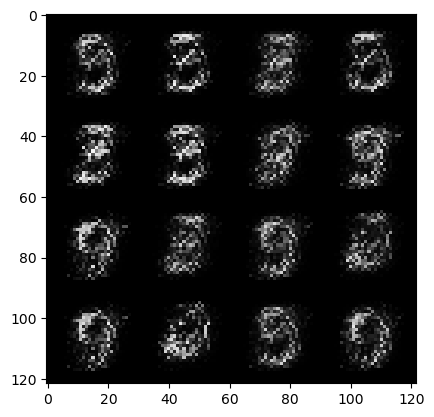

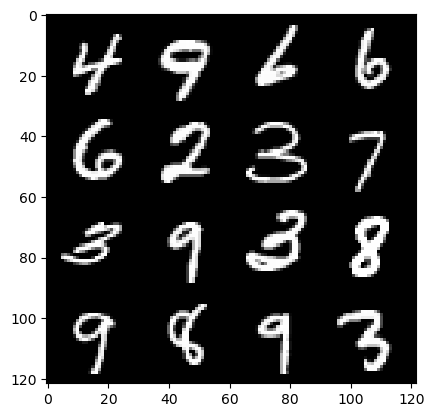

epoch: 6, step: 3000, gen loss: 4.710734462738035, disc loss: 0.02590460791562994.


  0%|          | 0/469 [00:00<?, ?it/s]

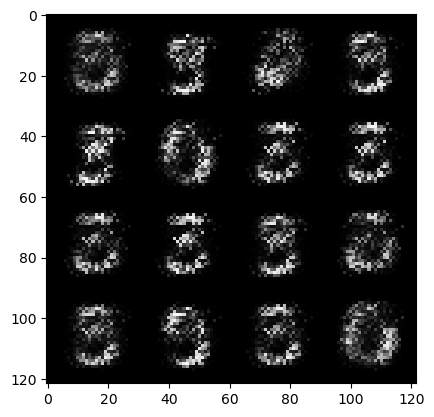

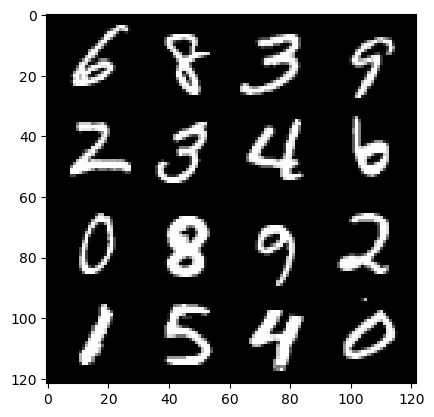

epoch: 7, step: 3300, gen loss: 4.847092057863875, disc loss: 0.027307941112667333.


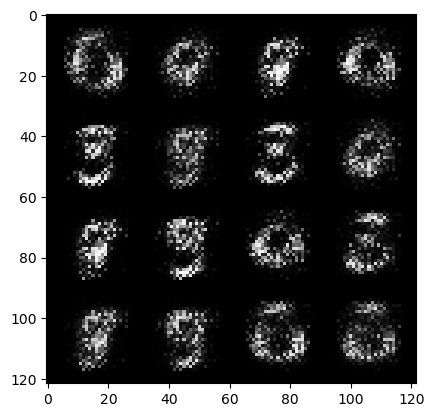

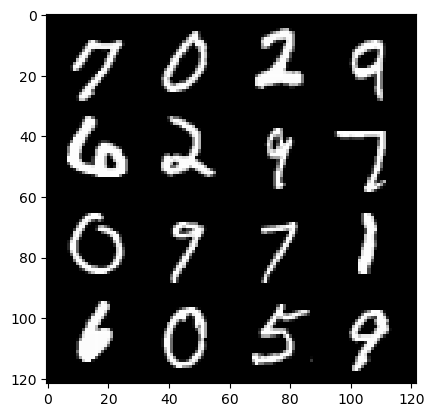

epoch: 7, step: 3600, gen loss: 4.896016090710963, disc loss: 0.022157682897523054.


  0%|          | 0/469 [00:00<?, ?it/s]

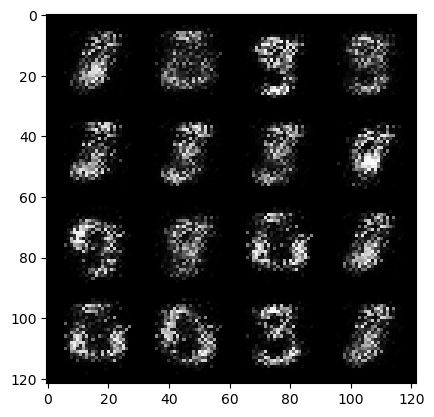

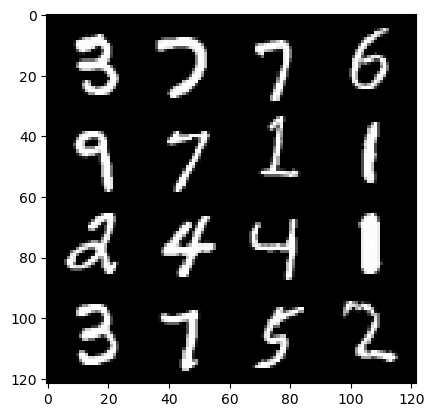

epoch: 8, step: 3900, gen loss: 5.164924019177749, disc loss: 0.020591139296690646.


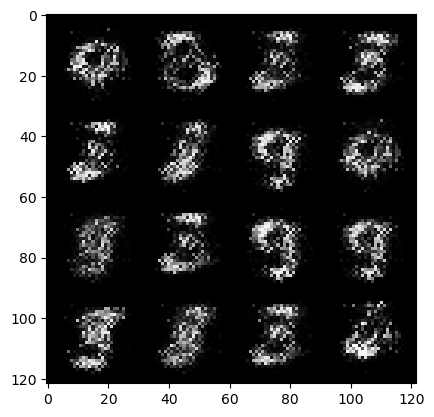

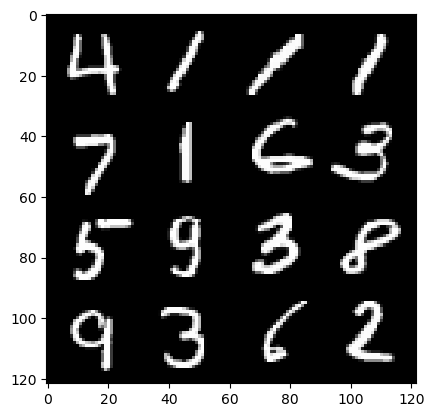

epoch: 8, step: 4200, gen loss: 6.125023582776391, disc loss: 0.01629855299834162.


  0%|          | 0/469 [00:00<?, ?it/s]

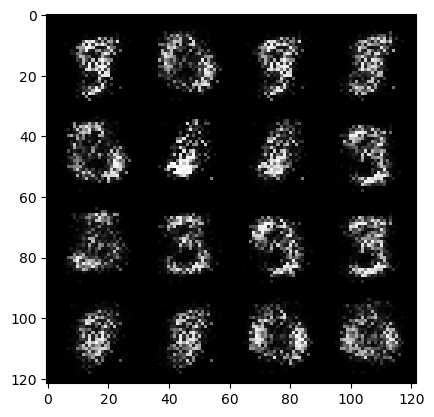

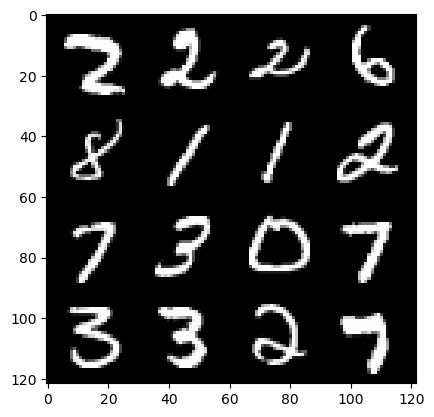

epoch: 9, step: 4500, gen loss: 6.001492045720421, disc loss: 0.01465563914272934.


  0%|          | 0/469 [00:00<?, ?it/s]

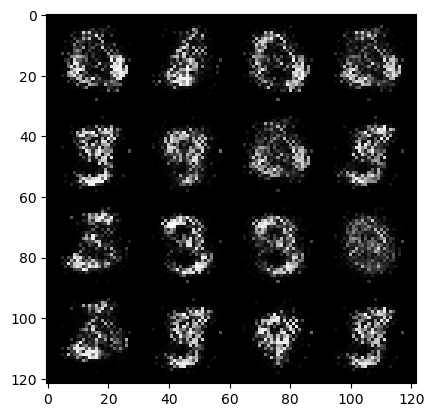

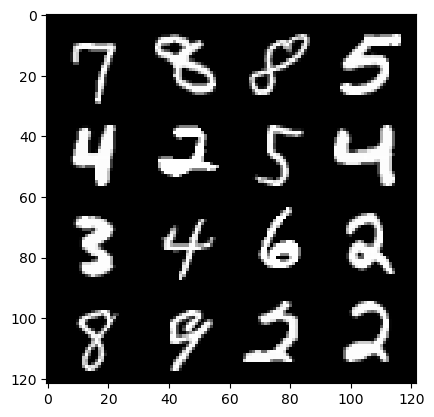

epoch: 10, step: 4800, gen loss: 6.12926875432333, disc loss: 0.013192980140447617.


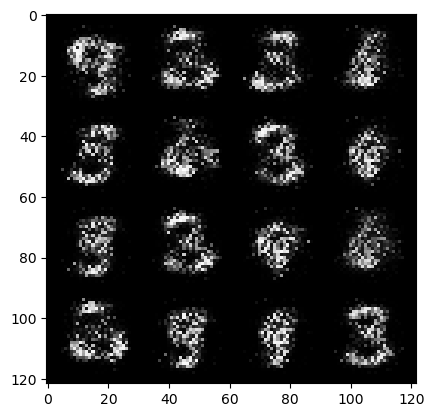

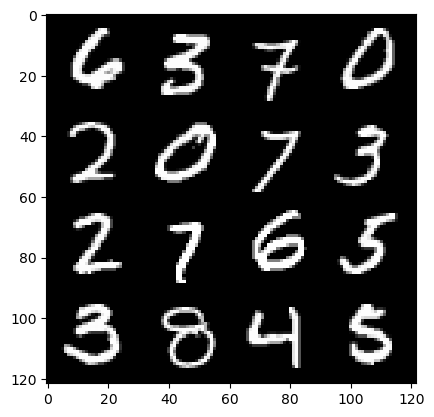

epoch: 10, step: 5100, gen loss: 6.142934638659157, disc loss: 0.011182366722884281.


  0%|          | 0/469 [00:00<?, ?it/s]

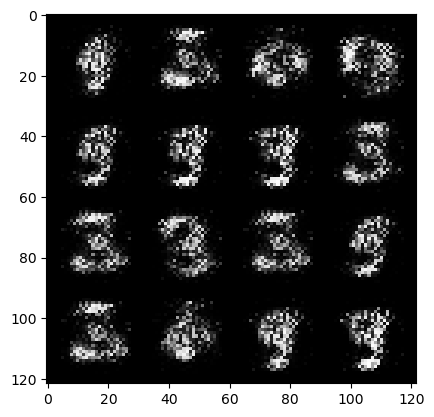

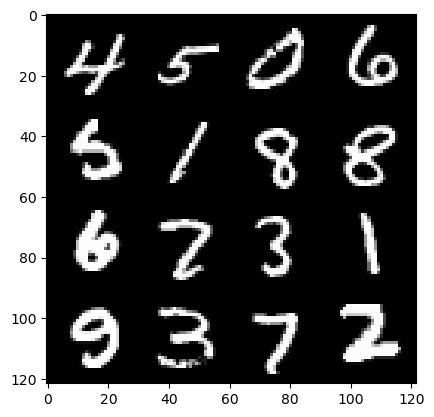

epoch: 11, step: 5400, gen loss: 6.2674932654698665, disc loss: 0.010130828580198184.


  0%|          | 0/469 [00:00<?, ?it/s]

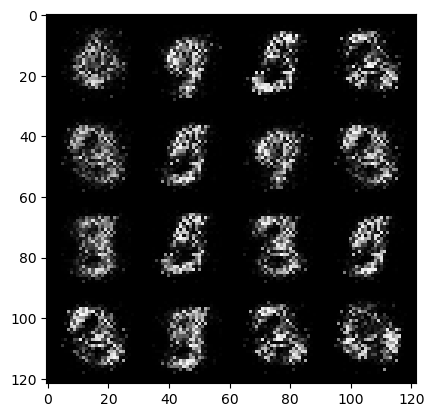

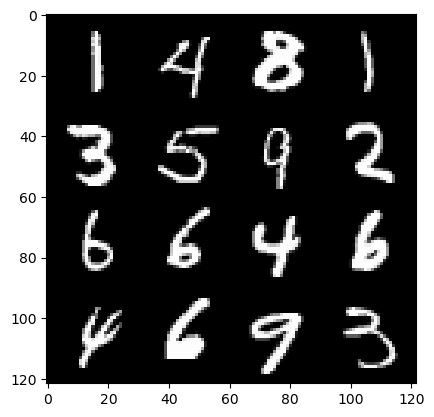

epoch: 12, step: 5700, gen loss: 6.540277649561565, disc loss: 0.009768706262111666.


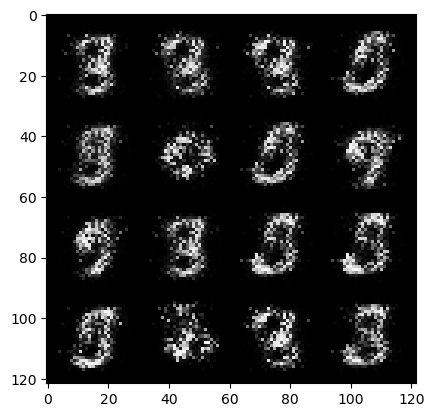

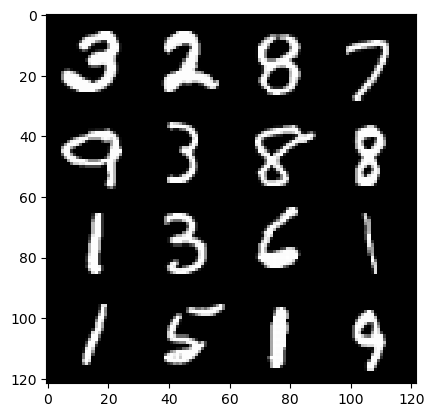

epoch: 12, step: 6000, gen loss: 6.911353610356652, disc loss: 0.010300603558619812.


  0%|          | 0/469 [00:00<?, ?it/s]

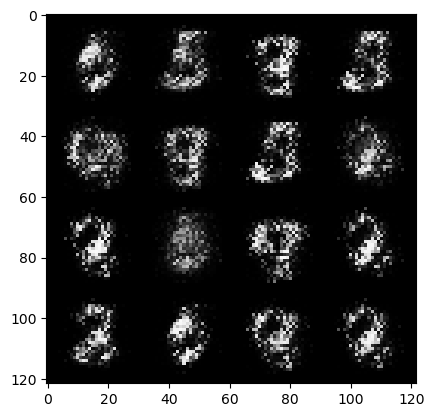

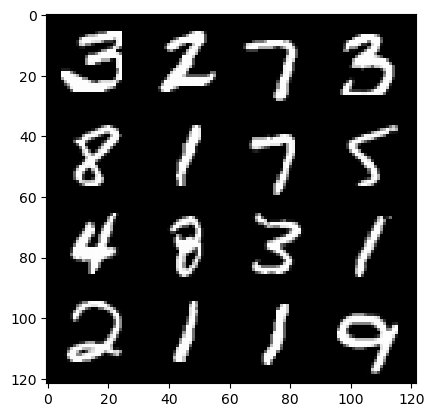

epoch: 13, step: 6300, gen loss: 6.93720814228058, disc loss: 0.010136010875770202.


  0%|          | 0/469 [00:00<?, ?it/s]

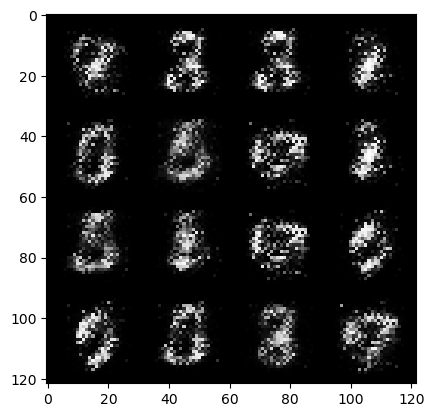

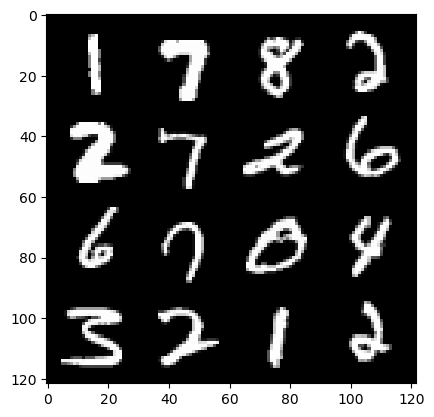

epoch: 14, step: 6600, gen loss: 6.480529759724941, disc loss: 0.011623210936474318.


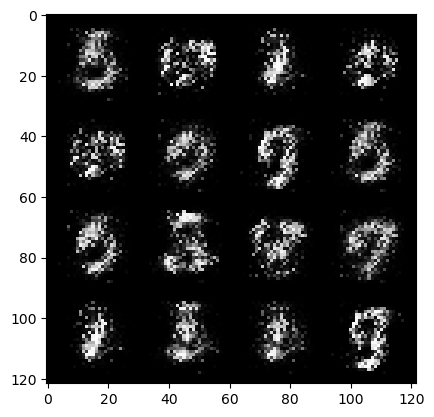

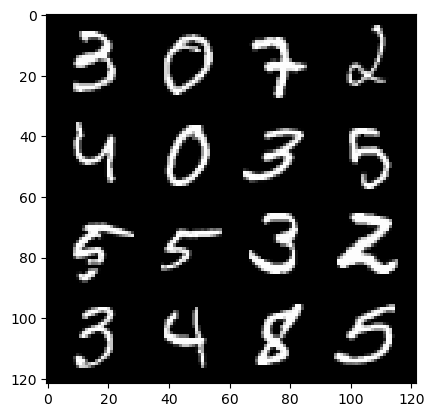

epoch: 14, step: 6900, gen loss: 6.336934450467431, disc loss: 0.011120988520172737.


  0%|          | 0/469 [00:00<?, ?it/s]

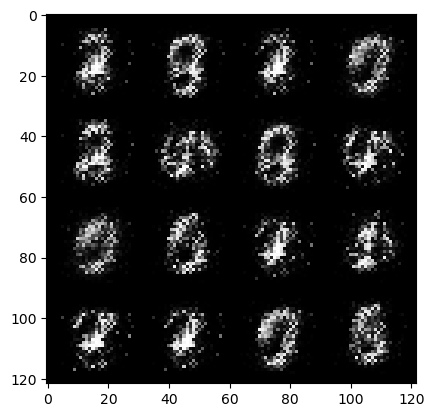

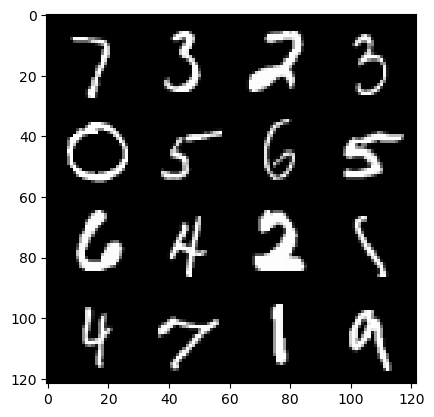

epoch: 15, step: 7200, gen loss: 6.793624561627706, disc loss: 0.007979719847595936.


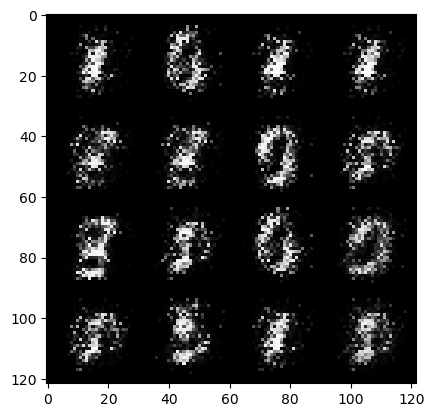

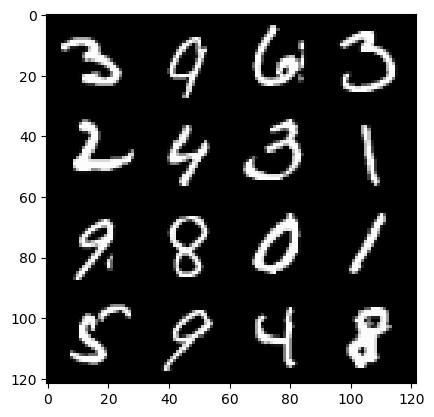

epoch: 15, step: 7500, gen loss: 6.986394144694015, disc loss: 0.008453355207263182.


  0%|          | 0/469 [00:00<?, ?it/s]

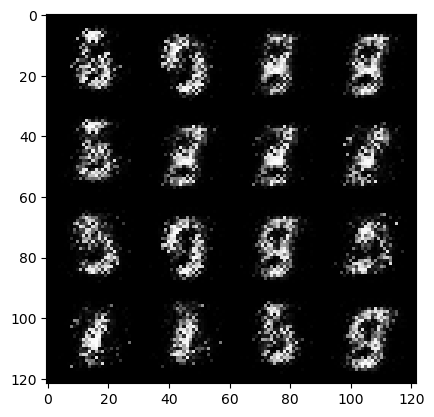

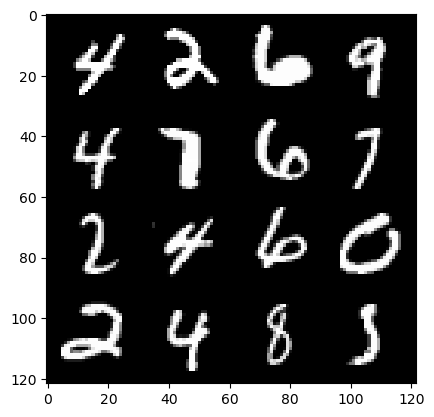

epoch: 16, step: 7800, gen loss: 7.169315020243327, disc loss: 0.008048274988929429.


  0%|          | 0/469 [00:00<?, ?it/s]

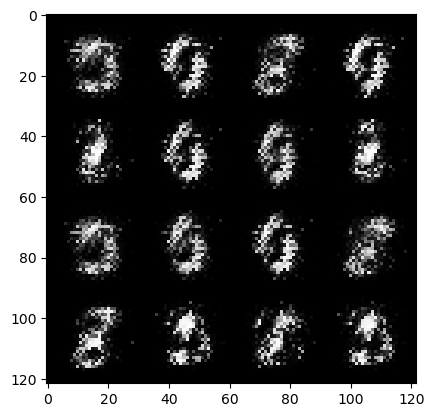

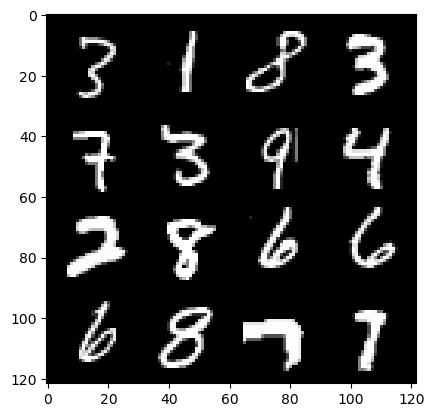

epoch: 17, step: 8100, gen loss: 7.187561505635575, disc loss: 0.008080272260510052.


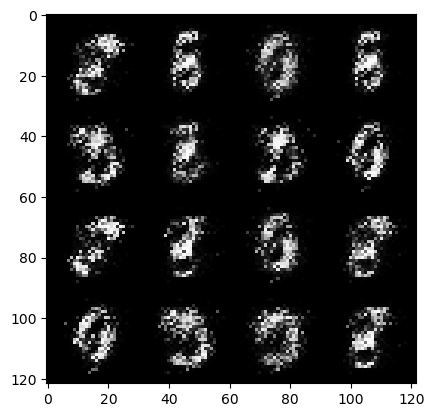

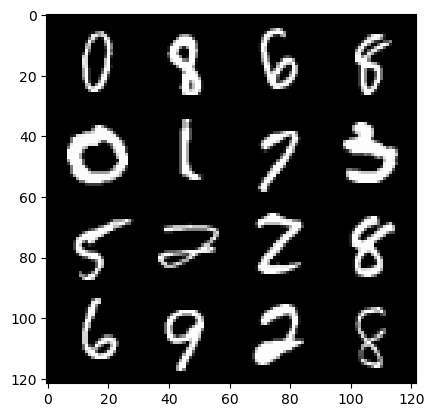

epoch: 17, step: 8400, gen loss: 7.181257851918544, disc loss: 0.00961166597514724.


  0%|          | 0/469 [00:00<?, ?it/s]

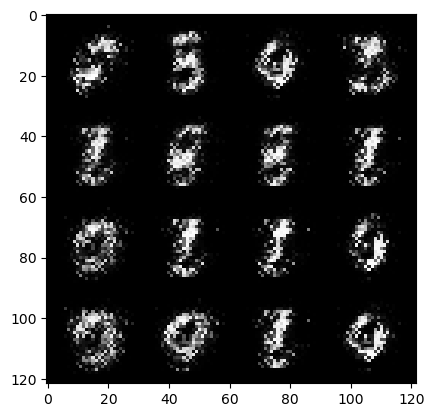

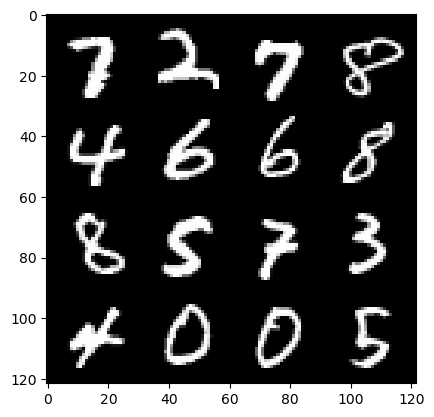

epoch: 18, step: 8700, gen loss: 6.8886116727193185, disc loss: 0.009130542108323429.


  0%|          | 0/469 [00:00<?, ?it/s]

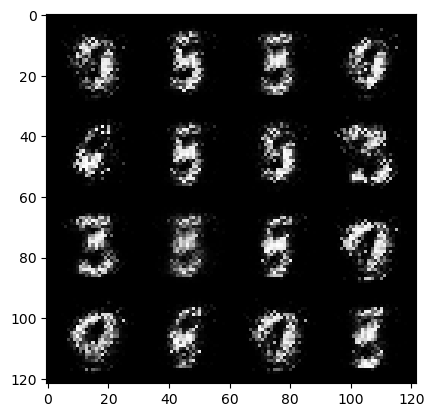

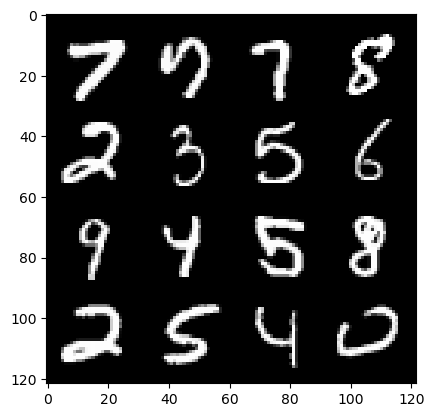

epoch: 19, step: 9000, gen loss: 6.952733772595724, disc loss: 0.010568011342935885.


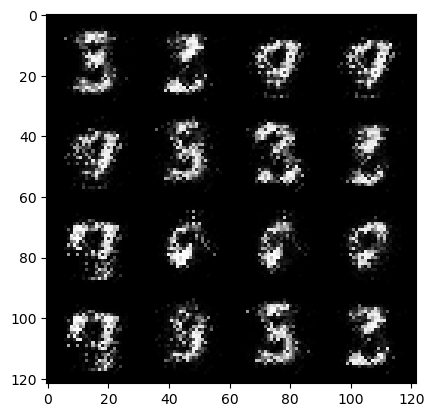

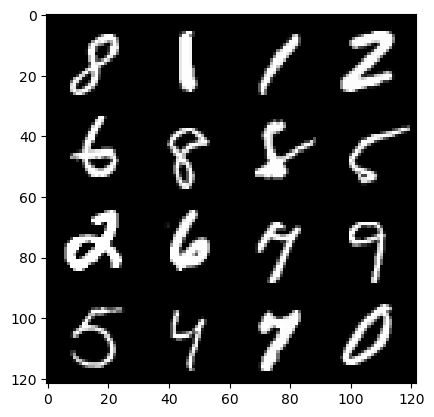

epoch: 19, step: 9300, gen loss: 6.9826500018437665, disc loss: 0.010744212832457078.


  0%|          | 0/469 [00:00<?, ?it/s]

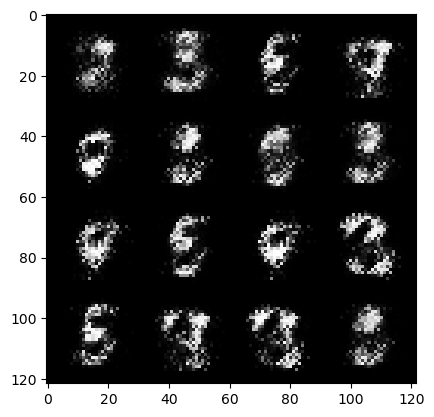

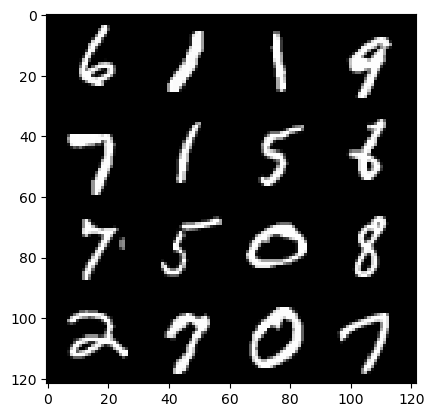

epoch: 20, step: 9600, gen loss: 6.695303304990134, disc loss: 0.011176796319584053.


  0%|          | 0/469 [00:00<?, ?it/s]

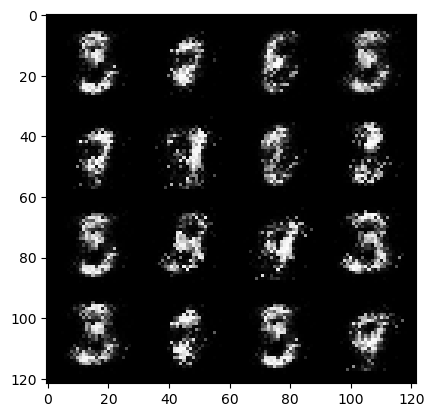

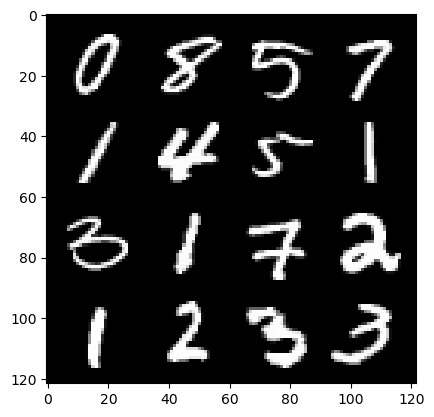

epoch: 21, step: 9900, gen loss: 6.802195531527192, disc loss: 0.010183757772125929.


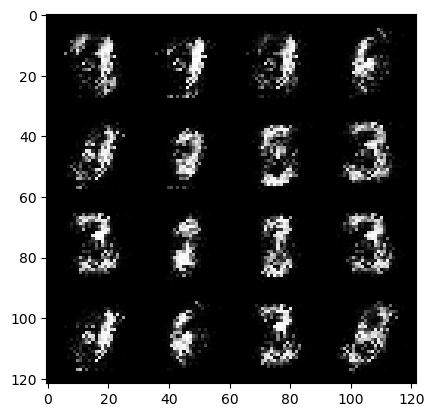

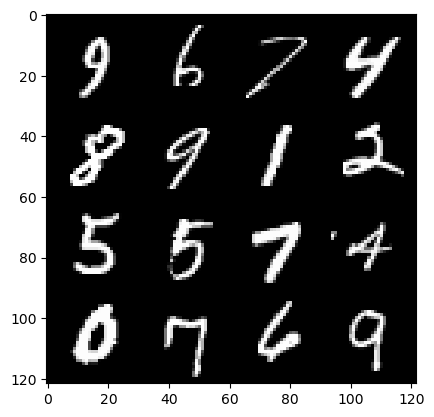

epoch: 21, step: 10200, gen loss: 6.477901261647538, disc loss: 0.01241224897326901.


  0%|          | 0/469 [00:00<?, ?it/s]

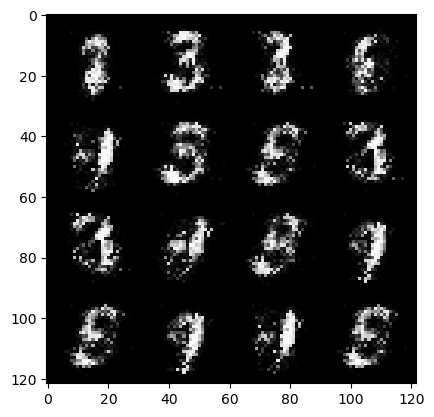

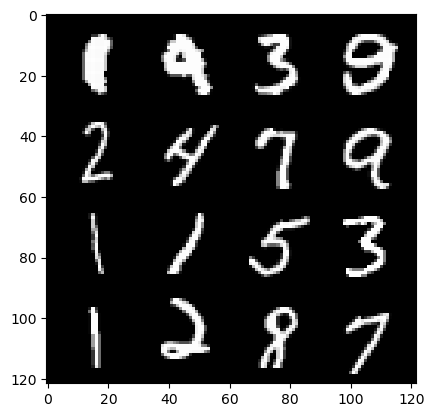

epoch: 22, step: 10500, gen loss: 6.522485405604038, disc loss: 0.012492324349780868.


  0%|          | 0/469 [00:00<?, ?it/s]

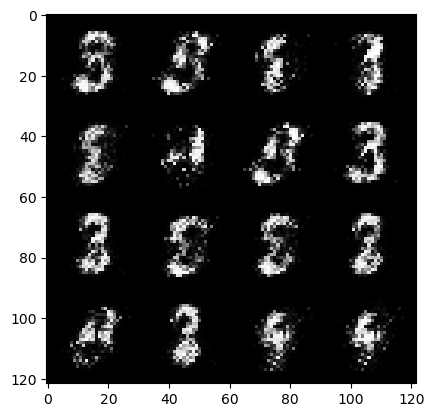

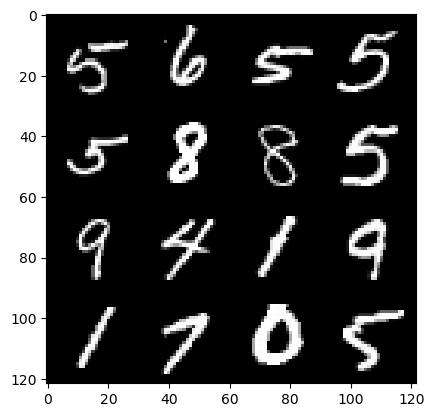

epoch: 23, step: 10800, gen loss: 6.452799445788064, disc loss: 0.013940256511171666.


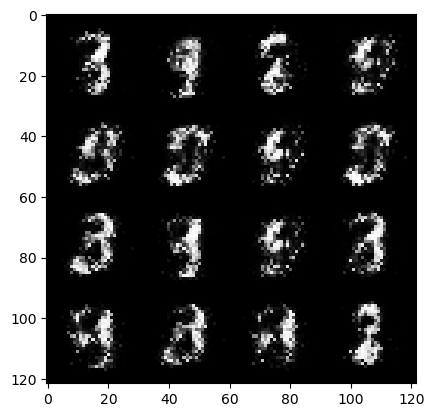

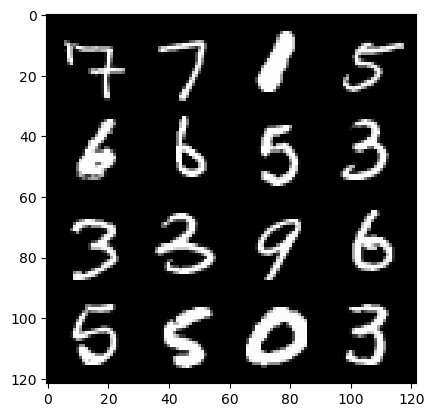

epoch: 23, step: 11100, gen loss: 6.606310834884643, disc loss: 0.0135299834360679.


  0%|          | 0/469 [00:00<?, ?it/s]

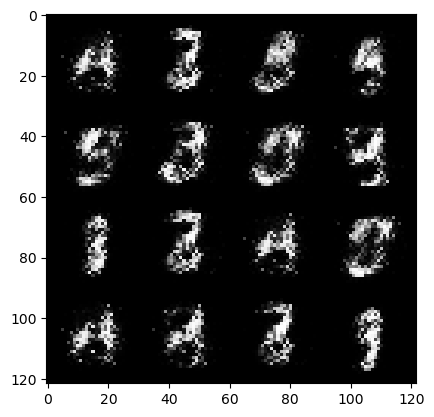

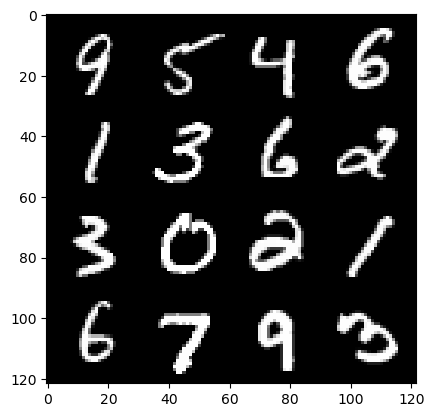

epoch: 24, step: 11400, gen loss: 6.9210617589950525, disc loss: 0.012682373167093208.


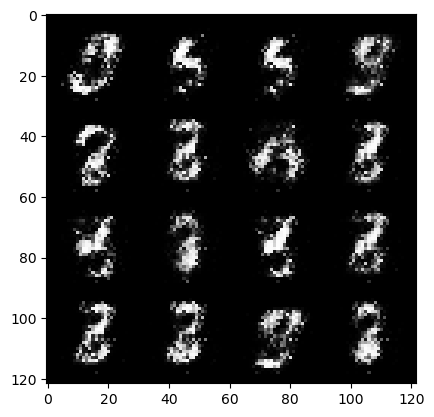

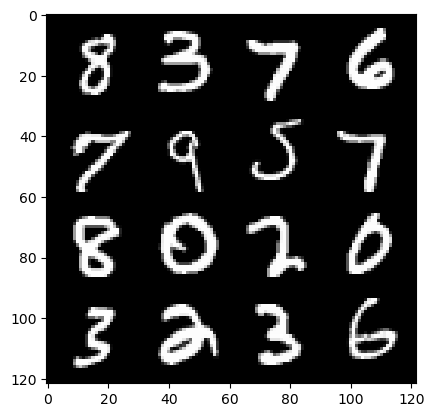

epoch: 24, step: 11700, gen loss: 7.009626661936439, disc loss: 0.01295308000796164.


  0%|          | 0/469 [00:00<?, ?it/s]

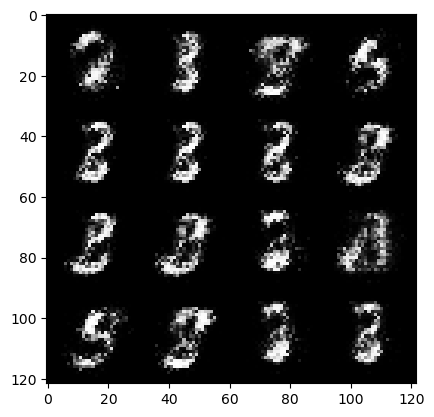

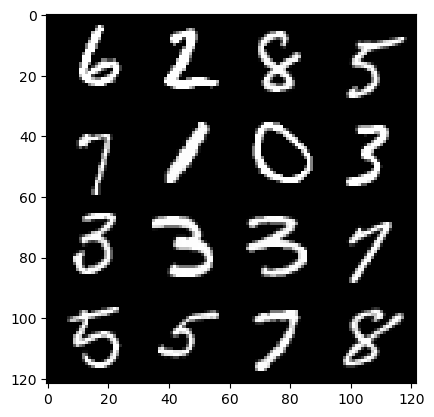

epoch: 25, step: 12000, gen loss: 6.923069801330573, disc loss: 0.016772361724482224.


  0%|          | 0/469 [00:00<?, ?it/s]

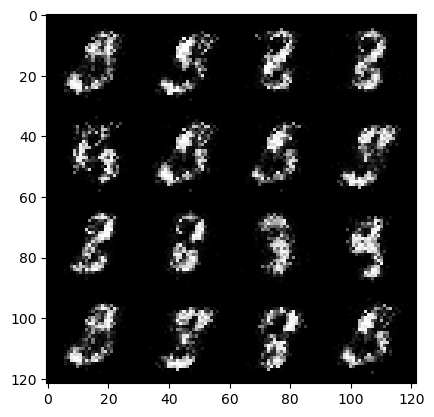

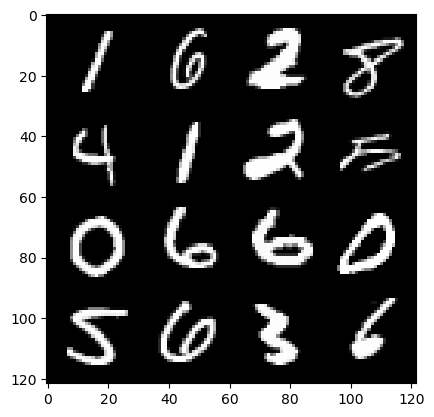

epoch: 26, step: 12300, gen loss: 6.569126610755917, disc loss: 0.014895349837218722.


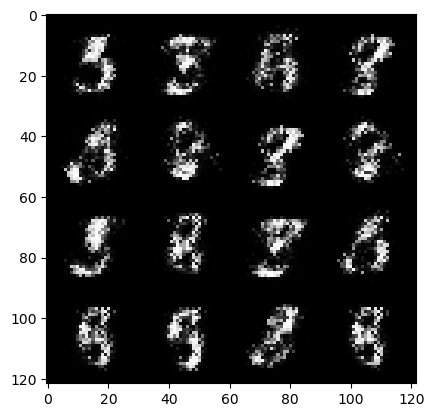

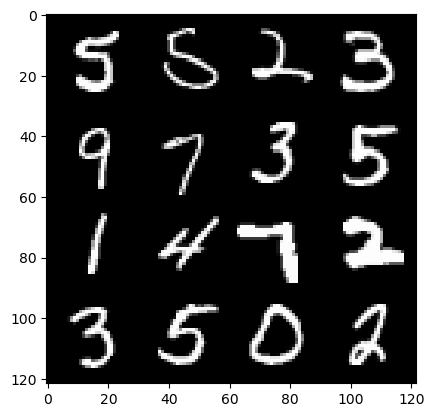

epoch: 26, step: 12600, gen loss: 6.384574875831602, disc loss: 0.01695918514470881.


  0%|          | 0/469 [00:00<?, ?it/s]

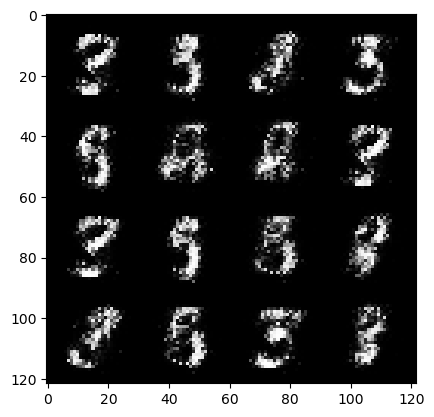

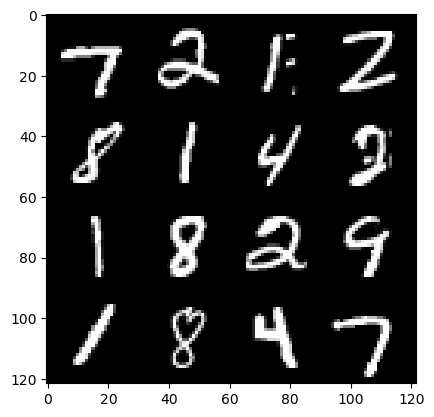

epoch: 27, step: 12900, gen loss: 6.338631169001258, disc loss: 0.016621526281815027.


  0%|          | 0/469 [00:00<?, ?it/s]

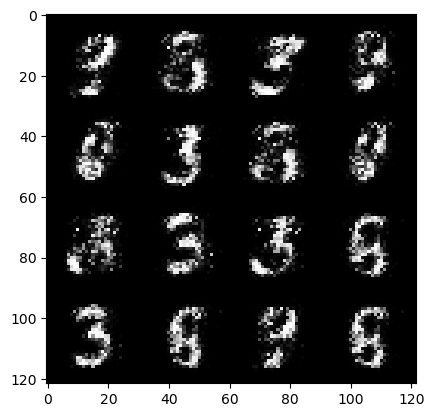

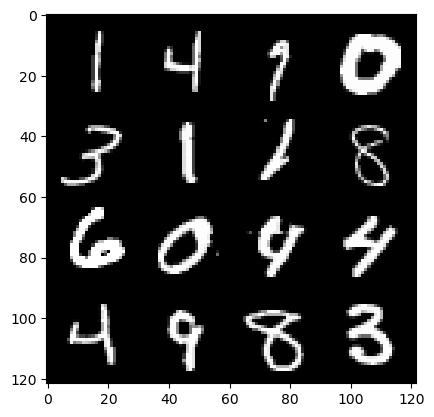

epoch: 28, step: 13200, gen loss: 6.25054456392924, disc loss: 0.018207481331191964.


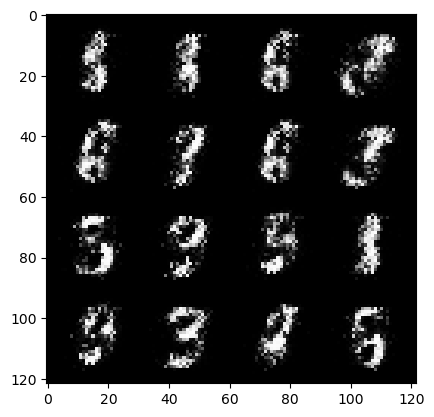

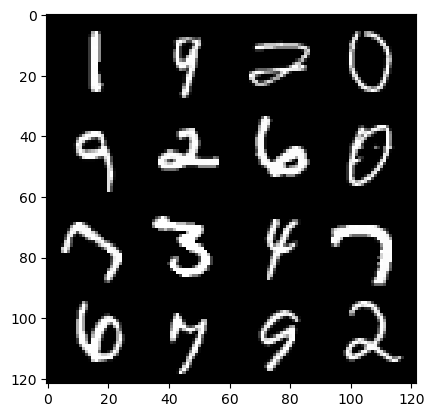

epoch: 28, step: 13500, gen loss: 6.052432829538977, disc loss: 0.02095739824852596.


  0%|          | 0/469 [00:00<?, ?it/s]

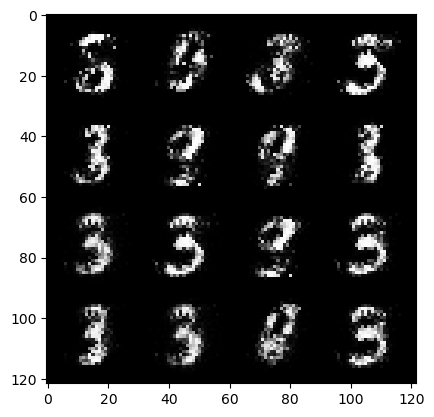

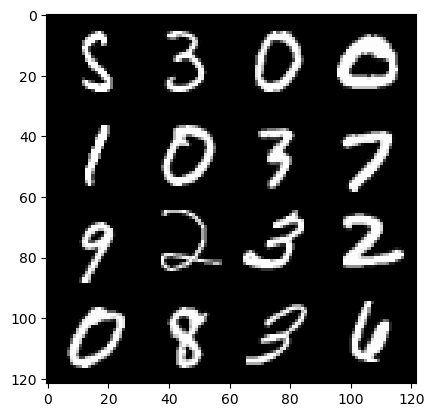

epoch: 29, step: 13800, gen loss: 6.300864024162291, disc loss: 0.019947008964760857.


  0%|          | 0/469 [00:00<?, ?it/s]

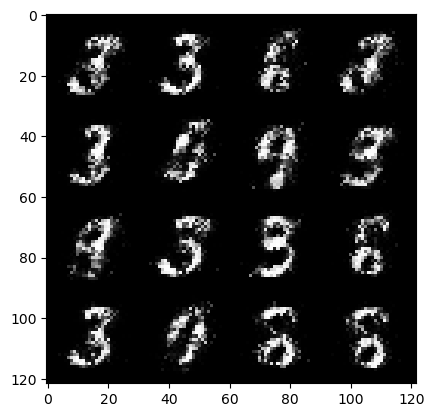

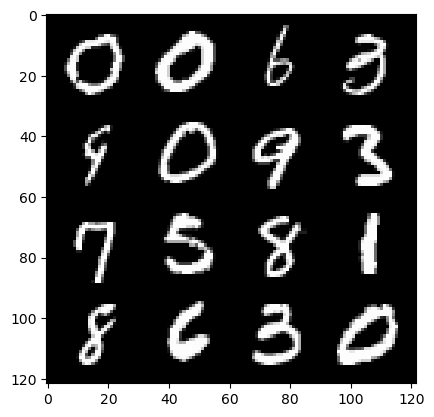

epoch: 30, step: 14100, gen loss: 6.630592838923138, disc loss: 0.018211613135257133.


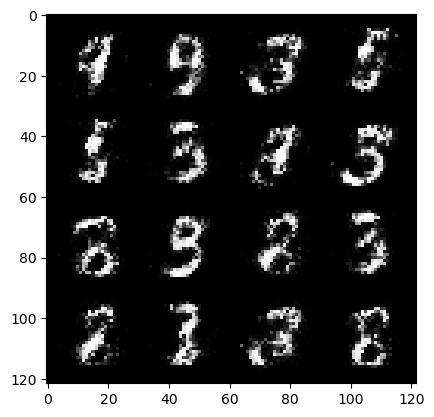

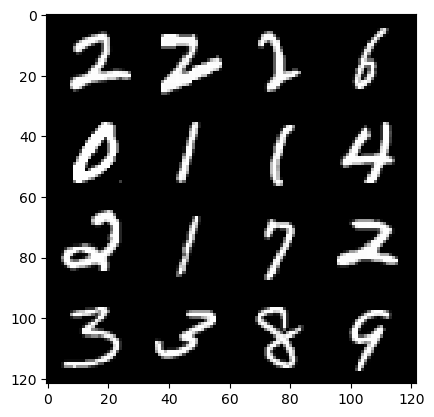

epoch: 30, step: 14400, gen loss: 6.402743145624799, disc loss: 0.023865529766771924.


  0%|          | 0/469 [00:00<?, ?it/s]

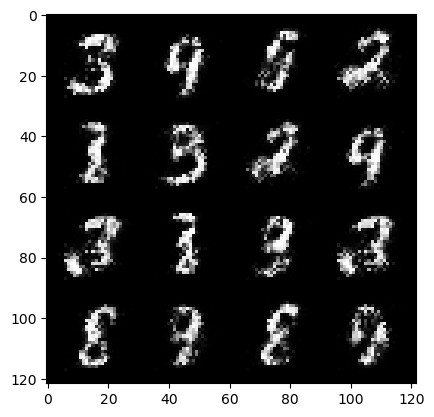

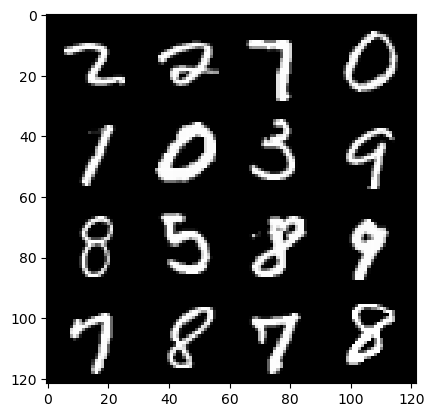

epoch: 31, step: 14700, gen loss: 6.310301737785337, disc loss: 0.02432286441558973.


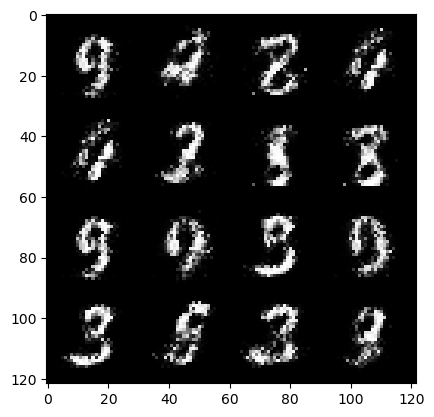

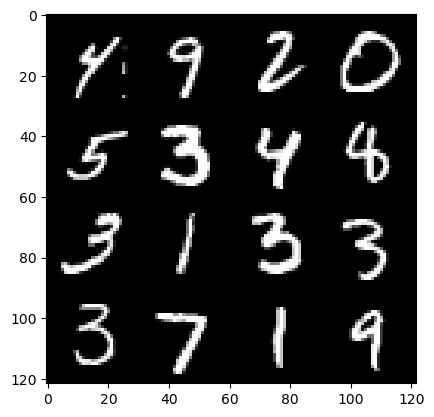

epoch: 31, step: 15000, gen loss: 5.934523634910587, disc loss: 0.02766107592421274.


  0%|          | 0/469 [00:00<?, ?it/s]

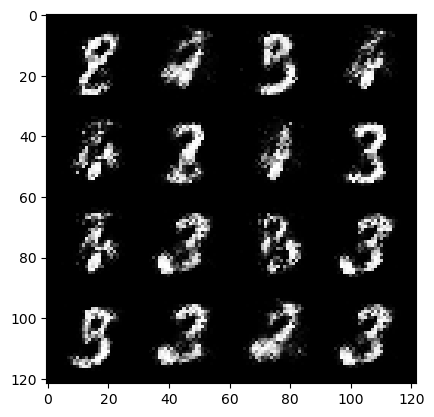

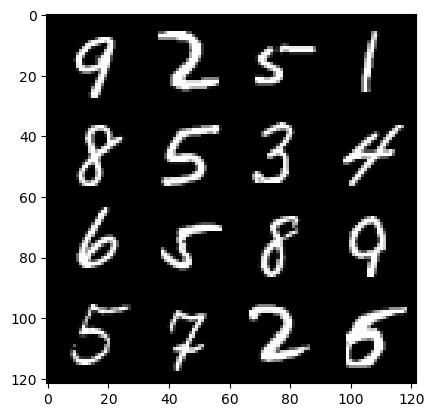

epoch: 32, step: 15300, gen loss: 5.9713579591115336, disc loss: 0.023818531890089326.


  0%|          | 0/469 [00:00<?, ?it/s]

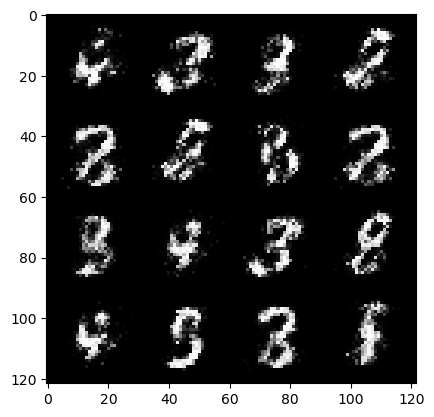

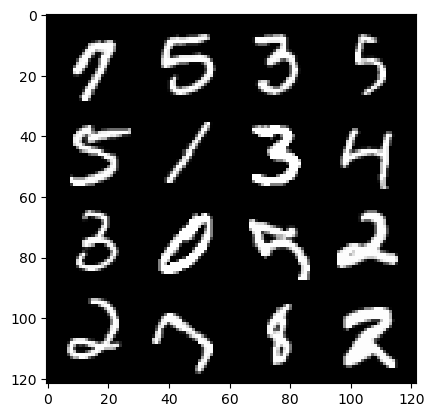

epoch: 33, step: 15600, gen loss: 5.8162862237294535, disc loss: 0.027739787145207317.


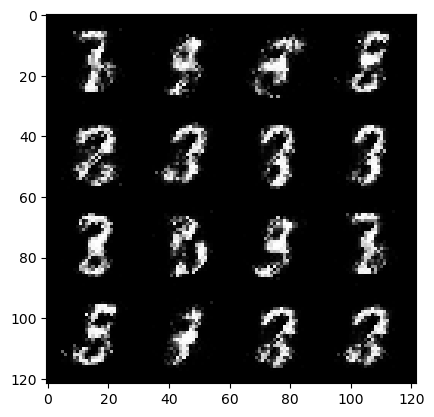

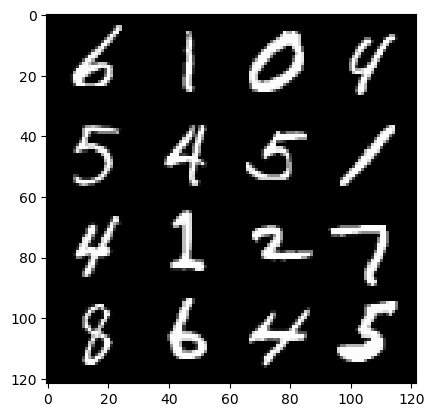

epoch: 33, step: 15900, gen loss: 5.904693136215209, disc loss: 0.03042207145132127.


  0%|          | 0/469 [00:00<?, ?it/s]

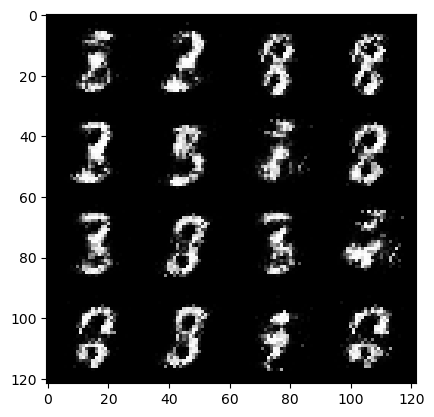

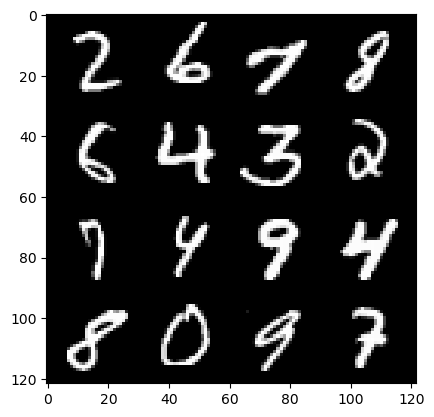

epoch: 34, step: 16200, gen loss: 5.881253674825032, disc loss: 0.027805091164385284.


  0%|          | 0/469 [00:00<?, ?it/s]

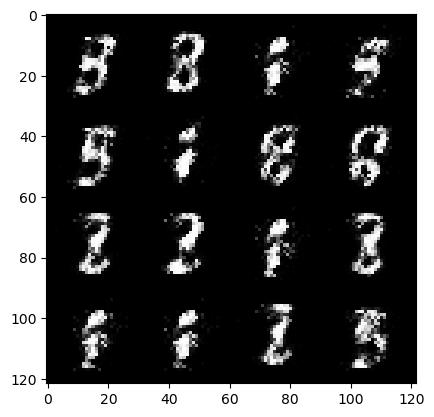

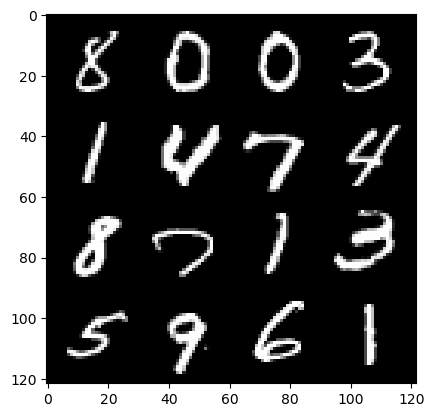

epoch: 35, step: 16500, gen loss: 5.931519144376117, disc loss: 0.02955599742631118.


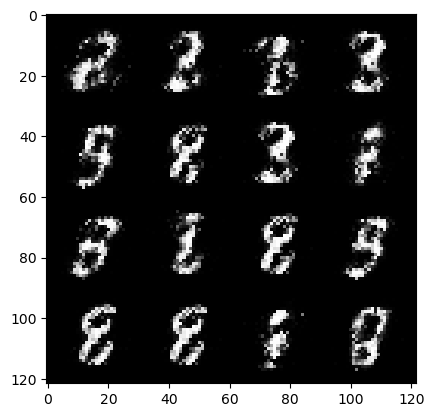

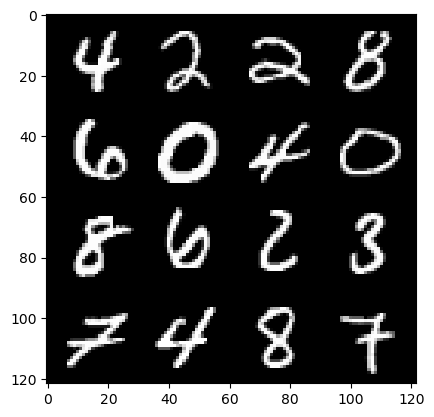

epoch: 35, step: 16800, gen loss: 5.782632141113281, disc loss: 0.03380837398425985.


  0%|          | 0/469 [00:00<?, ?it/s]

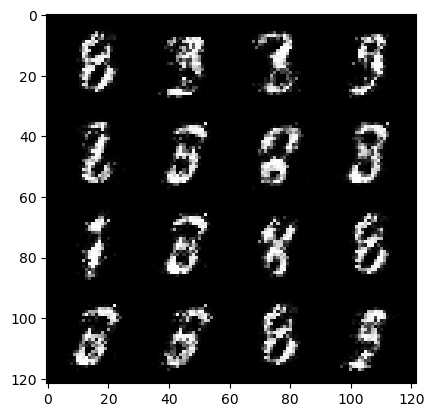

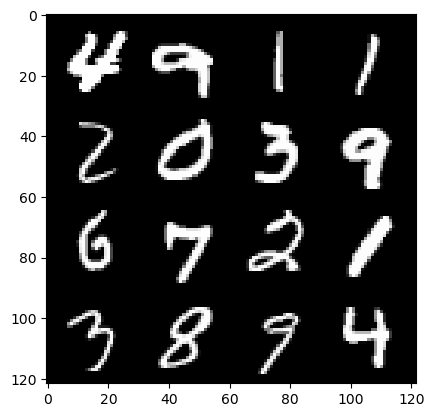

epoch: 36, step: 17100, gen loss: 5.790404817263284, disc loss: 0.03064778357278557.


  0%|          | 0/469 [00:00<?, ?it/s]

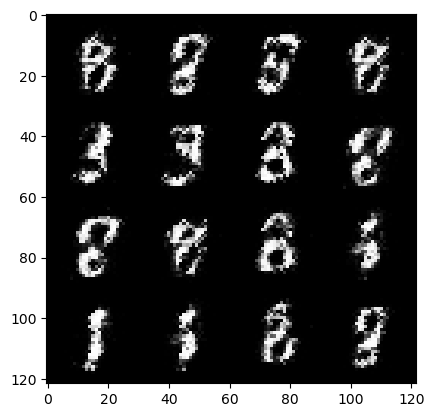

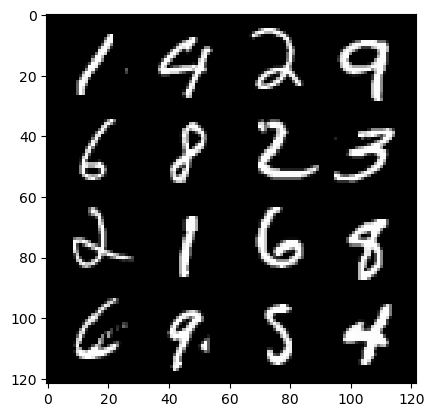

epoch: 37, step: 17400, gen loss: 5.750990881919862, disc loss: 0.034907326263686034.


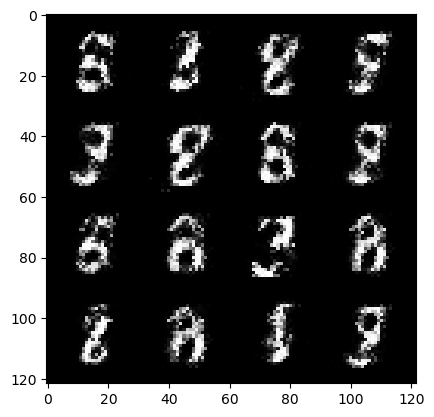

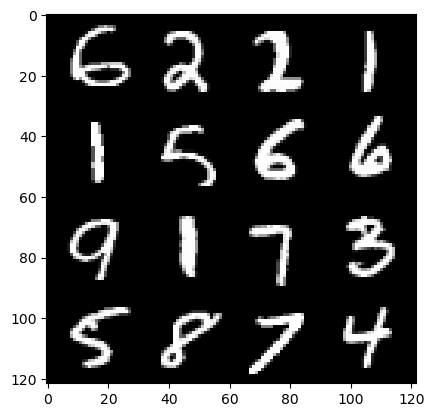

epoch: 37, step: 17700, gen loss: 5.428593123753869, disc loss: 0.03599446908415609.


  0%|          | 0/469 [00:00<?, ?it/s]

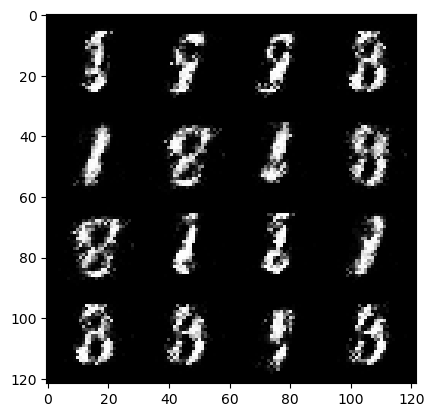

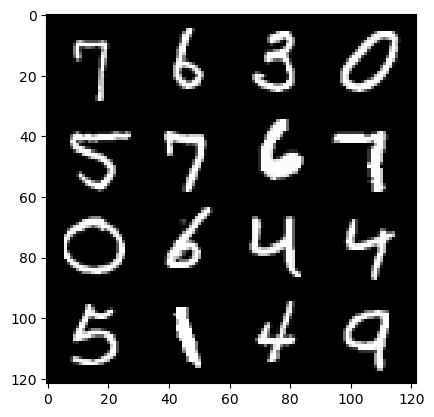

epoch: 38, step: 18000, gen loss: 5.667156254450483, disc loss: 0.03517075669641295.


  0%|          | 0/469 [00:00<?, ?it/s]

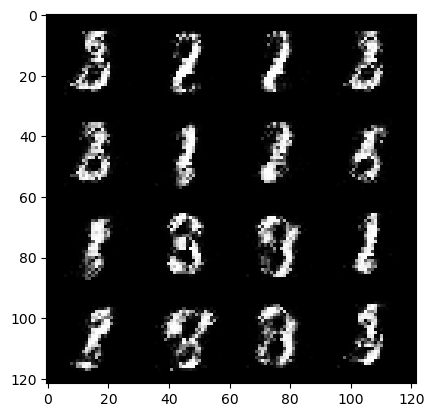

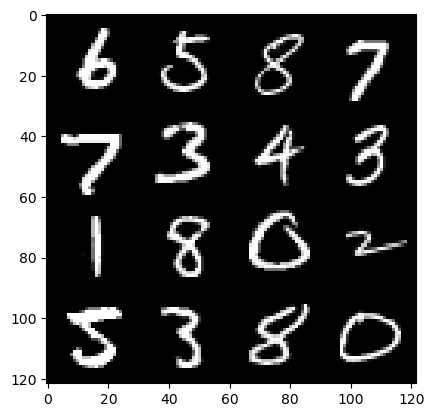

epoch: 39, step: 18300, gen loss: 5.628048777580261, disc loss: 0.037616034398476265.


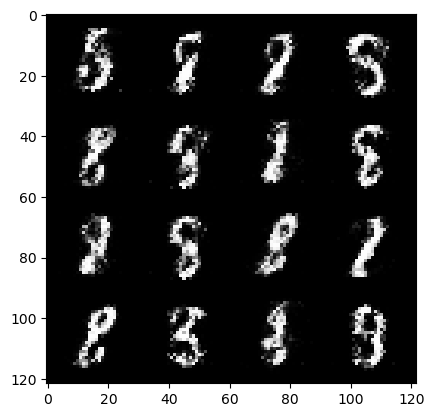

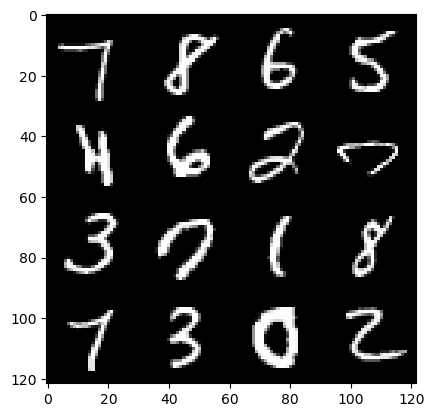

epoch: 39, step: 18600, gen loss: 5.756913329760229, disc loss: 0.033678919610877836.


  0%|          | 0/469 [00:00<?, ?it/s]

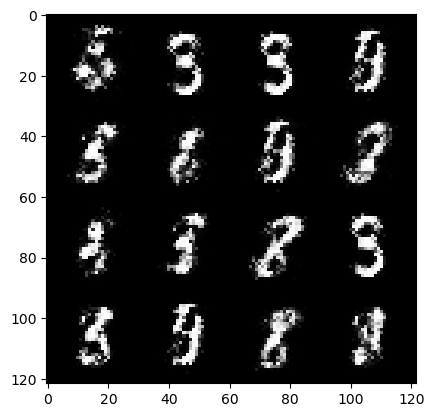

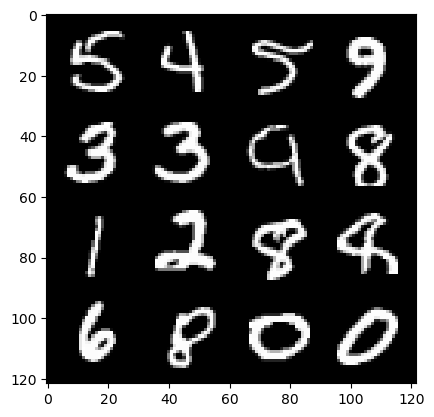

epoch: 40, step: 18900, gen loss: 5.704394655227659, disc loss: 0.03952662365511059.


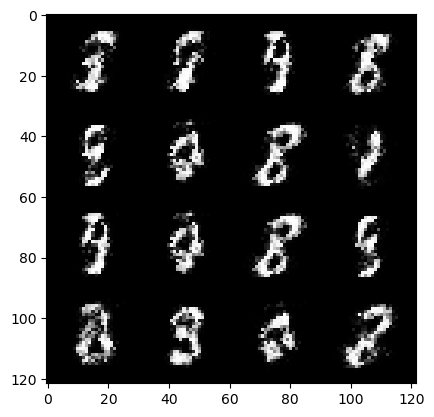

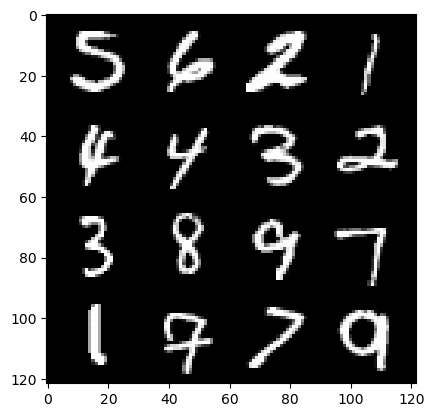

epoch: 40, step: 19200, gen loss: 5.560652756690982, disc loss: 0.04336614681097367.


  0%|          | 0/469 [00:00<?, ?it/s]

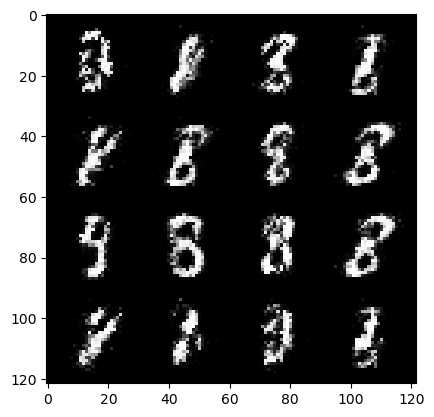

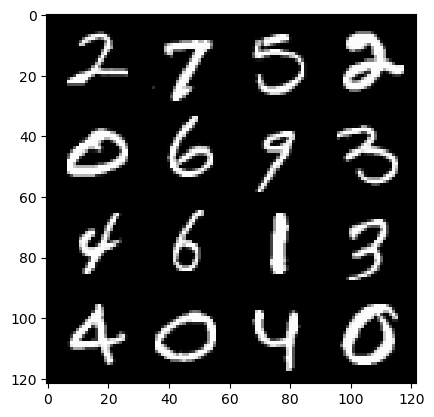

epoch: 41, step: 19500, gen loss: 5.740889854431151, disc loss: 0.03812286525964734.


  0%|          | 0/469 [00:00<?, ?it/s]

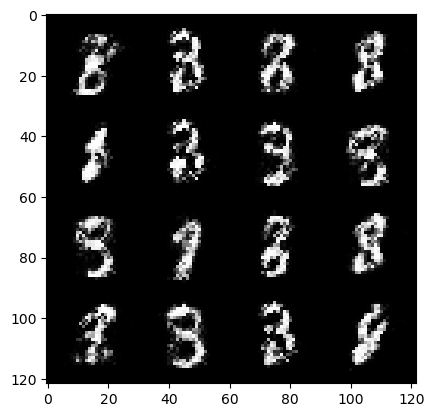

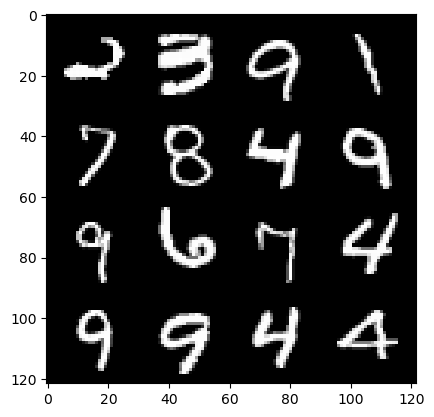

epoch: 42, step: 19800, gen loss: 5.815125546455383, disc loss: 0.04488837533009551.


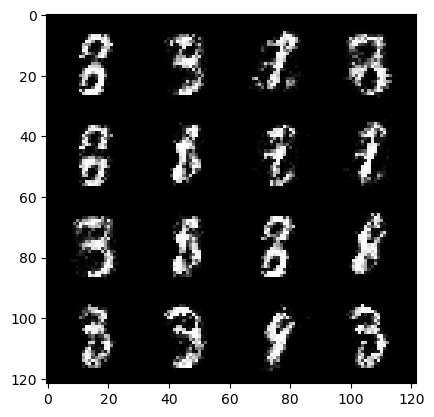

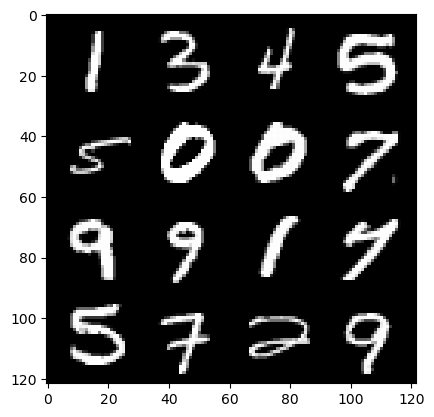

epoch: 42, step: 20100, gen loss: 5.60537320137024, disc loss: 0.04970745964286227.


  0%|          | 0/469 [00:00<?, ?it/s]

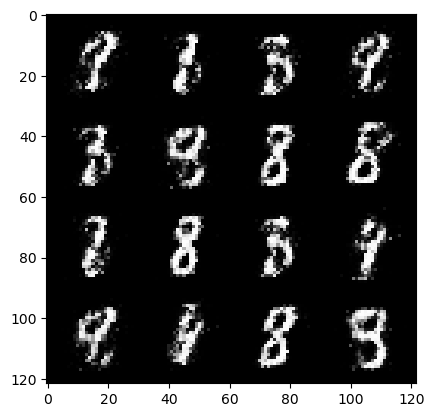

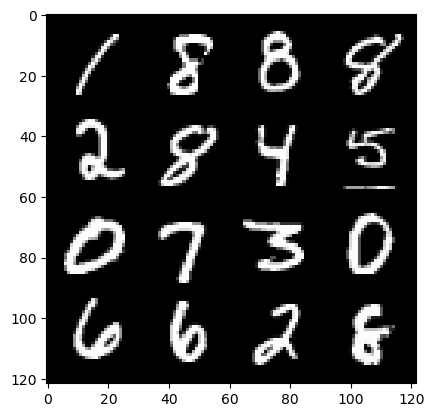

epoch: 43, step: 20400, gen loss: 5.611388545036317, disc loss: 0.053632713903983505.


  0%|          | 0/469 [00:00<?, ?it/s]

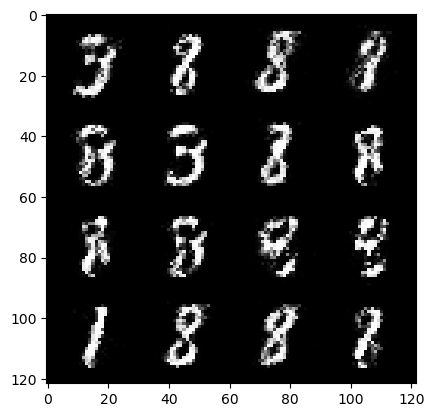

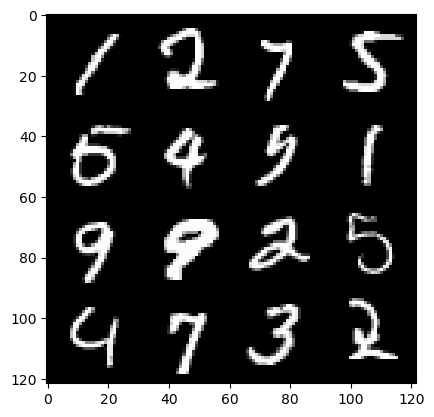

epoch: 44, step: 20700, gen loss: 5.712820329666139, disc loss: 0.054624920931334295.


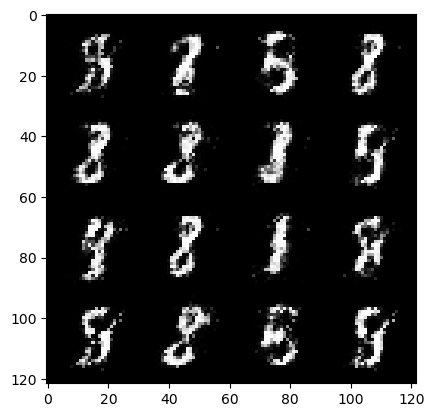

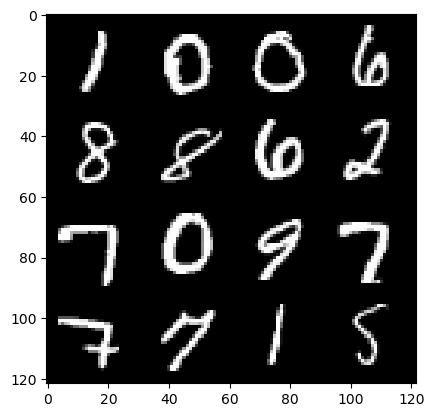

epoch: 44, step: 21000, gen loss: 5.307812395095831, disc loss: 0.05169015532669916.


  0%|          | 0/469 [00:00<?, ?it/s]

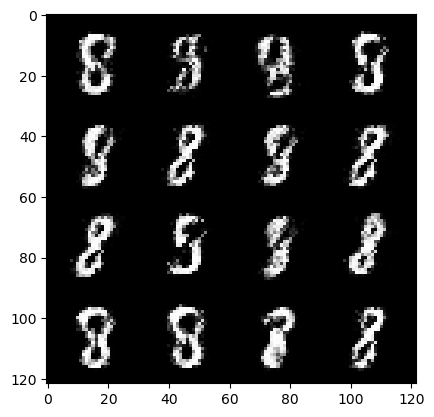

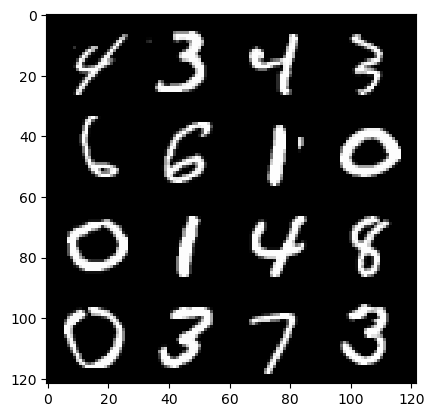

epoch: 45, step: 21300, gen loss: 5.614730556805929, disc loss: 0.055548294515659395.


  0%|          | 0/469 [00:00<?, ?it/s]

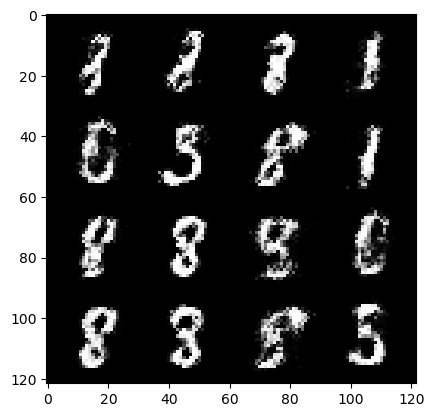

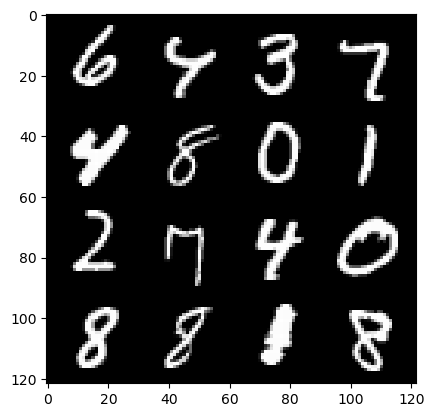

epoch: 46, step: 21600, gen loss: 5.406256043116257, disc loss: 0.0608401547651738.


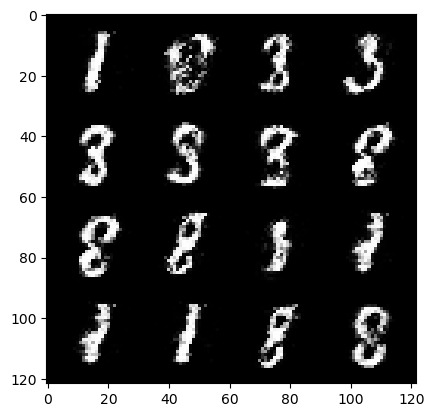

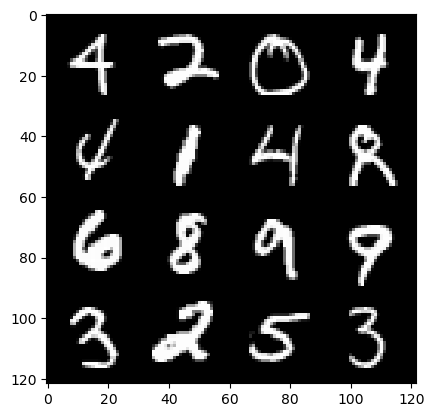

epoch: 46, step: 21900, gen loss: 5.287403926849369, disc loss: 0.055127514470368635.


  0%|          | 0/469 [00:00<?, ?it/s]

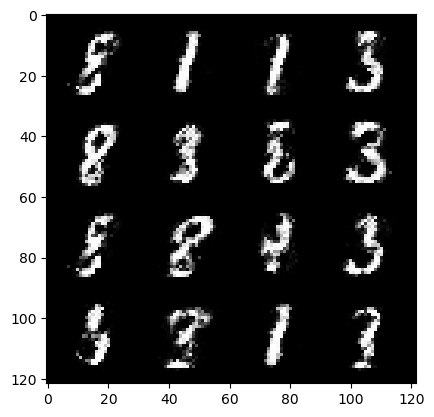

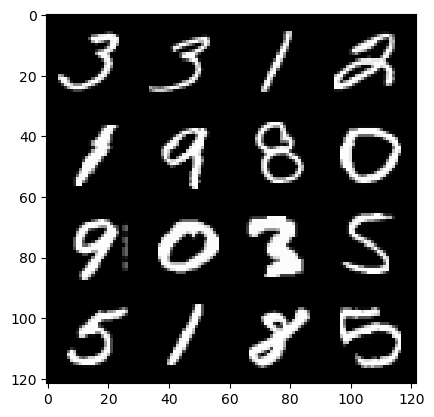

epoch: 47, step: 22200, gen loss: 5.107734805742897, disc loss: 0.05660786226391787.


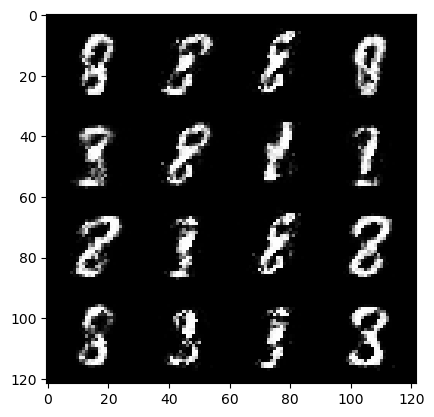

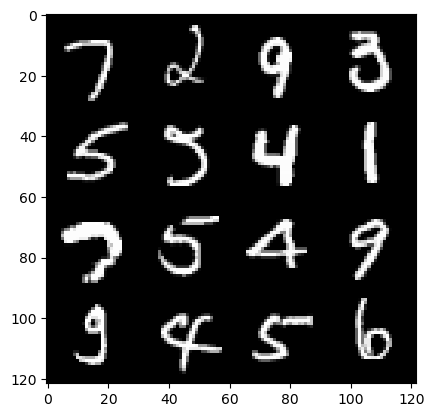

epoch: 47, step: 22500, gen loss: 5.094656977653504, disc loss: 0.062071309300760456.


  0%|          | 0/469 [00:00<?, ?it/s]

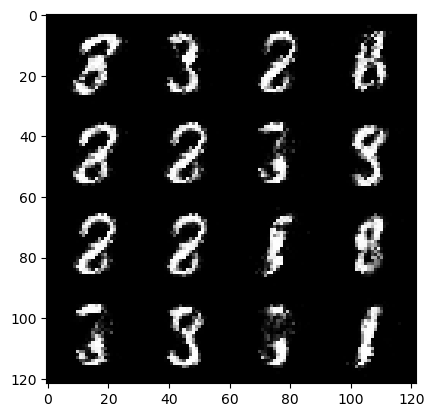

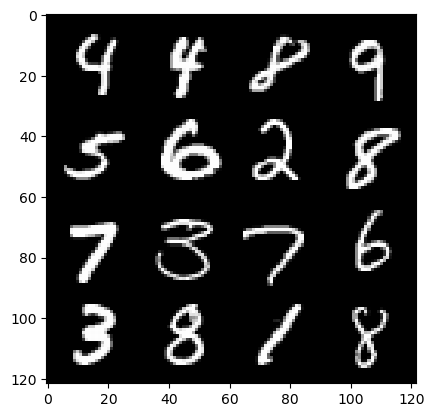

epoch: 48, step: 22800, gen loss: 4.971072977383931, disc loss: 0.06473037364582218.


  0%|          | 0/469 [00:00<?, ?it/s]

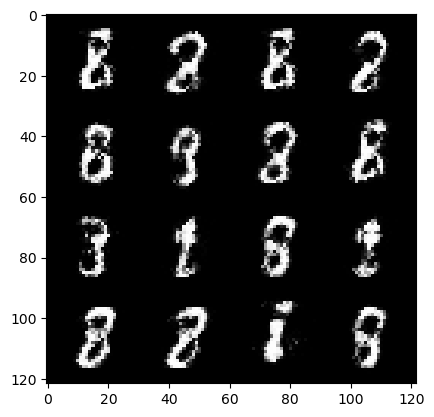

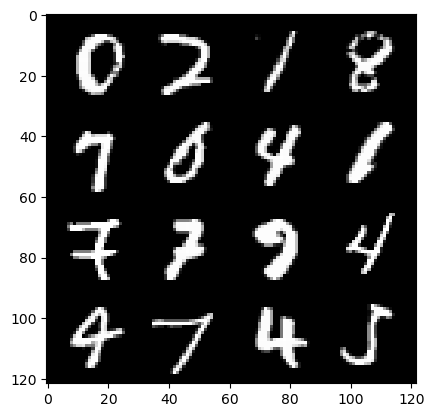

epoch: 49, step: 23100, gen loss: 5.04005250453949, disc loss: 0.06911110263938701.


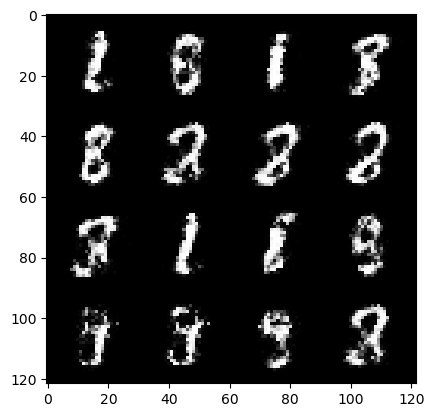

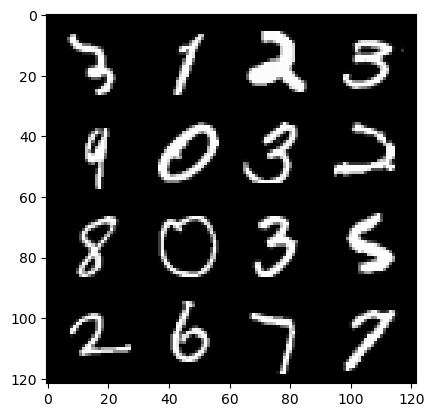

epoch: 49, step: 23400, gen loss: 4.729376772244773, disc loss: 0.07542901630202924.


  0%|          | 0/469 [00:00<?, ?it/s]

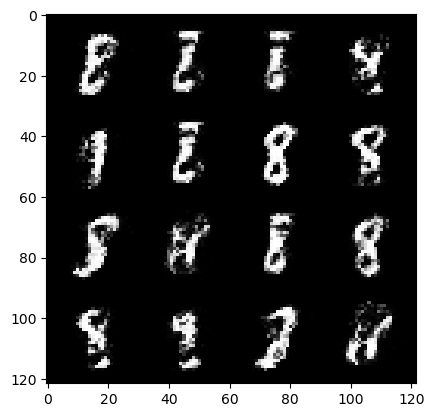

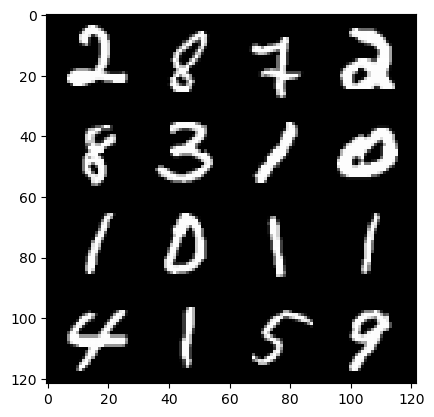

epoch: 50, step: 23700, gen loss: 4.886503233909604, disc loss: 0.07993045851588258.


  0%|          | 0/469 [00:00<?, ?it/s]

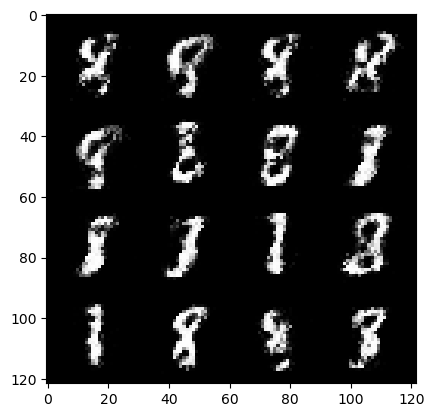

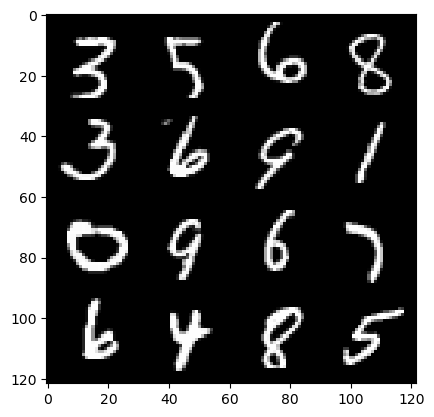

epoch: 51, step: 24000, gen loss: 4.833805426756538, disc loss: 0.08131526489431659.


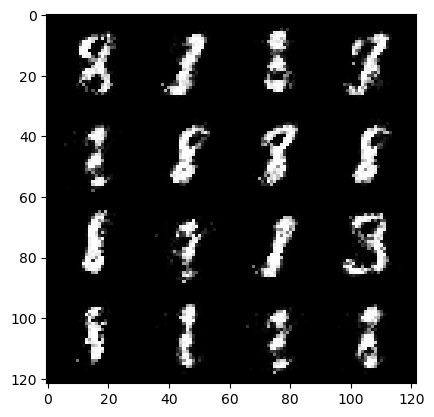

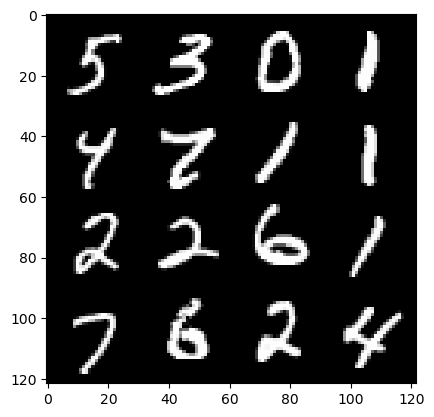

epoch: 51, step: 24300, gen loss: 4.822331031958259, disc loss: 0.07135587967311341.


  0%|          | 0/469 [00:00<?, ?it/s]

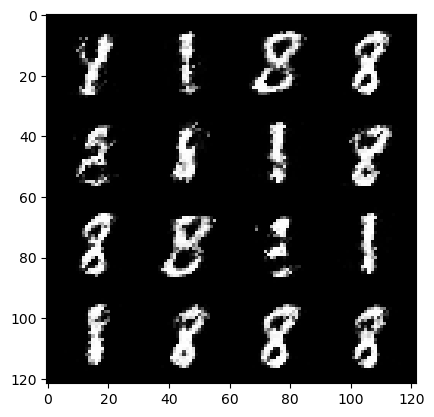

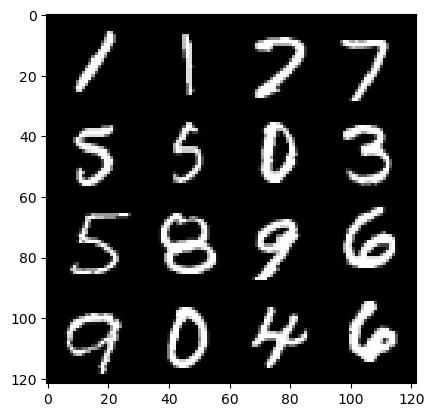

epoch: 52, step: 24600, gen loss: 4.969771612485251, disc loss: 0.0666287395916879.


  0%|          | 0/469 [00:00<?, ?it/s]

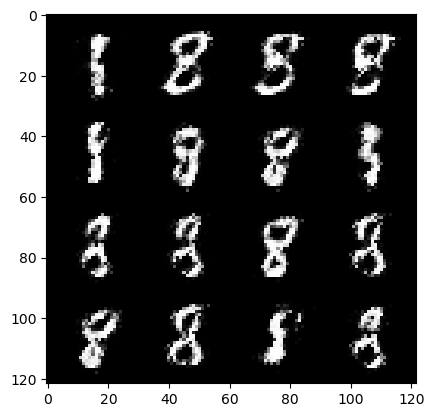

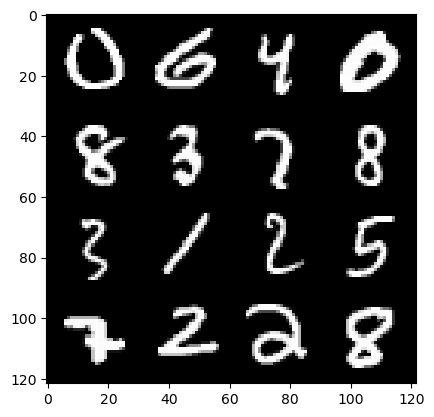

epoch: 53, step: 24900, gen loss: 4.714177257219953, disc loss: 0.07889770509675147.


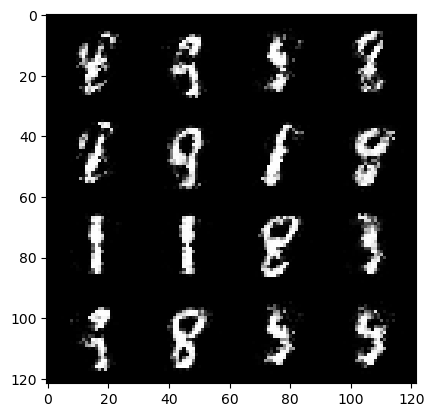

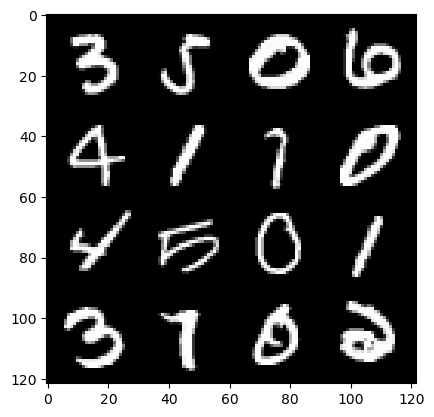

epoch: 53, step: 25200, gen loss: 4.50046450773875, disc loss: 0.08587044613435862.


  0%|          | 0/469 [00:00<?, ?it/s]

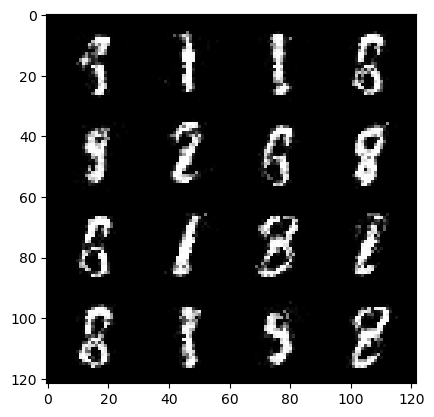

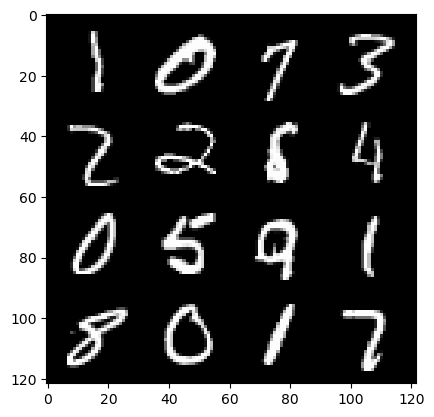

epoch: 54, step: 25500, gen loss: 4.76303262710571, disc loss: 0.07374751361086963.


  0%|          | 0/469 [00:00<?, ?it/s]

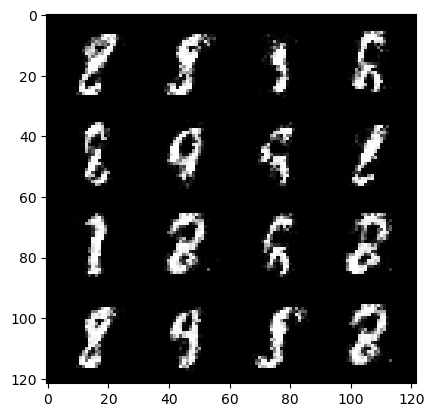

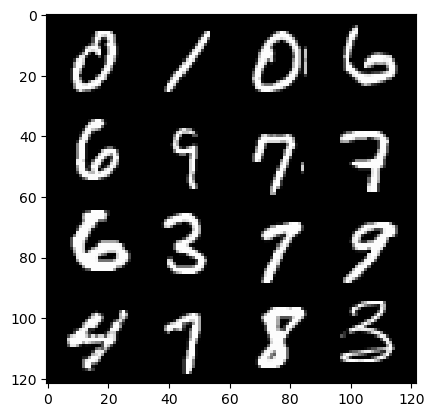

epoch: 55, step: 25800, gen loss: 4.78254214286804, disc loss: 0.08441293854887286.


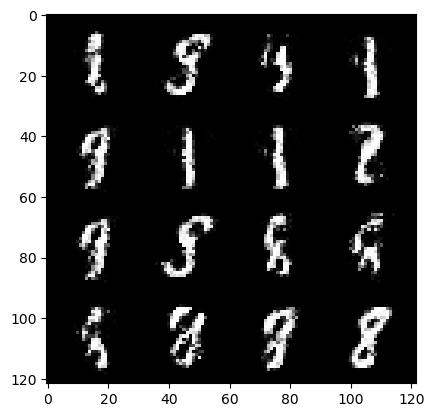

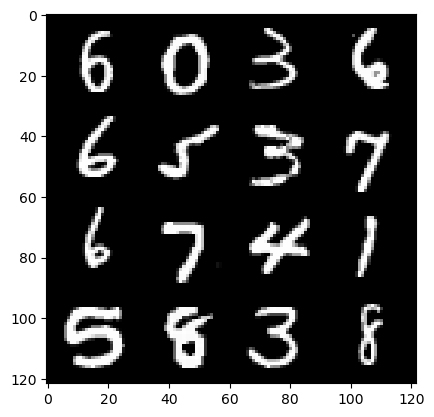

epoch: 55, step: 26100, gen loss: 4.633060649236043, disc loss: 0.09453725893050433.


  0%|          | 0/469 [00:00<?, ?it/s]

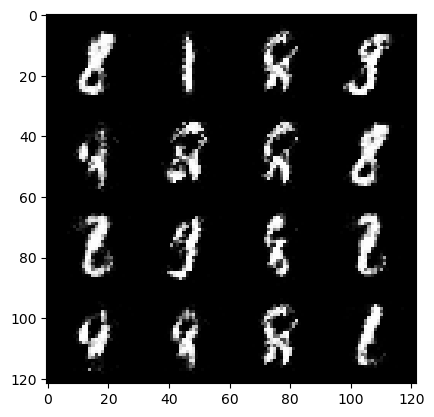

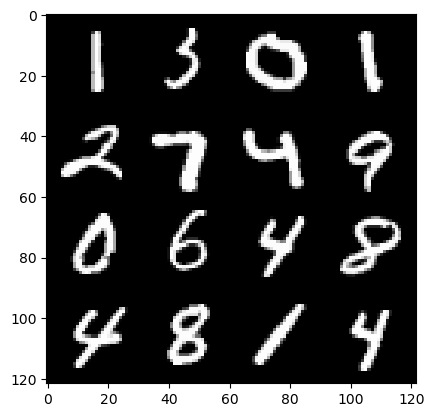

epoch: 56, step: 26400, gen loss: 4.260016150474547, disc loss: 0.09321373685573543.


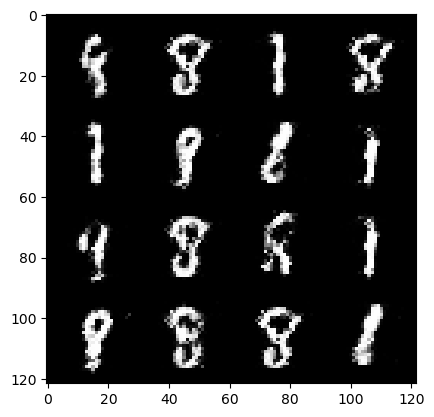

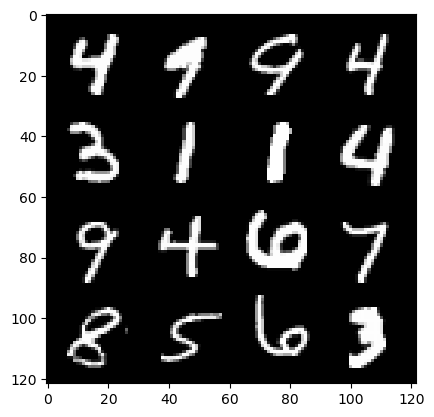

epoch: 56, step: 26700, gen loss: 4.3331021006902075, disc loss: 0.08590901877731083.


  0%|          | 0/469 [00:00<?, ?it/s]

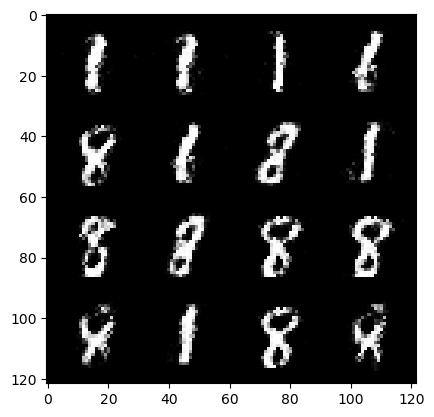

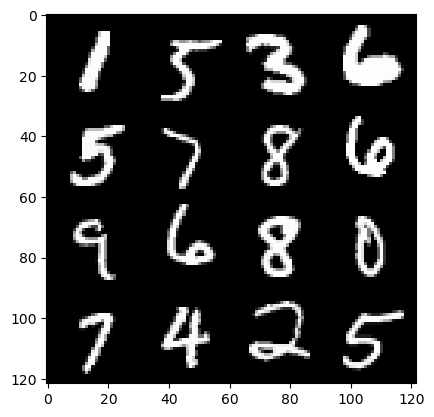

epoch: 57, step: 27000, gen loss: 4.453781194686891, disc loss: 0.08548579356322689.


  0%|          | 0/469 [00:00<?, ?it/s]

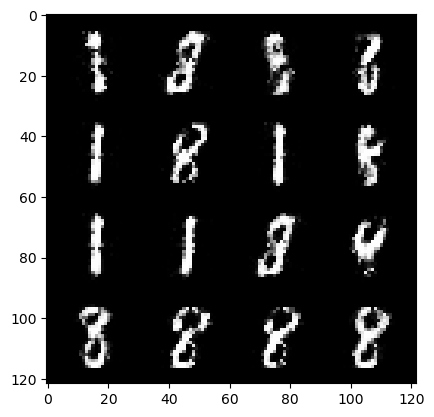

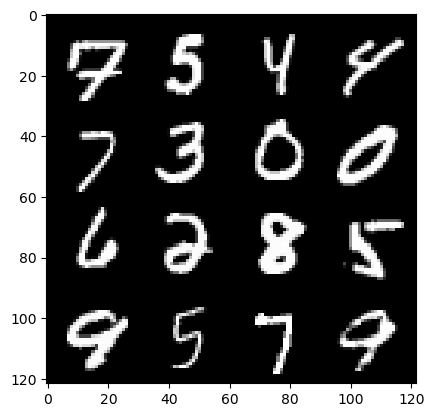

epoch: 58, step: 27300, gen loss: 4.490521896680194, disc loss: 0.09804604890445863.


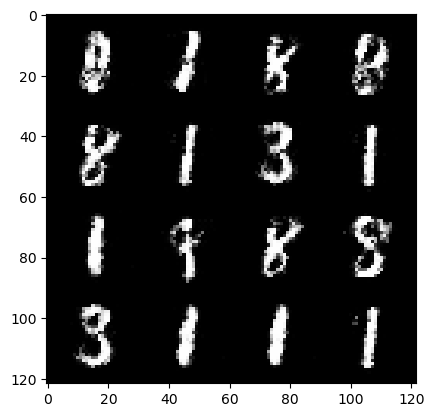

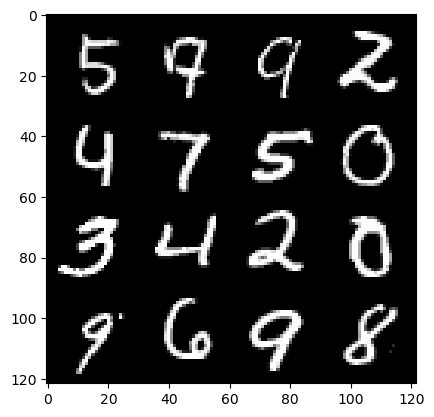

epoch: 58, step: 27600, gen loss: 4.265021061102548, disc loss: 0.12658655760188894.


  0%|          | 0/469 [00:00<?, ?it/s]

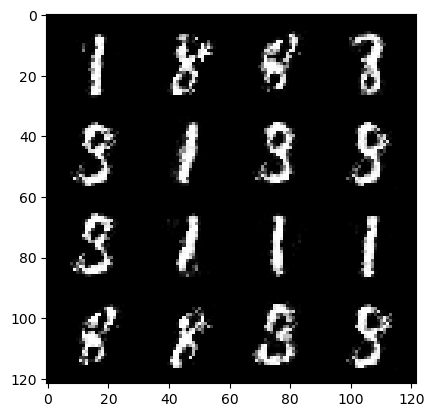

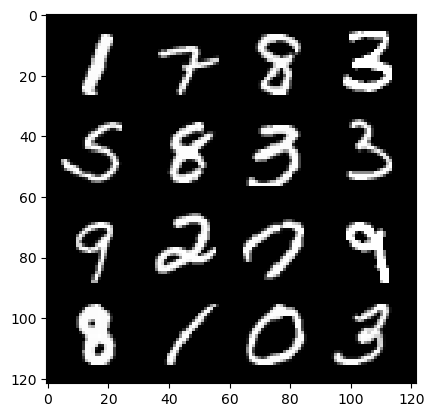

epoch: 59, step: 27900, gen loss: 3.912920344670615, disc loss: 0.11793970206131536.


  0%|          | 0/469 [00:00<?, ?it/s]

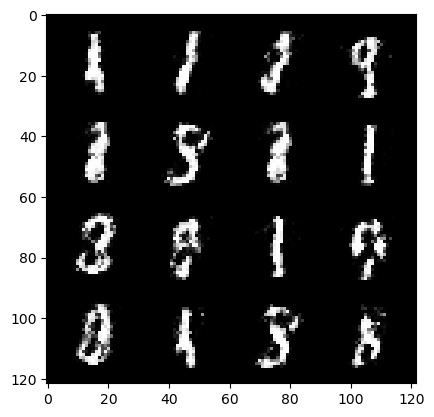

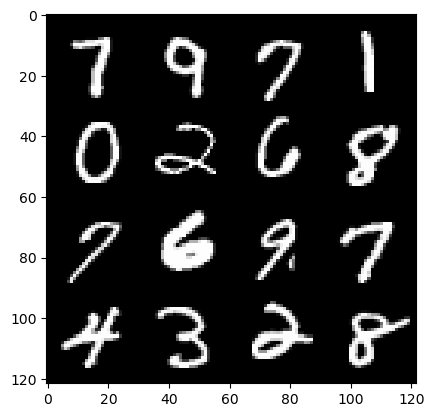

epoch: 60, step: 28200, gen loss: 4.05572707653046, disc loss: 0.10366235208387171.


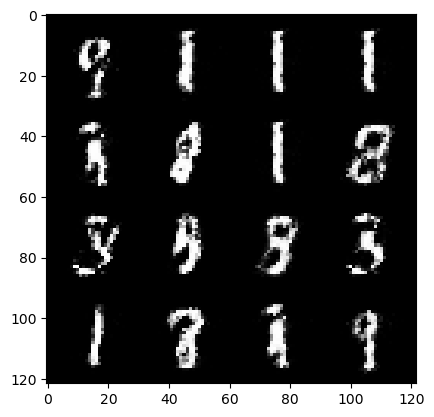

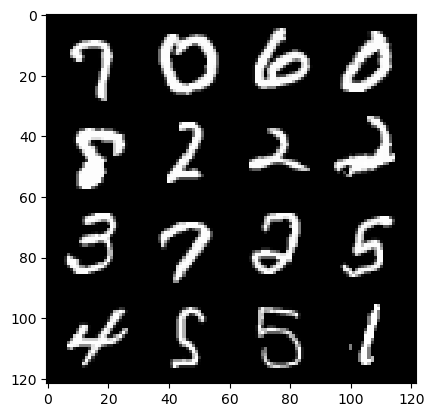

epoch: 60, step: 28500, gen loss: 4.075651737054192, disc loss: 0.11049603136877217.


  0%|          | 0/469 [00:00<?, ?it/s]

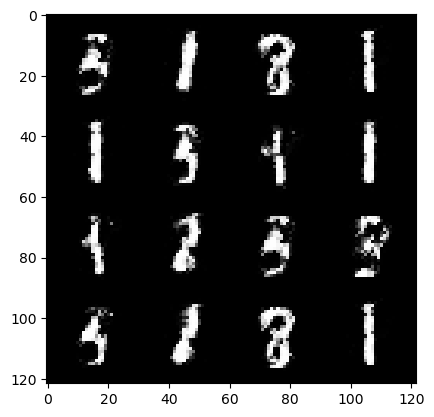

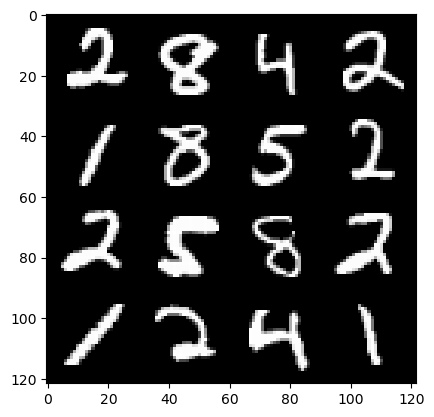

epoch: 61, step: 28800, gen loss: 3.9321900566418932, disc loss: 0.12425179939717051.


  0%|          | 0/469 [00:00<?, ?it/s]

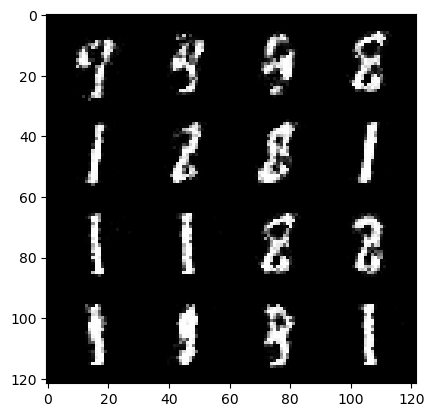

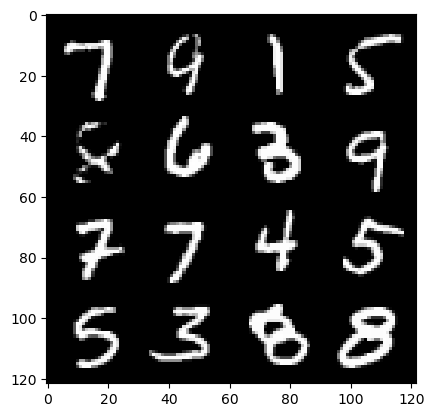

epoch: 62, step: 29100, gen loss: 3.9626110402743038, disc loss: 0.12516599005709098.


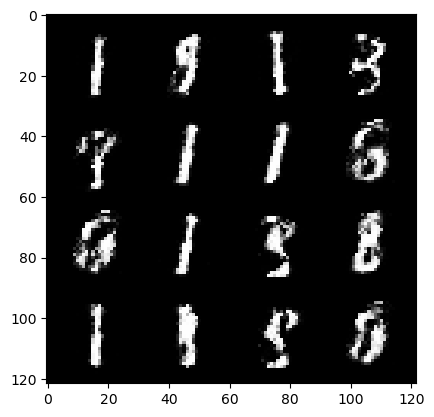

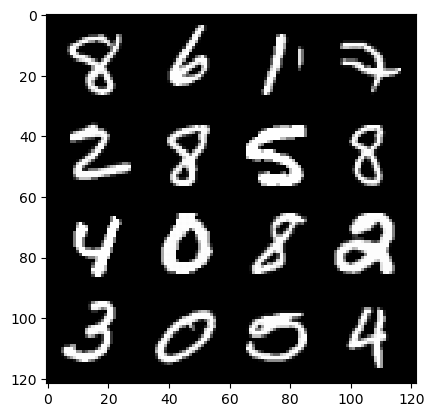

epoch: 62, step: 29400, gen loss: 3.7194488573074325, disc loss: 0.137059357315302.


  0%|          | 0/469 [00:00<?, ?it/s]

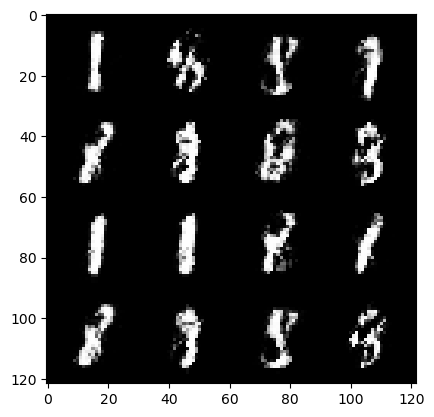

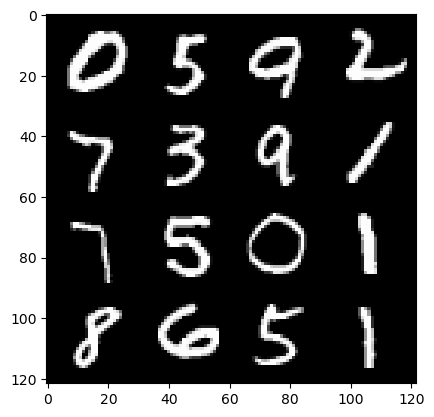

epoch: 63, step: 29700, gen loss: 3.647089558442436, disc loss: 0.1459732518593471.


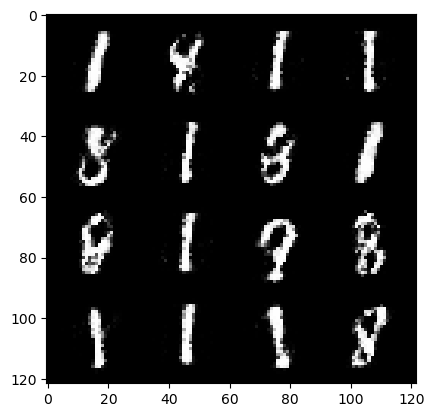

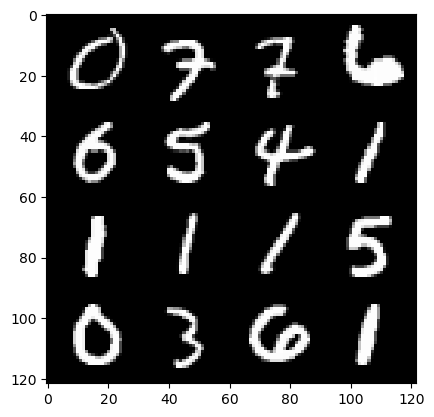

epoch: 63, step: 30000, gen loss: 3.654840678373971, disc loss: 0.12968575820326803.


  0%|          | 0/469 [00:00<?, ?it/s]

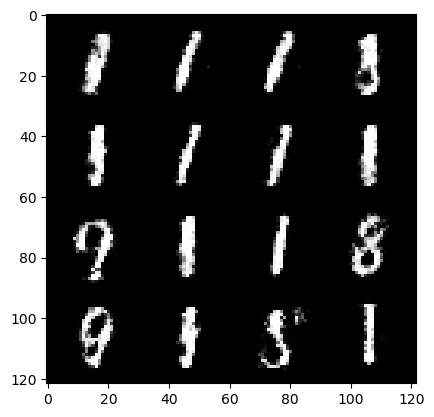

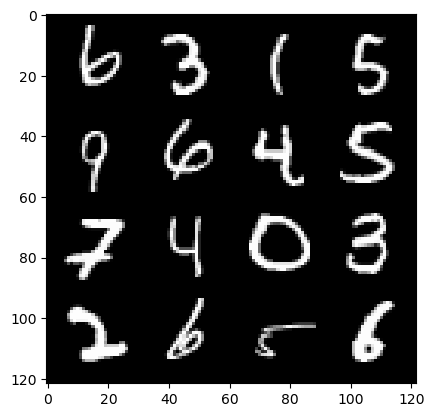

epoch: 64, step: 30300, gen loss: 3.6448836350440974, disc loss: 0.1343312448759873.


  0%|          | 0/469 [00:00<?, ?it/s]

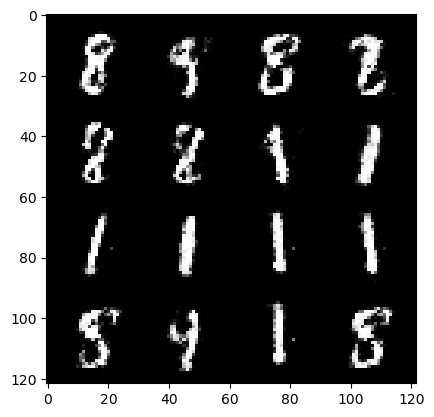

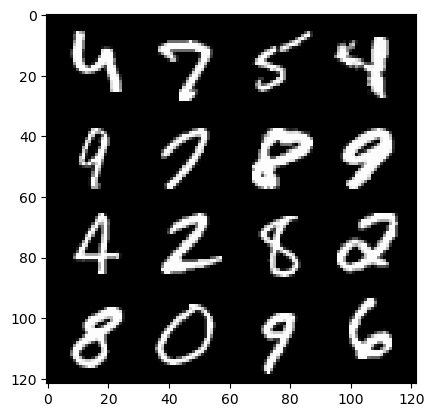

epoch: 65, step: 30600, gen loss: 3.68798723141352, disc loss: 0.1326493450875084.


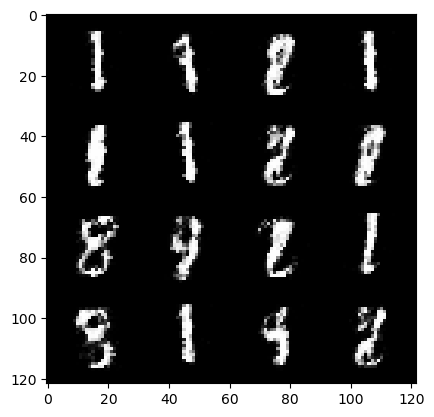

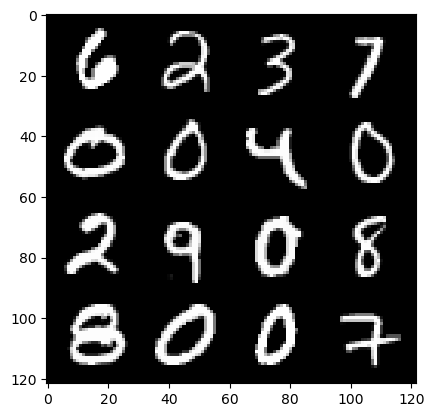

epoch: 65, step: 30900, gen loss: 3.3114714471499105, disc loss: 0.1692424333840608.


  0%|          | 0/469 [00:00<?, ?it/s]

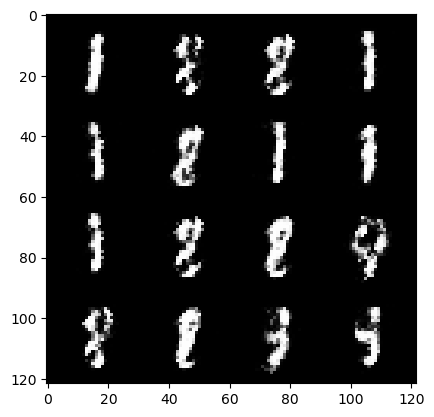

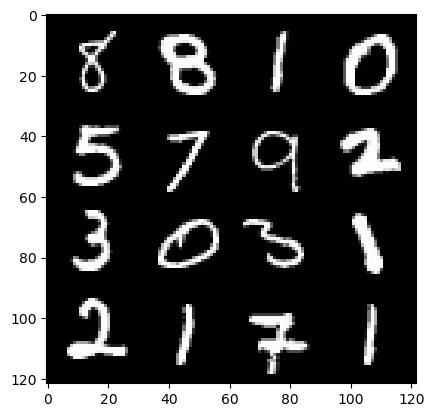

epoch: 66, step: 31200, gen loss: 3.4251640574137374, disc loss: 0.15235916962226226.


  0%|          | 0/469 [00:00<?, ?it/s]

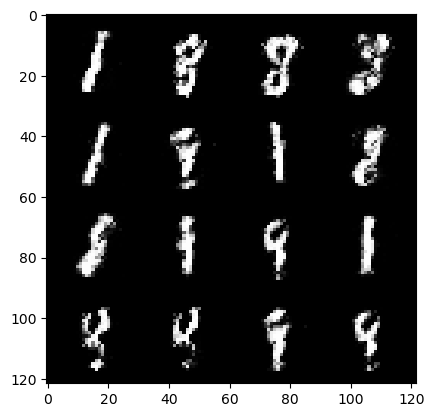

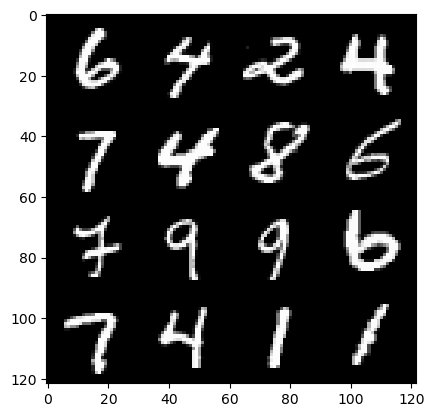

epoch: 67, step: 31500, gen loss: 3.5807107615470897, disc loss: 0.13738388434052454.


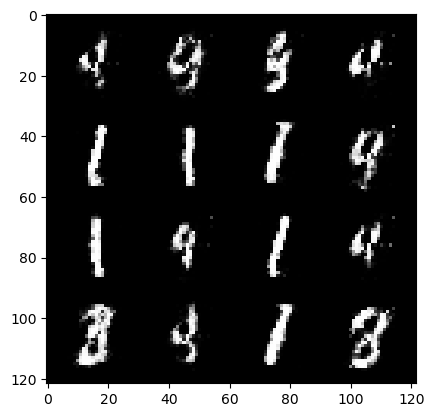

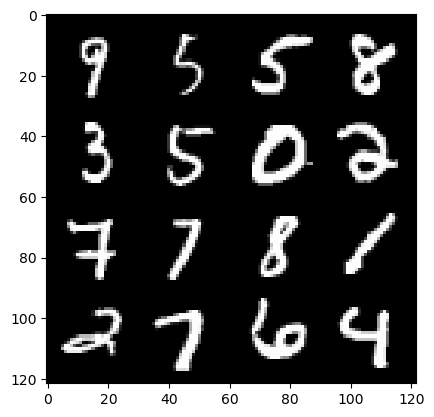

epoch: 67, step: 31800, gen loss: 3.419659554958339, disc loss: 0.18117703375717015.


  0%|          | 0/469 [00:00<?, ?it/s]

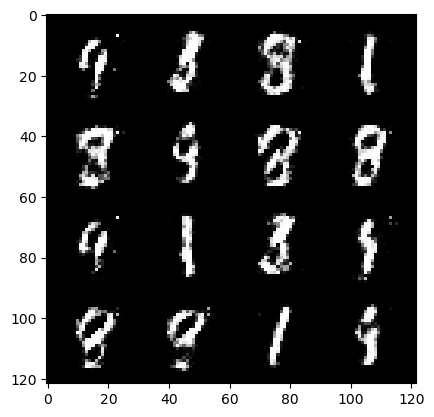

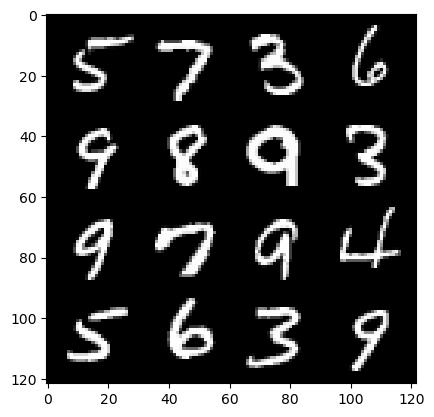

epoch: 68, step: 32100, gen loss: 3.336415177981059, disc loss: 0.1669945681343477.


  0%|          | 0/469 [00:00<?, ?it/s]

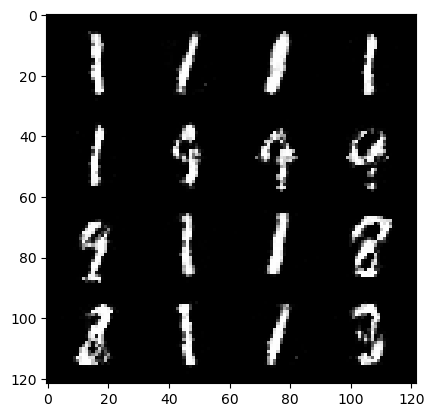

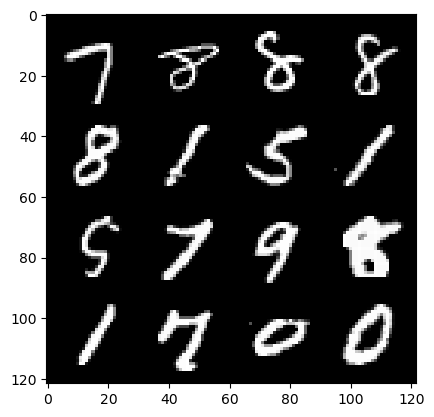

epoch: 69, step: 32400, gen loss: 3.4284511947631855, disc loss: 0.14875166215002528.


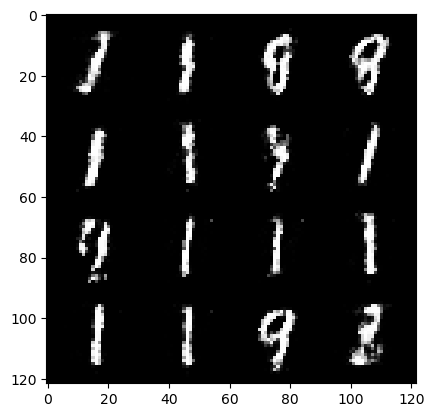

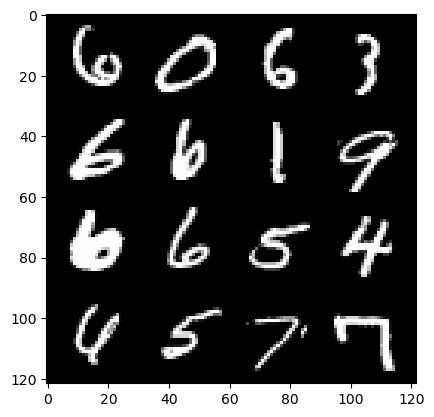

epoch: 69, step: 32700, gen loss: 3.3110552700360634, disc loss: 0.17599162896474194.


  0%|          | 0/469 [00:00<?, ?it/s]

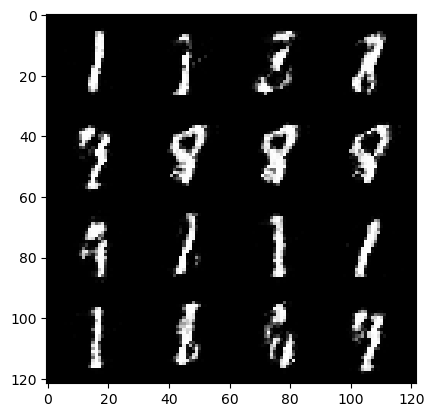

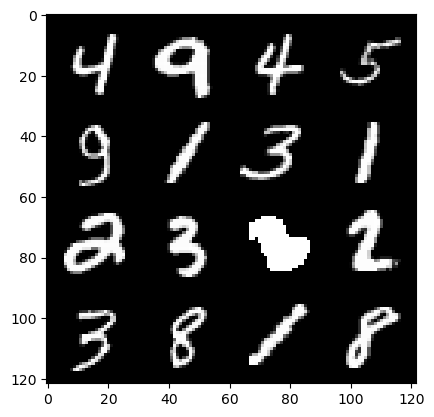

epoch: 70, step: 33000, gen loss: 3.088390368620554, disc loss: 0.18512315387527137.


  0%|          | 0/469 [00:00<?, ?it/s]

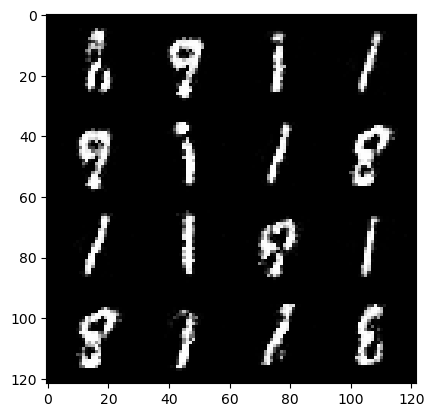

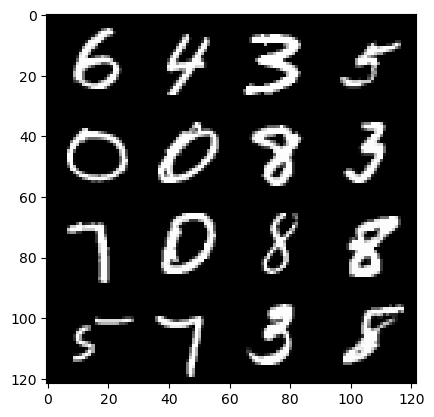

epoch: 71, step: 33300, gen loss: 3.1342541559537227, disc loss: 0.1912755490839481.


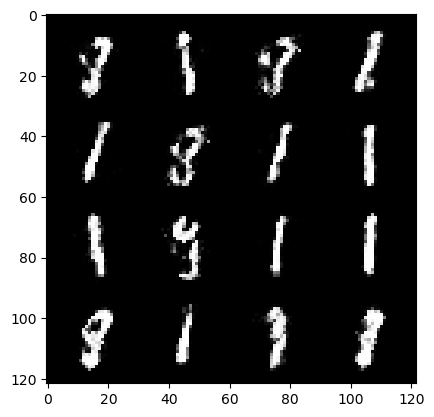

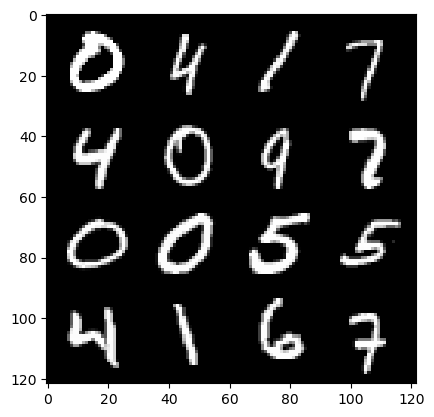

epoch: 71, step: 33600, gen loss: 3.1591467603047683, disc loss: 0.17627273542185629.


  0%|          | 0/469 [00:00<?, ?it/s]

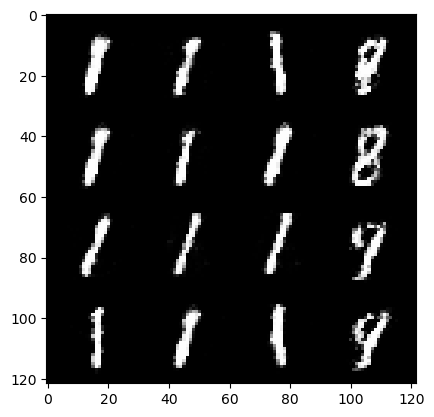

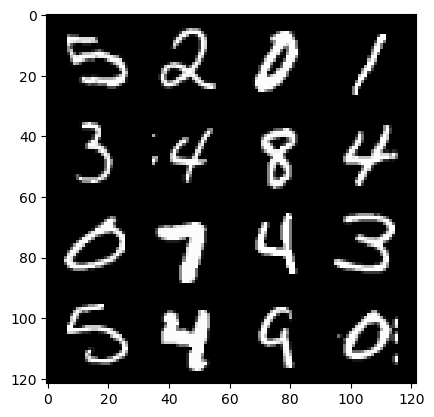

epoch: 72, step: 33900, gen loss: 3.054003542264305, disc loss: 0.19953617259860032.


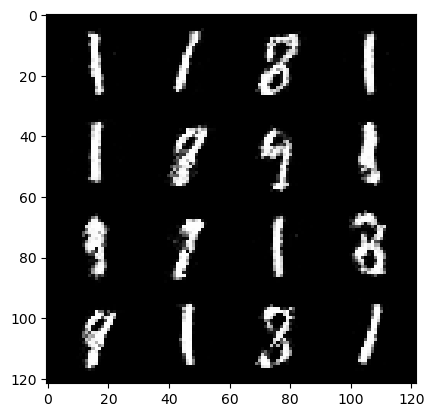

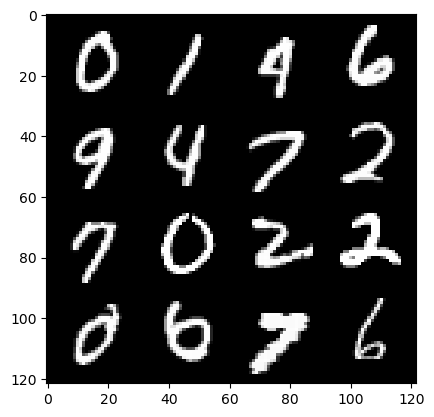

epoch: 72, step: 34200, gen loss: 2.9739744369188936, disc loss: 0.18989302083849902.


  0%|          | 0/469 [00:00<?, ?it/s]

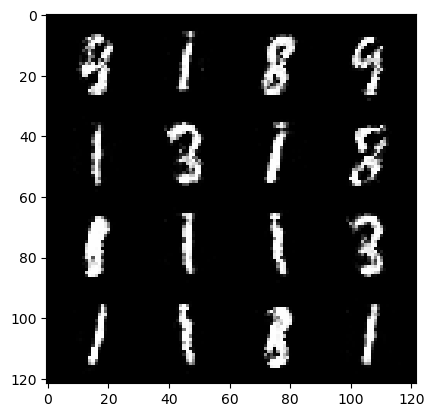

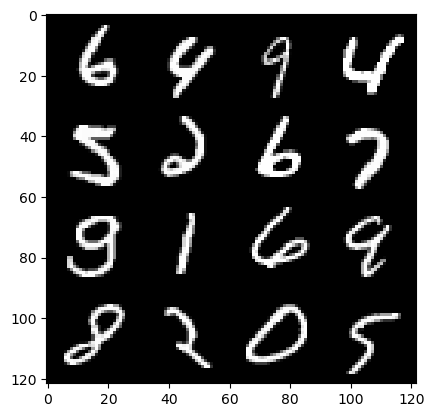

epoch: 73, step: 34500, gen loss: 2.9033649396896375, disc loss: 0.19794971379141016.


  0%|          | 0/469 [00:00<?, ?it/s]

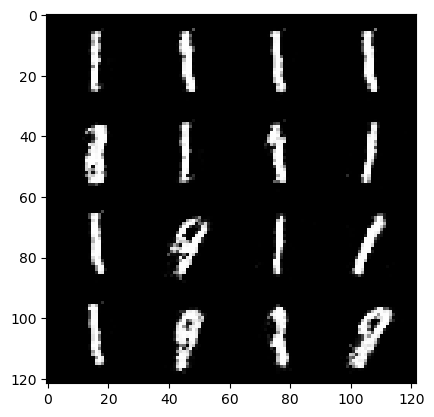

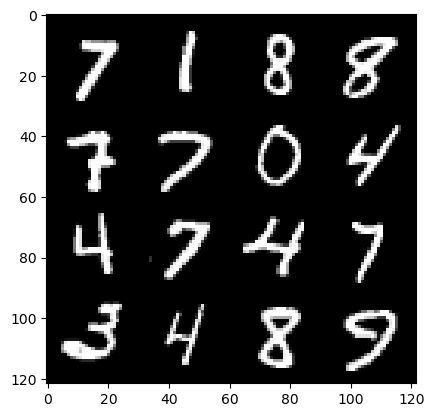

epoch: 74, step: 34800, gen loss: 2.9533391880989073, disc loss: 0.1858500804007053.


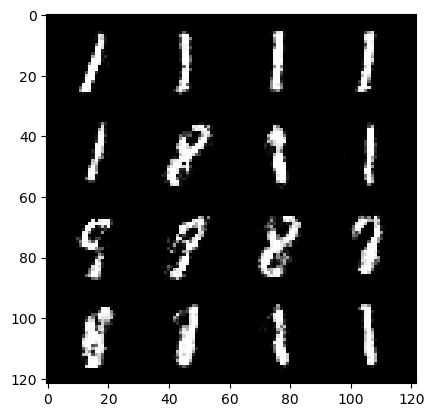

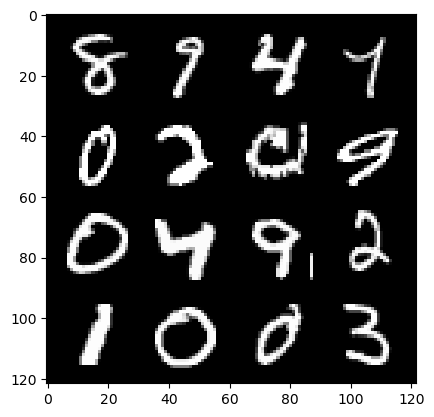

epoch: 74, step: 35100, gen loss: 2.837457192738851, disc loss: 0.19404896152516218.


  0%|          | 0/469 [00:00<?, ?it/s]

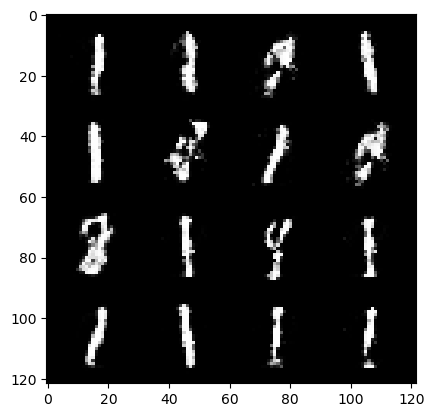

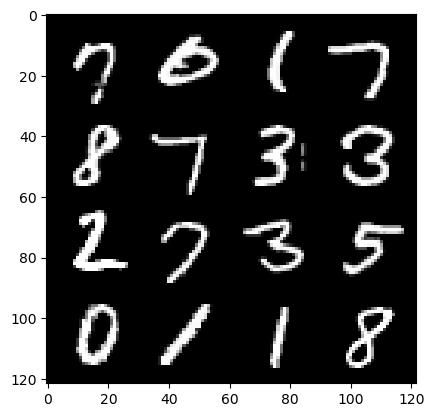

epoch: 75, step: 35400, gen loss: 2.7798760676383965, disc loss: 0.21169749384125072.


  0%|          | 0/469 [00:00<?, ?it/s]

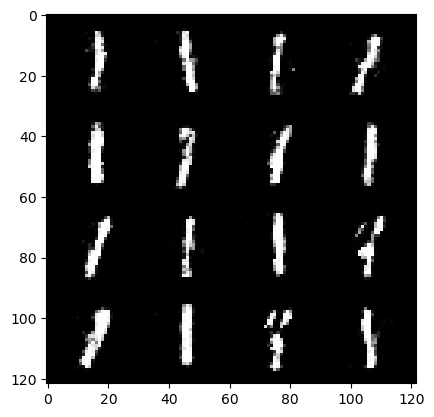

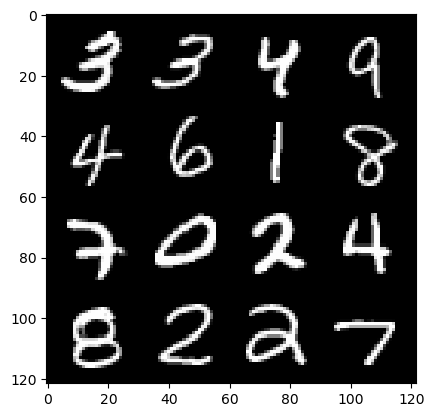

epoch: 76, step: 35700, gen loss: 2.8012085350354505, disc loss: 0.2094484798113505.


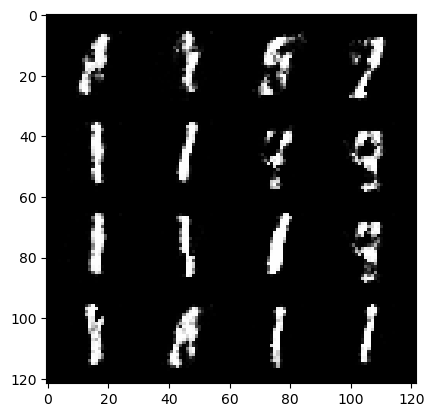

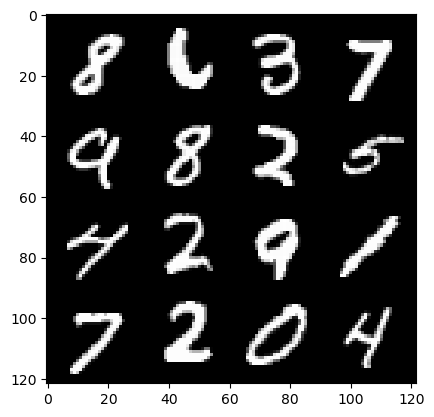

epoch: 76, step: 36000, gen loss: 2.7971913353602087, disc loss: 0.1971610919386149.


  0%|          | 0/469 [00:00<?, ?it/s]

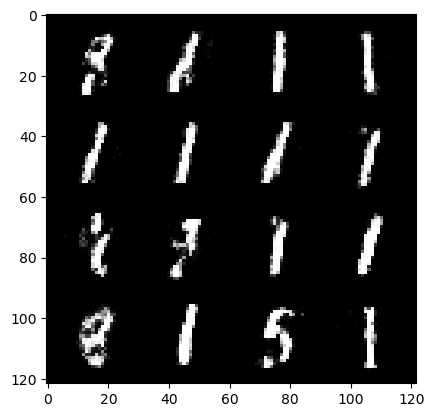

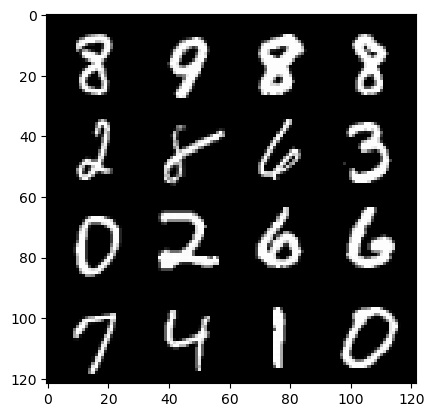

epoch: 77, step: 36300, gen loss: 2.7511212555567424, disc loss: 0.2054755374540886.


  0%|          | 0/469 [00:00<?, ?it/s]

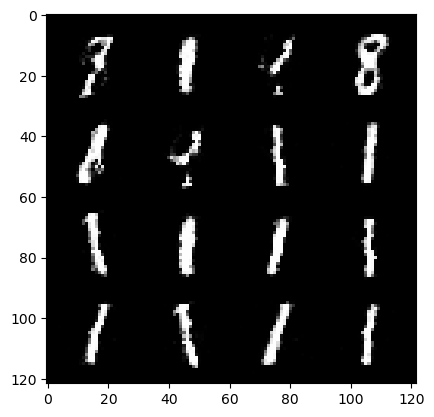

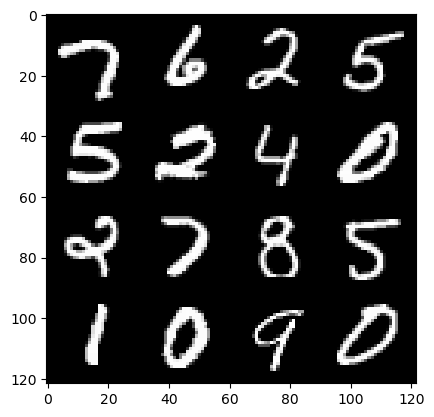

epoch: 78, step: 36600, gen loss: 2.6673985250790917, disc loss: 0.20418480642139894.


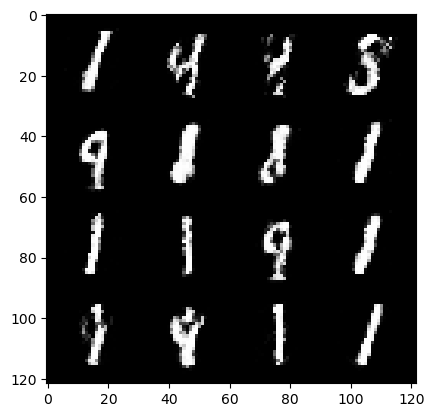

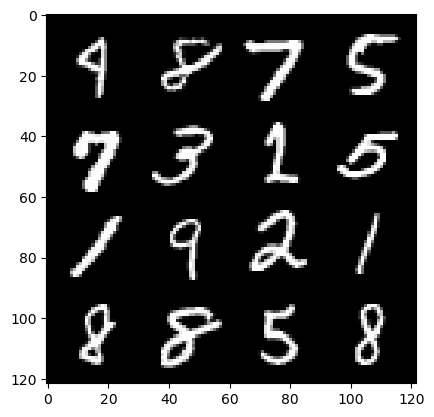

epoch: 78, step: 36900, gen loss: 2.669025123914085, disc loss: 0.20977837237219008.


  0%|          | 0/469 [00:00<?, ?it/s]

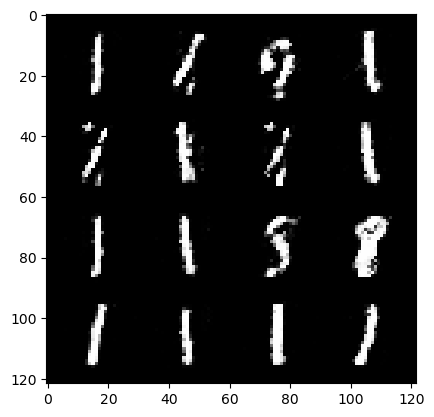

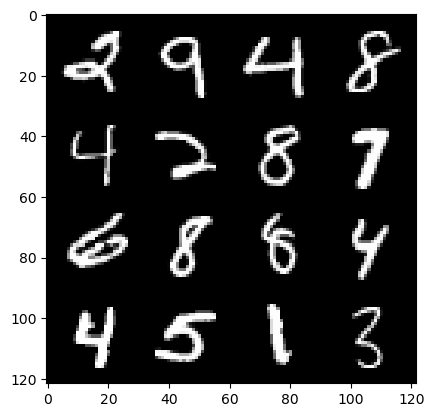

epoch: 79, step: 37200, gen loss: 2.6124560936292003, disc loss: 0.21235326809187727.


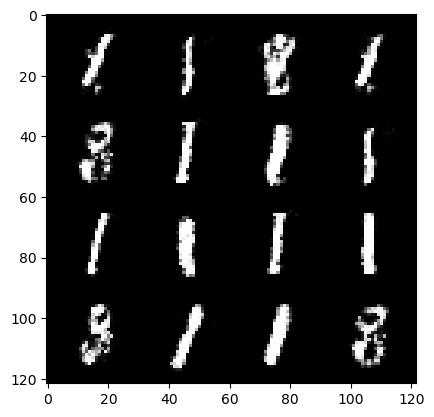

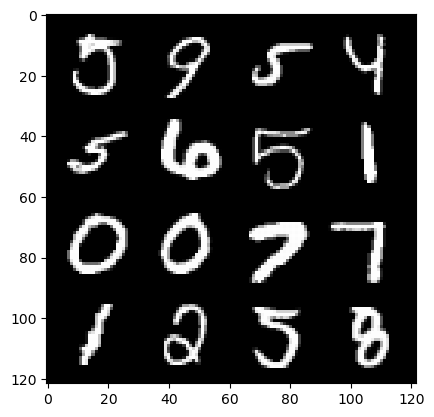

epoch: 79, step: 37500, gen loss: 2.593471227486929, disc loss: 0.21432245214780174.


  0%|          | 0/469 [00:00<?, ?it/s]

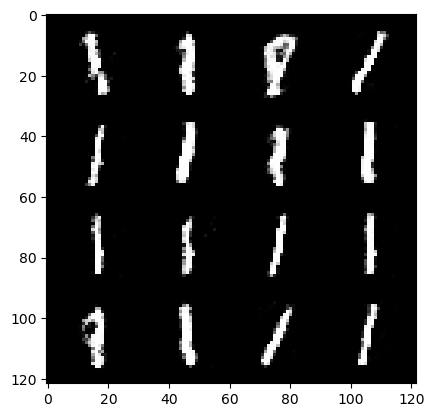

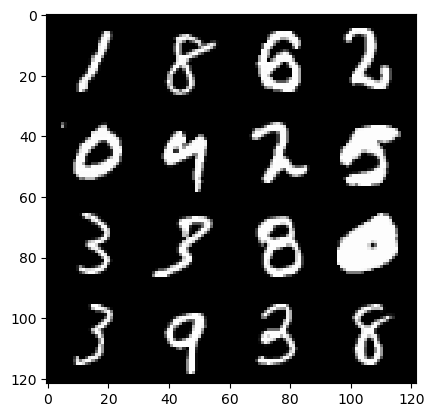

epoch: 80, step: 37800, gen loss: 2.6073953382174184, disc loss: 0.2076381192853053.


  0%|          | 0/469 [00:00<?, ?it/s]

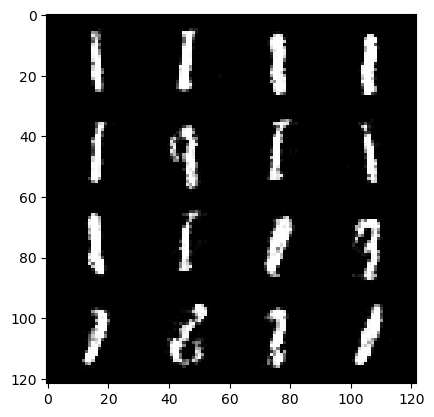

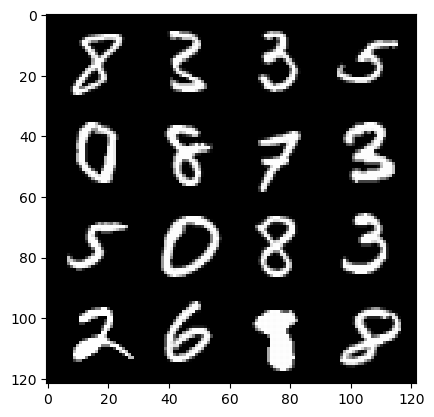

epoch: 81, step: 38100, gen loss: 2.536090395450592, disc loss: 0.21066895989080275.


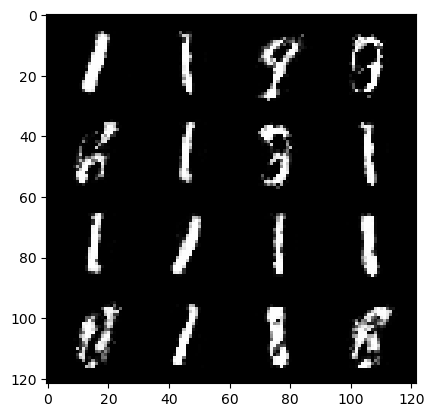

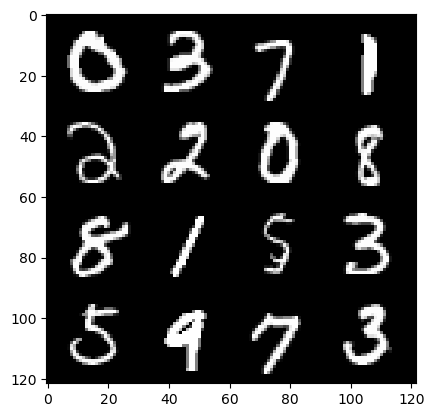

epoch: 81, step: 38400, gen loss: 2.514021749496456, disc loss: 0.22343937600652375.


  0%|          | 0/469 [00:00<?, ?it/s]

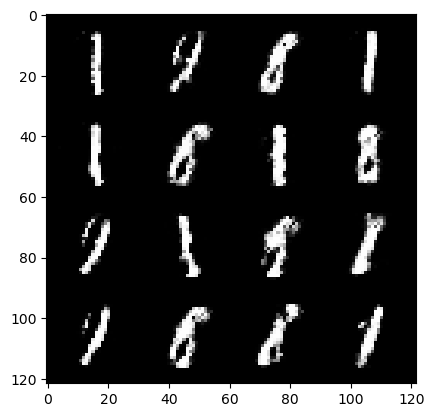

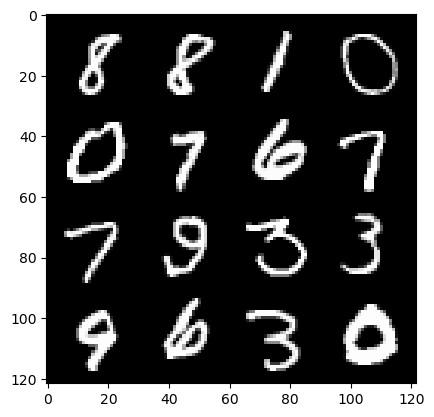

epoch: 82, step: 38700, gen loss: 2.47233696460724, disc loss: 0.2228770014395316.


  0%|          | 0/469 [00:00<?, ?it/s]

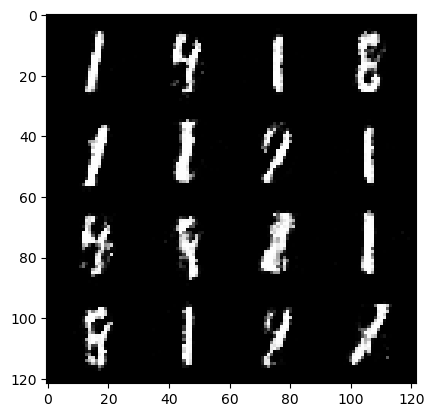

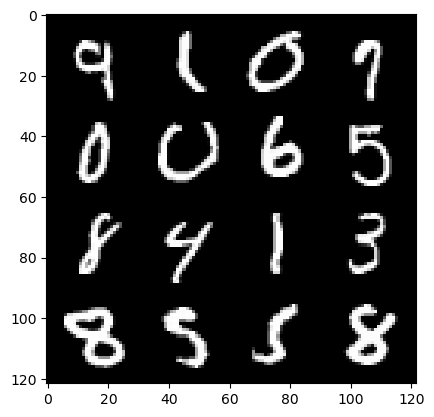

epoch: 83, step: 39000, gen loss: 2.5135728855927777, disc loss: 0.21527776616315047.


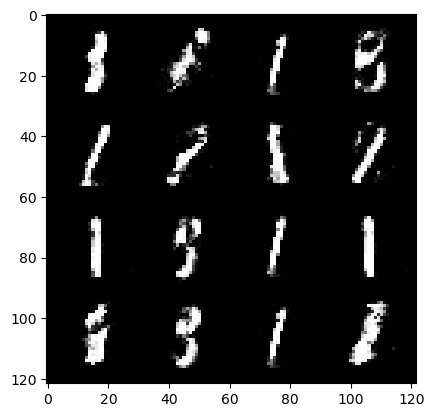

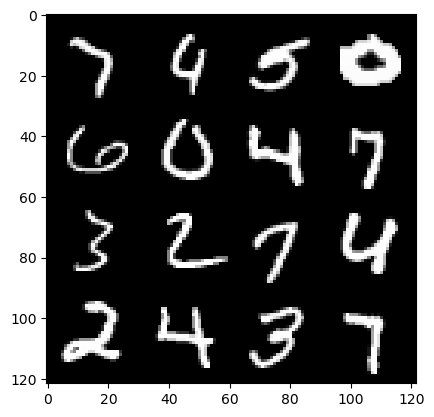

epoch: 83, step: 39300, gen loss: 2.4894833914438874, disc loss: 0.2170843979219596.


  0%|          | 0/469 [00:00<?, ?it/s]

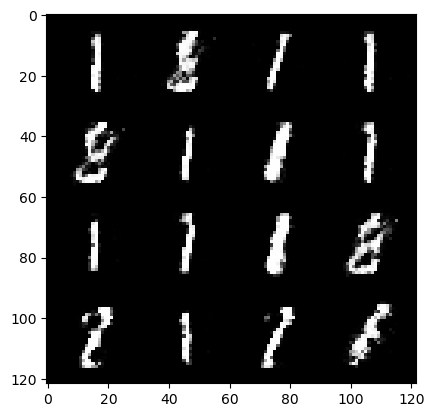

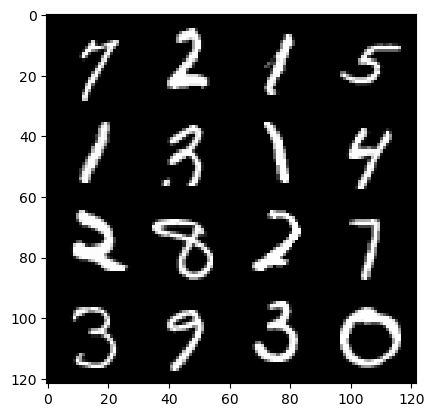

epoch: 84, step: 39600, gen loss: 2.471261265277862, disc loss: 0.21769847614069776.


  0%|          | 0/469 [00:00<?, ?it/s]

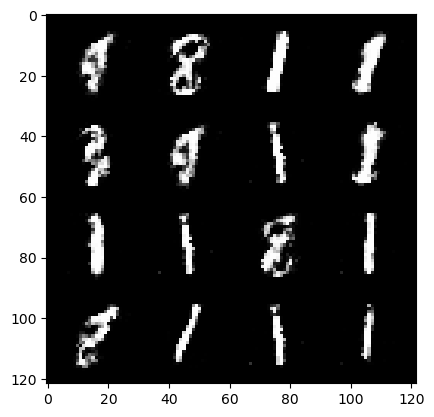

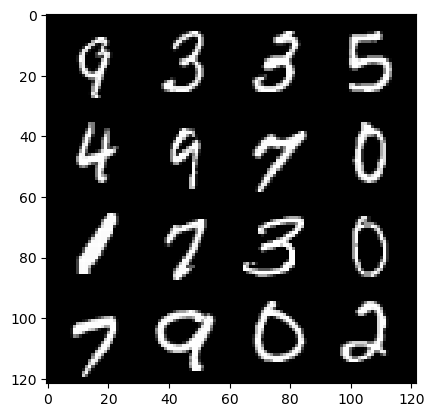

epoch: 85, step: 39900, gen loss: 2.482901432514189, disc loss: 0.20631977652510003.


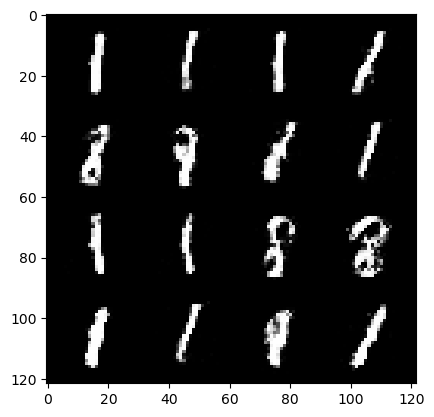

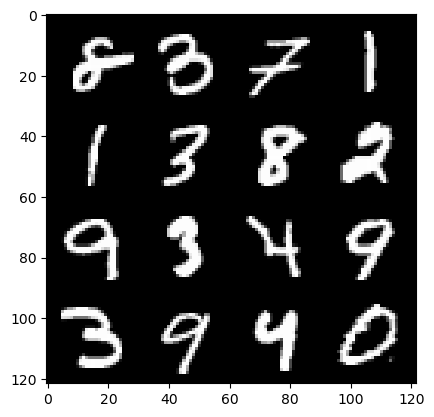

epoch: 85, step: 40200, gen loss: 2.4609094254175807, disc loss: 0.21319323368370535.


  0%|          | 0/469 [00:00<?, ?it/s]

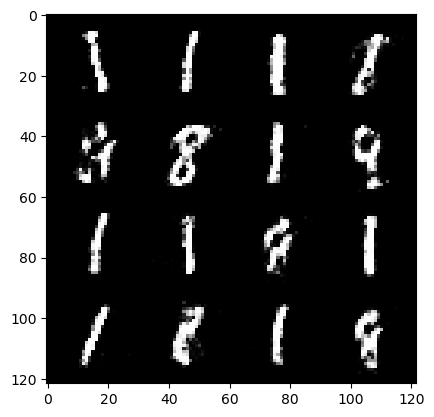

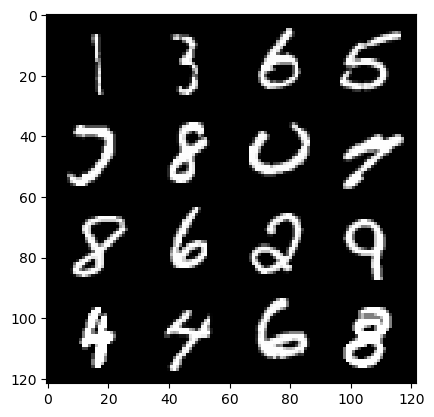

epoch: 86, step: 40500, gen loss: 2.462675991853076, disc loss: 0.21797149141629543.


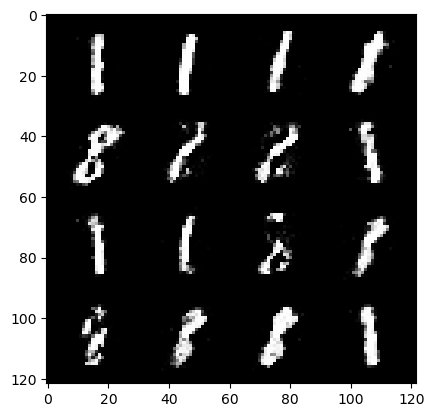

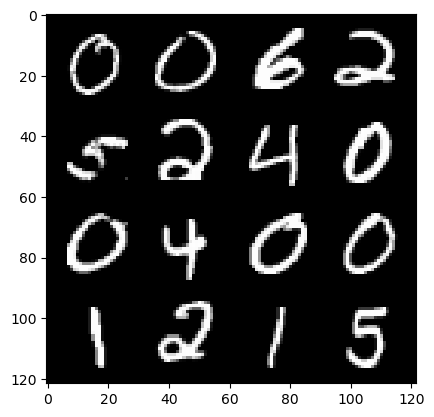

epoch: 86, step: 40800, gen loss: 2.450197188854218, disc loss: 0.21960554912686353.


  0%|          | 0/469 [00:00<?, ?it/s]

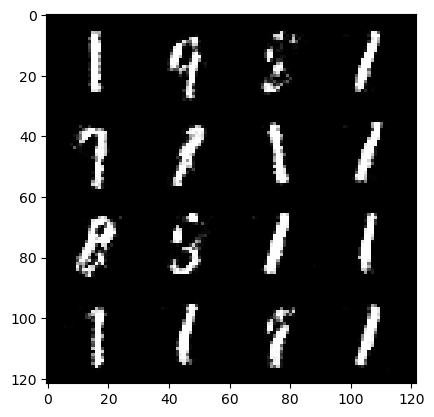

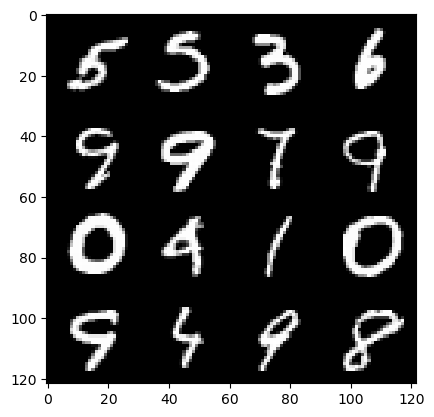

epoch: 87, step: 41100, gen loss: 2.4789517045021046, disc loss: 0.20778299773732822.


  0%|          | 0/469 [00:00<?, ?it/s]

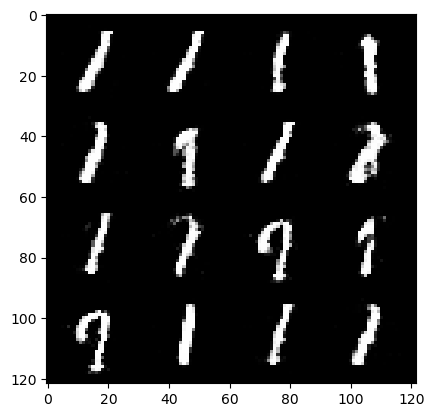

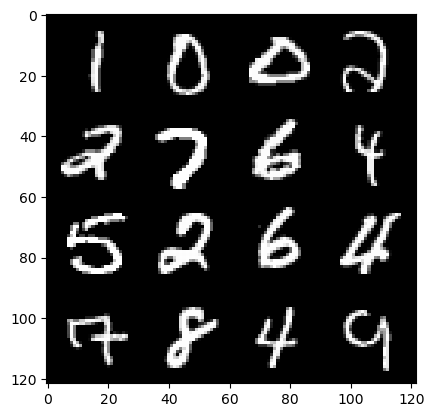

epoch: 88, step: 41400, gen loss: 2.4292864243189487, disc loss: 0.22357267816861456.


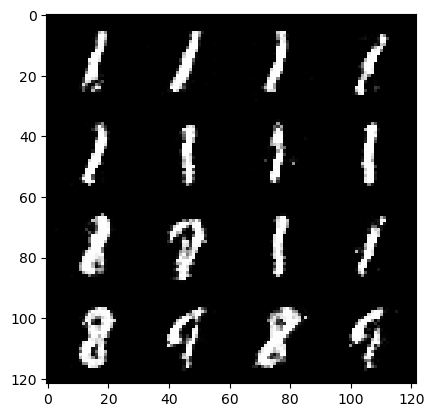

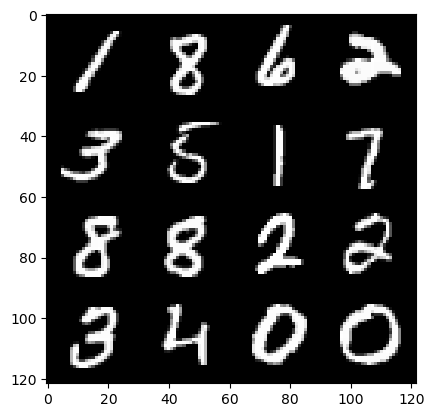

epoch: 88, step: 41700, gen loss: 2.427814674774805, disc loss: 0.2112260172267755.


  0%|          | 0/469 [00:00<?, ?it/s]

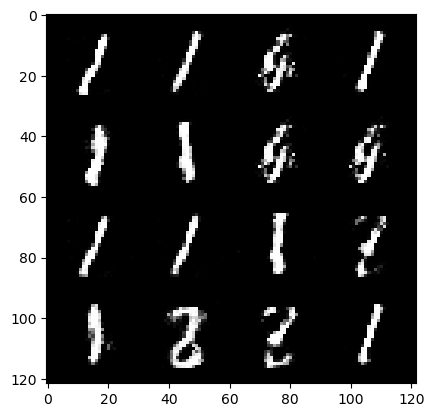

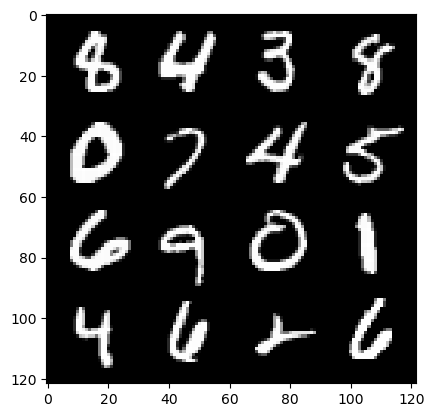

epoch: 89, step: 42000, gen loss: 2.4891560641924553, disc loss: 0.20111449432869755.


  0%|          | 0/469 [00:00<?, ?it/s]

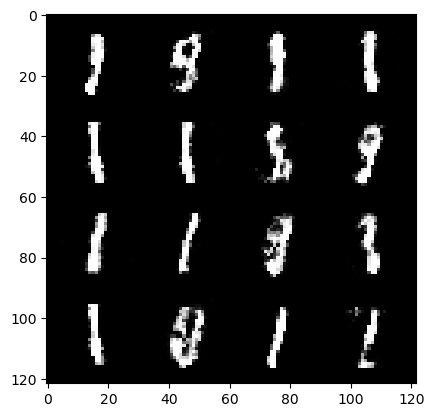

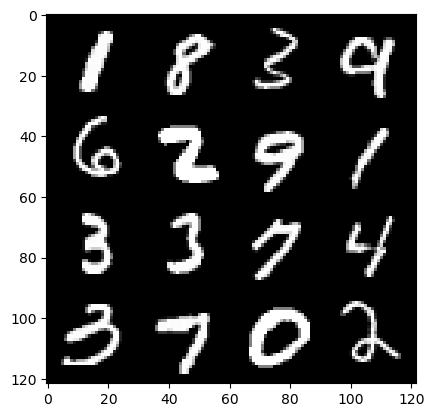

epoch: 90, step: 42300, gen loss: 2.474874027172726, disc loss: 0.19924951160947488.


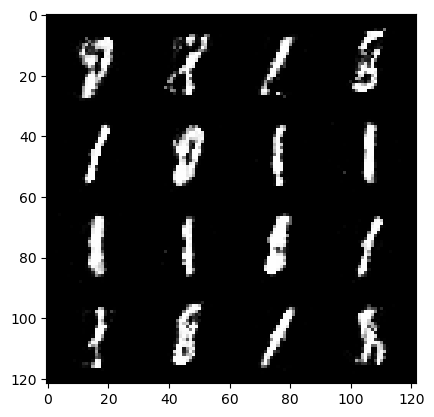

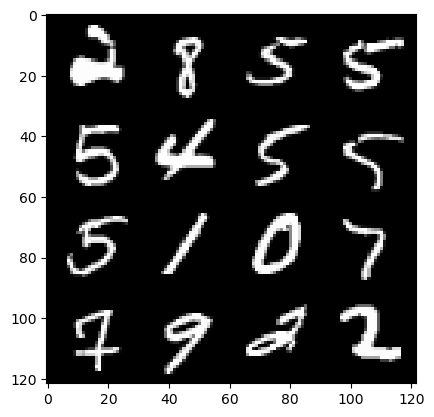

epoch: 90, step: 42600, gen loss: 2.4813701168696083, disc loss: 0.20077036969363674.


  0%|          | 0/469 [00:00<?, ?it/s]

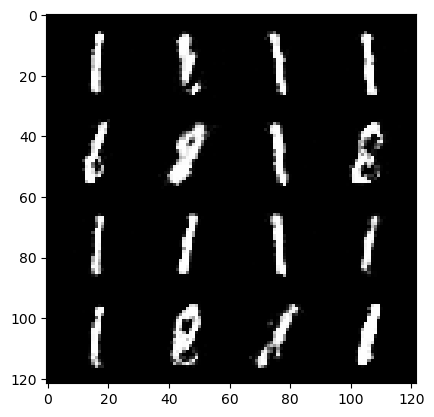

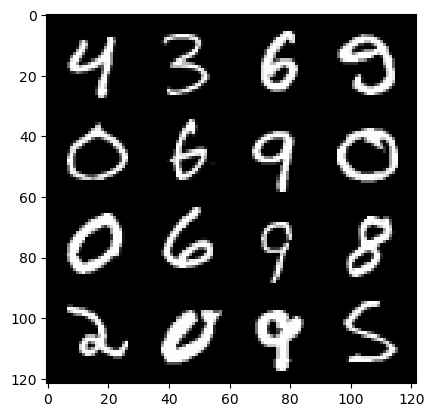

epoch: 91, step: 42900, gen loss: 2.473038388093313, disc loss: 0.21392334781587125.


  0%|          | 0/469 [00:00<?, ?it/s]

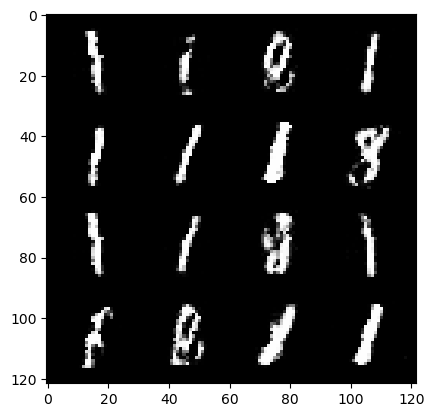

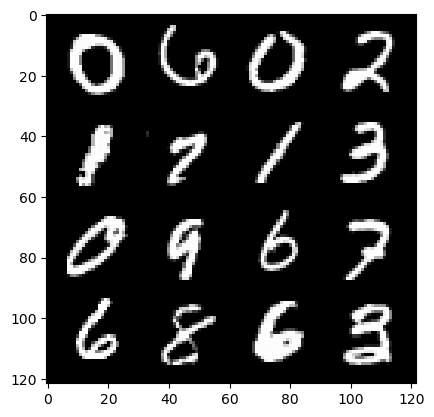

epoch: 92, step: 43200, gen loss: 2.3727446258068103, disc loss: 0.22316387529174486.


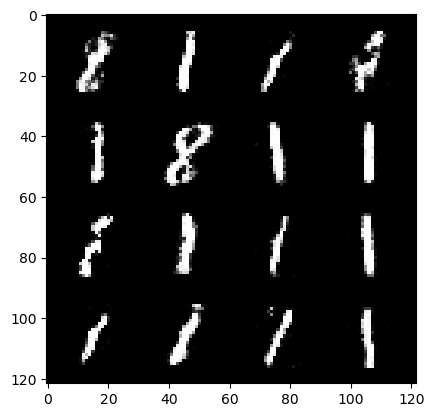

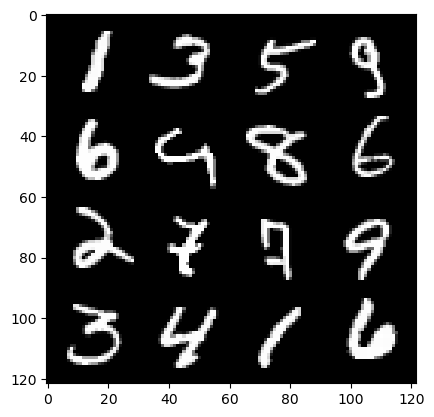

epoch: 92, step: 43500, gen loss: 2.3749745655059797, disc loss: 0.22410135194659248.


  0%|          | 0/469 [00:00<?, ?it/s]

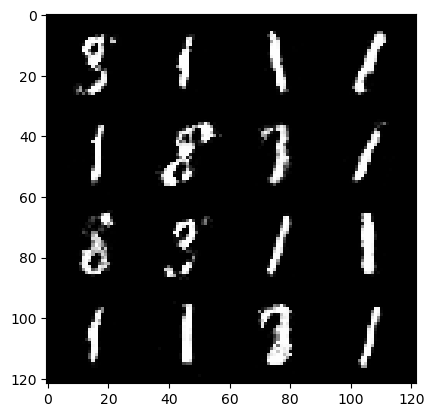

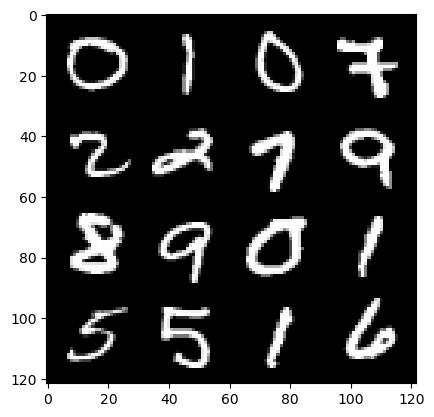

epoch: 93, step: 43800, gen loss: 2.3517777903874717, disc loss: 0.21849216818809486.


  0%|          | 0/469 [00:00<?, ?it/s]

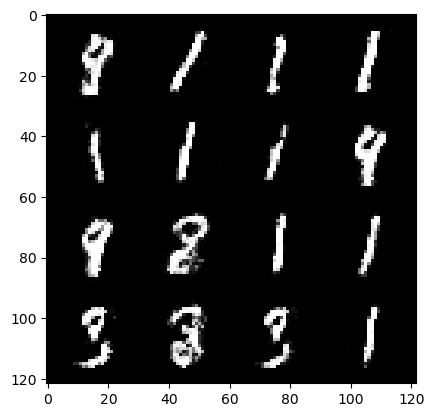

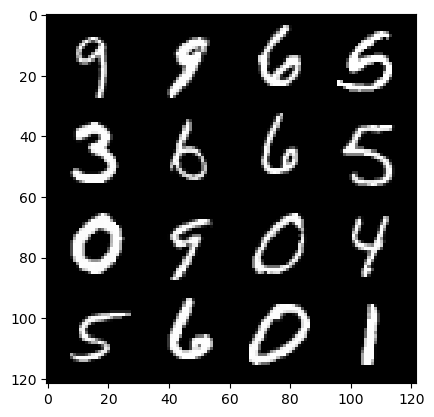

epoch: 94, step: 44100, gen loss: 2.3623826165994006, disc loss: 0.21634072683751573.


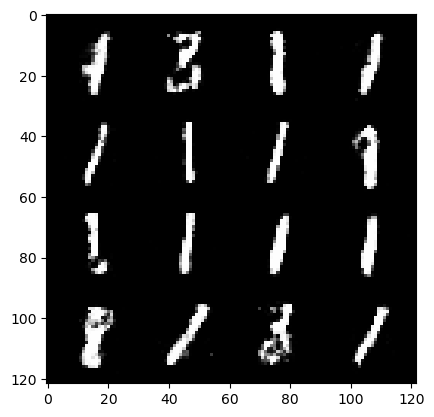

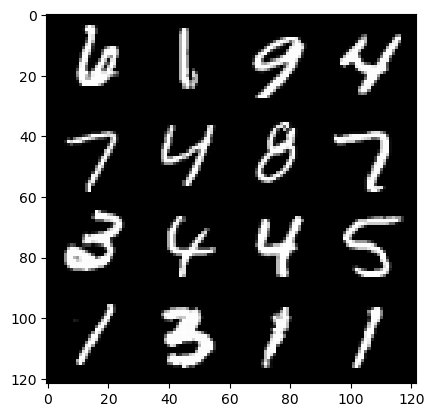

epoch: 94, step: 44400, gen loss: 2.3015119024117765, disc loss: 0.22965560466051088.


  0%|          | 0/469 [00:00<?, ?it/s]

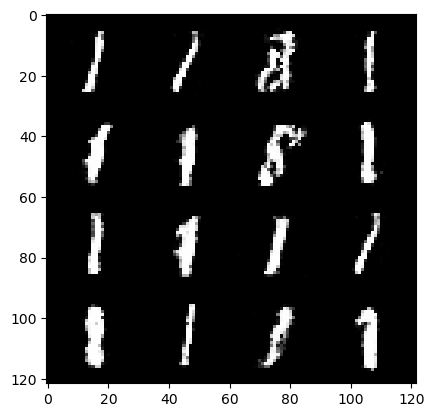

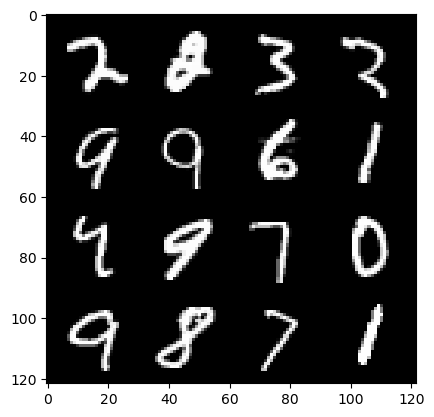

epoch: 95, step: 44700, gen loss: 2.253222579558691, disc loss: 0.2343420382837453.


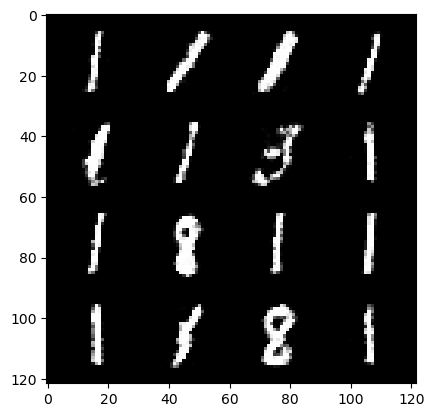

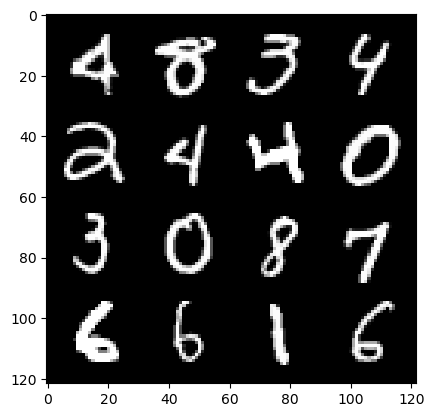

epoch: 95, step: 45000, gen loss: 2.291578822930656, disc loss: 0.21928878327210727.


  0%|          | 0/469 [00:00<?, ?it/s]

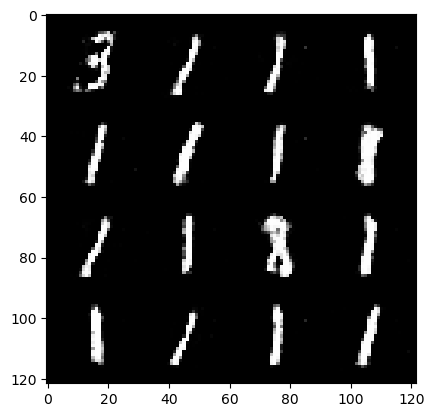

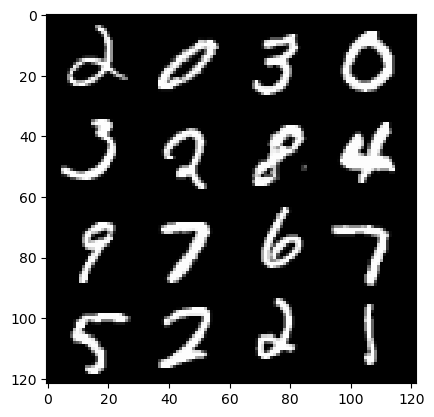

epoch: 96, step: 45300, gen loss: 2.3260106801986686, disc loss: 0.21964944904049244.


  0%|          | 0/469 [00:00<?, ?it/s]

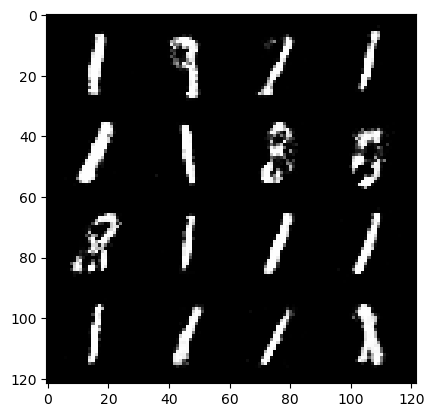

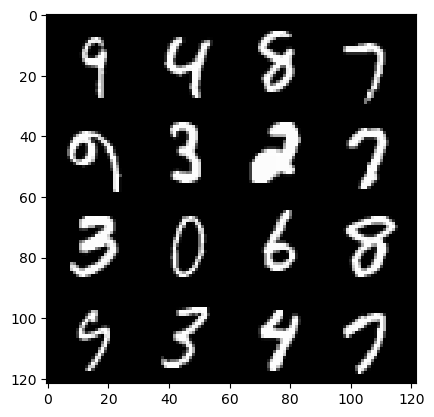

epoch: 97, step: 45600, gen loss: 2.2955938919385277, disc loss: 0.22721789658069594.


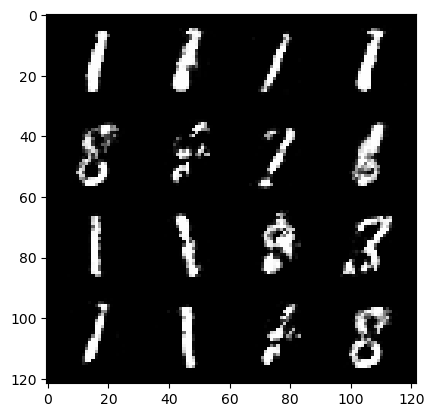

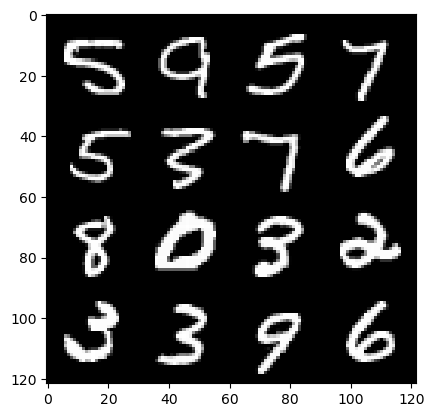

epoch: 97, step: 45900, gen loss: 2.2356886883576714, disc loss: 0.2412203766902287.


  0%|          | 0/469 [00:00<?, ?it/s]

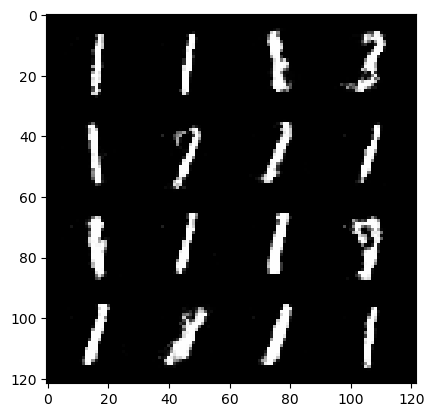

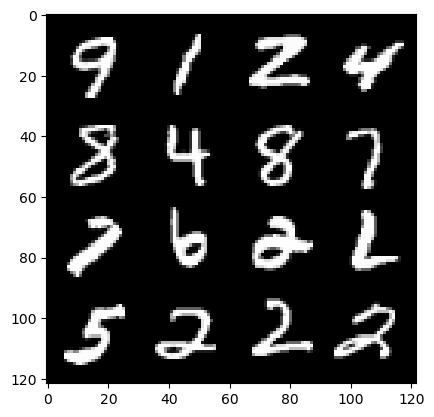

epoch: 98, step: 46200, gen loss: 2.209106812079748, disc loss: 0.24273403644561758.


  0%|          | 0/469 [00:00<?, ?it/s]

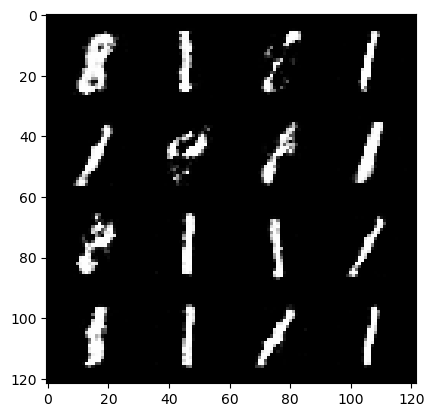

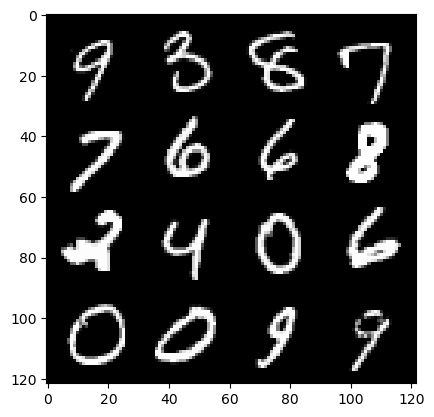

epoch: 99, step: 46500, gen loss: 2.2761453100045532, disc loss: 0.22683520560463272.


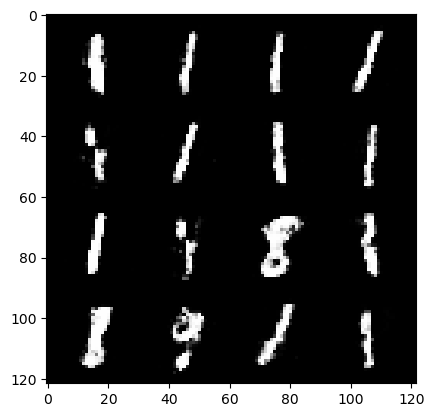

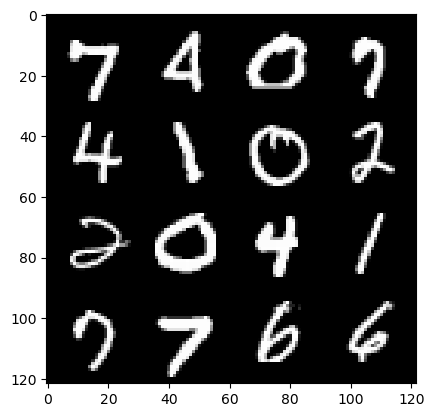

epoch: 99, step: 46800, gen loss: 2.2281082236766814, disc loss: 0.23613489593068768.


  0%|          | 0/469 [00:00<?, ?it/s]

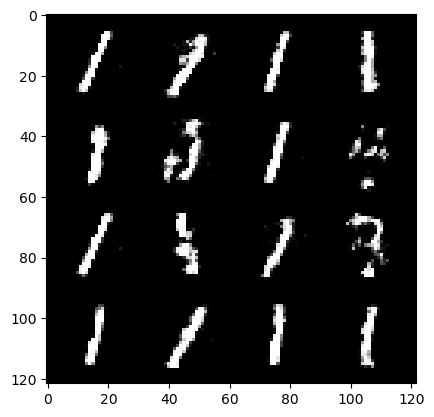

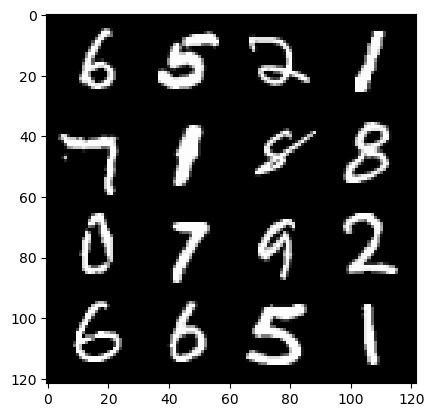

epoch: 100, step: 47100, gen loss: 2.1421301611264556, disc loss: 0.25957199901342415.


  0%|          | 0/469 [00:00<?, ?it/s]

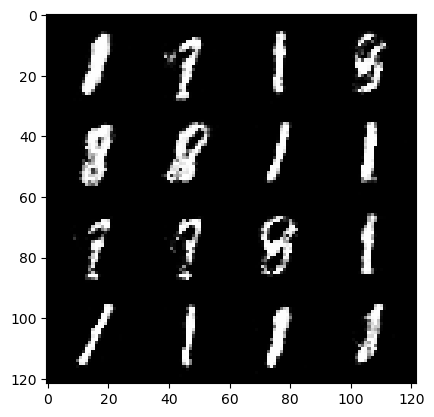

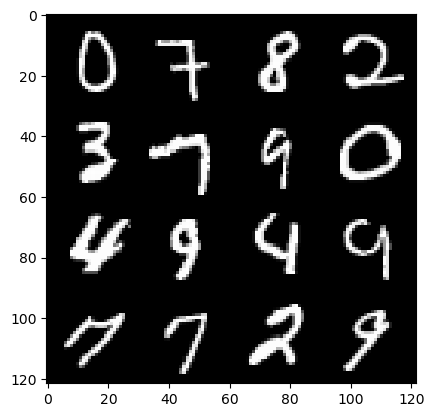

epoch: 101, step: 47400, gen loss: 2.143255678415298, disc loss: 0.24969308877984686.


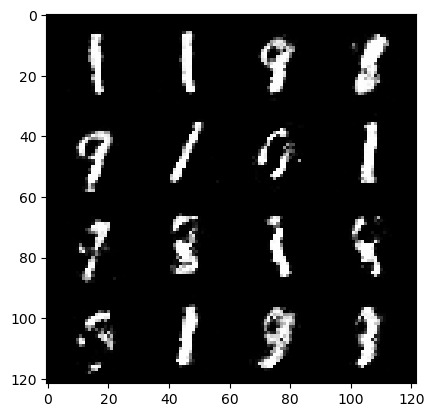

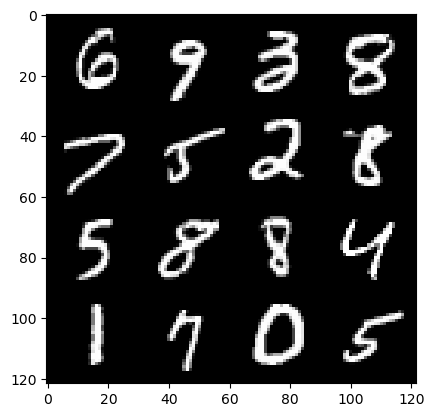

epoch: 101, step: 47700, gen loss: 2.1366620123386384, disc loss: 0.26009318083524724.


  0%|          | 0/469 [00:00<?, ?it/s]

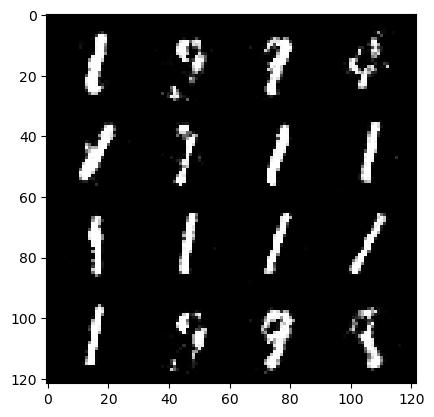

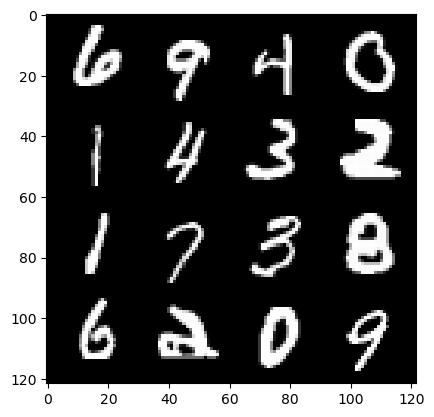

epoch: 102, step: 48000, gen loss: 2.097739293972651, disc loss: 0.2621814783414206.


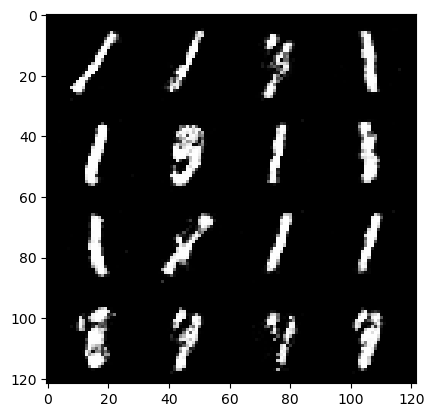

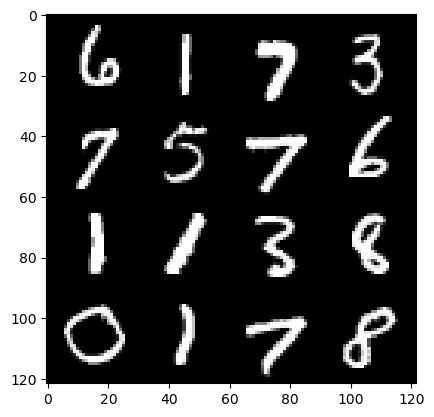

epoch: 102, step: 48300, gen loss: 2.151989910205205, disc loss: 0.249794896443685.


  0%|          | 0/469 [00:00<?, ?it/s]

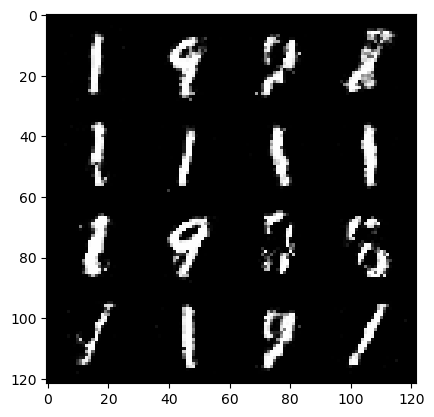

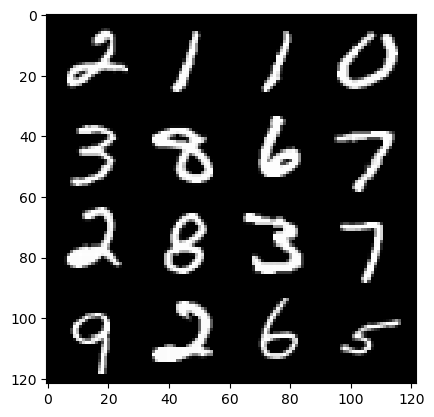

epoch: 103, step: 48600, gen loss: 2.0908493248621625, disc loss: 0.26754647334416704.


  0%|          | 0/469 [00:00<?, ?it/s]

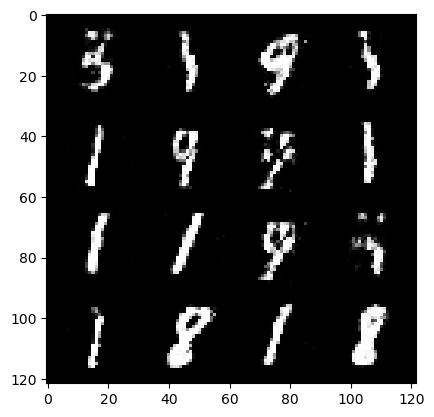

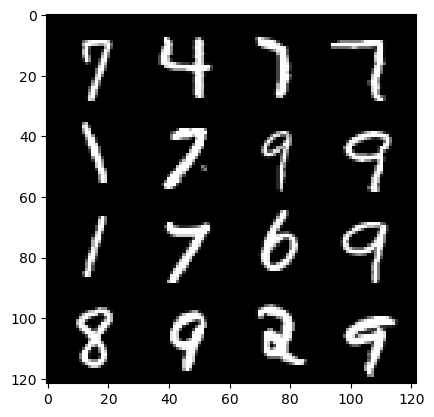

epoch: 104, step: 48900, gen loss: 2.168268102407455, disc loss: 0.24235547274351135.


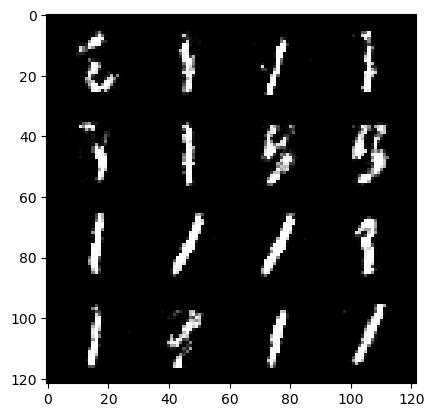

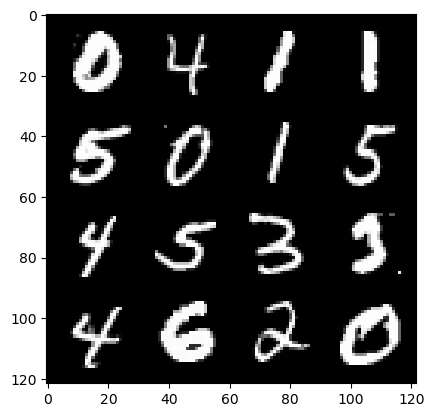

epoch: 104, step: 49200, gen loss: 2.130686637163163, disc loss: 0.24474664300680157.


  0%|          | 0/469 [00:00<?, ?it/s]

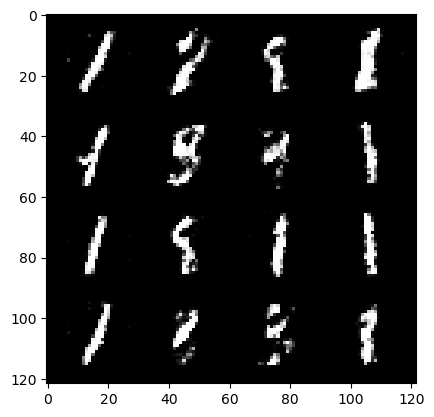

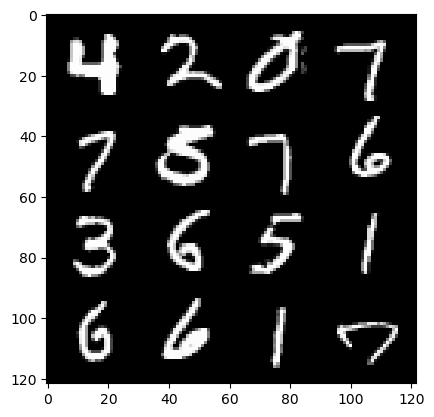

epoch: 105, step: 49500, gen loss: 2.179444956779479, disc loss: 0.23310092012087494.


  0%|          | 0/469 [00:00<?, ?it/s]

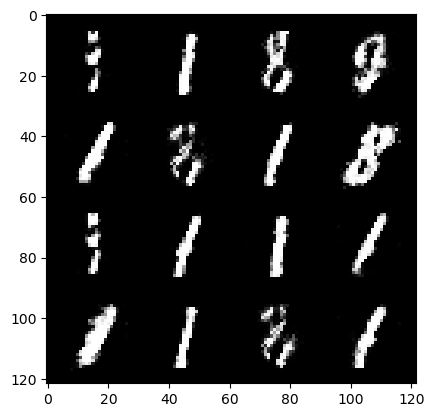

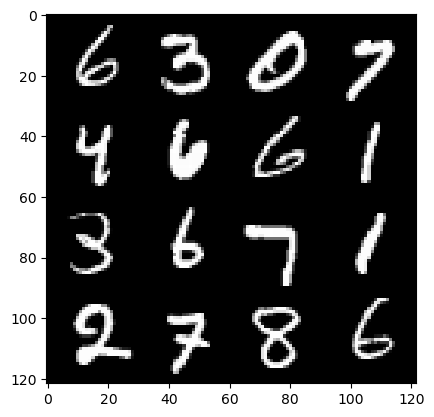

epoch: 106, step: 49800, gen loss: 2.260017149051029, disc loss: 0.23544474134842555.


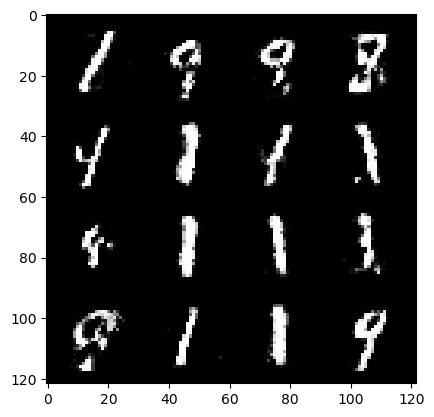

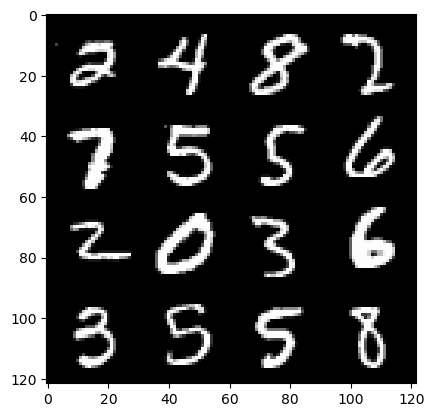

epoch: 106, step: 50100, gen loss: 2.2004461729526517, disc loss: 0.24925469453136137.


  0%|          | 0/469 [00:00<?, ?it/s]

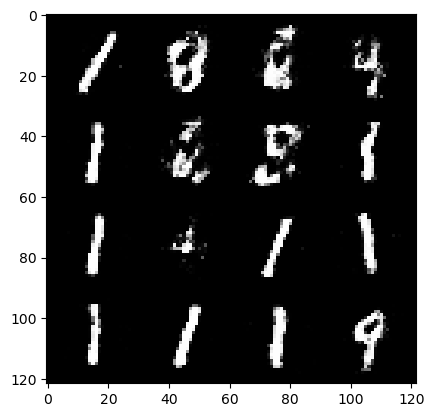

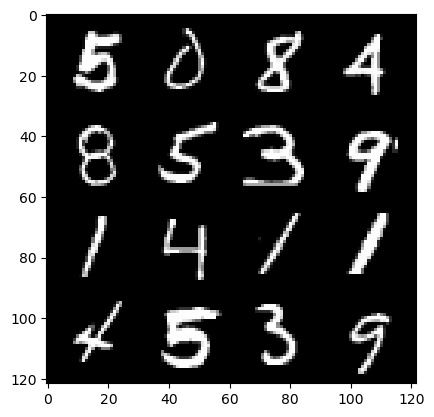

epoch: 107, step: 50400, gen loss: 2.1531761360168455, disc loss: 0.2416920572519305.


  0%|          | 0/469 [00:00<?, ?it/s]

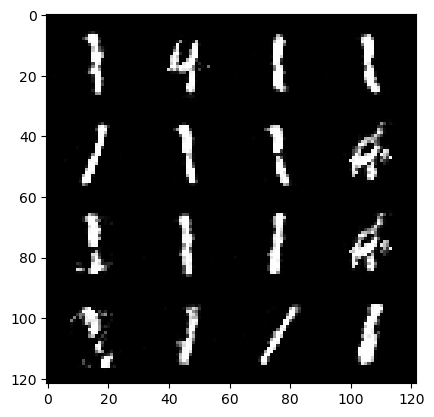

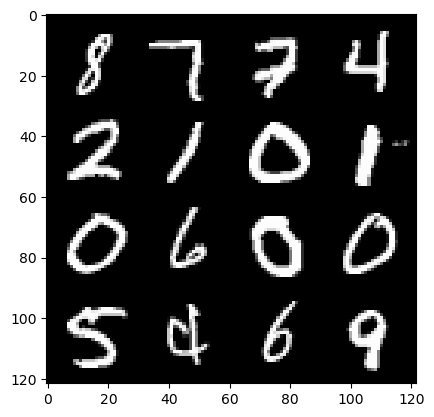

epoch: 108, step: 50700, gen loss: 2.2418908619880678, disc loss: 0.23451723183194798.


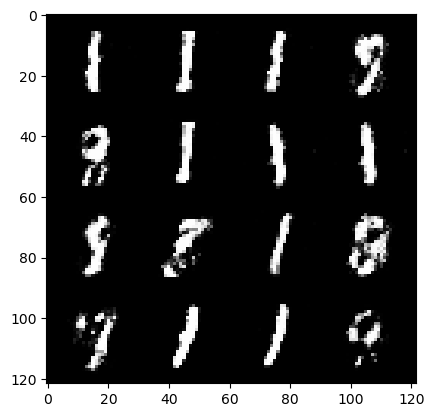

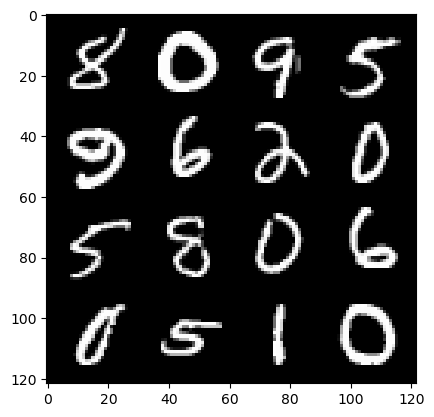

epoch: 108, step: 51000, gen loss: 2.204494322141011, disc loss: 0.2455089417099953.


  0%|          | 0/469 [00:00<?, ?it/s]

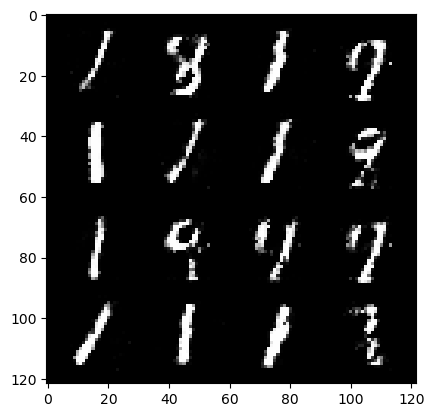

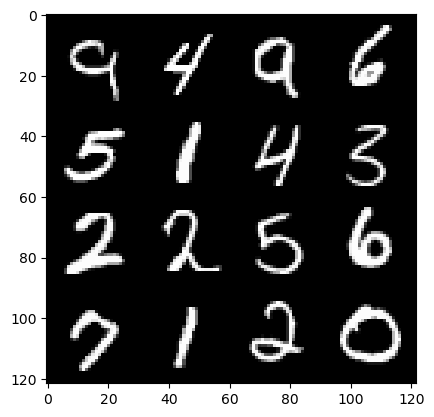

epoch: 109, step: 51300, gen loss: 2.114001249869665, disc loss: 0.2615340432524681.


  0%|          | 0/469 [00:00<?, ?it/s]

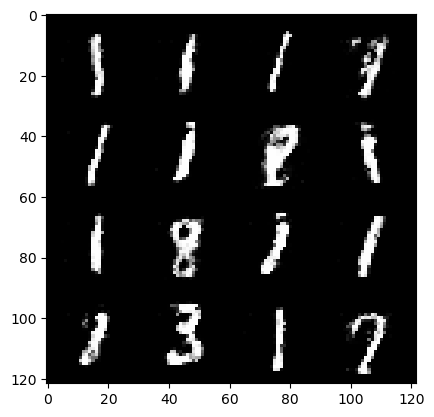

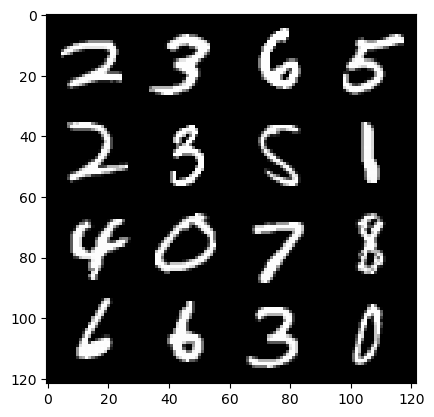

epoch: 110, step: 51600, gen loss: 2.1151951944828027, disc loss: 0.23932670652866364.


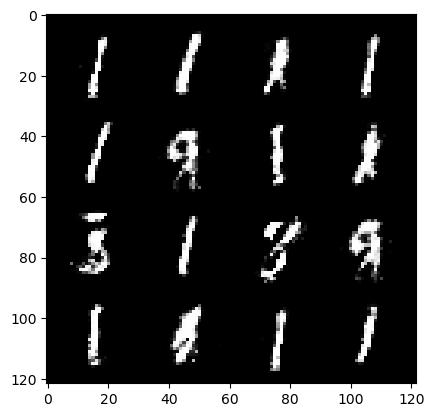

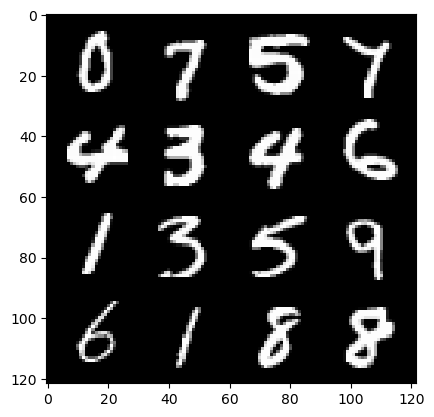

epoch: 110, step: 51900, gen loss: 2.1596728491783157, disc loss: 0.2401726819078127.


  0%|          | 0/469 [00:00<?, ?it/s]

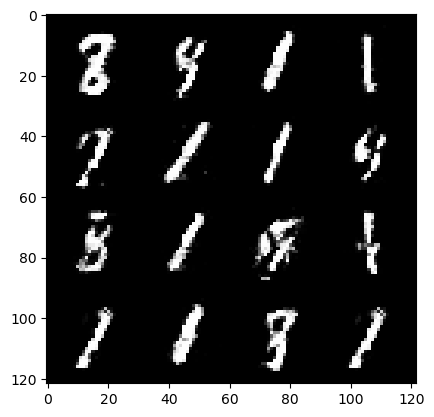

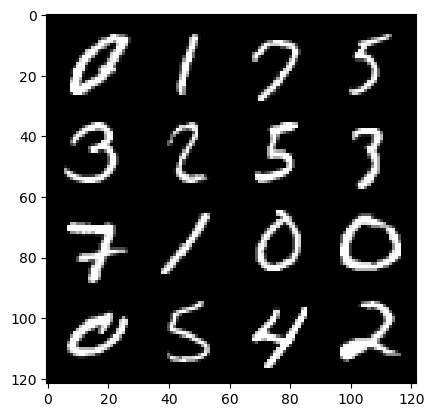

epoch: 111, step: 52200, gen loss: 2.1113046638170894, disc loss: 0.24609178160627693.


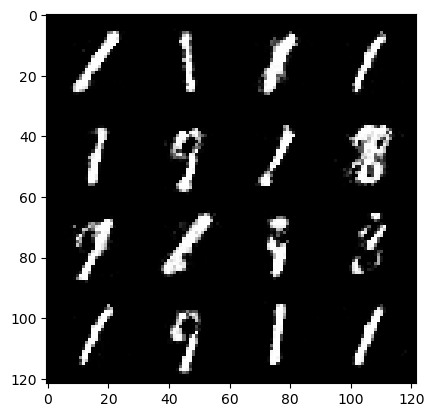

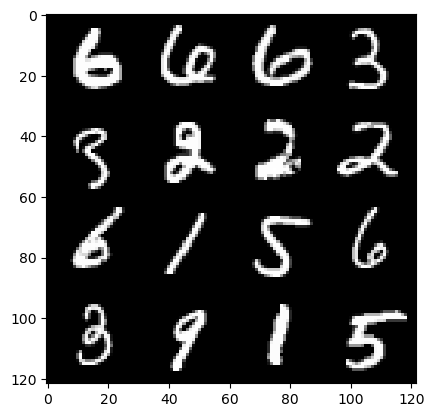

epoch: 111, step: 52500, gen loss: 2.120399796962738, disc loss: 0.25548106635610257.


  0%|          | 0/469 [00:00<?, ?it/s]

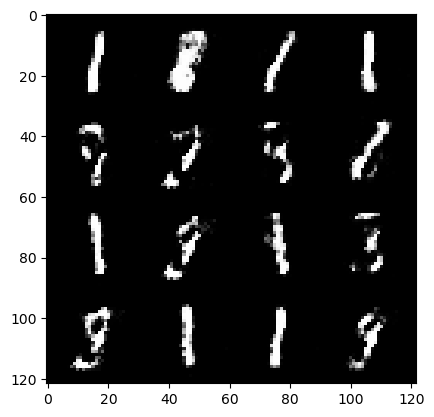

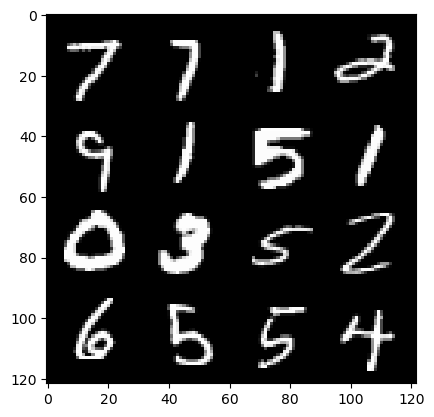

epoch: 112, step: 52800, gen loss: 2.1162861661116277, disc loss: 0.25114480063319206.


  0%|          | 0/469 [00:00<?, ?it/s]

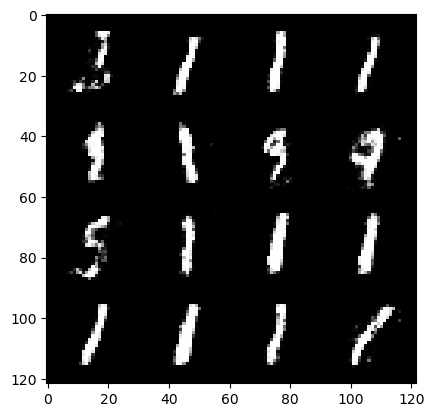

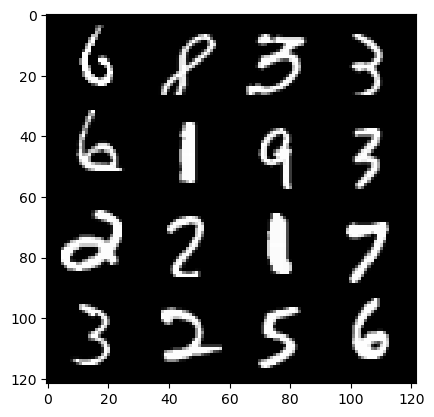

epoch: 113, step: 53100, gen loss: 2.1226029018561037, disc loss: 0.24373840143283212.


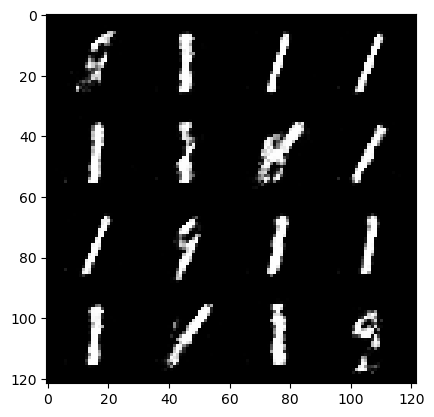

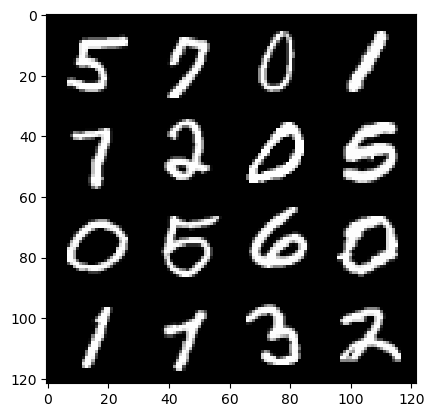

epoch: 113, step: 53400, gen loss: 2.170875991582871, disc loss: 0.2492335183918478.


  0%|          | 0/469 [00:00<?, ?it/s]

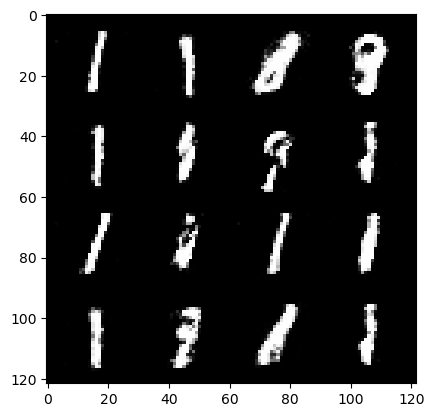

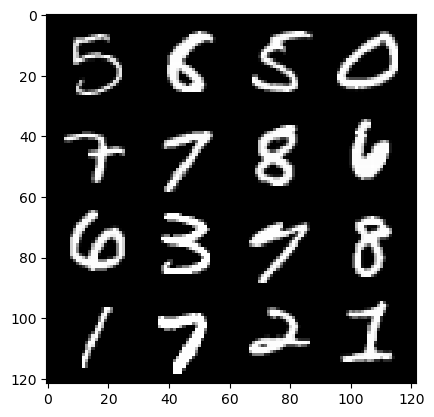

epoch: 114, step: 53700, gen loss: 2.1430145080884304, disc loss: 0.24995209480325375.


  0%|          | 0/469 [00:00<?, ?it/s]

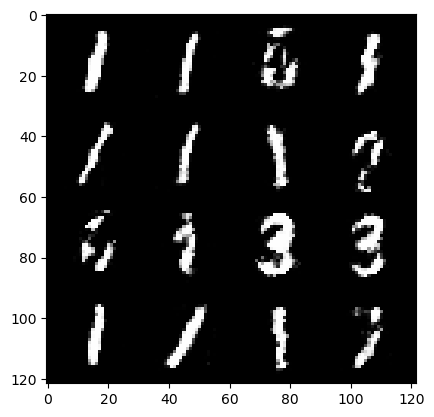

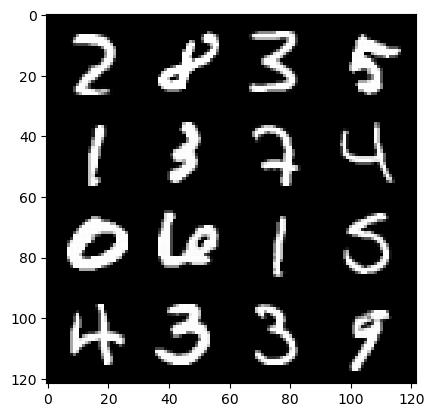

epoch: 115, step: 54000, gen loss: 2.091609274943671, disc loss: 0.24737001225352284.


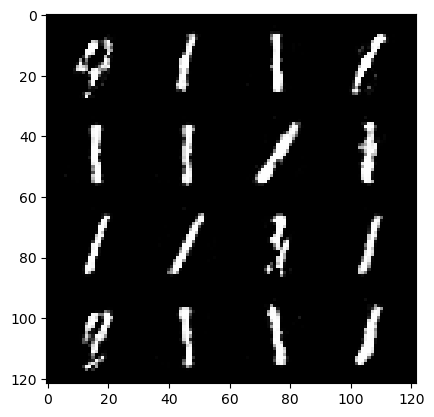

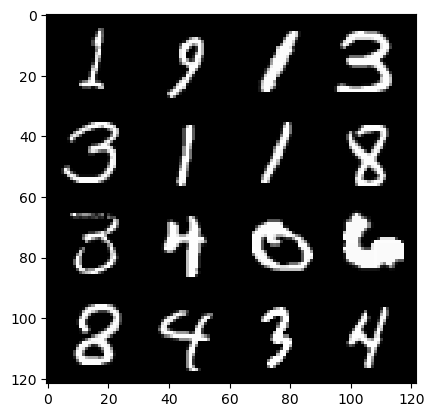

epoch: 115, step: 54300, gen loss: 2.148035353422164, disc loss: 0.25025559042890877.


  0%|          | 0/469 [00:00<?, ?it/s]

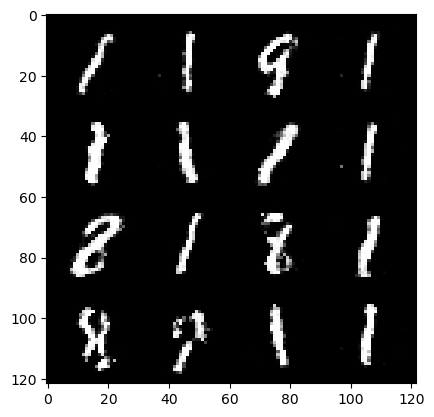

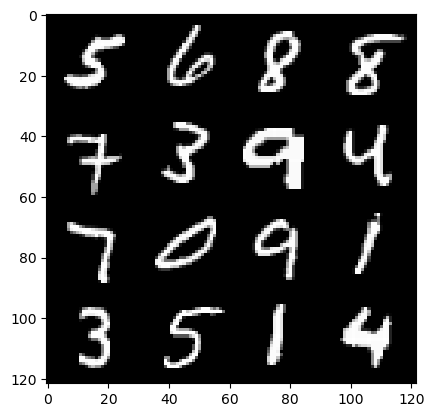

epoch: 116, step: 54600, gen loss: 2.0916755739847828, disc loss: 0.2537133381267389.


  0%|          | 0/469 [00:00<?, ?it/s]

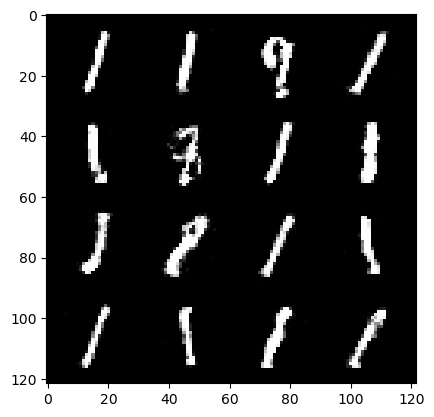

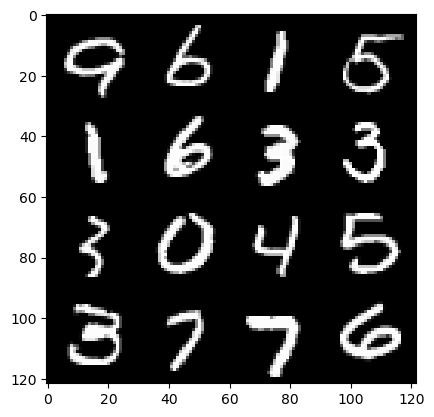

epoch: 117, step: 54900, gen loss: 2.0873165631294244, disc loss: 0.2552808707455795.


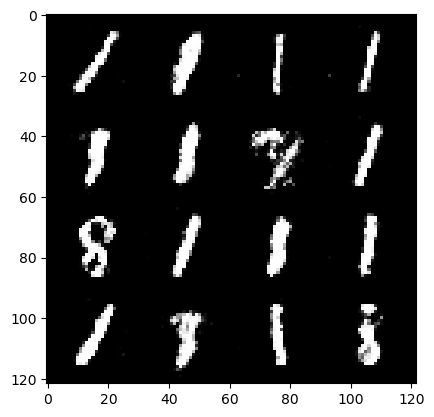

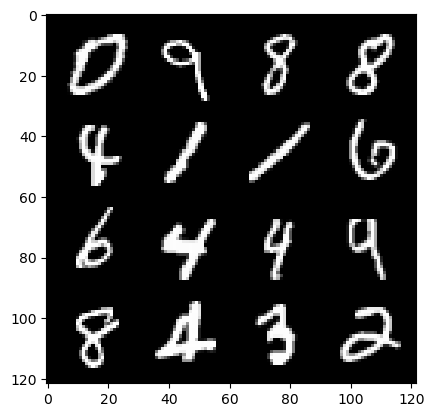

epoch: 117, step: 55200, gen loss: 2.0708038115501406, disc loss: 0.2664165968199571.


  0%|          | 0/469 [00:00<?, ?it/s]

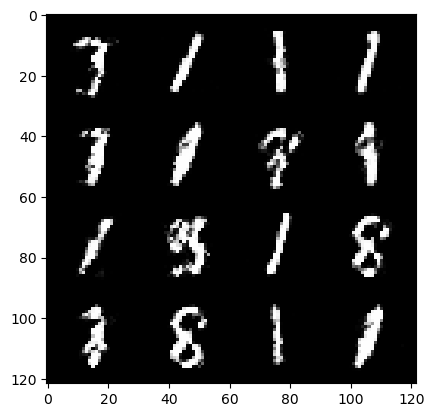

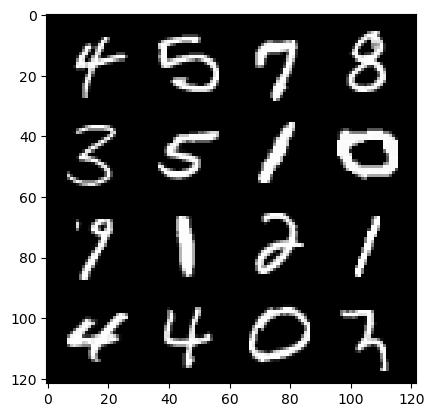

epoch: 118, step: 55500, gen loss: 2.00656922618548, disc loss: 0.2754452893137931.


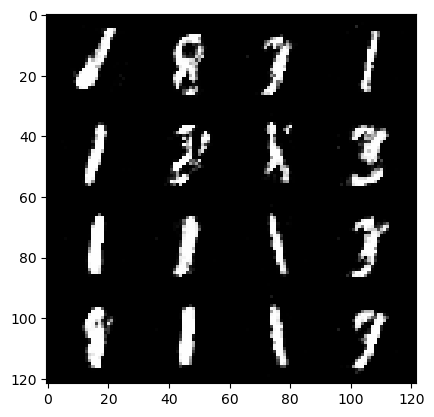

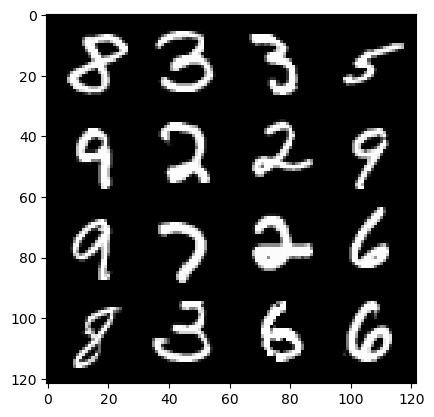

epoch: 118, step: 55800, gen loss: 2.044071729580561, disc loss: 0.2619302202761171.


  0%|          | 0/469 [00:00<?, ?it/s]

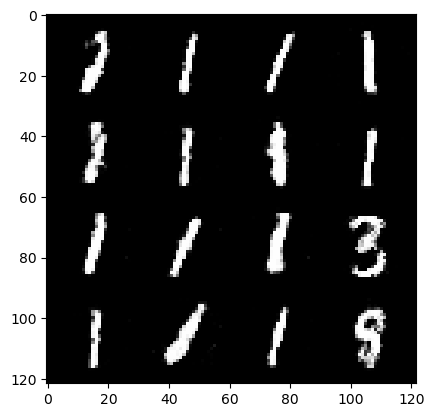

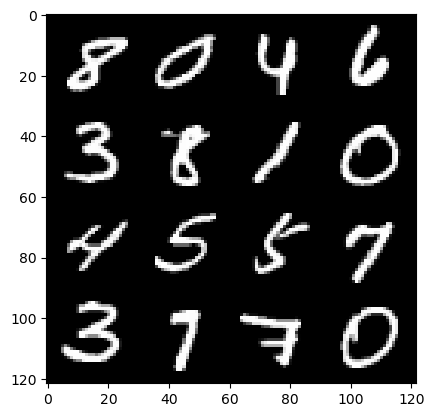

epoch: 119, step: 56100, gen loss: 2.0420263659954063, disc loss: 0.26321383650104185.


  0%|          | 0/469 [00:00<?, ?it/s]

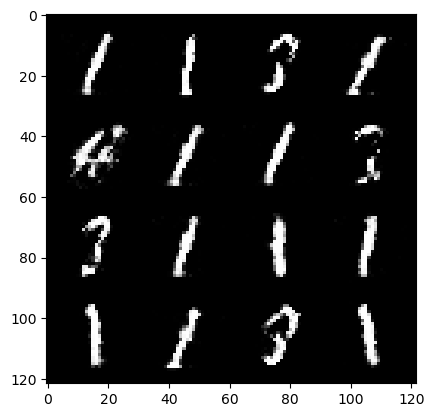

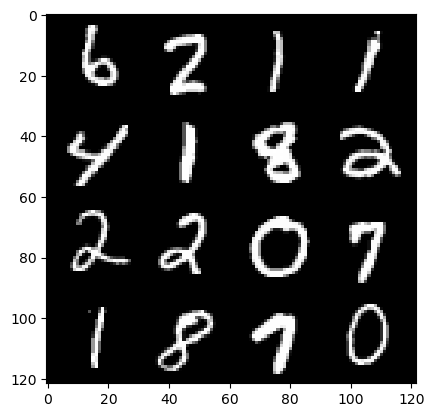

epoch: 120, step: 56400, gen loss: 2.0461384717623403, disc loss: 0.2677250121037166.


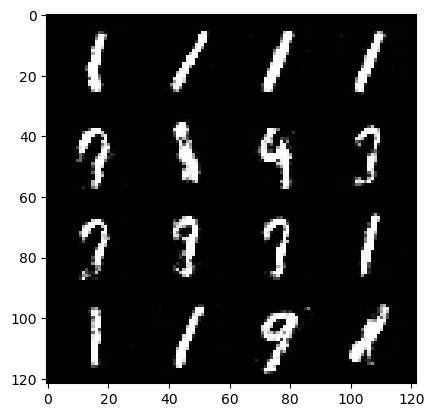

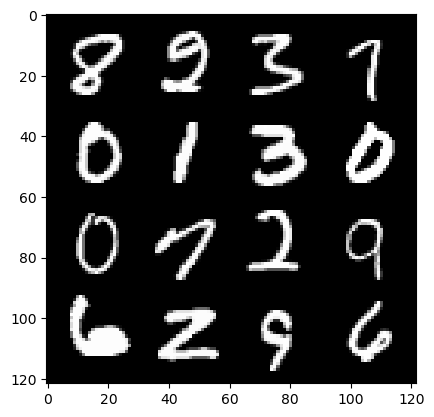

epoch: 120, step: 56700, gen loss: 2.1050478072961165, disc loss: 0.2534006035824617.


  0%|          | 0/469 [00:00<?, ?it/s]

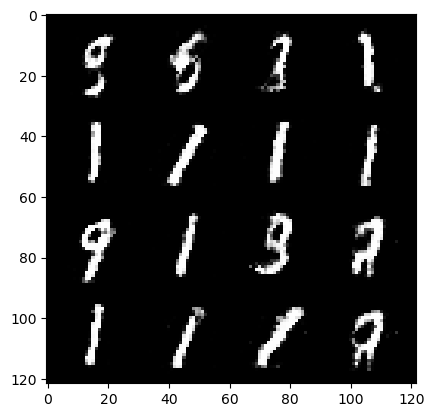

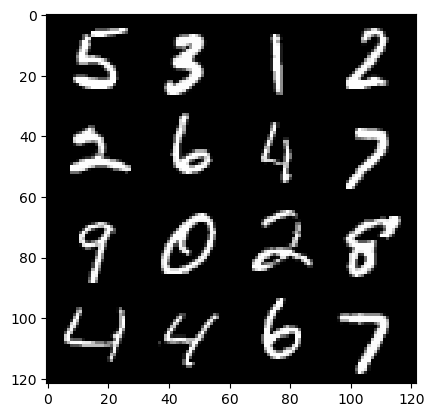

epoch: 121, step: 57000, gen loss: 2.062778144280116, disc loss: 0.2742312871913116.


  0%|          | 0/469 [00:00<?, ?it/s]

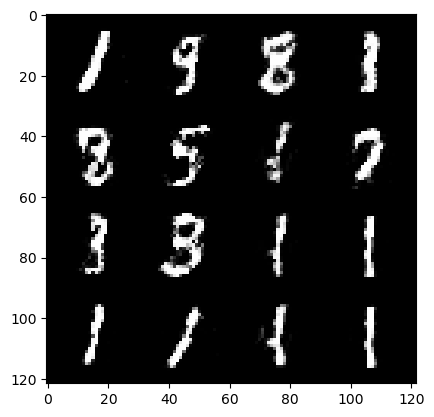

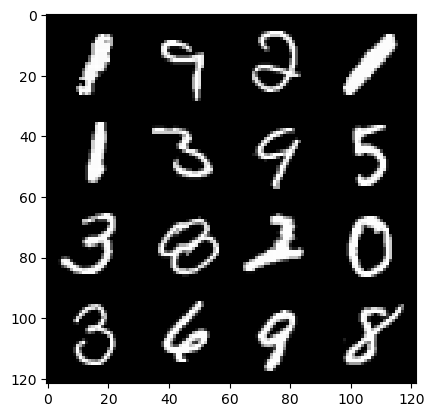

epoch: 122, step: 57300, gen loss: 1.9923346738020589, disc loss: 0.26664415781696627.


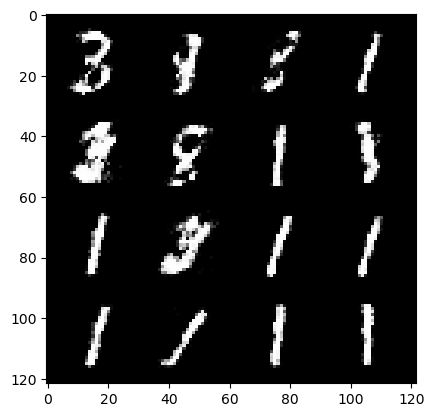

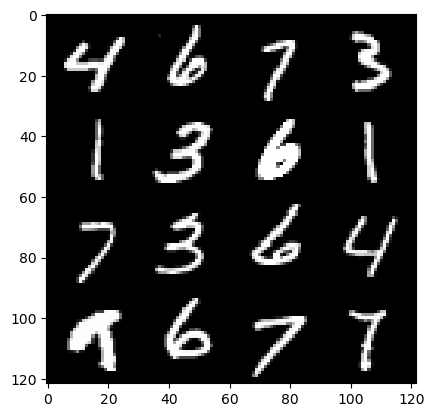

epoch: 122, step: 57600, gen loss: 1.9832321977615366, disc loss: 0.2757755933205285.


  0%|          | 0/469 [00:00<?, ?it/s]

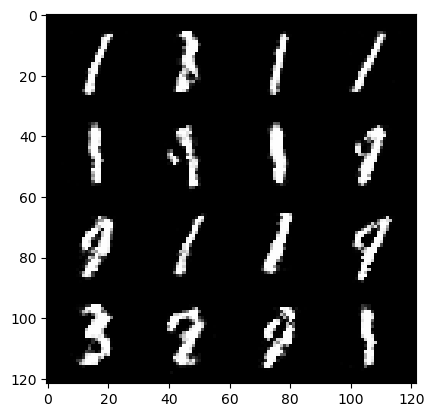

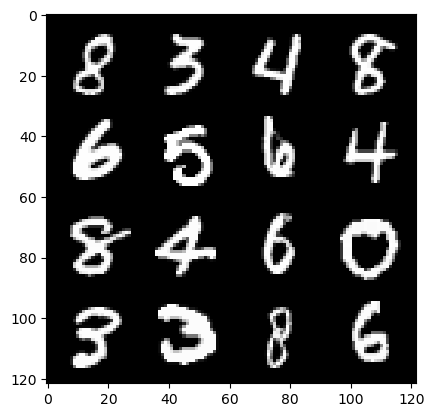

epoch: 123, step: 57900, gen loss: 2.0050657097498576, disc loss: 0.2653360070784887.


  0%|          | 0/469 [00:00<?, ?it/s]

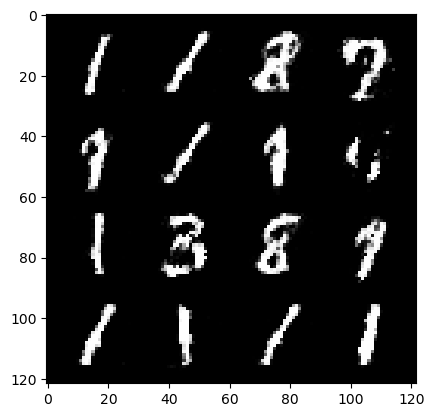

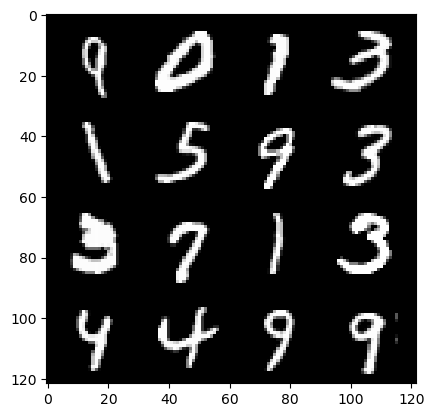

epoch: 124, step: 58200, gen loss: 1.9903114283084864, disc loss: 0.2734154494603474.


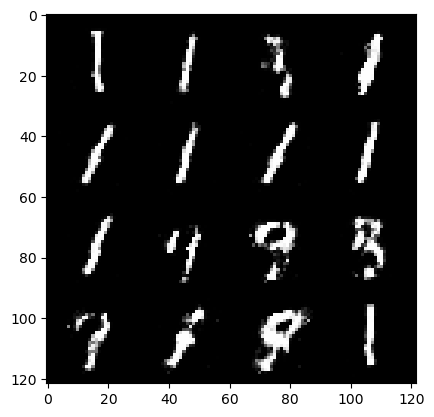

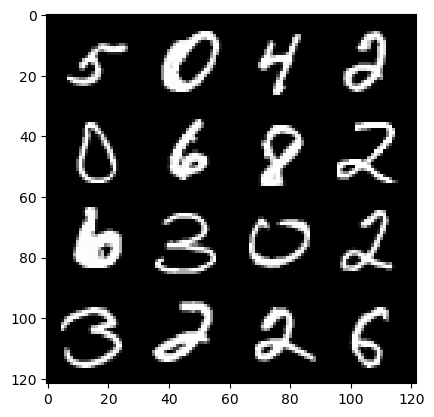

epoch: 124, step: 58500, gen loss: 1.9867906904220576, disc loss: 0.2760399581988653.


  0%|          | 0/469 [00:00<?, ?it/s]

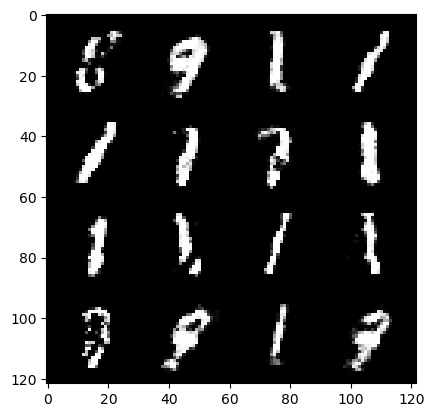

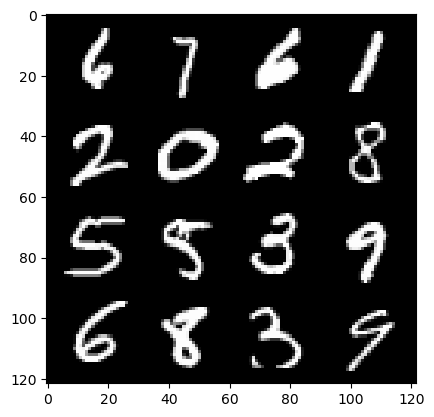

epoch: 125, step: 58800, gen loss: 2.022326178153357, disc loss: 0.26480042243997265.


  0%|          | 0/469 [00:00<?, ?it/s]

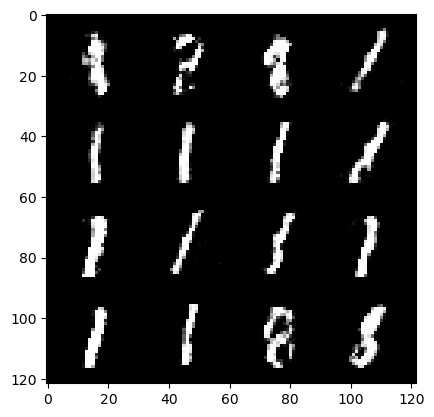

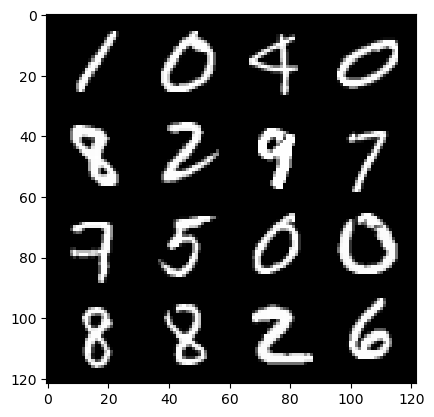

epoch: 126, step: 59100, gen loss: 2.0090109626452124, disc loss: 0.2649221729735533.


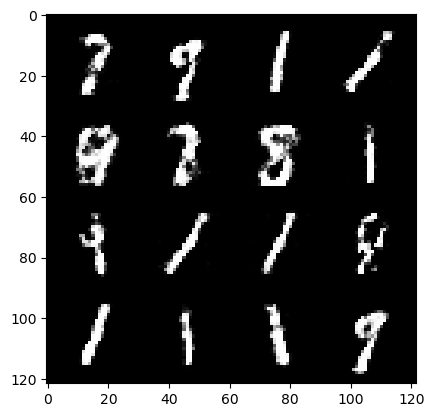

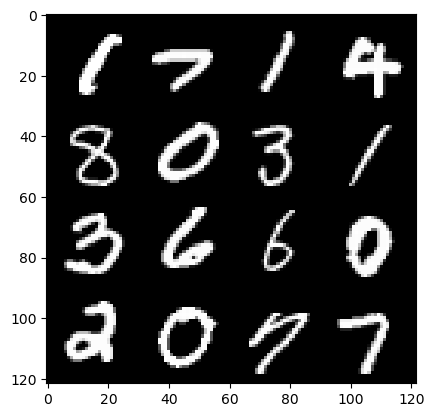

epoch: 126, step: 59400, gen loss: 1.9576504568258912, disc loss: 0.2721973947187264.


  0%|          | 0/469 [00:00<?, ?it/s]

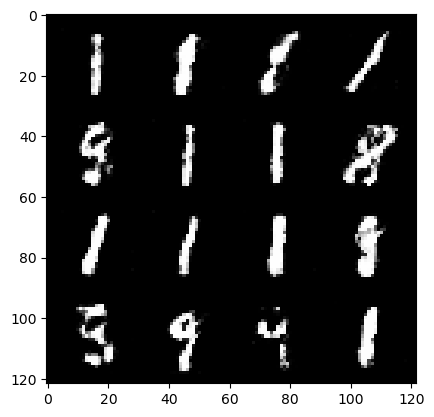

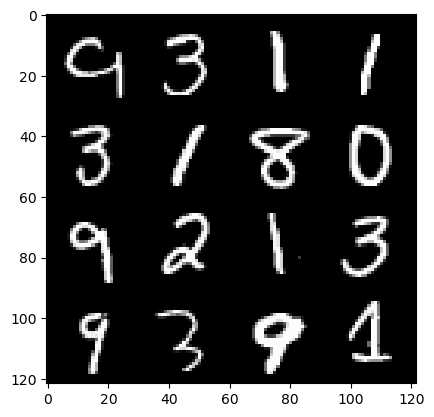

epoch: 127, step: 59700, gen loss: 1.9338309951623258, disc loss: 0.2862622138857842.


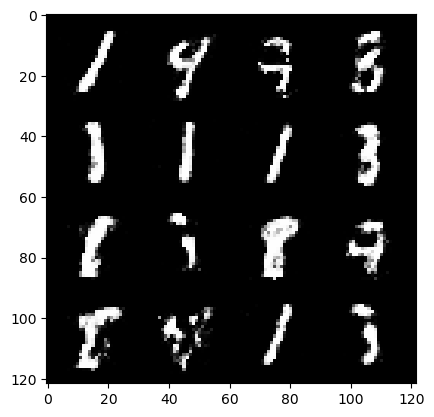

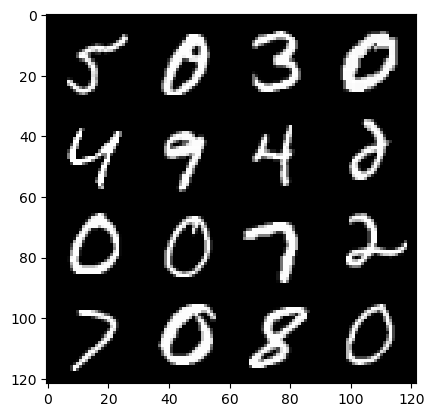

epoch: 127, step: 60000, gen loss: 1.9852274938424435, disc loss: 0.2725387184818587.


  0%|          | 0/469 [00:00<?, ?it/s]

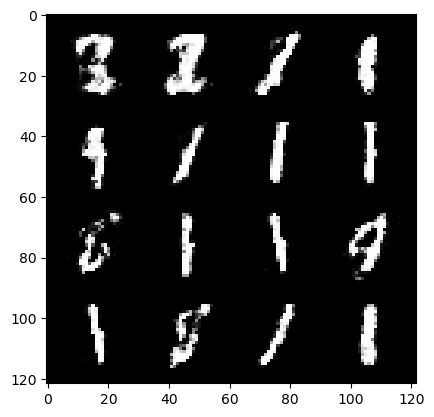

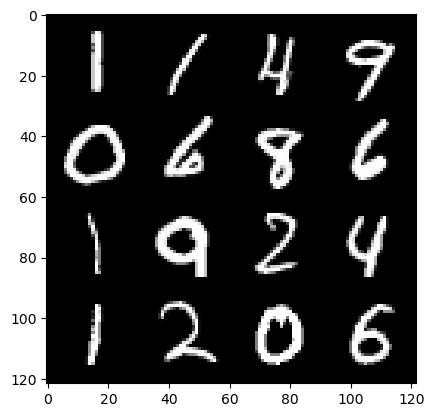

epoch: 128, step: 60300, gen loss: 2.068462219635647, disc loss: 0.25780931204557445.


  0%|          | 0/469 [00:00<?, ?it/s]

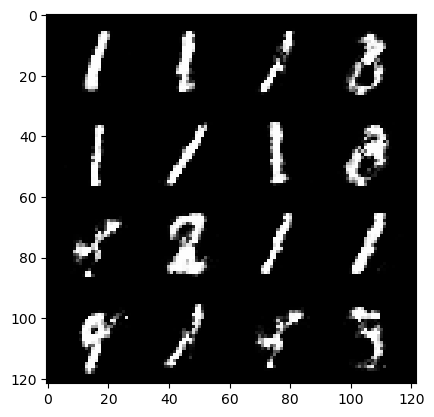

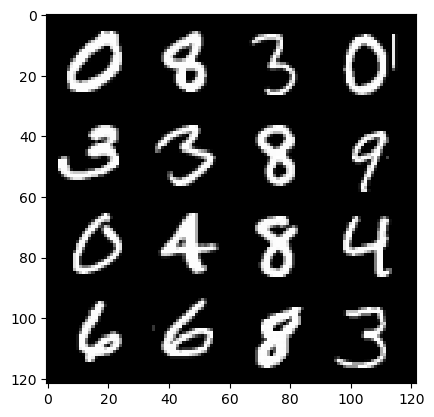

epoch: 129, step: 60600, gen loss: 1.972240781386693, disc loss: 0.2890337789058686.


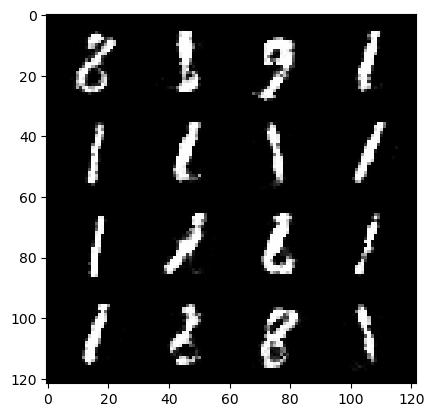

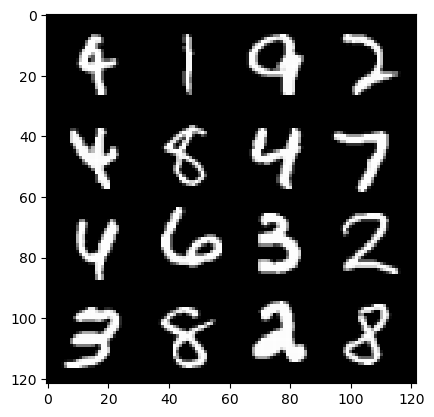

epoch: 129, step: 60900, gen loss: 1.9136012045542397, disc loss: 0.2892934343715506.


  0%|          | 0/469 [00:00<?, ?it/s]

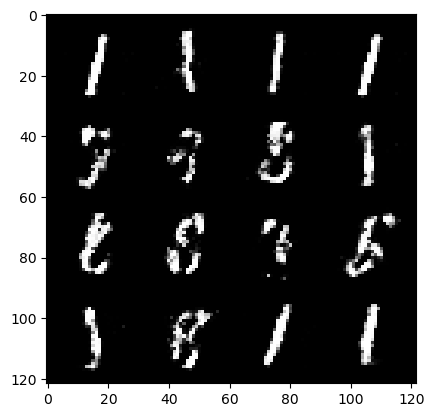

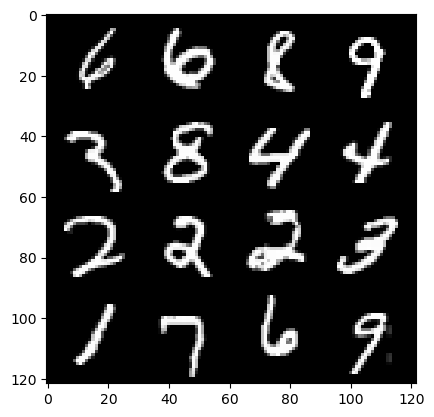

epoch: 130, step: 61200, gen loss: 1.9154919544855769, disc loss: 0.28433345238367713.


  0%|          | 0/469 [00:00<?, ?it/s]

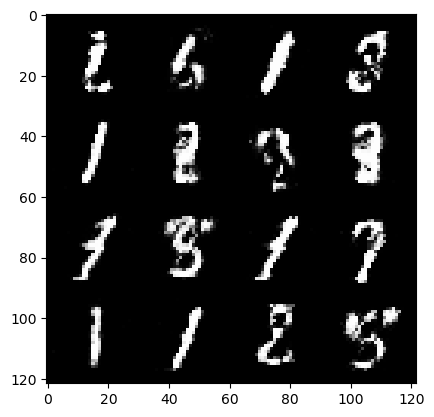

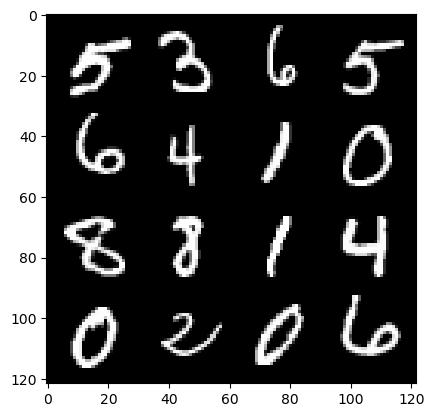

epoch: 131, step: 61500, gen loss: 2.02135049144427, disc loss: 0.2623944470783075.


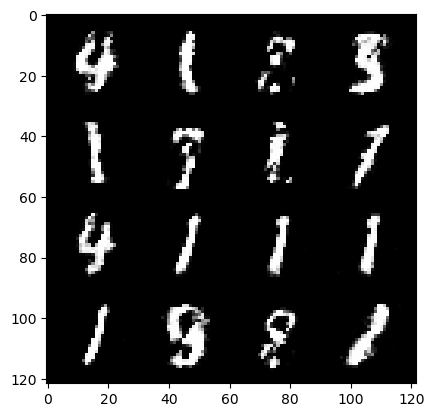

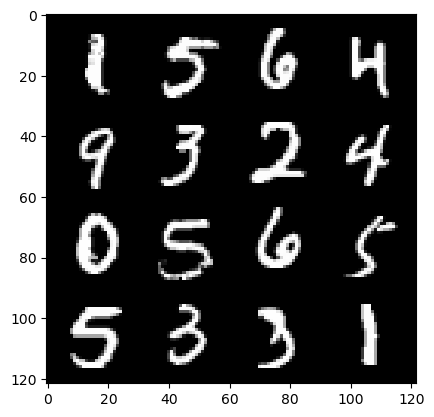

epoch: 131, step: 61800, gen loss: 2.0392277002334587, disc loss: 0.2657048676908018.


  0%|          | 0/469 [00:00<?, ?it/s]

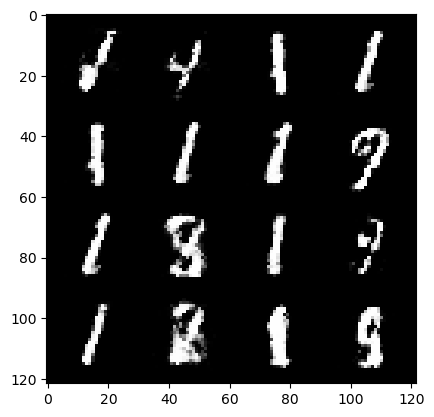

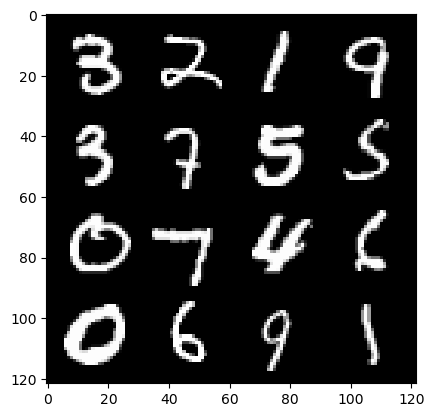

epoch: 132, step: 62100, gen loss: 1.979282341003417, disc loss: 0.2850323177874088.


  0%|          | 0/469 [00:00<?, ?it/s]

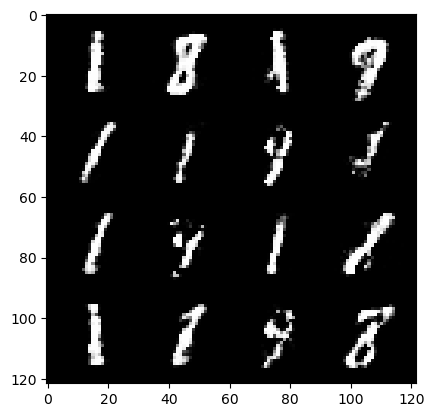

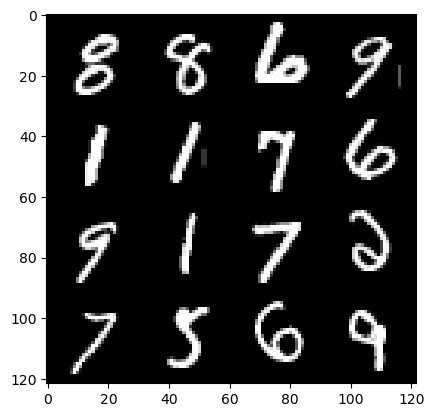

epoch: 133, step: 62400, gen loss: 1.9765645480155942, disc loss: 0.28328230425715467.


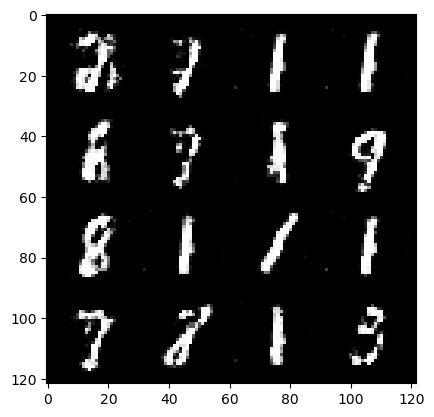

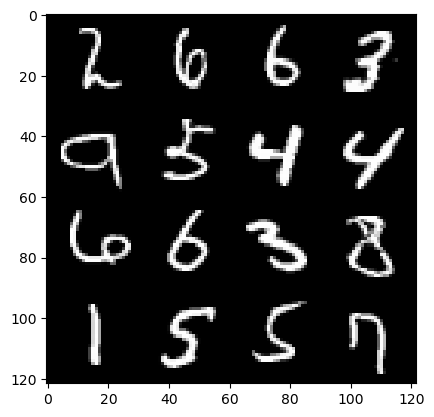

epoch: 133, step: 62700, gen loss: 1.9073326158523563, disc loss: 0.2905353018641472.


  0%|          | 0/469 [00:00<?, ?it/s]

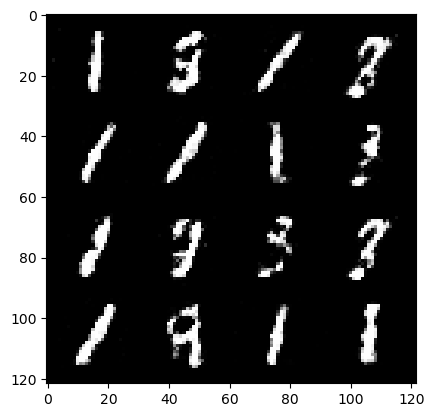

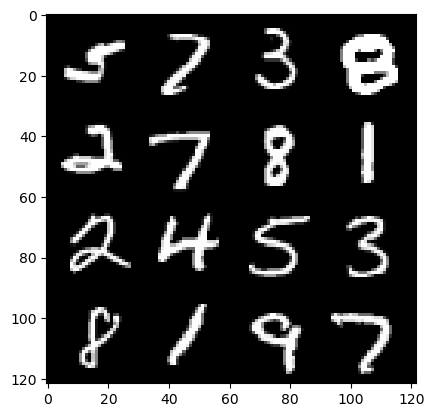

epoch: 134, step: 63000, gen loss: 1.948151862223943, disc loss: 0.2772452801465989.


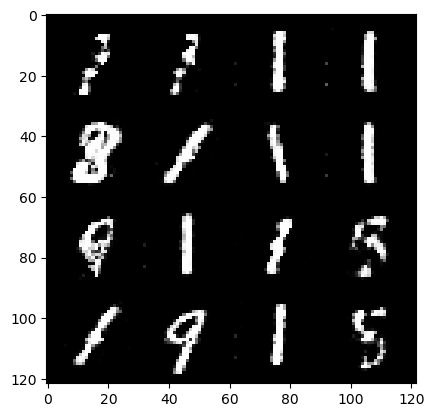

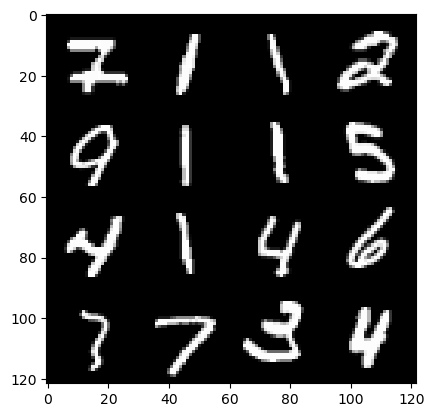

epoch: 134, step: 63300, gen loss: 1.997899033228556, disc loss: 0.27230457494656235.


  0%|          | 0/469 [00:00<?, ?it/s]

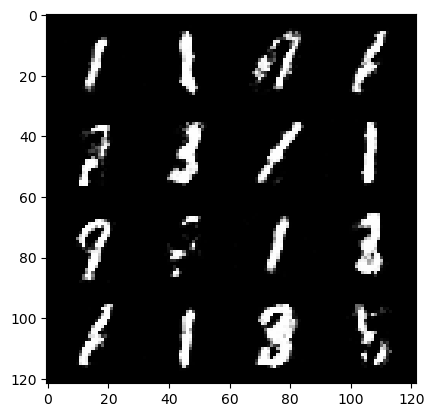

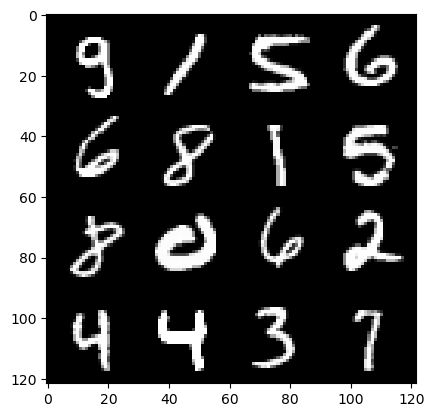

epoch: 135, step: 63600, gen loss: 1.9191360203425076, disc loss: 0.28505694304903356.


  0%|          | 0/469 [00:00<?, ?it/s]

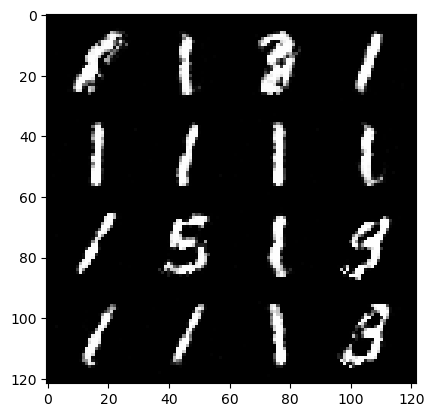

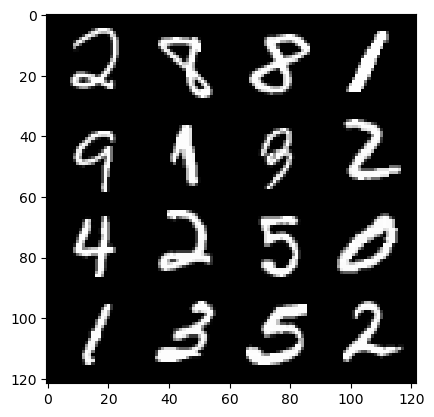

epoch: 136, step: 63900, gen loss: 1.9504517416159297, disc loss: 0.2739063607156276.


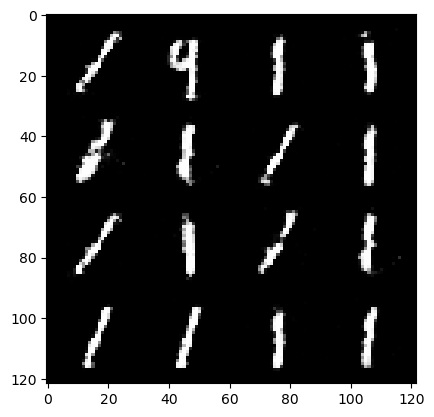

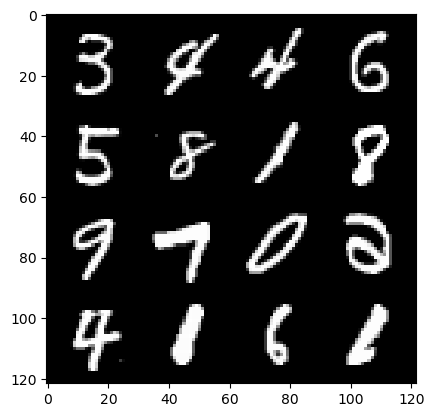

epoch: 136, step: 64200, gen loss: 1.9667854547500625, disc loss: 0.2827670987943808.


  0%|          | 0/469 [00:00<?, ?it/s]

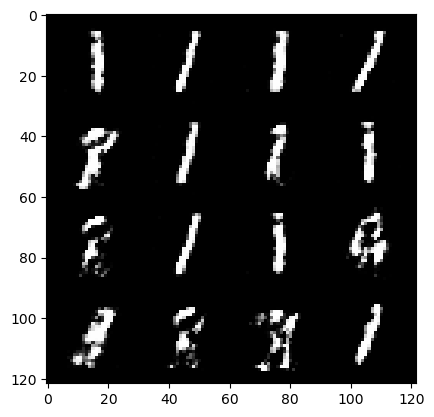

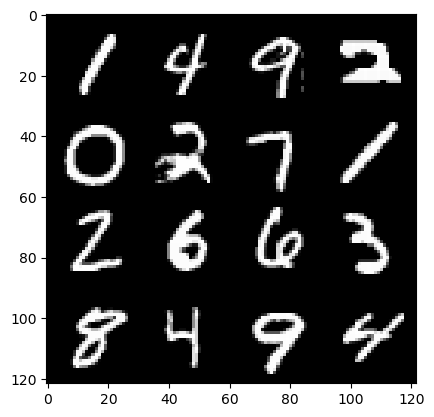

epoch: 137, step: 64500, gen loss: 1.917384401559829, disc loss: 0.28114774659276026.


  0%|          | 0/469 [00:00<?, ?it/s]

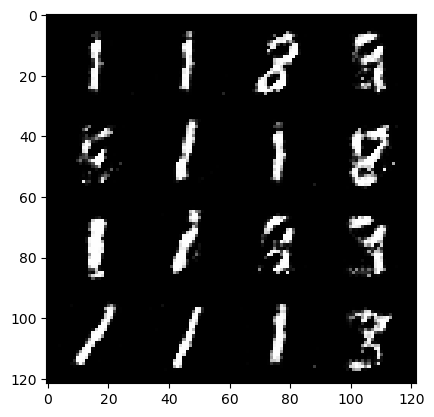

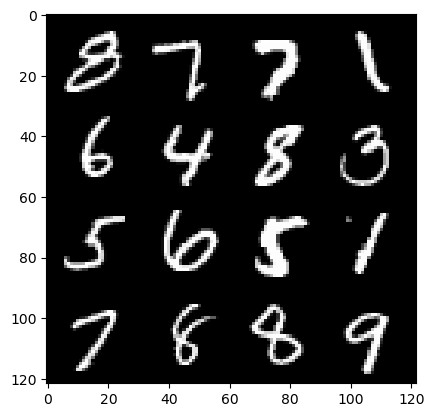

epoch: 138, step: 64800, gen loss: 1.9601551095644627, disc loss: 0.27438398713866907.


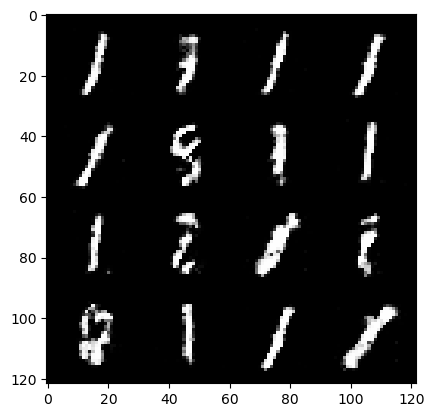

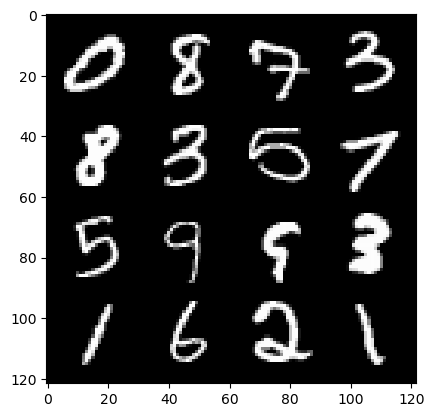

epoch: 138, step: 65100, gen loss: 1.9959718664487214, disc loss: 0.26430457721153877.


  0%|          | 0/469 [00:00<?, ?it/s]

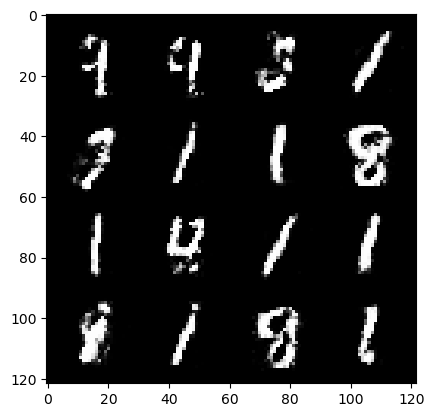

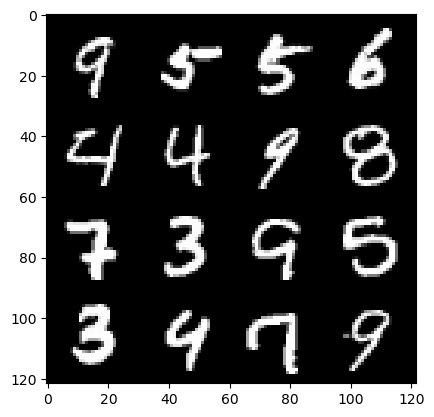

epoch: 139, step: 65400, gen loss: 1.9455250545342773, disc loss: 0.2796133985122043.


  0%|          | 0/469 [00:00<?, ?it/s]

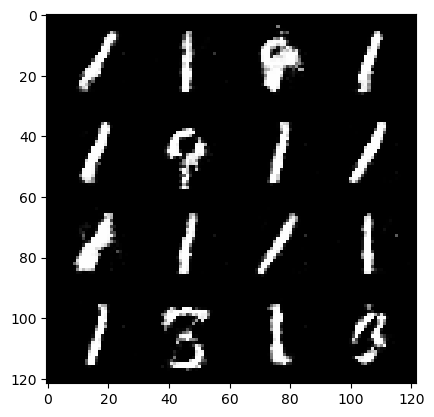

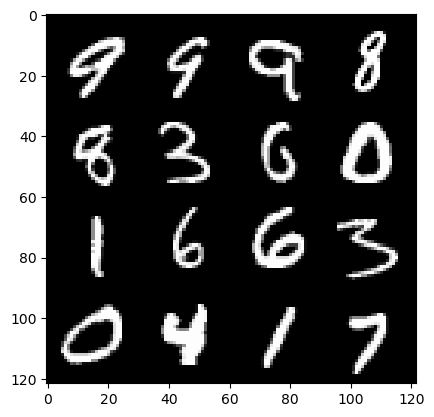

epoch: 140, step: 65700, gen loss: 1.9523687207698817, disc loss: 0.2774949447810653.


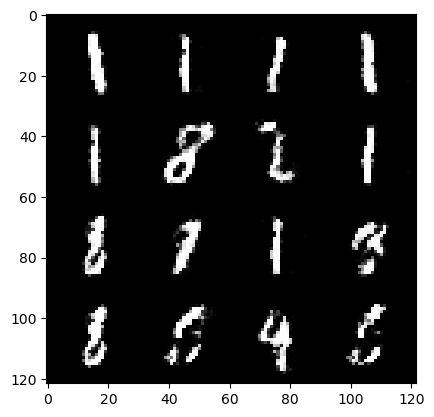

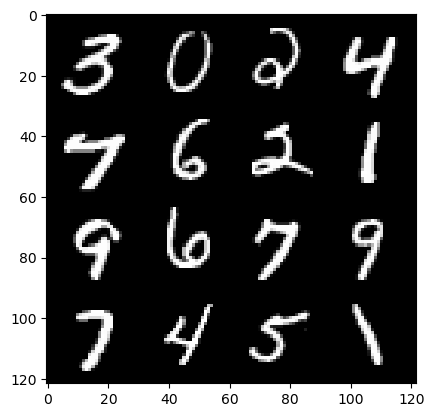

epoch: 140, step: 66000, gen loss: 2.011503264506659, disc loss: 0.281203485230605.


  0%|          | 0/469 [00:00<?, ?it/s]

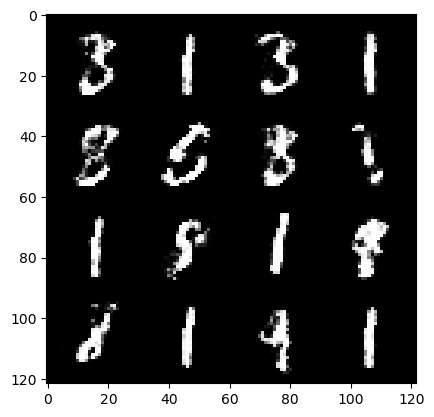

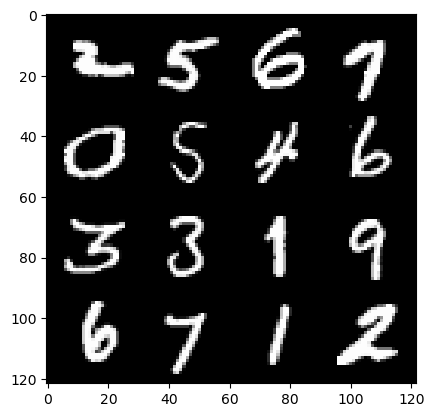

epoch: 141, step: 66300, gen loss: 1.8813866579532619, disc loss: 0.28893324454625485.


  0%|          | 0/469 [00:00<?, ?it/s]

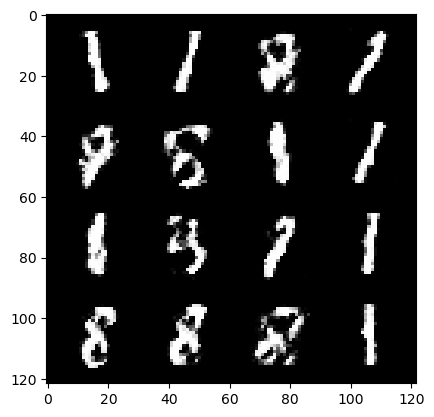

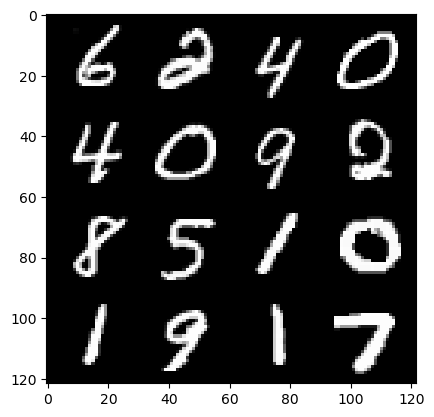

epoch: 142, step: 66600, gen loss: 1.897255994876228, disc loss: 0.29661610523859655.


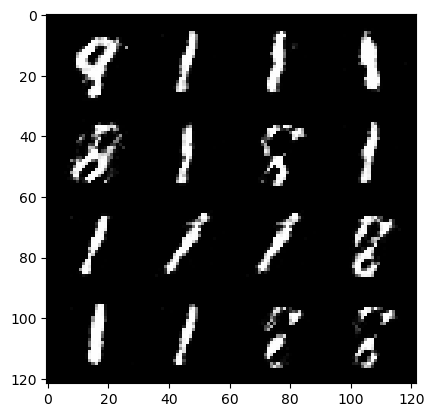

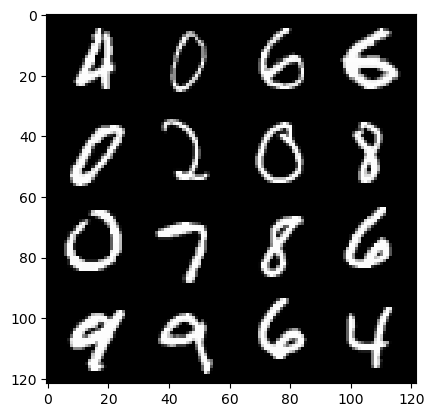

epoch: 142, step: 66900, gen loss: 1.8792505800724024, disc loss: 0.2925213209291296.


  0%|          | 0/469 [00:00<?, ?it/s]

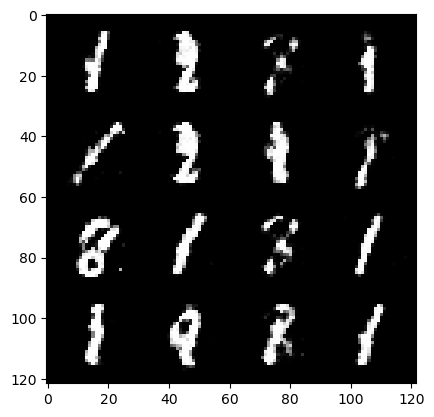

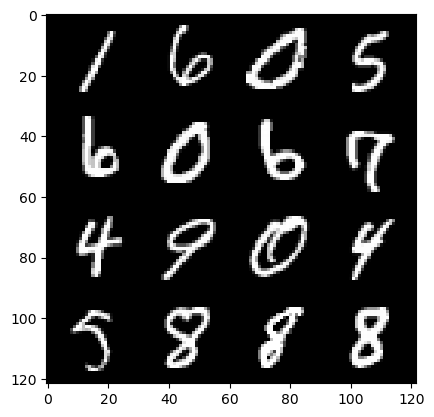

epoch: 143, step: 67200, gen loss: 1.9350496172904963, disc loss: 0.27921161994338023.


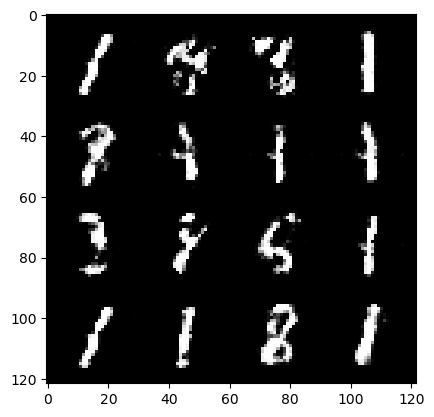

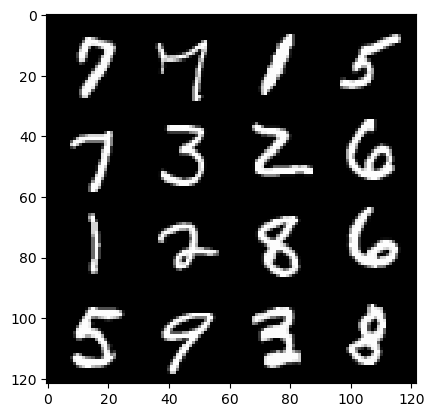

epoch: 143, step: 67500, gen loss: 1.9484504799048104, disc loss: 0.2865317306915919.


  0%|          | 0/469 [00:00<?, ?it/s]

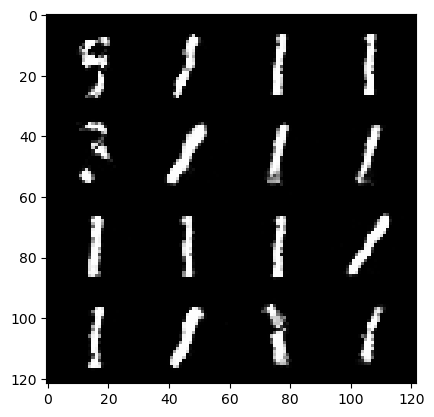

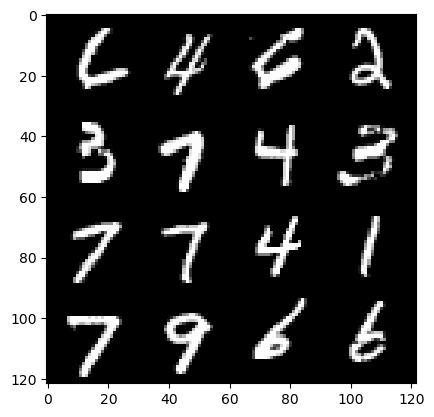

epoch: 144, step: 67800, gen loss: 1.8968532423178348, disc loss: 0.2896483906606834.


  0%|          | 0/469 [00:00<?, ?it/s]

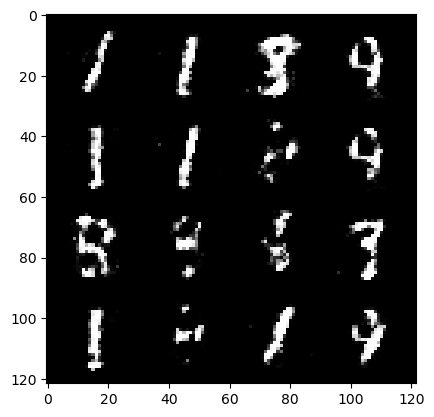

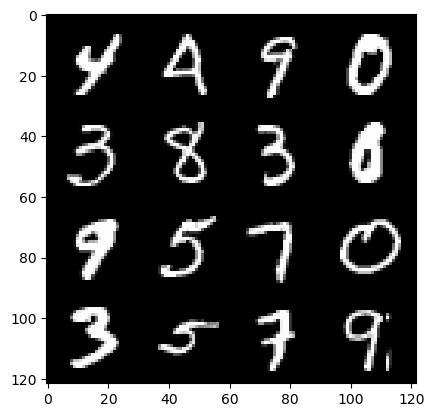

epoch: 145, step: 68100, gen loss: 1.9190671710173277, disc loss: 0.2865945453445114.


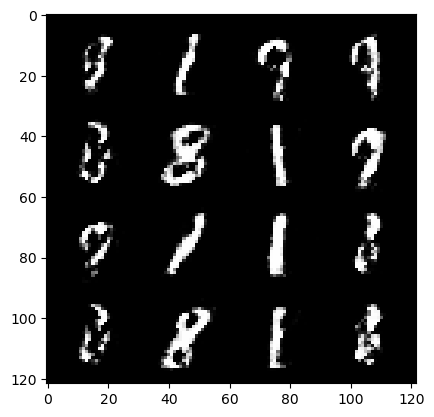

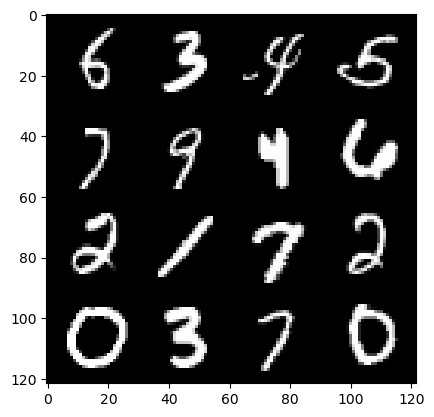

epoch: 145, step: 68400, gen loss: 1.9400337652365371, disc loss: 0.28339111074805295.


  0%|          | 0/469 [00:00<?, ?it/s]

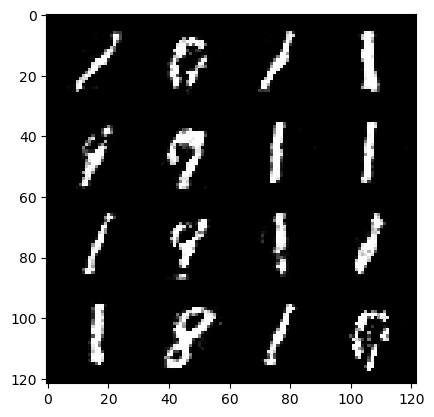

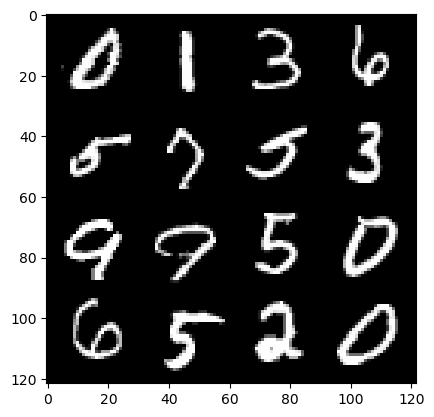

epoch: 146, step: 68700, gen loss: 1.8680458438396463, disc loss: 0.3001520488659545.


  0%|          | 0/469 [00:00<?, ?it/s]

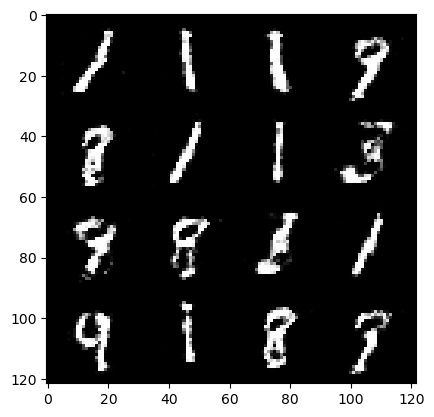

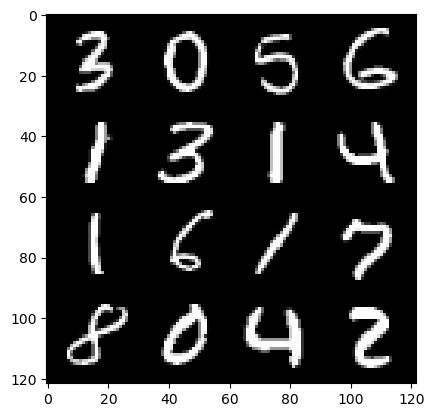

epoch: 147, step: 69000, gen loss: 1.8574178973833724, disc loss: 0.3006984336674215.


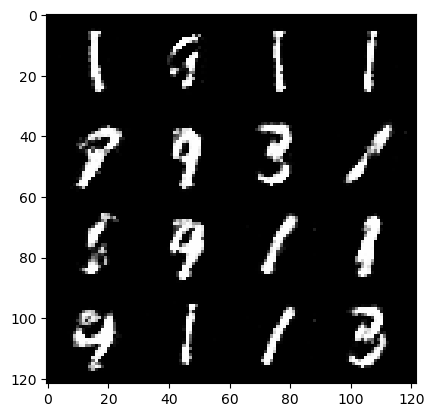

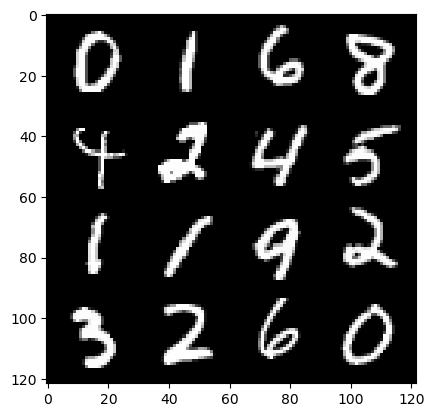

epoch: 147, step: 69300, gen loss: 1.8599527625242878, disc loss: 0.2968190598984561.


  0%|          | 0/469 [00:00<?, ?it/s]

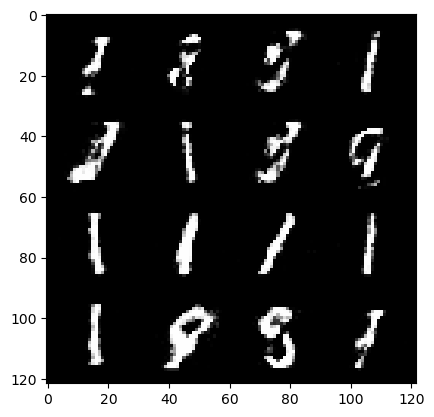

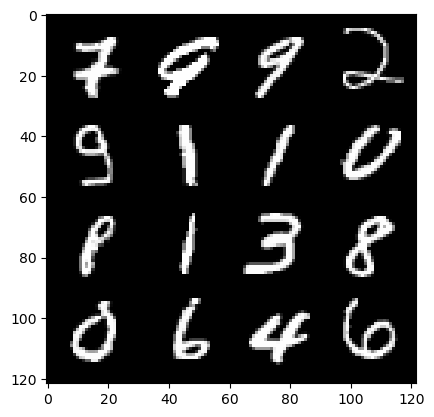

epoch: 148, step: 69600, gen loss: 1.7910327816009515, disc loss: 0.308946464161078.


  0%|          | 0/469 [00:00<?, ?it/s]

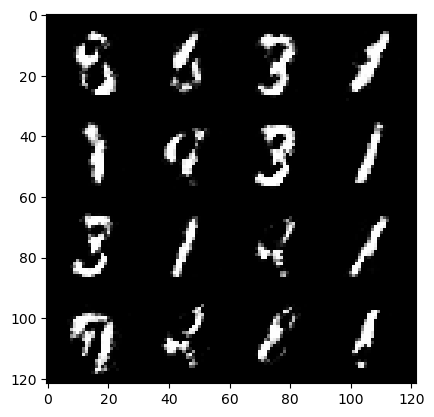

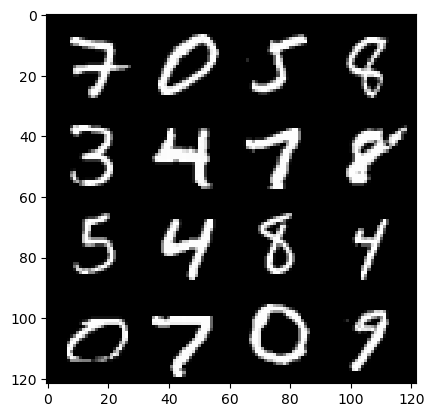

epoch: 149, step: 69900, gen loss: 1.8122956418991083, disc loss: 0.3086813695728776.


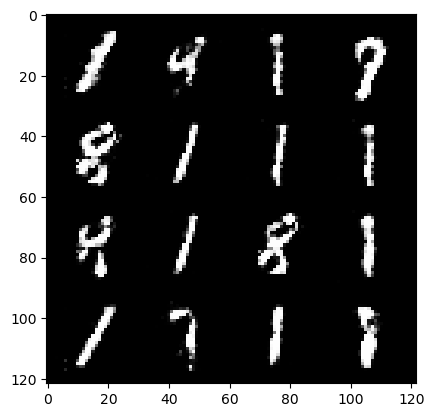

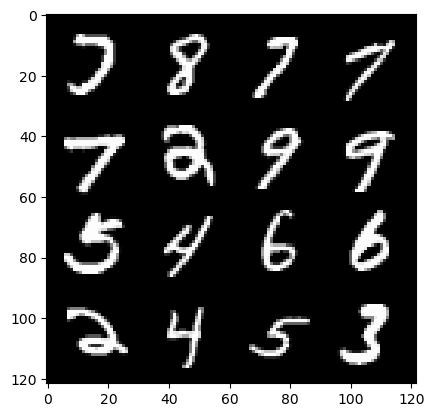

epoch: 149, step: 70200, gen loss: 1.8121827292442327, disc loss: 0.2999515817562738.


  0%|          | 0/469 [00:00<?, ?it/s]

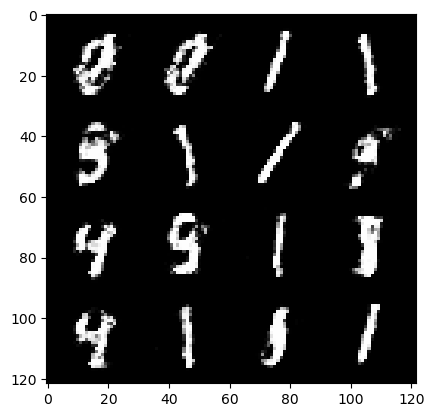

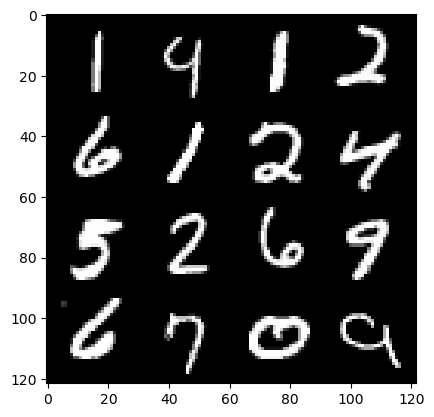

epoch: 150, step: 70500, gen loss: 1.8667225698630032, disc loss: 0.30120935728152604.


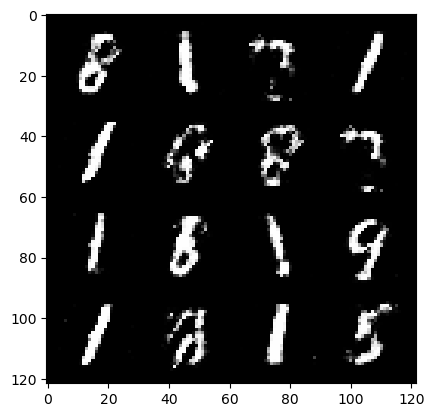

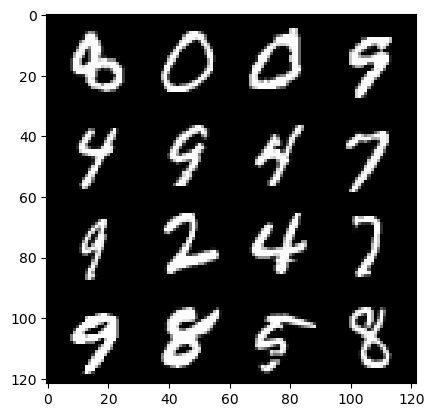

epoch: 150, step: 70800, gen loss: 1.8687952065467823, disc loss: 0.31179291332761455.


  0%|          | 0/469 [00:00<?, ?it/s]

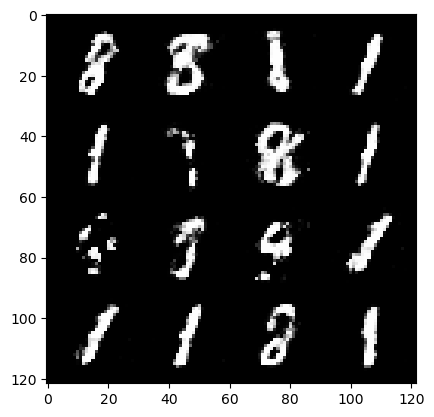

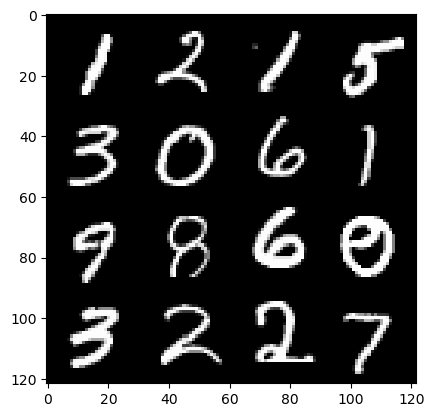

epoch: 151, step: 71100, gen loss: 1.829862834612528, disc loss: 0.31081441774964325.


  0%|          | 0/469 [00:00<?, ?it/s]

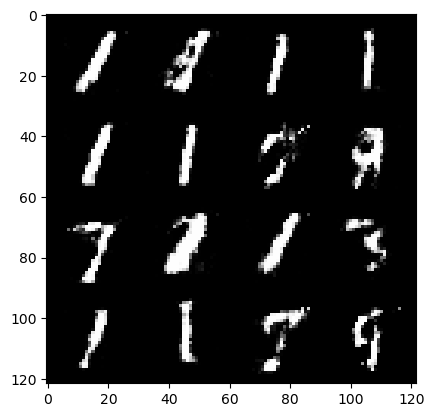

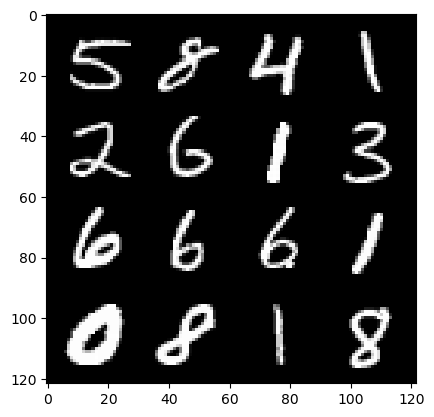

epoch: 152, step: 71400, gen loss: 1.8180579034487396, disc loss: 0.3090608382721741.


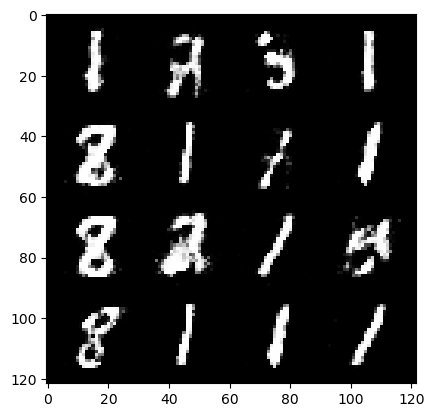

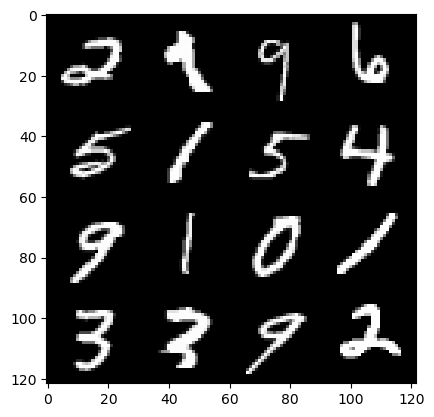

epoch: 152, step: 71700, gen loss: 1.812937143246334, disc loss: 0.3113708843787513.


  0%|          | 0/469 [00:00<?, ?it/s]

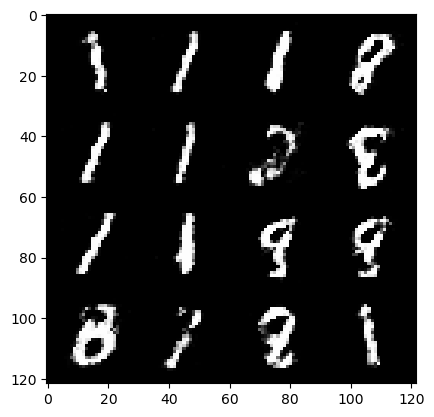

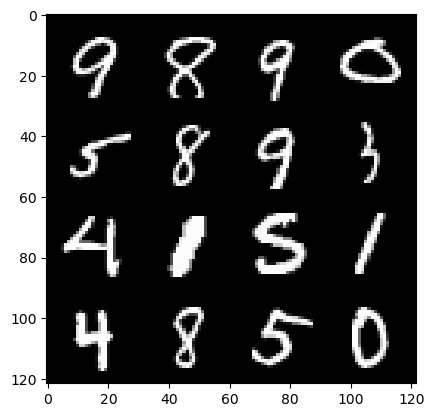

epoch: 153, step: 72000, gen loss: 1.8163015615940088, disc loss: 0.31601720546682693.


  0%|          | 0/469 [00:00<?, ?it/s]

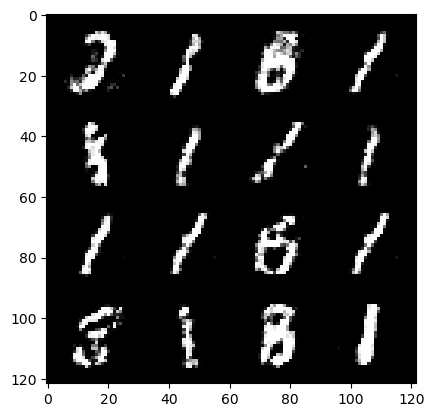

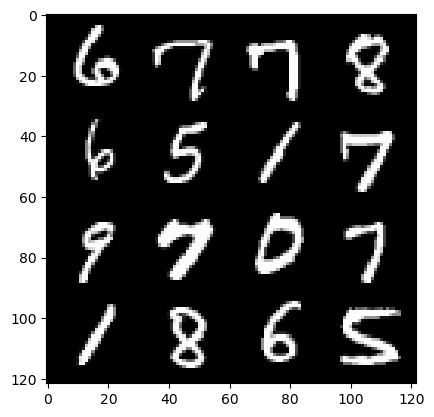

epoch: 154, step: 72300, gen loss: 1.8484765021006266, disc loss: 0.3119807478288811.


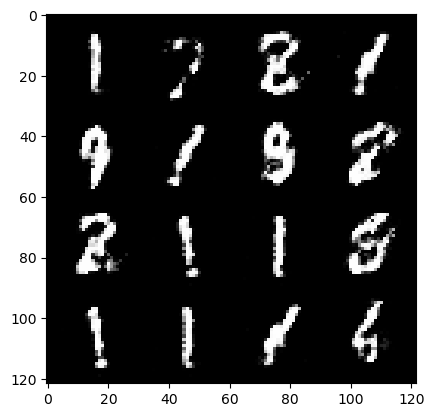

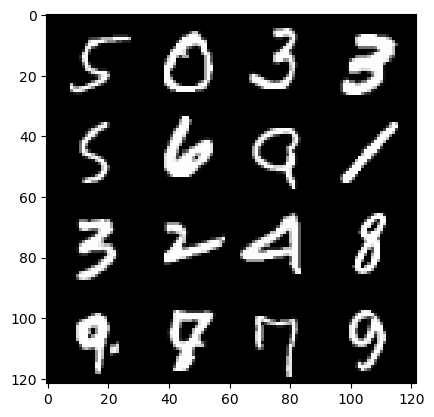

epoch: 154, step: 72600, gen loss: 1.7566302172342947, disc loss: 0.31704924419522285.


  0%|          | 0/469 [00:00<?, ?it/s]

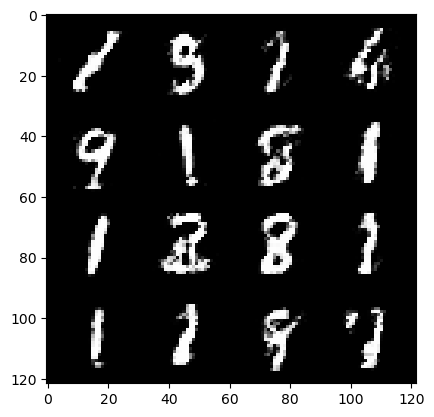

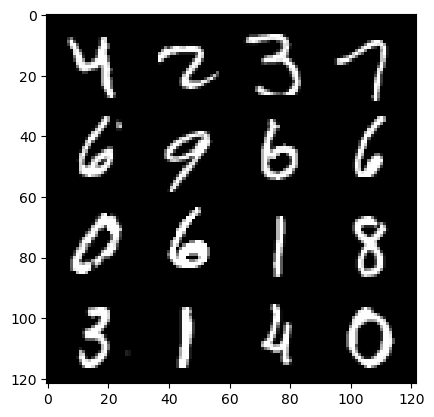

epoch: 155, step: 72900, gen loss: 1.7777611752351123, disc loss: 0.31815924197435386.


  0%|          | 0/469 [00:00<?, ?it/s]

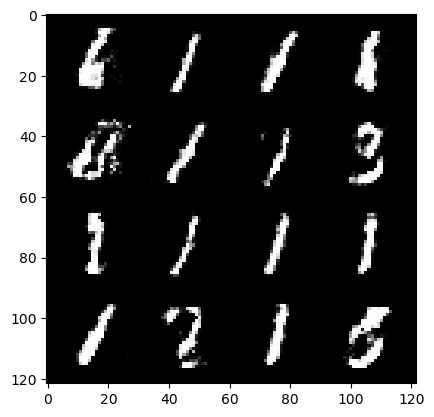

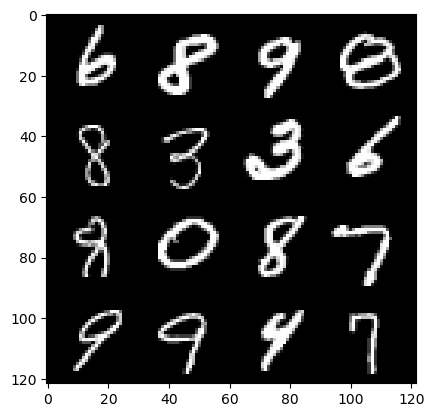

epoch: 156, step: 73200, gen loss: 1.7151441371440892, disc loss: 0.3214452458918098.


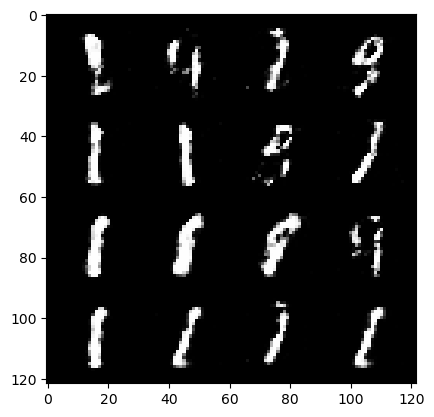

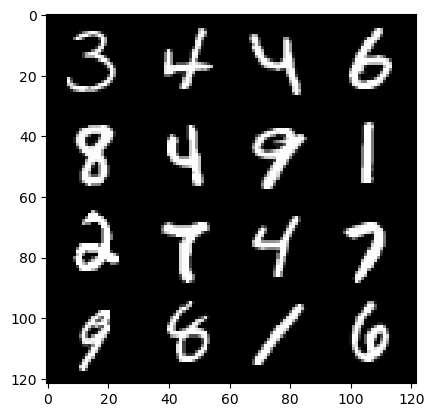

epoch: 156, step: 73500, gen loss: 1.7547412474950135, disc loss: 0.31682700802882513.


  0%|          | 0/469 [00:00<?, ?it/s]

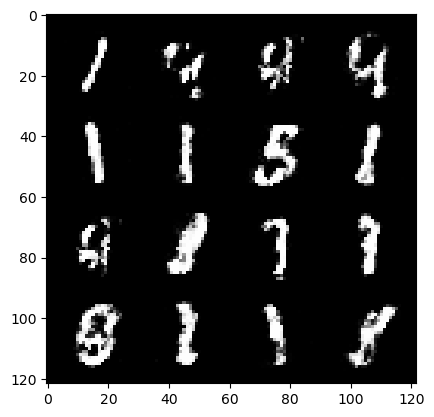

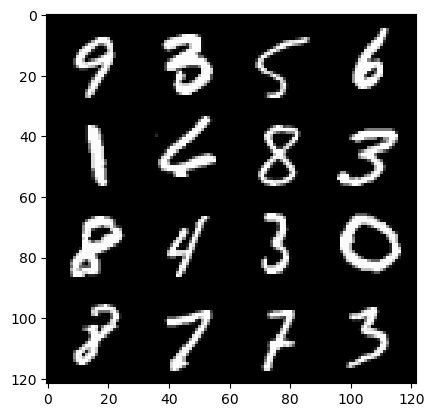

epoch: 157, step: 73800, gen loss: 1.8271700314680728, disc loss: 0.30798324604829147.


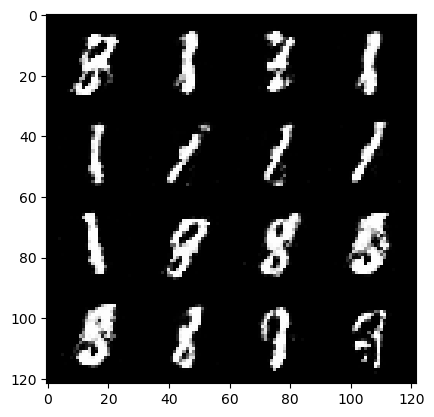

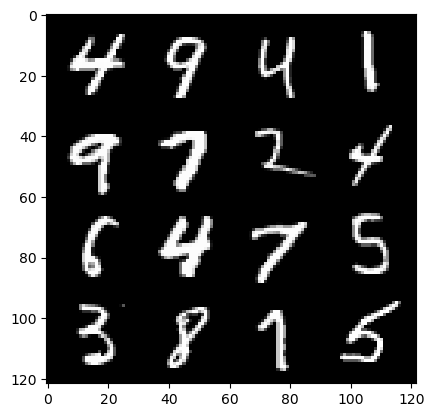

epoch: 157, step: 74100, gen loss: 1.855278685092927, disc loss: 0.30347130879759776.


  0%|          | 0/469 [00:00<?, ?it/s]

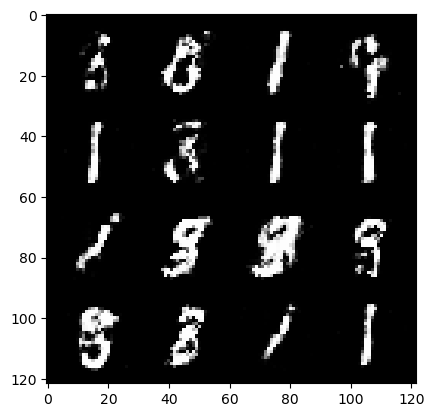

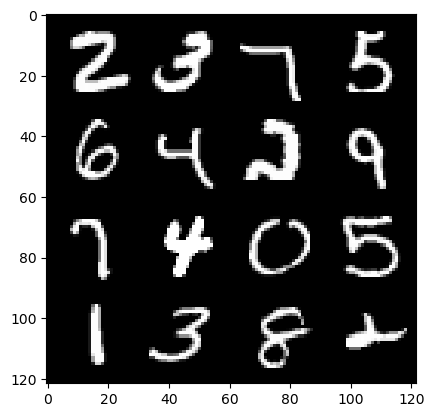

epoch: 158, step: 74400, gen loss: 1.8230442806084959, disc loss: 0.31565649867057805.


  0%|          | 0/469 [00:00<?, ?it/s]

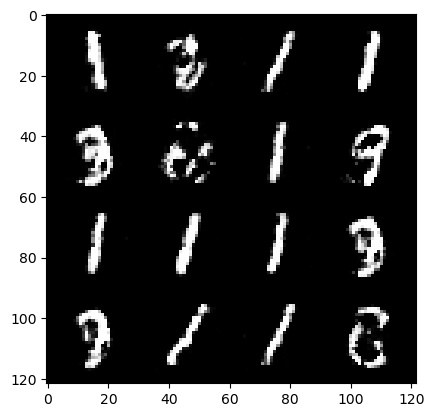

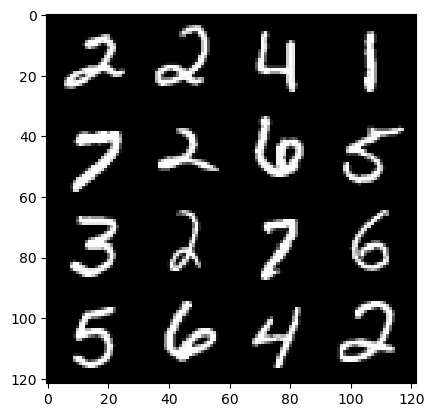

epoch: 159, step: 74700, gen loss: 1.7922691861788438, disc loss: 0.31568302373091384.


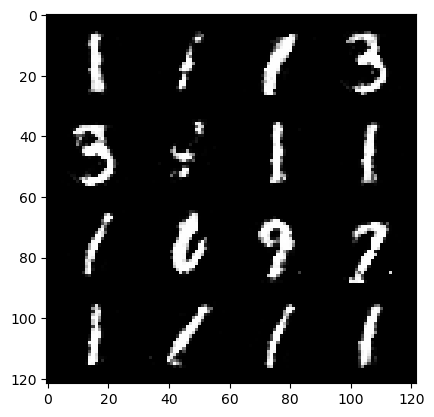

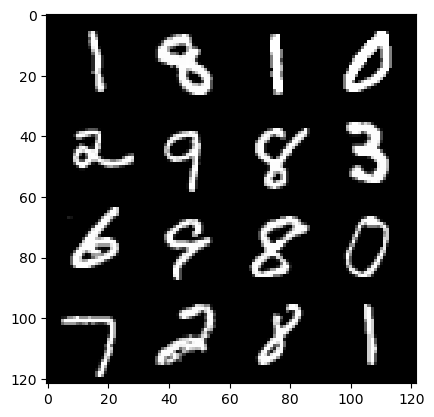

epoch: 159, step: 75000, gen loss: 1.8053619571526838, disc loss: 0.30684550568461433.


  0%|          | 0/469 [00:00<?, ?it/s]

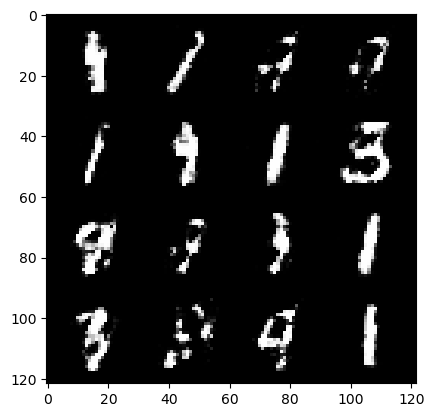

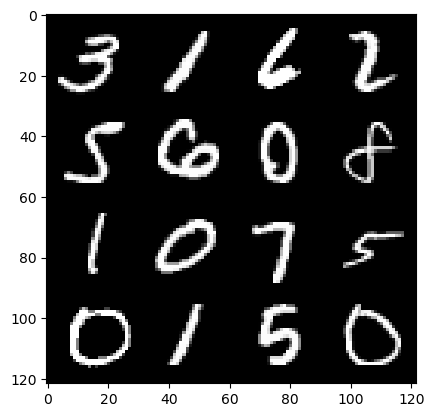

epoch: 160, step: 75300, gen loss: 1.8323618737856524, disc loss: 0.3072286436458428.


  0%|          | 0/469 [00:00<?, ?it/s]

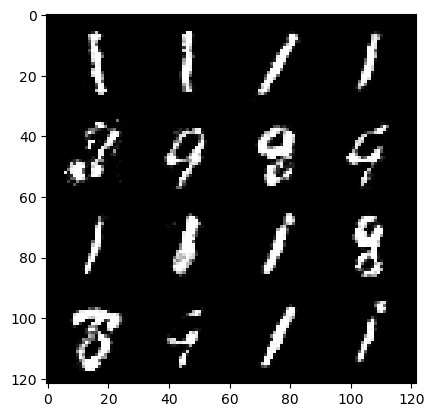

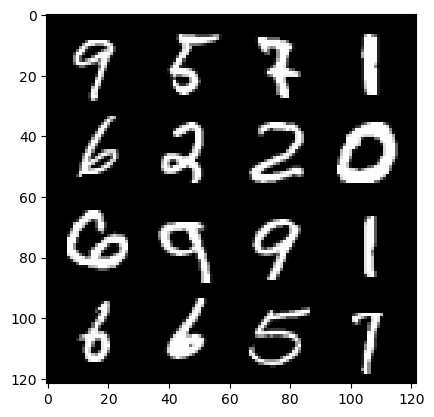

epoch: 161, step: 75600, gen loss: 1.698749007781347, disc loss: 0.3288060413797698.


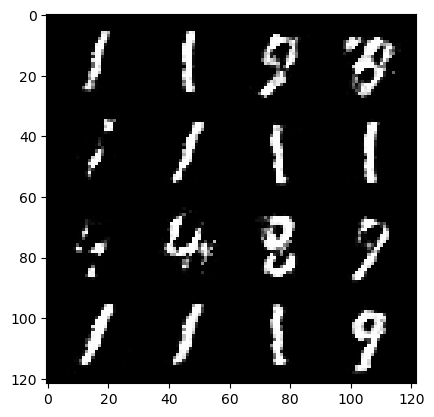

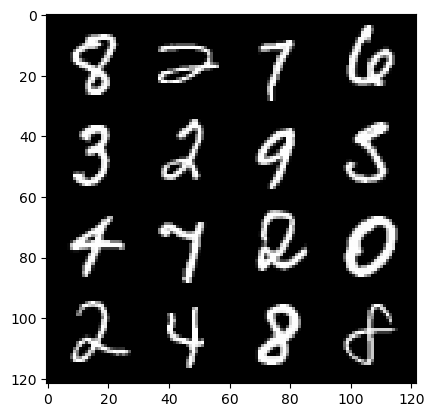

epoch: 161, step: 75900, gen loss: 1.7570763631661739, disc loss: 0.33253886957963297.


  0%|          | 0/469 [00:00<?, ?it/s]

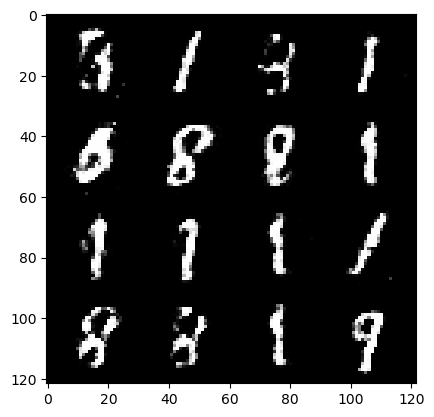

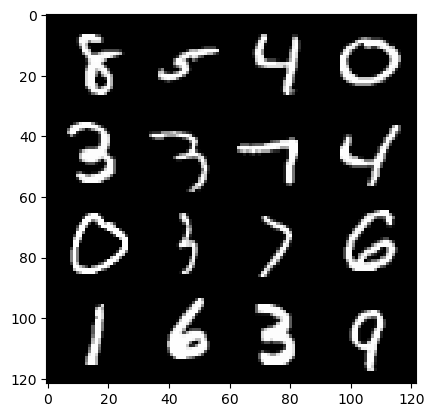

epoch: 162, step: 76200, gen loss: 1.7766562549273188, disc loss: 0.3193273792664209.


  0%|          | 0/469 [00:00<?, ?it/s]

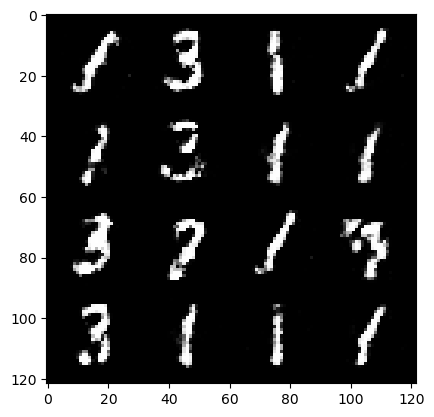

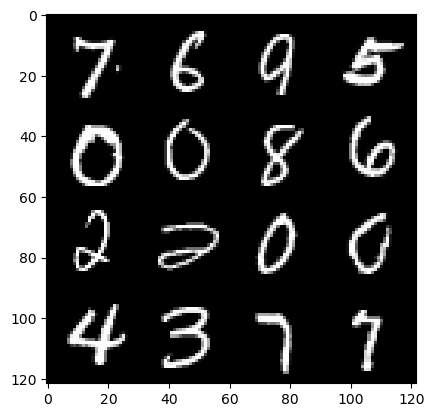

epoch: 163, step: 76500, gen loss: 1.8110085097948712, disc loss: 0.30168534636497474.


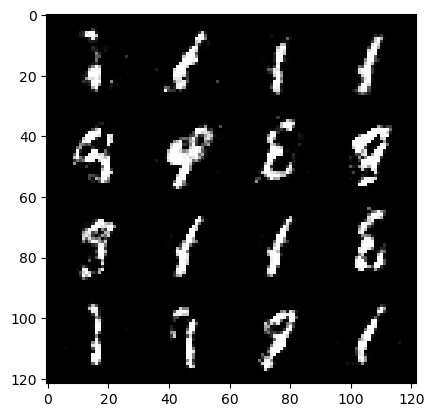

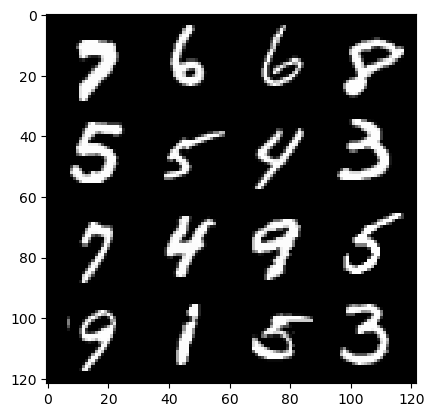

epoch: 163, step: 76800, gen loss: 1.8748369292418166, disc loss: 0.29059275935093587.


  0%|          | 0/469 [00:00<?, ?it/s]

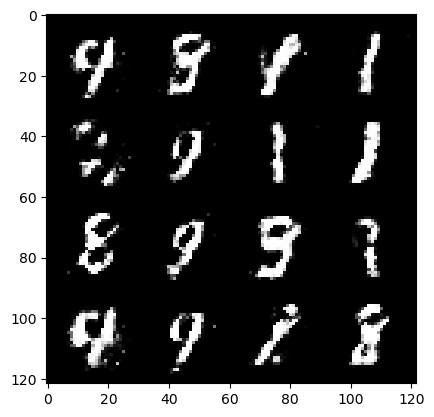

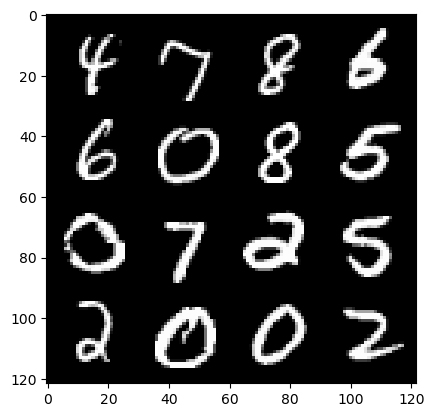

epoch: 164, step: 77100, gen loss: 1.8362296768029531, disc loss: 0.30343321348230023.


  0%|          | 0/469 [00:00<?, ?it/s]

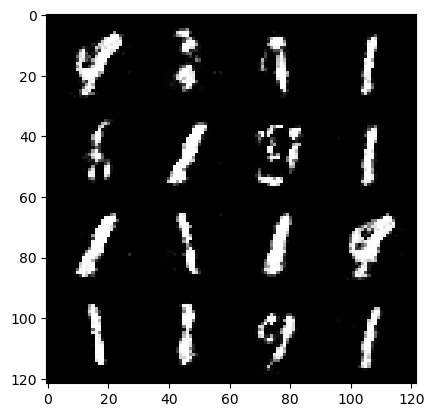

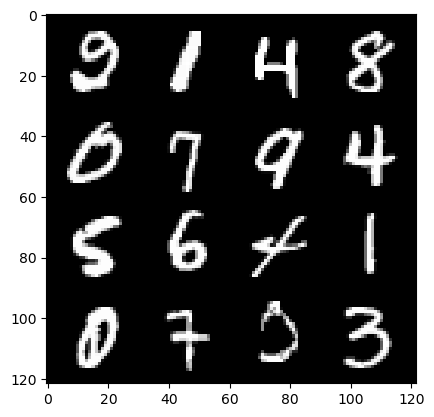

epoch: 165, step: 77400, gen loss: 1.8970629167556776, disc loss: 0.2983905325829983.


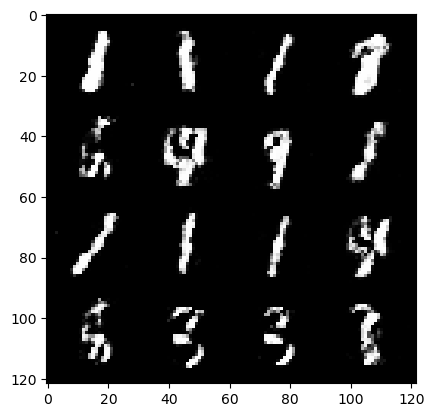

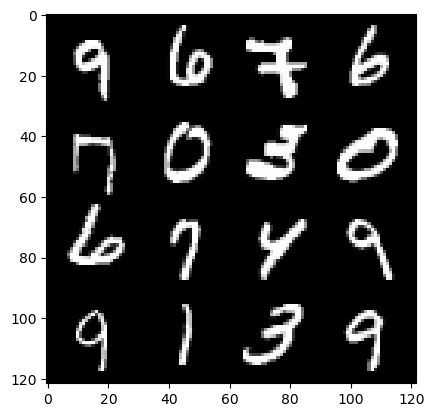

epoch: 165, step: 77700, gen loss: 1.8302202089627575, disc loss: 0.3077495303253334.


  0%|          | 0/469 [00:00<?, ?it/s]

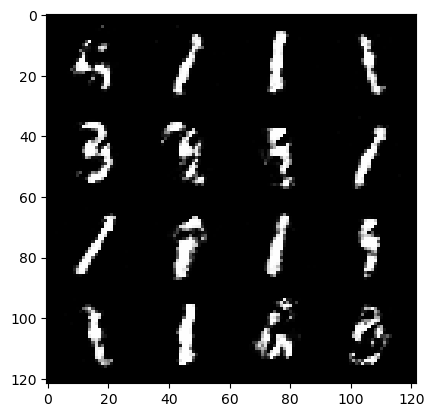

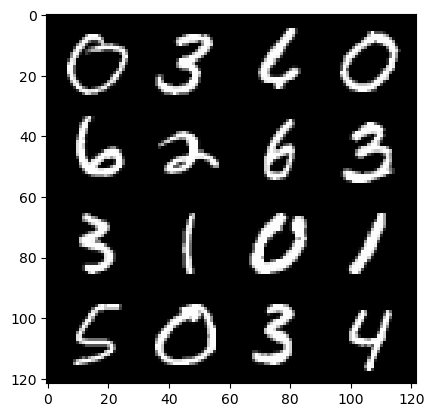

epoch: 166, step: 78000, gen loss: 1.7688266086578375, disc loss: 0.3198434538642566.


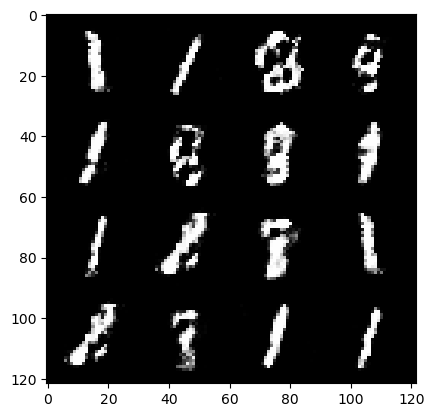

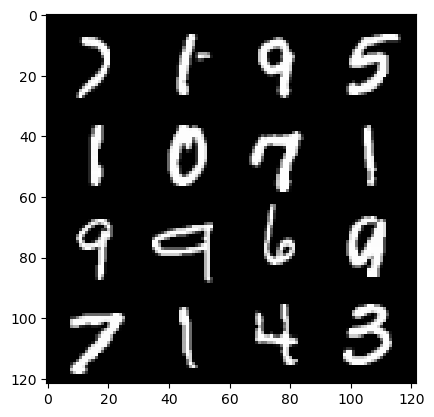

epoch: 166, step: 78300, gen loss: 1.849818512598672, disc loss: 0.30622190549969686.


  0%|          | 0/469 [00:00<?, ?it/s]

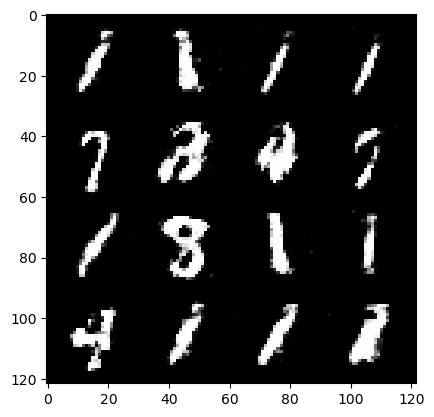

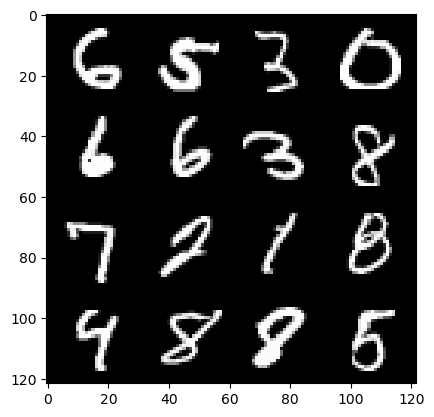

epoch: 167, step: 78600, gen loss: 1.8598010524113981, disc loss: 0.29696188171704624.


  0%|          | 0/469 [00:00<?, ?it/s]

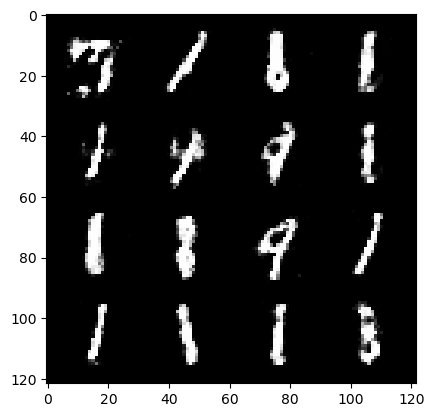

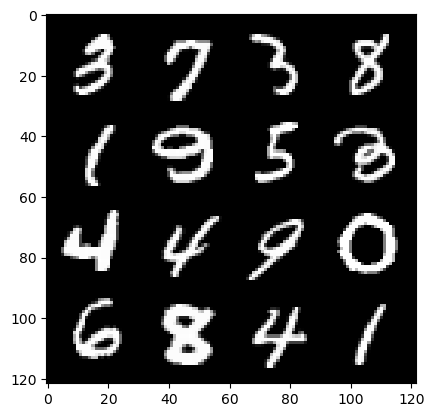

epoch: 168, step: 78900, gen loss: 1.8517220946153001, disc loss: 0.29600106894969935.


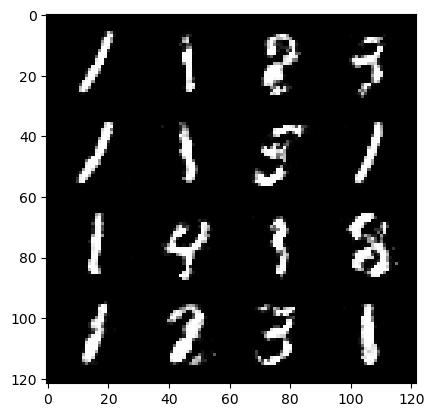

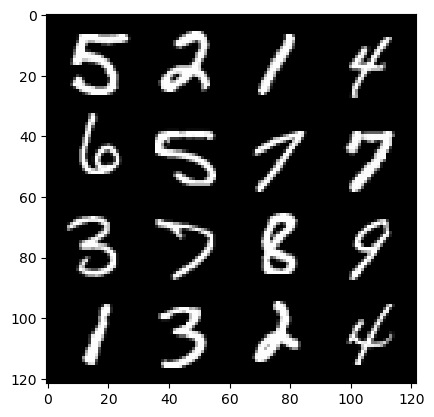

epoch: 168, step: 79200, gen loss: 1.7899874238173166, disc loss: 0.31928363998730963.


  0%|          | 0/469 [00:00<?, ?it/s]

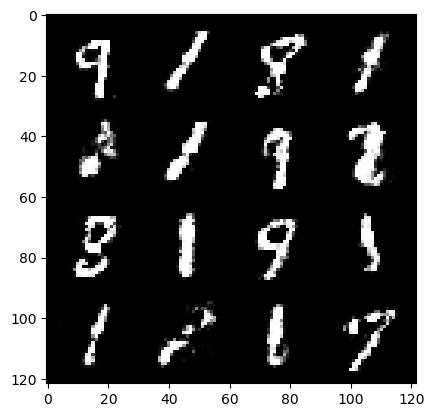

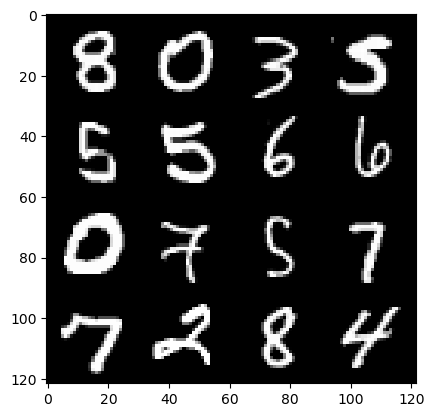

epoch: 169, step: 79500, gen loss: 1.7486968882878624, disc loss: 0.3256468987464908.


  0%|          | 0/469 [00:00<?, ?it/s]

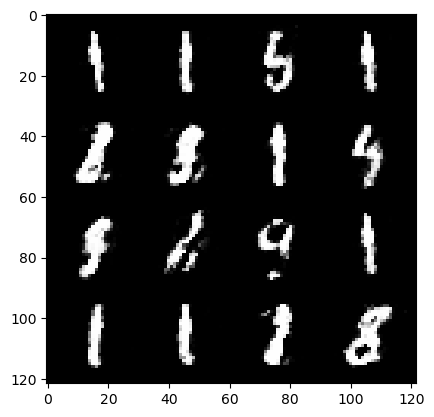

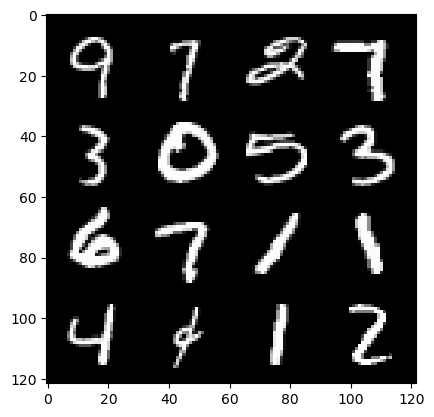

epoch: 170, step: 79800, gen loss: 1.8440621777375557, disc loss: 0.3025393633544446.


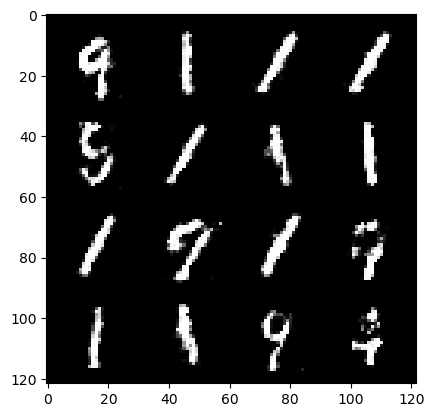

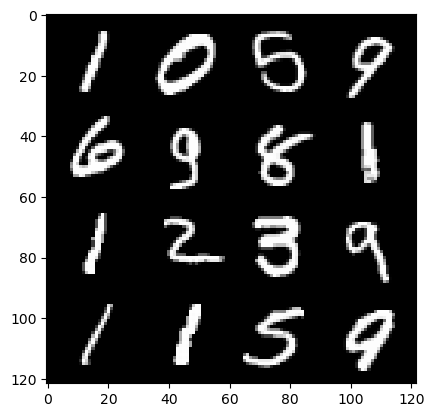

epoch: 170, step: 80100, gen loss: 1.8648203670978536, disc loss: 0.30042817557851476.


  0%|          | 0/469 [00:00<?, ?it/s]

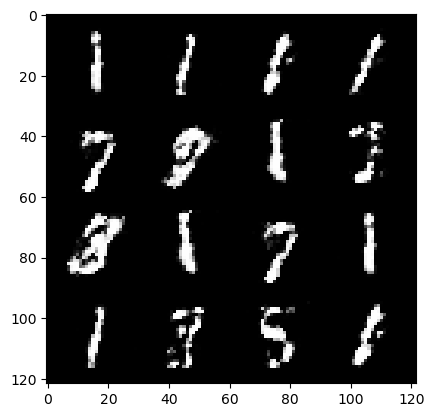

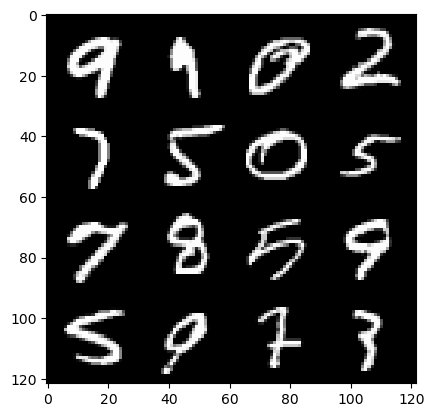

epoch: 171, step: 80400, gen loss: 1.7112098300457, disc loss: 0.33295521408319506.


  0%|          | 0/469 [00:00<?, ?it/s]

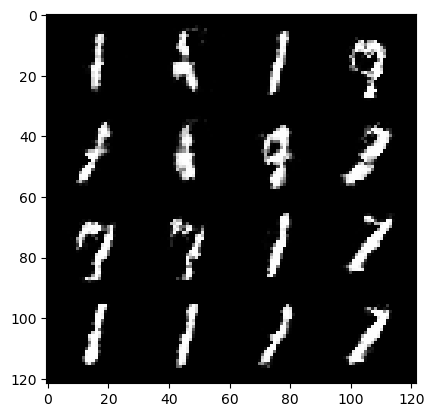

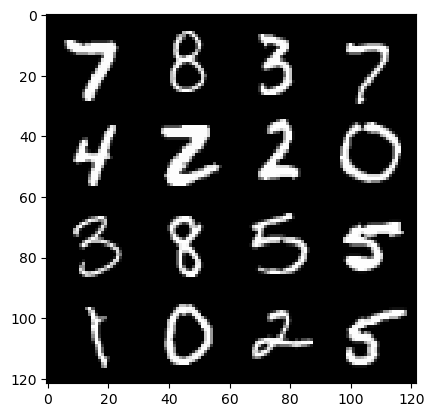

epoch: 172, step: 80700, gen loss: 1.678187761704128, disc loss: 0.3269743838906289.


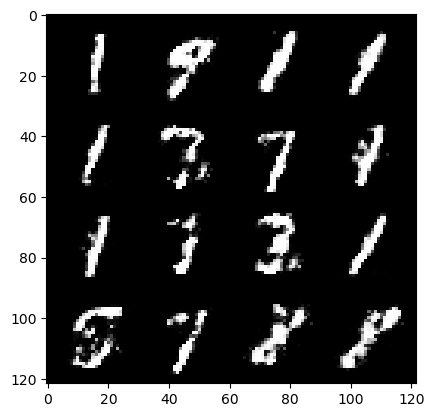

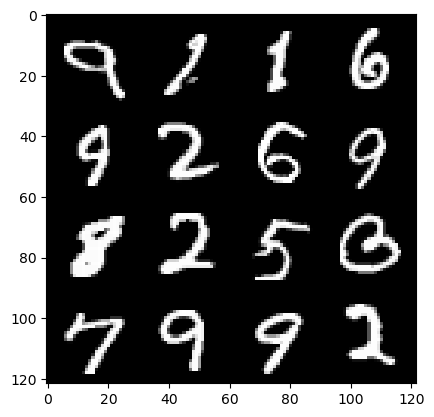

epoch: 172, step: 81000, gen loss: 1.8342656358083083, disc loss: 0.30248558968305594.


  0%|          | 0/469 [00:00<?, ?it/s]

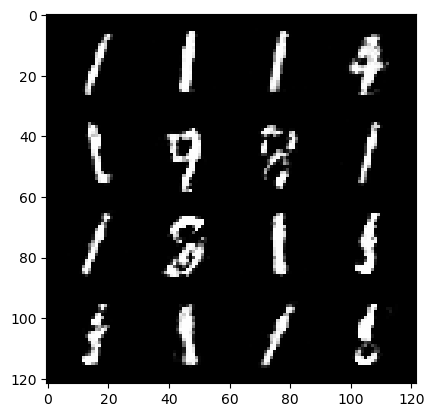

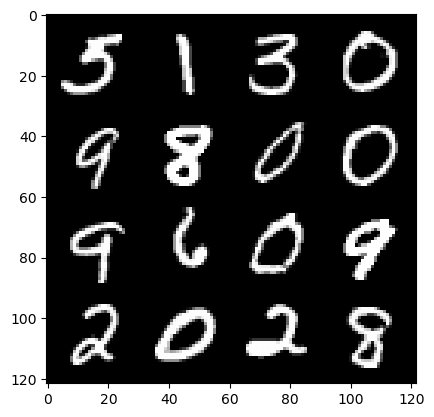

epoch: 173, step: 81300, gen loss: 1.8256320301691695, disc loss: 0.31002224038044623.


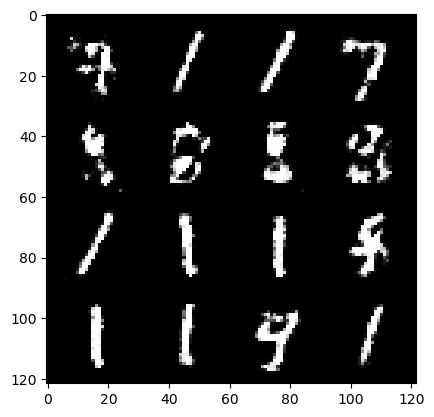

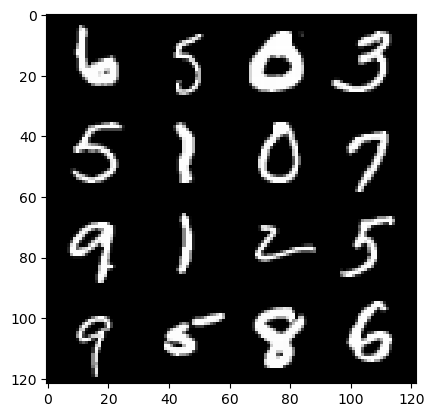

epoch: 173, step: 81600, gen loss: 1.7746704363822934, disc loss: 0.3173803494870665.


  0%|          | 0/469 [00:00<?, ?it/s]

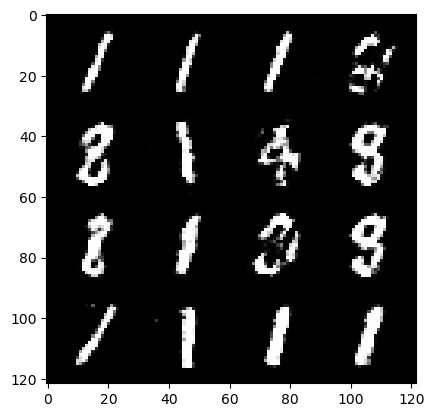

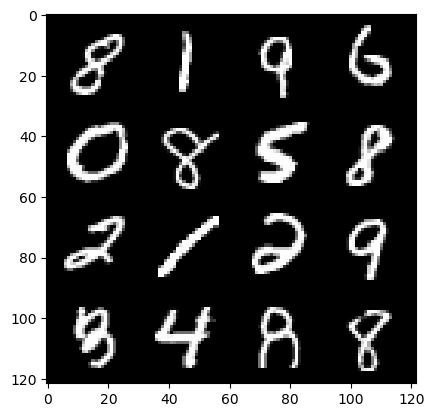

epoch: 174, step: 81900, gen loss: 1.73817805926005, disc loss: 0.33170042256514215.


  0%|          | 0/469 [00:00<?, ?it/s]

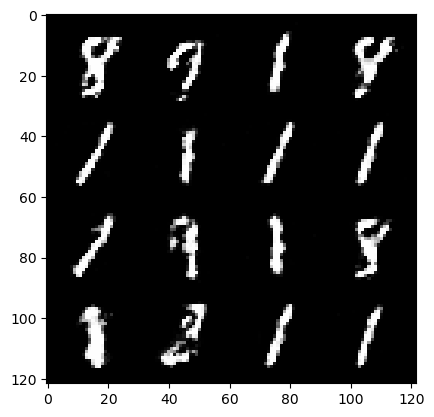

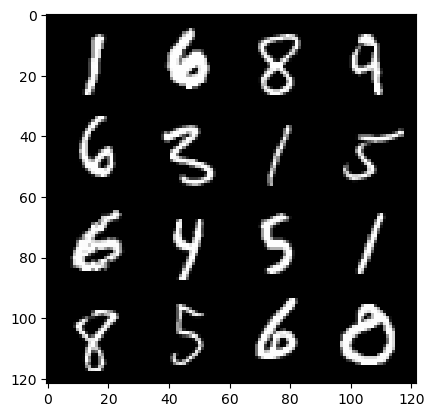

epoch: 175, step: 82200, gen loss: 1.7172890996933001, disc loss: 0.32953628644347216.


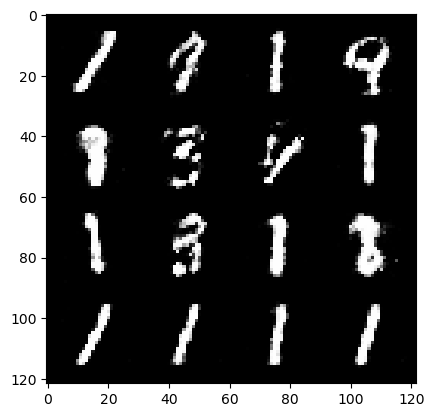

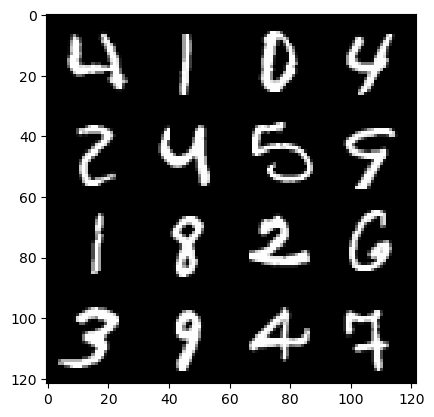

epoch: 175, step: 82500, gen loss: 1.718220715920128, disc loss: 0.33233127757906905.


  0%|          | 0/469 [00:00<?, ?it/s]

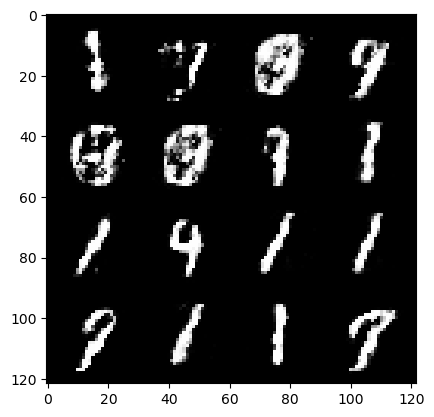

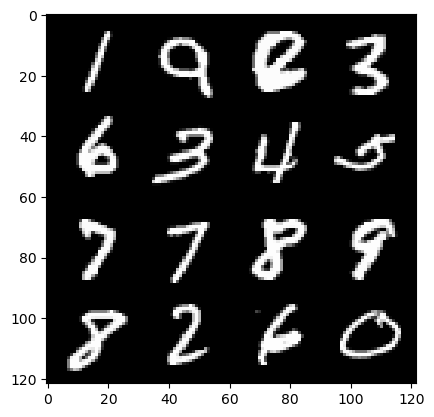

epoch: 176, step: 82800, gen loss: 1.646753140687942, disc loss: 0.34785022944211974.


  0%|          | 0/469 [00:00<?, ?it/s]

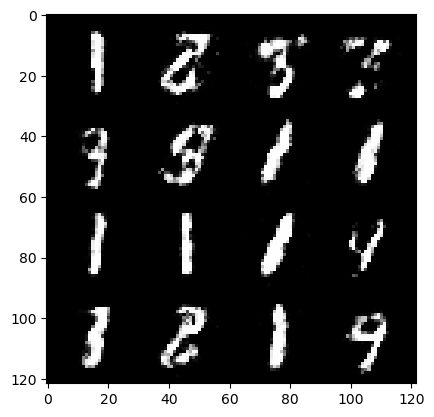

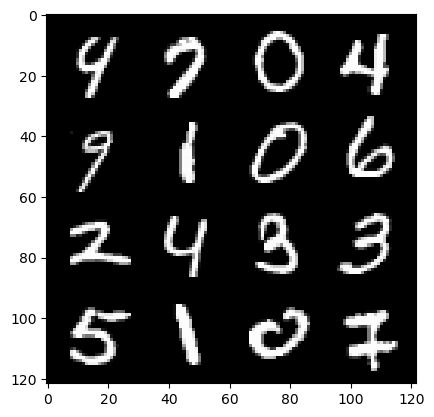

epoch: 177, step: 83100, gen loss: 1.7911602207024875, disc loss: 0.31780026058355954.


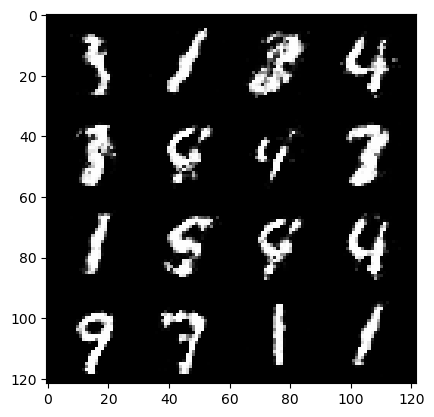

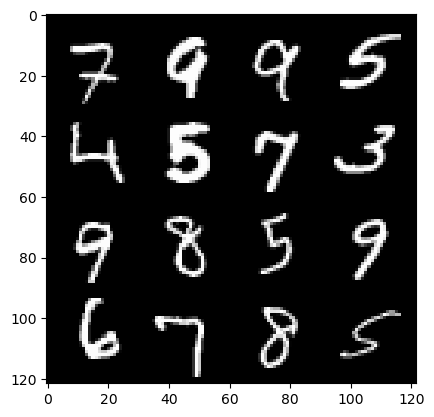

epoch: 177, step: 83400, gen loss: 1.7246604414780953, disc loss: 0.33339796190460513.


  0%|          | 0/469 [00:00<?, ?it/s]

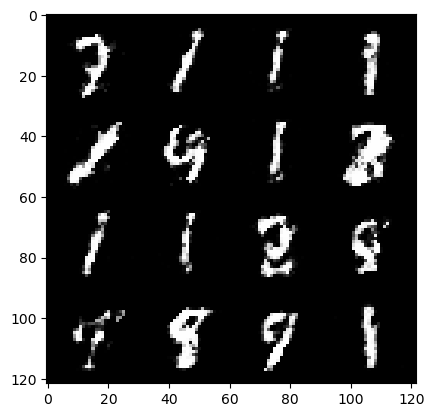

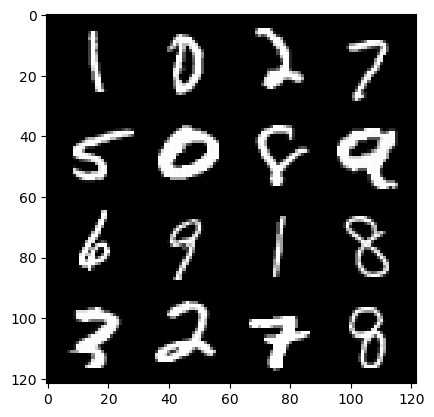

epoch: 178, step: 83700, gen loss: 1.6984175682067868, disc loss: 0.3306407719850539.


  0%|          | 0/469 [00:00<?, ?it/s]

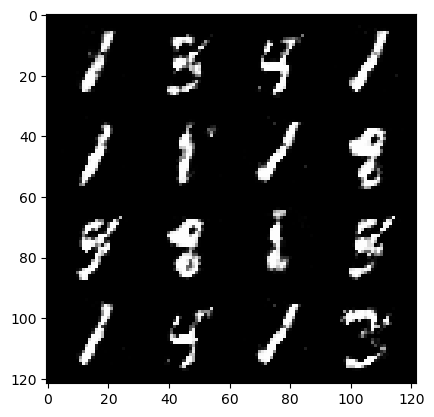

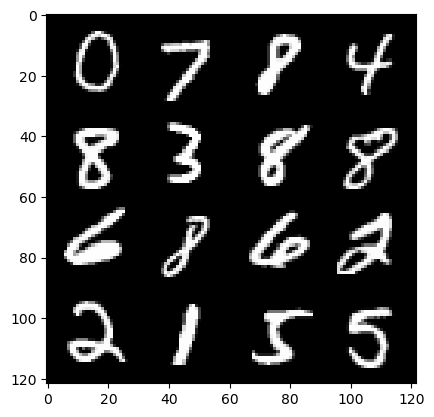

epoch: 179, step: 84000, gen loss: 1.705305385192236, disc loss: 0.3177498192588489.


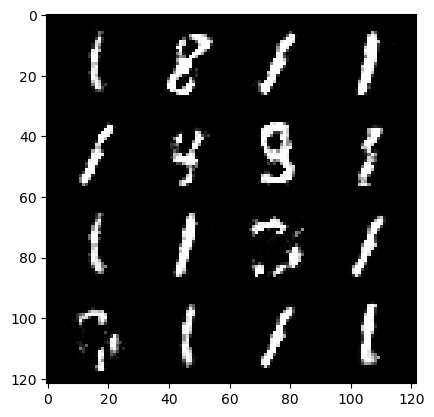

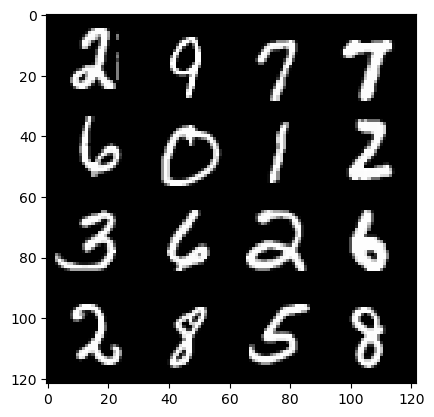

epoch: 179, step: 84300, gen loss: 1.7444972380002333, disc loss: 0.30955031866828603.


  0%|          | 0/469 [00:00<?, ?it/s]

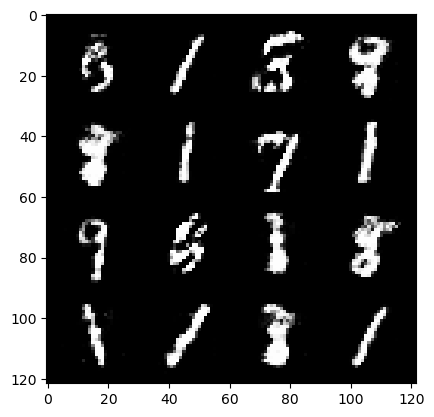

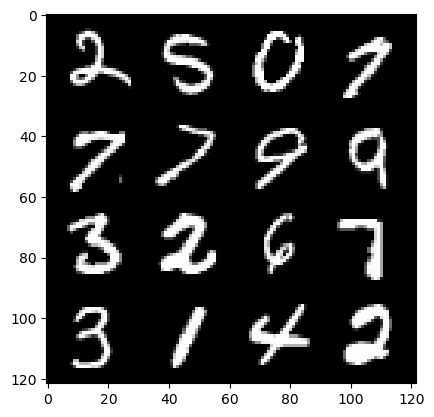

epoch: 180, step: 84600, gen loss: 1.7585239879290275, disc loss: 0.31966076682011274.


  0%|          | 0/469 [00:00<?, ?it/s]

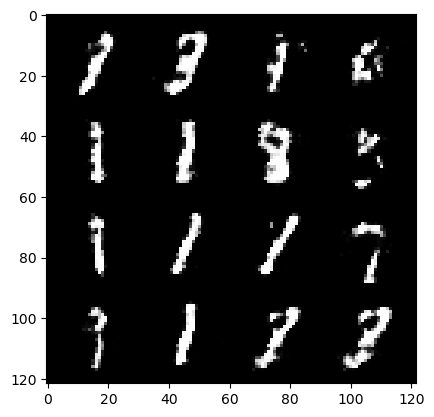

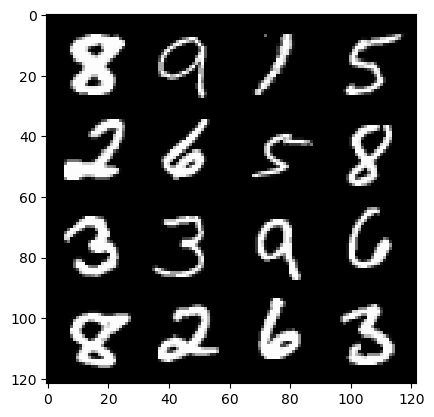

epoch: 181, step: 84900, gen loss: 1.7464922563234966, disc loss: 0.31403522759675995.


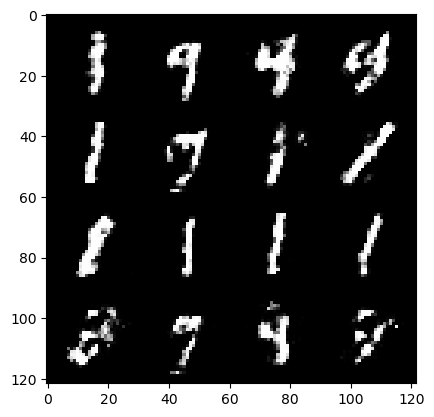

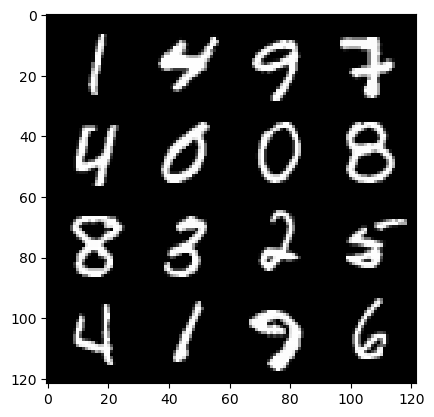

epoch: 181, step: 85200, gen loss: 1.7196084193388634, disc loss: 0.3305313303073247.


  0%|          | 0/469 [00:00<?, ?it/s]

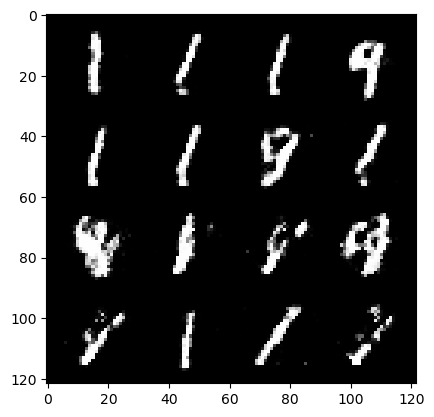

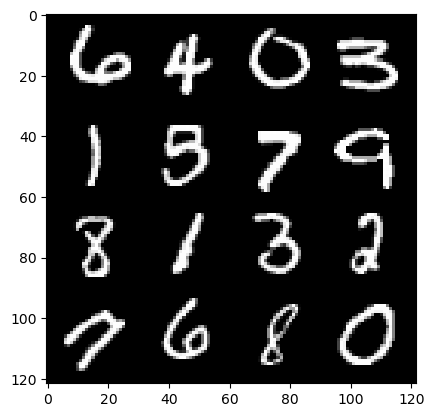

epoch: 182, step: 85500, gen loss: 1.6025019907951354, disc loss: 0.3516462365289529.


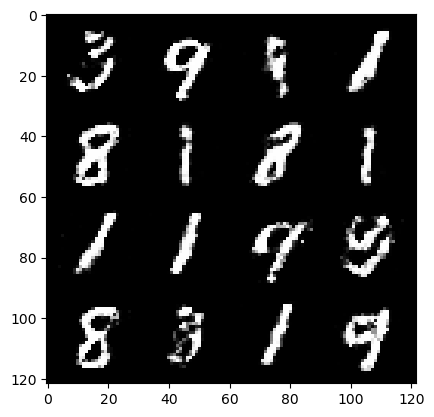

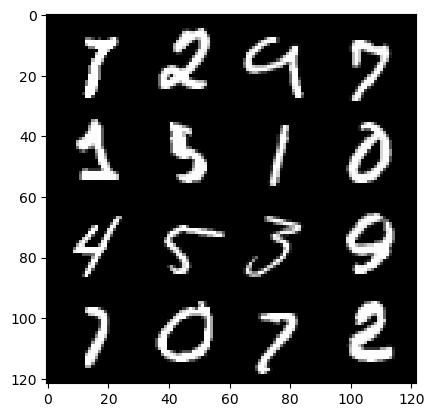

epoch: 182, step: 85800, gen loss: 1.6582469236850748, disc loss: 0.3543237753709159.


  0%|          | 0/469 [00:00<?, ?it/s]

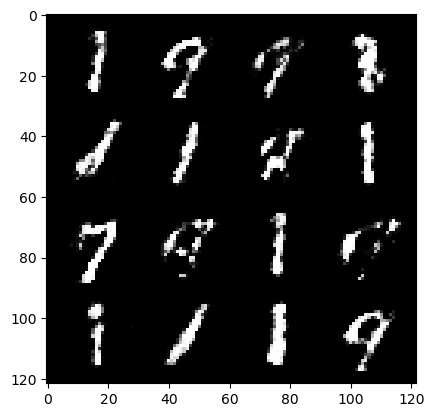

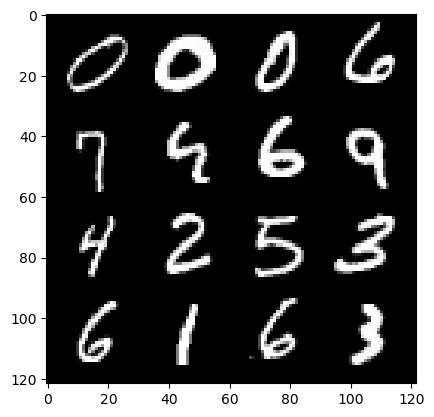

epoch: 183, step: 86100, gen loss: 1.6223612380027779, disc loss: 0.3487476566433908.


  0%|          | 0/469 [00:00<?, ?it/s]

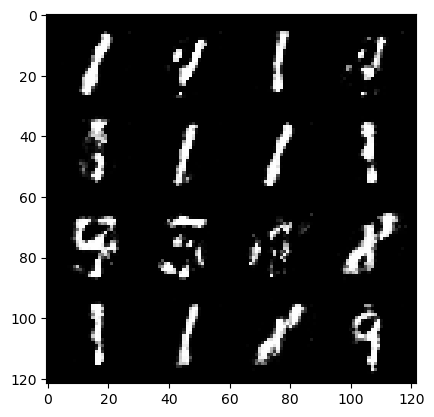

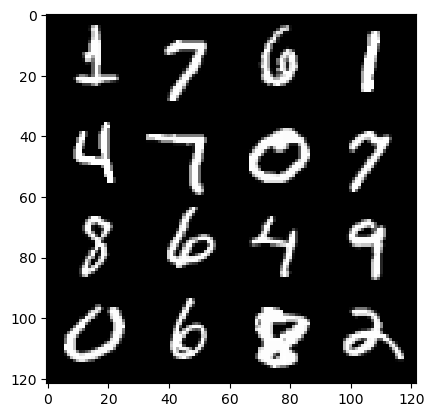

epoch: 184, step: 86400, gen loss: 1.653976338704427, disc loss: 0.35035729209582.


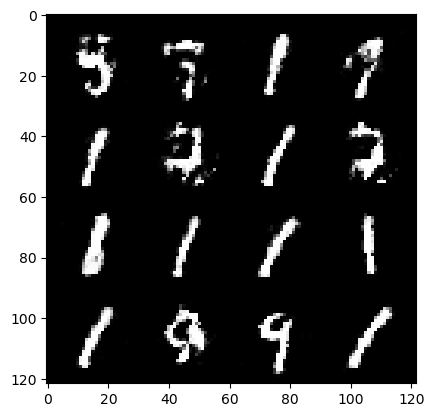

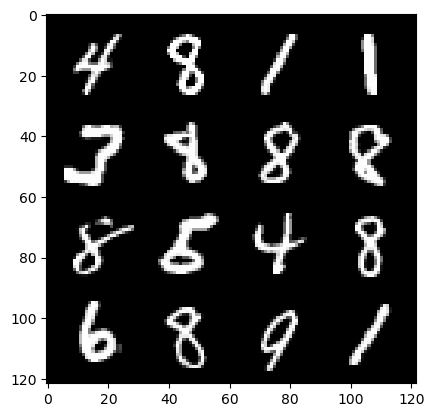

epoch: 184, step: 86700, gen loss: 1.6897687057654054, disc loss: 0.33966389248768486.


  0%|          | 0/469 [00:00<?, ?it/s]

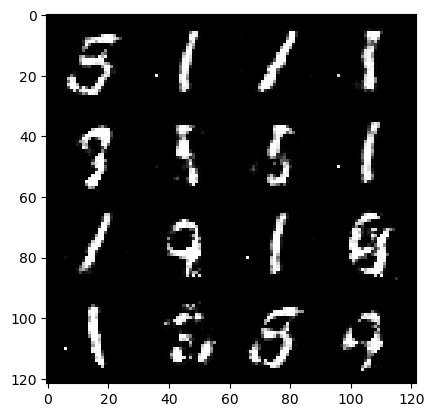

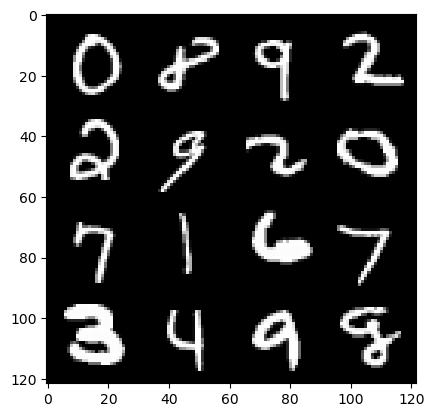

epoch: 185, step: 87000, gen loss: 1.7982781481742864, disc loss: 0.3226907131075859.


  0%|          | 0/469 [00:00<?, ?it/s]

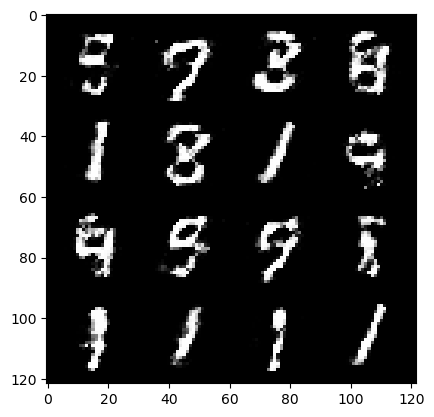

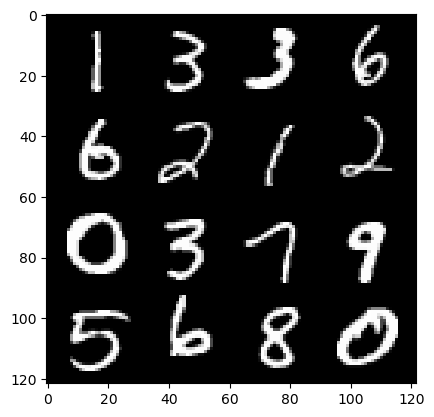

epoch: 186, step: 87300, gen loss: 1.7013567388057709, disc loss: 0.3350783943136536.


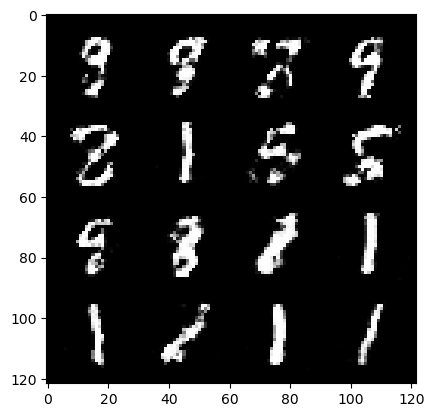

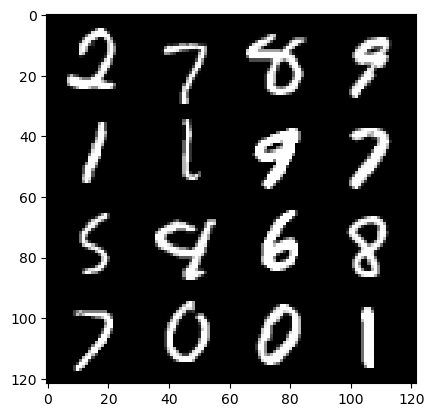

epoch: 186, step: 87600, gen loss: 1.7133583970864619, disc loss: 0.3372055334349473.


  0%|          | 0/469 [00:00<?, ?it/s]

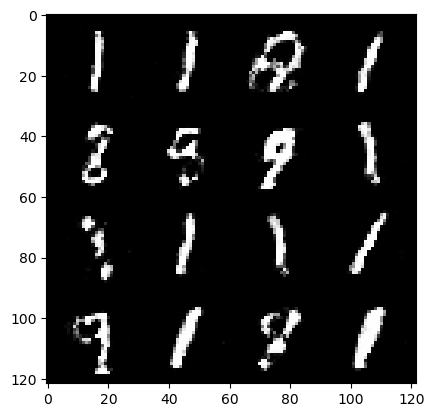

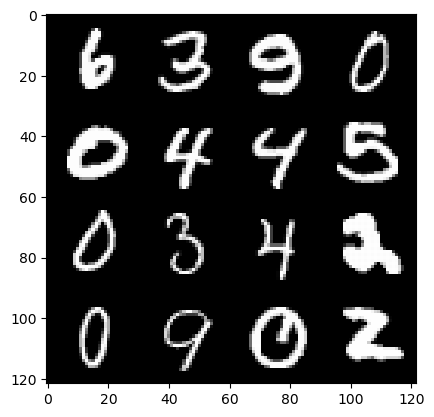

epoch: 187, step: 87900, gen loss: 1.656166906356812, disc loss: 0.34334333459536226.


  0%|          | 0/469 [00:00<?, ?it/s]

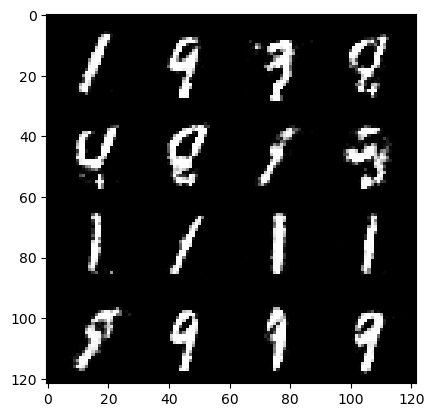

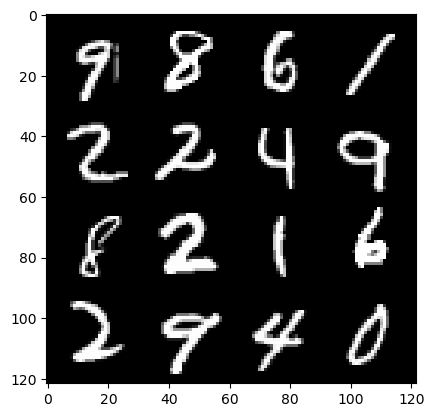

epoch: 188, step: 88200, gen loss: 1.6112986985842395, disc loss: 0.34879171907901774.


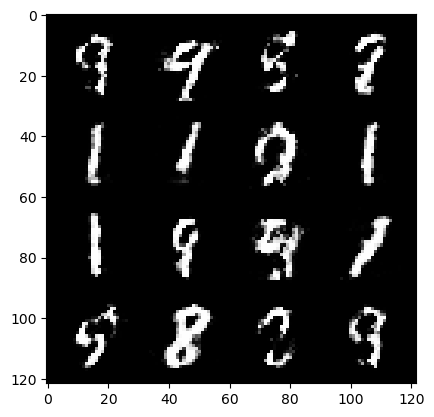

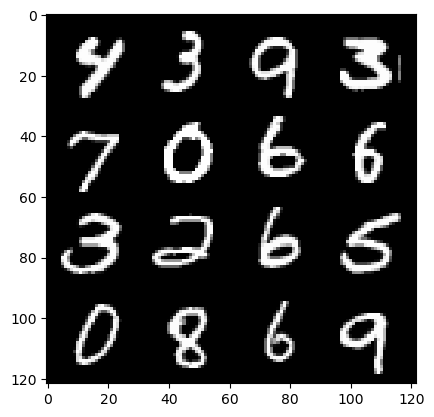

epoch: 188, step: 88500, gen loss: 1.6712404668331151, disc loss: 0.33616574714581166.


  0%|          | 0/469 [00:00<?, ?it/s]

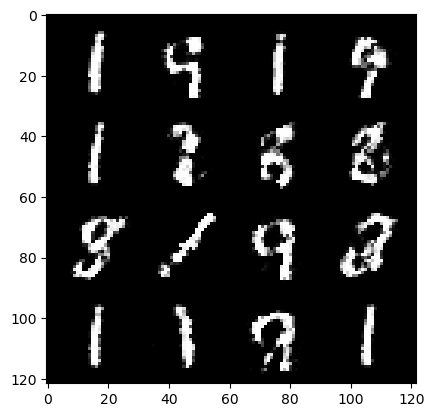

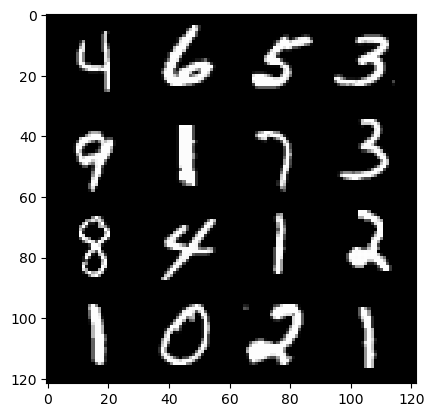

epoch: 189, step: 88800, gen loss: 1.727762471437455, disc loss: 0.3273853657643.


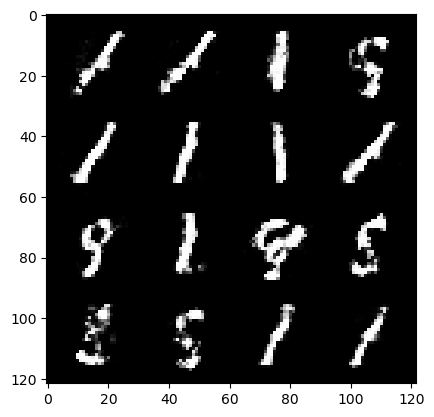

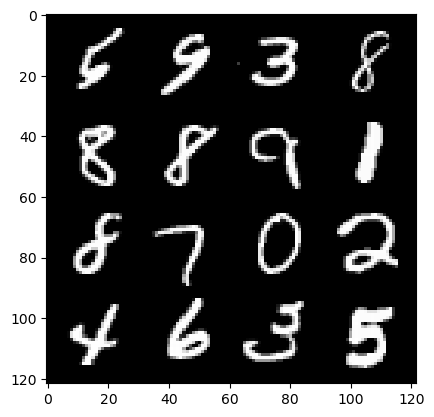

epoch: 189, step: 89100, gen loss: 1.7038811175028485, disc loss: 0.34034617016712826.


  0%|          | 0/469 [00:00<?, ?it/s]

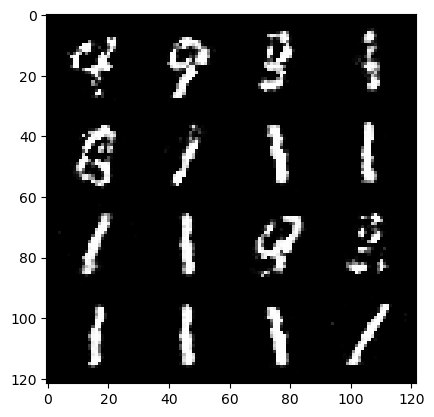

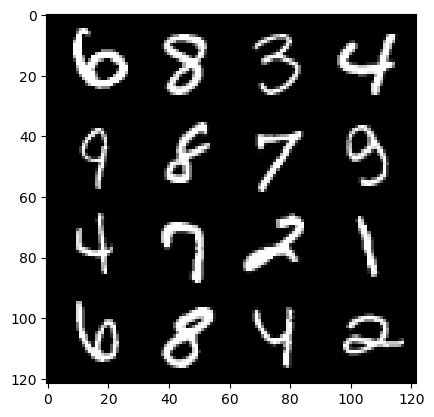

epoch: 190, step: 89400, gen loss: 1.702147523959478, disc loss: 0.3399378368258481.


  0%|          | 0/469 [00:00<?, ?it/s]

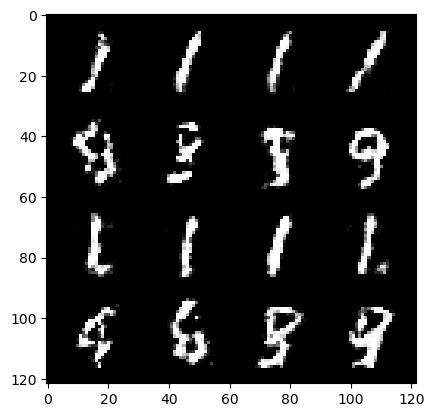

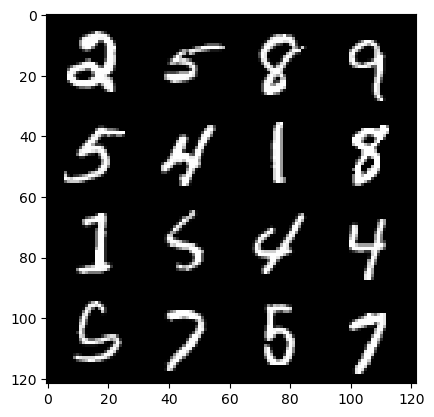

epoch: 191, step: 89700, gen loss: 1.6994089857737218, disc loss: 0.3368428362409272.


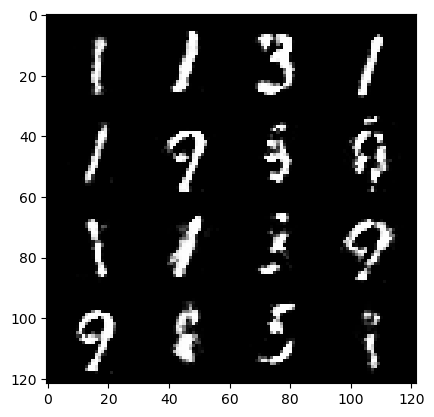

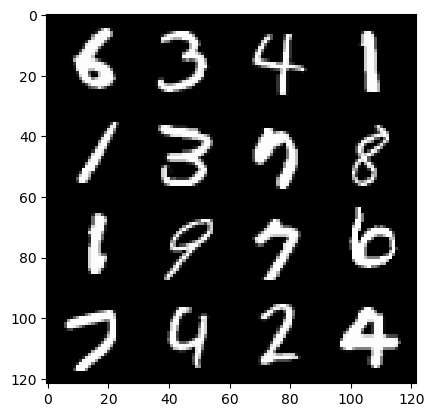

epoch: 191, step: 90000, gen loss: 1.6338188354174292, disc loss: 0.3431620599826181.


  0%|          | 0/469 [00:00<?, ?it/s]

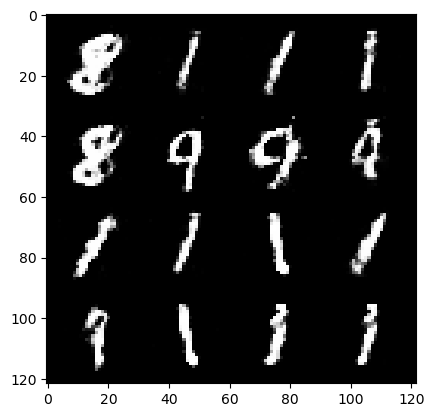

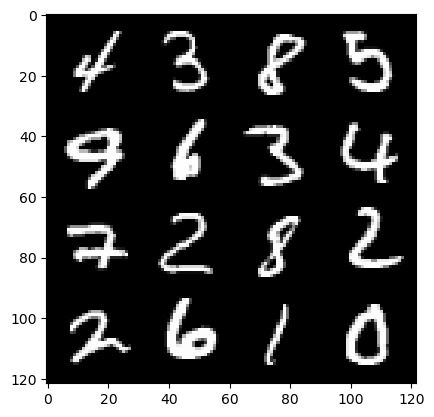

epoch: 192, step: 90300, gen loss: 1.6035029435157773, disc loss: 0.3493218713005381.


  0%|          | 0/469 [00:00<?, ?it/s]

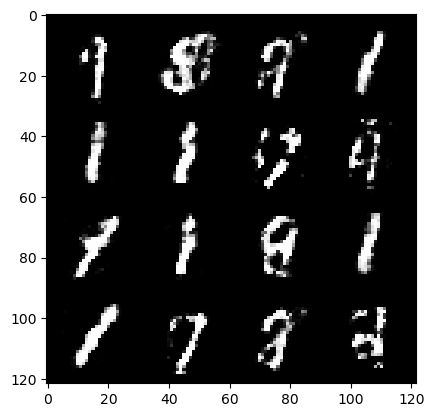

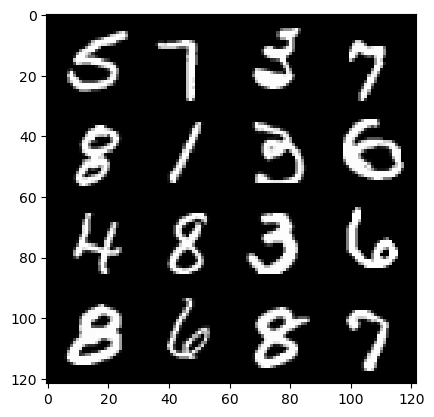

epoch: 193, step: 90600, gen loss: 1.5762663066387177, disc loss: 0.3497600102424622.


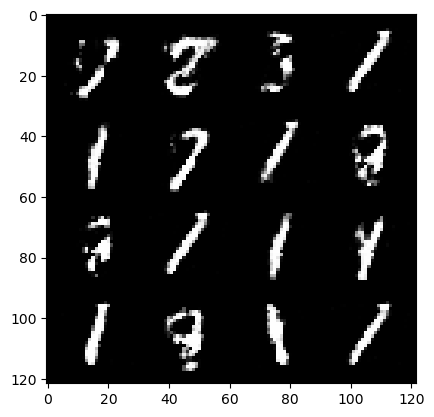

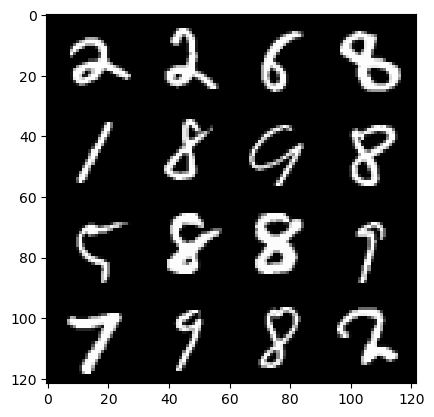

epoch: 193, step: 90900, gen loss: 1.6361370070775345, disc loss: 0.35783261825640983.


  0%|          | 0/469 [00:00<?, ?it/s]

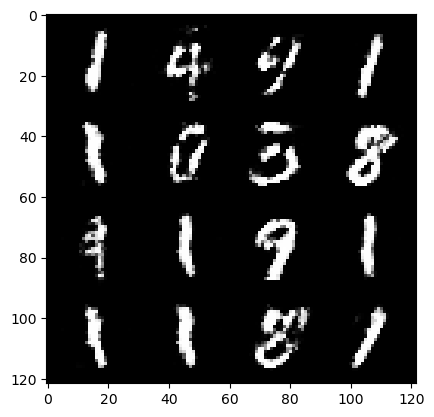

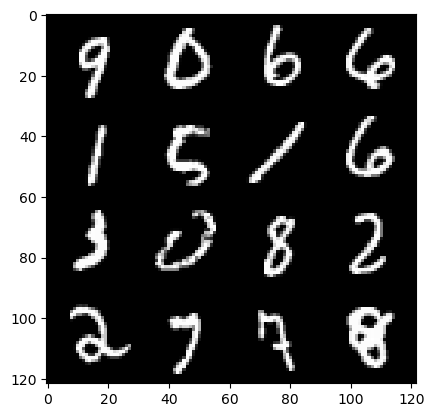

epoch: 194, step: 91200, gen loss: 1.6561958404382073, disc loss: 0.35349852104981744.


  0%|          | 0/469 [00:00<?, ?it/s]

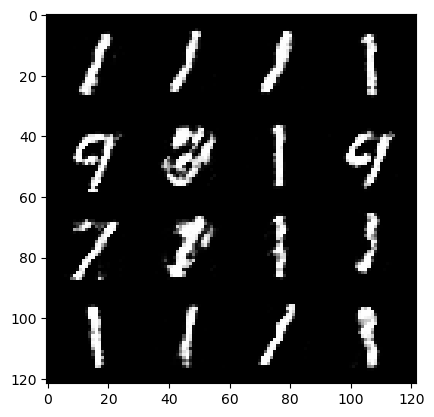

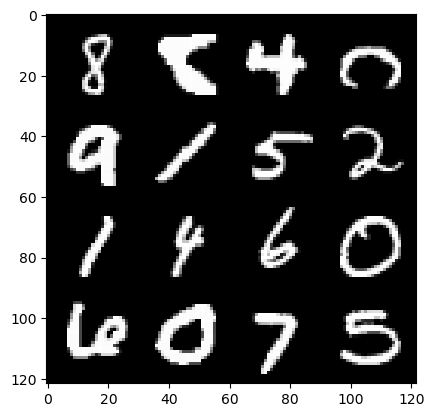

epoch: 195, step: 91500, gen loss: 1.6173128191630037, disc loss: 0.35766463478406263.


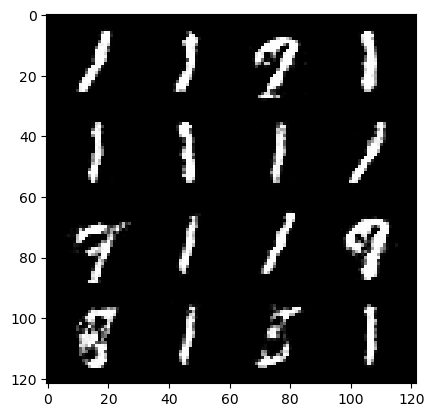

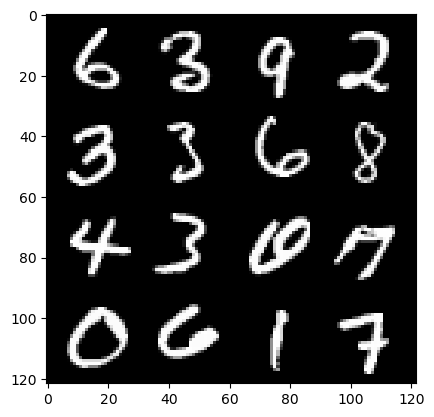

epoch: 195, step: 91800, gen loss: 1.6562105413277948, disc loss: 0.34948265537619566.


  0%|          | 0/469 [00:00<?, ?it/s]

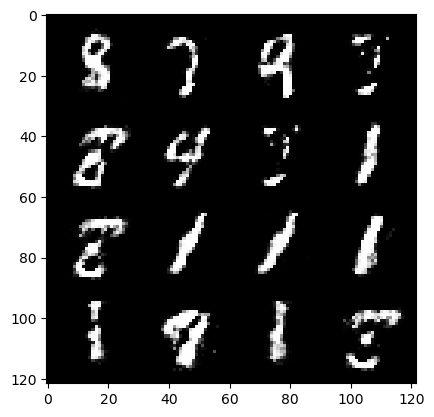

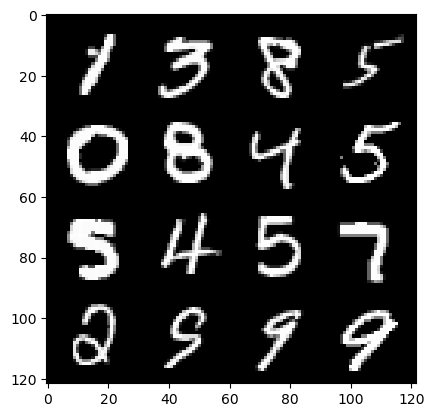

epoch: 196, step: 92100, gen loss: 1.6343618094921093, disc loss: 0.3498564431071281.


  0%|          | 0/469 [00:00<?, ?it/s]

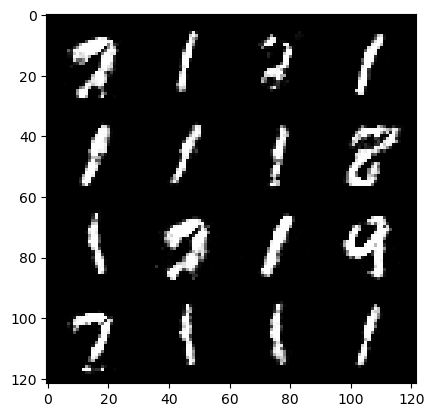

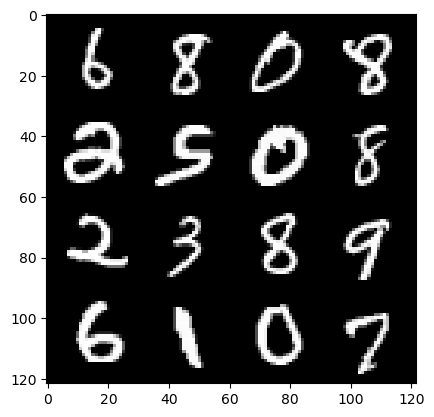

epoch: 197, step: 92400, gen loss: 1.52819840669632, disc loss: 0.3701695490876835.


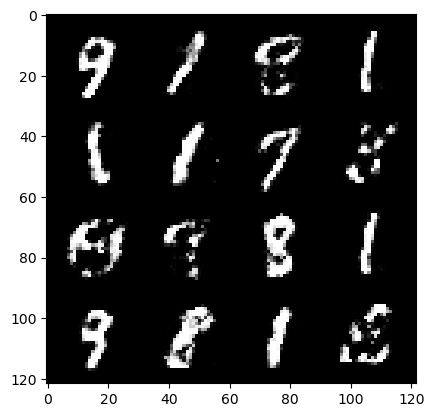

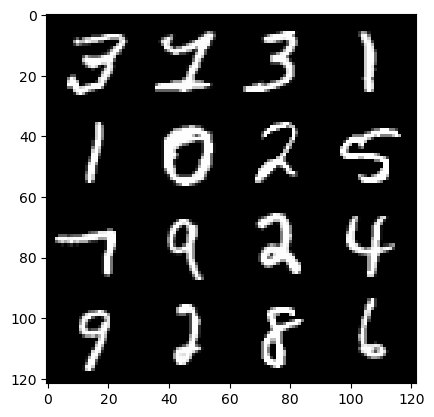

epoch: 197, step: 92700, gen loss: 1.5855561900138855, disc loss: 0.3587959178288776.


  0%|          | 0/469 [00:00<?, ?it/s]

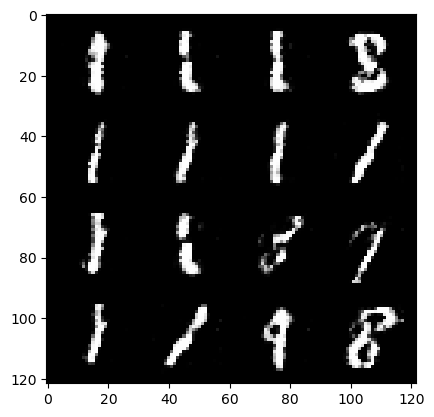

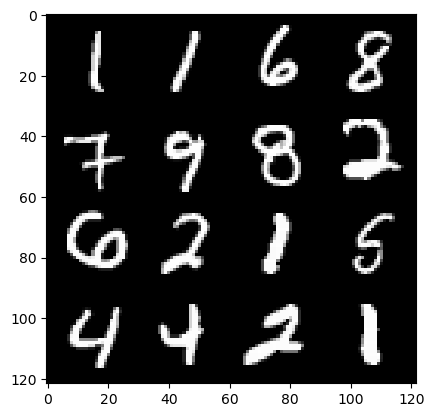

epoch: 198, step: 93000, gen loss: 1.6135290670394904, disc loss: 0.3444842511415481.


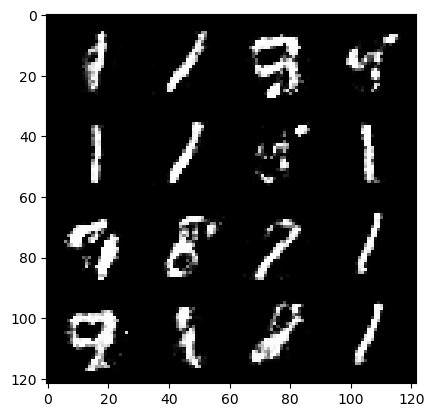

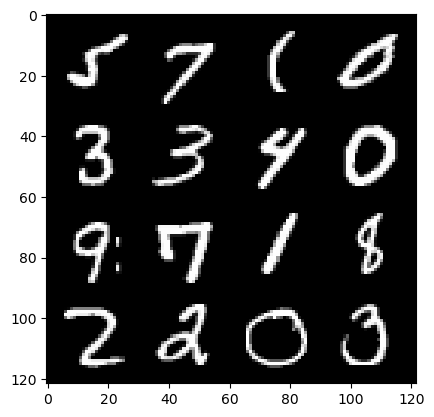

epoch: 198, step: 93300, gen loss: 1.6590633920828497, disc loss: 0.3448042151331902.


  0%|          | 0/469 [00:00<?, ?it/s]

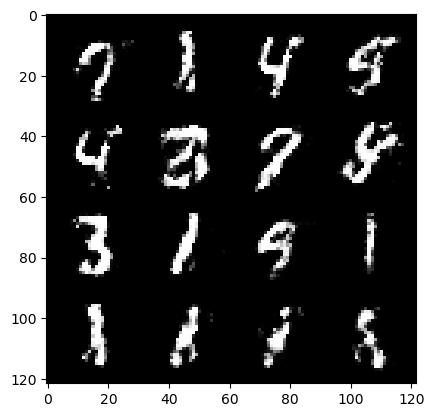

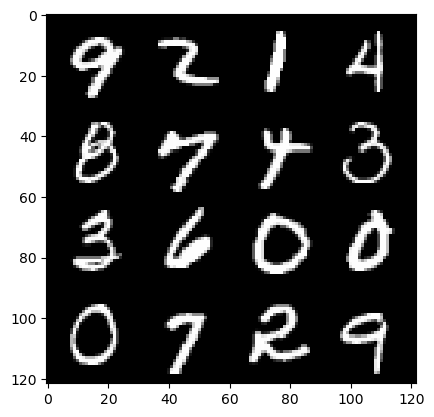

epoch: 199, step: 93600, gen loss: 1.5328685454527544, disc loss: 0.3785141868392627.


  0%|          | 0/469 [00:00<?, ?it/s]

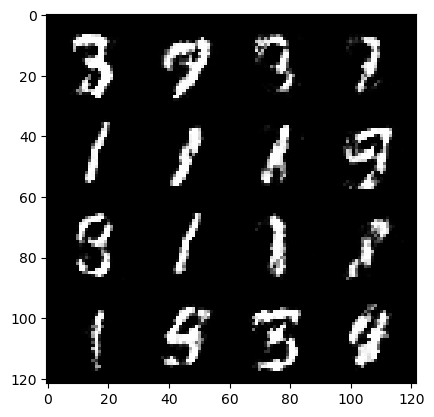

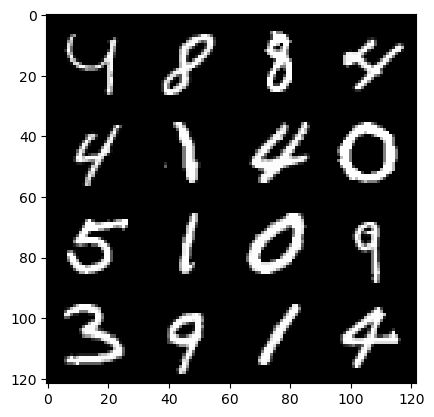

epoch: 200, step: 93900, gen loss: 1.5876219526926671, disc loss: 0.3556421920657159.


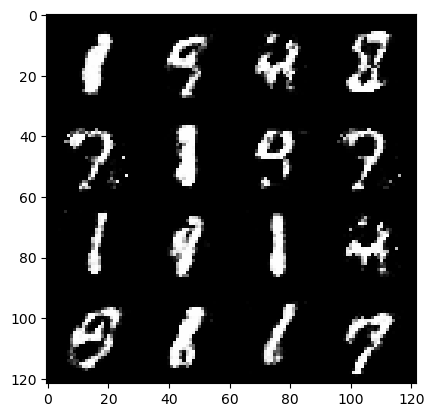

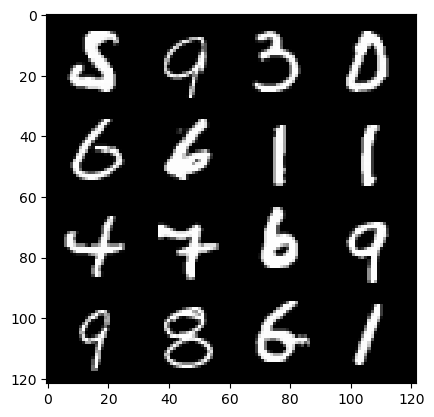

epoch: 200, step: 94200, gen loss: 1.5822294469674425, disc loss: 0.3606946582595506.


  0%|          | 0/469 [00:00<?, ?it/s]

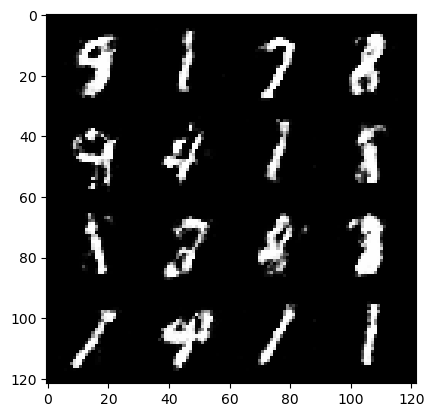

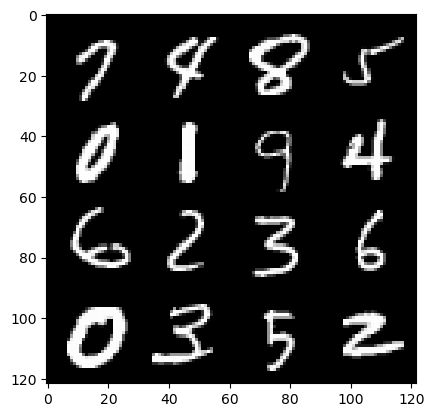

epoch: 201, step: 94500, gen loss: 1.6169200718402872, disc loss: 0.3518130458394682.


  0%|          | 0/469 [00:00<?, ?it/s]

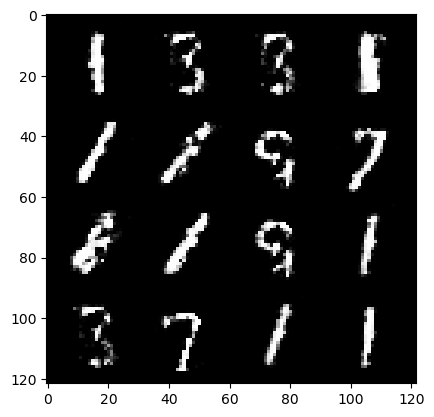

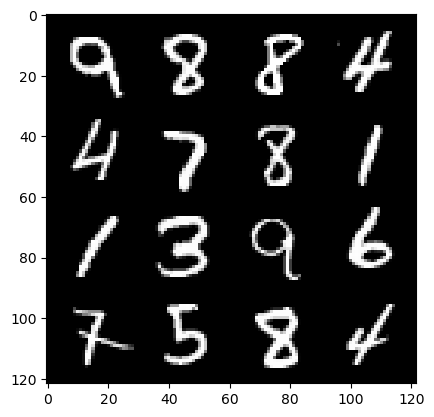

epoch: 202, step: 94800, gen loss: 1.6479115255673733, disc loss: 0.3482275503873825.


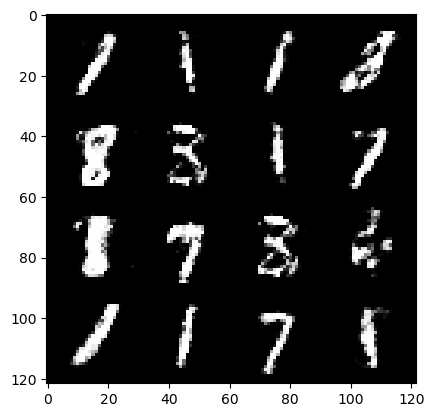

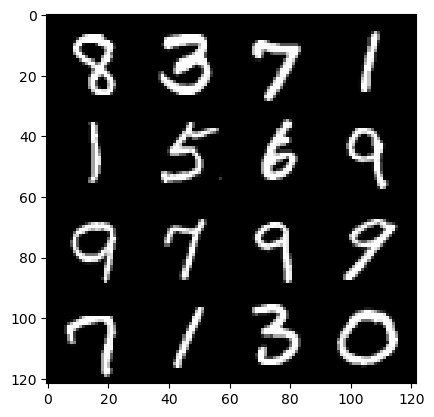

epoch: 202, step: 95100, gen loss: 1.595035159985224, disc loss: 0.3638232689102487.


  0%|          | 0/469 [00:00<?, ?it/s]

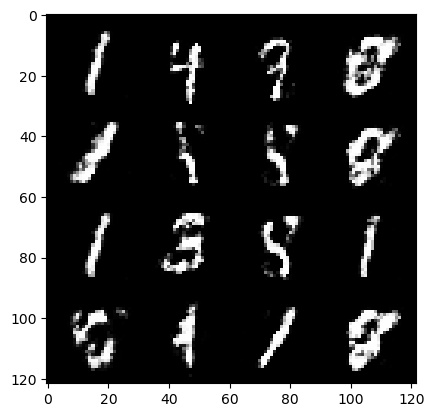

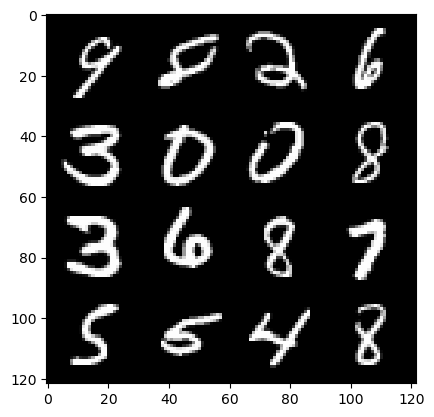

epoch: 203, step: 95400, gen loss: 1.5496387922763826, disc loss: 0.367232217391332.


  0%|          | 0/469 [00:00<?, ?it/s]

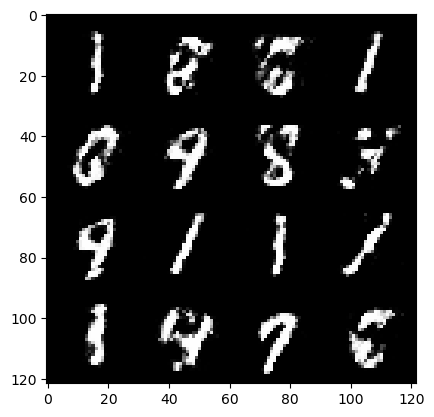

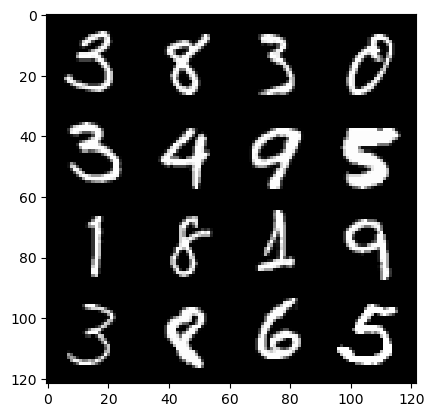

epoch: 204, step: 95700, gen loss: 1.594056849479675, disc loss: 0.3544325569272042.


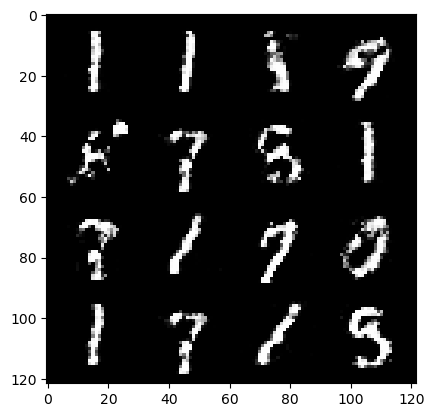

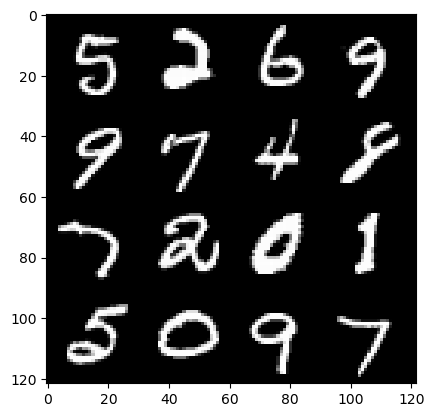

epoch: 204, step: 96000, gen loss: 1.710220648447673, disc loss: 0.3372378785411516.


  0%|          | 0/469 [00:00<?, ?it/s]

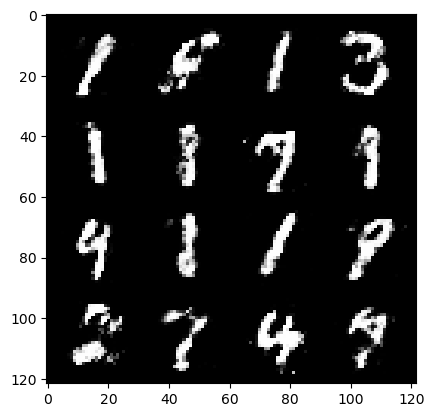

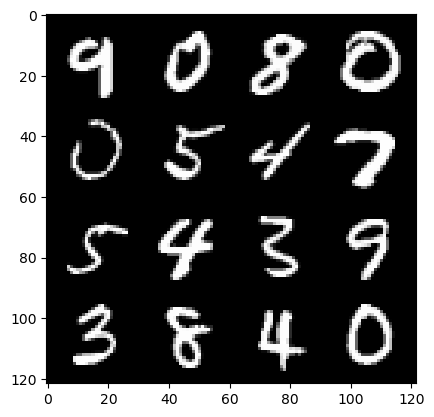

epoch: 205, step: 96300, gen loss: 1.6559608157475787, disc loss: 0.34922177900870605.


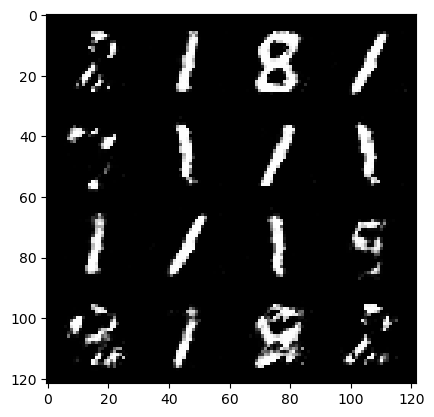

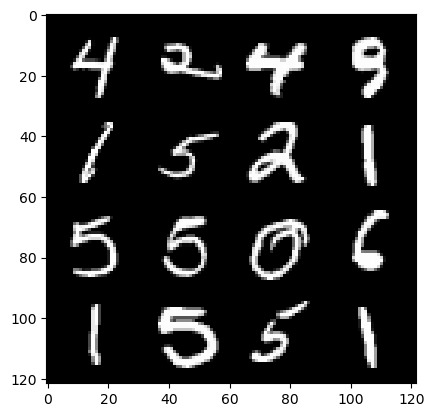

epoch: 205, step: 96600, gen loss: 1.6202883740266165, disc loss: 0.35110522170861563.


  0%|          | 0/469 [00:00<?, ?it/s]

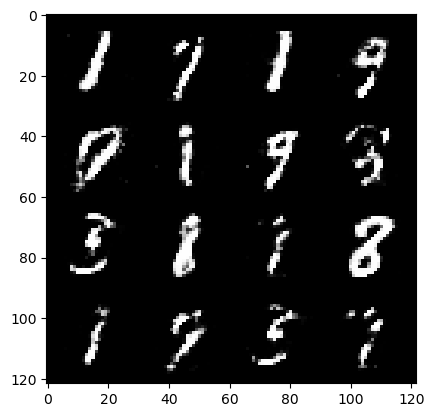

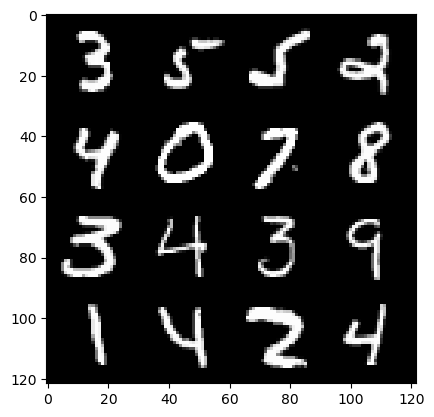

epoch: 206, step: 96900, gen loss: 1.5999348251024879, disc loss: 0.3507258532444638.


  0%|          | 0/469 [00:00<?, ?it/s]

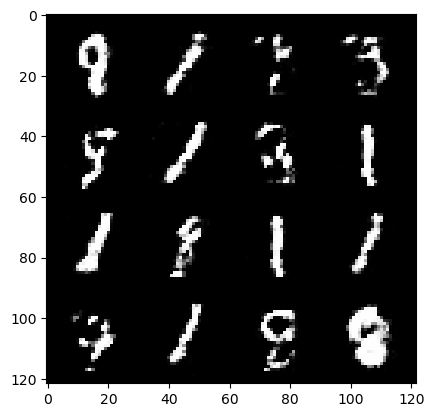

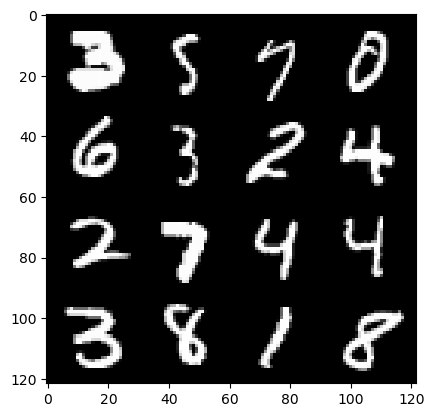

epoch: 207, step: 97200, gen loss: 1.54350684841474, disc loss: 0.36296644786993654.


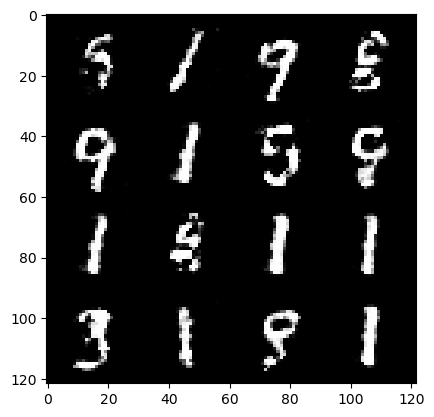

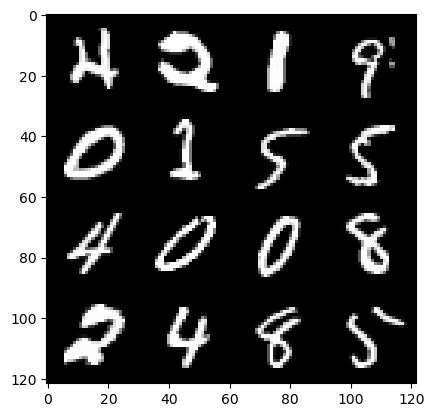

epoch: 207, step: 97500, gen loss: 1.6284117166201273, disc loss: 0.3415771205226579.


  0%|          | 0/469 [00:00<?, ?it/s]

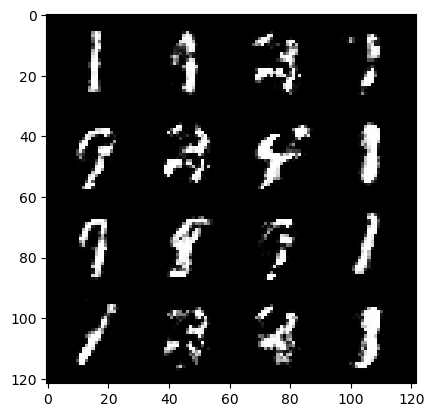

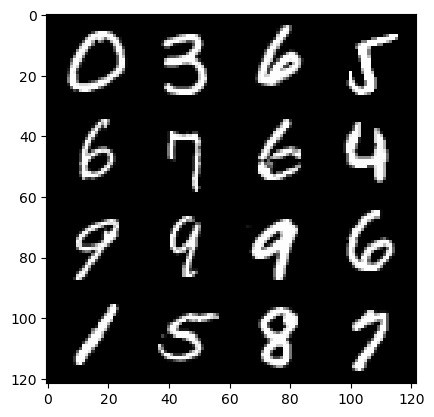

epoch: 208, step: 97800, gen loss: 1.5965031282107036, disc loss: 0.3552459387977918.


  0%|          | 0/469 [00:00<?, ?it/s]

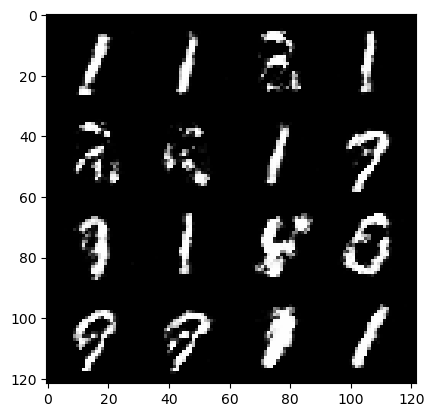

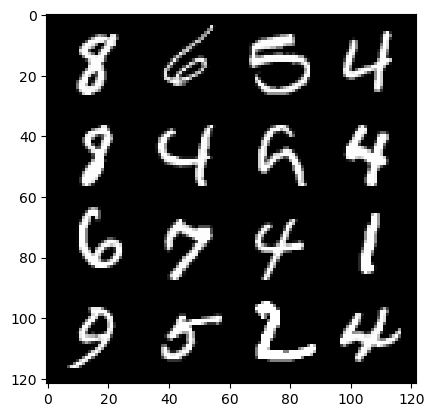

epoch: 209, step: 98100, gen loss: 1.5910180691878, disc loss: 0.35402526845534626.


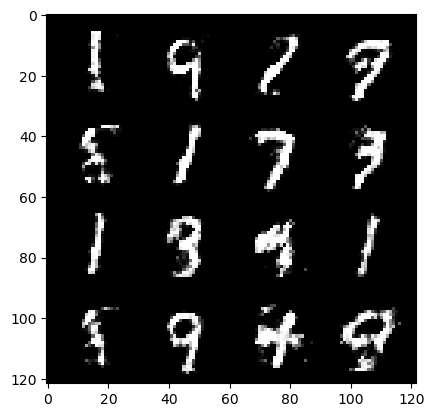

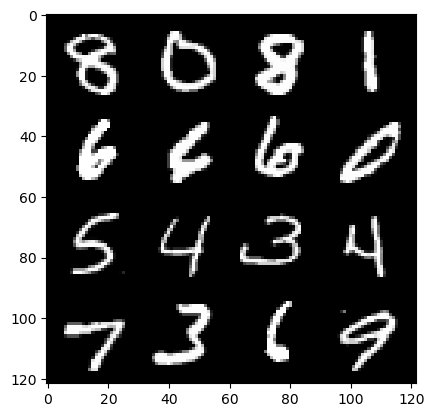

epoch: 209, step: 98400, gen loss: 1.616484198570252, disc loss: 0.34745874479413.


  0%|          | 0/469 [00:00<?, ?it/s]

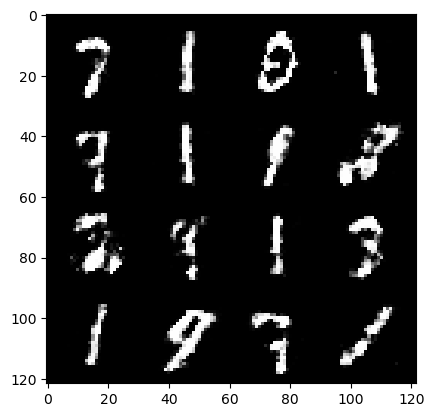

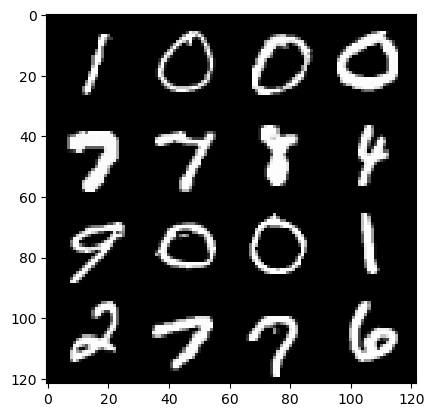

epoch: 210, step: 98700, gen loss: 1.5745926276842763, disc loss: 0.369463616410891.


  0%|          | 0/469 [00:00<?, ?it/s]

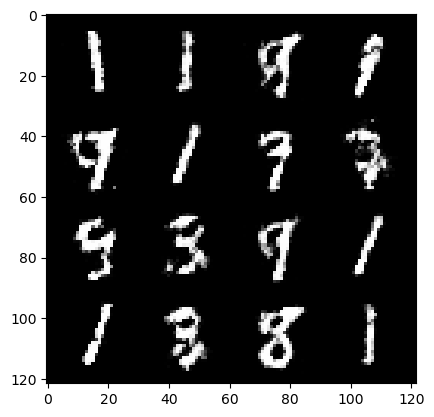

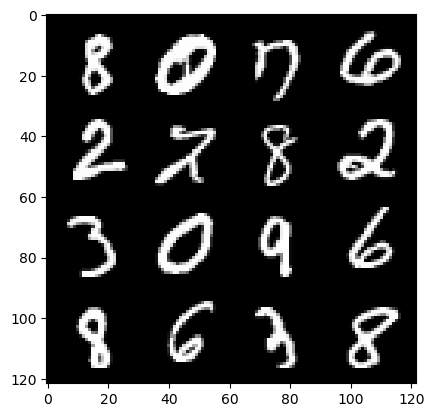

epoch: 211, step: 99000, gen loss: 1.6310469392935427, disc loss: 0.35802490959564853.


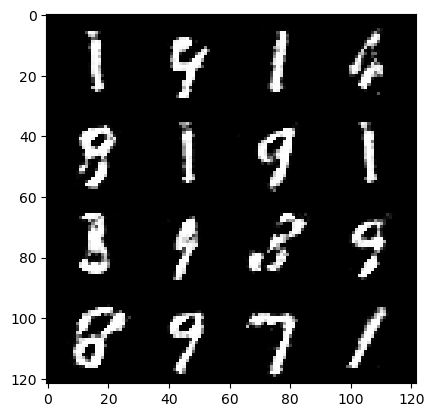

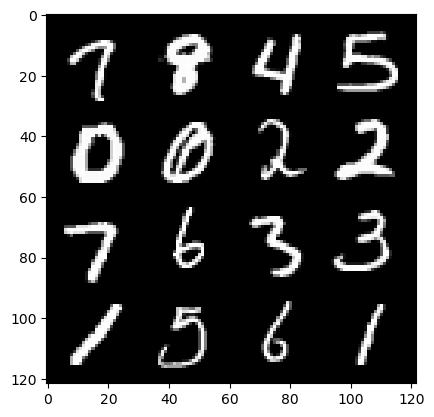

epoch: 211, step: 99300, gen loss: 1.6165285992622382, disc loss: 0.362465337514877.


  0%|          | 0/469 [00:00<?, ?it/s]

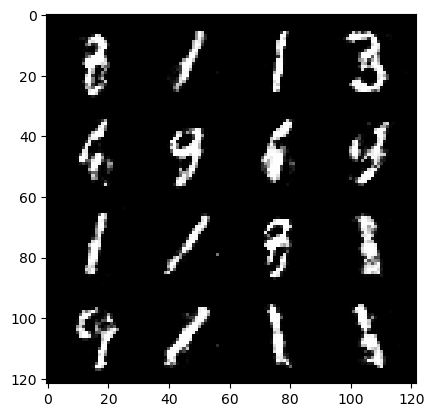

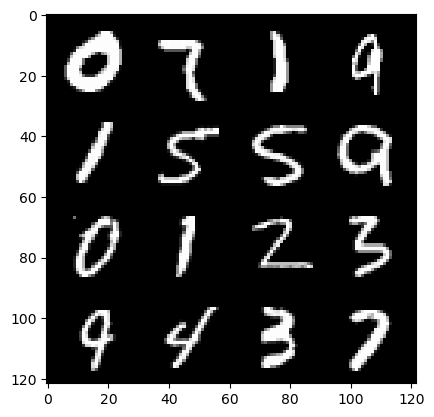

epoch: 212, step: 99600, gen loss: 1.5271515874067945, disc loss: 0.36927571584781.


  0%|          | 0/469 [00:00<?, ?it/s]

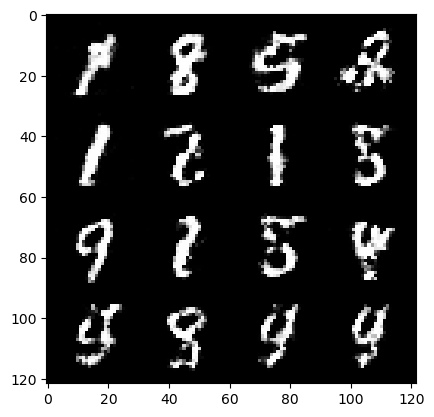

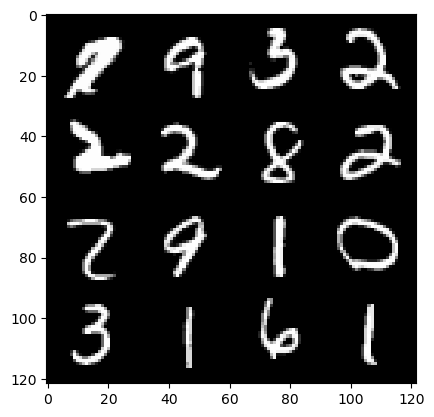

epoch: 213, step: 99900, gen loss: 1.5168417346477499, disc loss: 0.3713111320137979.


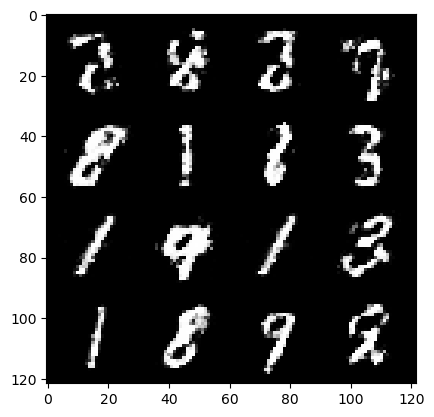

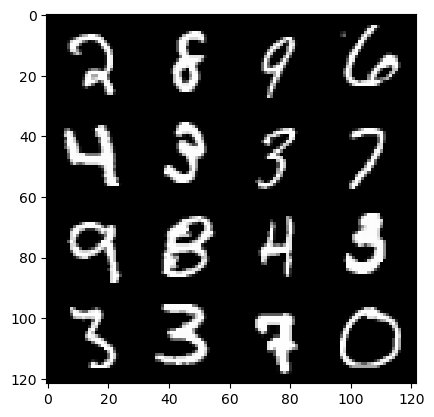

epoch: 213, step: 100200, gen loss: 1.4950019379456843, disc loss: 0.38226178447405507.


  0%|          | 0/469 [00:00<?, ?it/s]

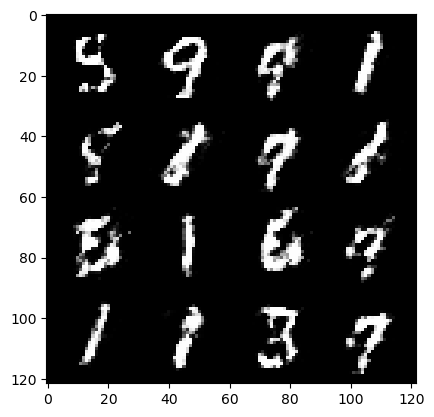

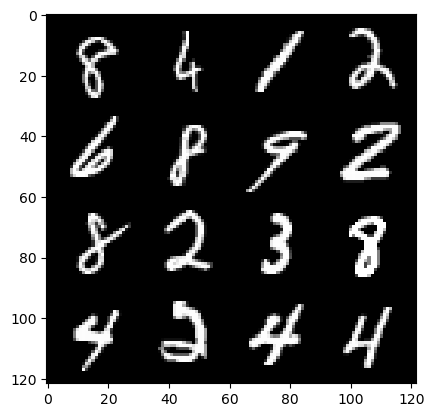

epoch: 214, step: 100500, gen loss: 1.576127951145171, disc loss: 0.35684091806411755.


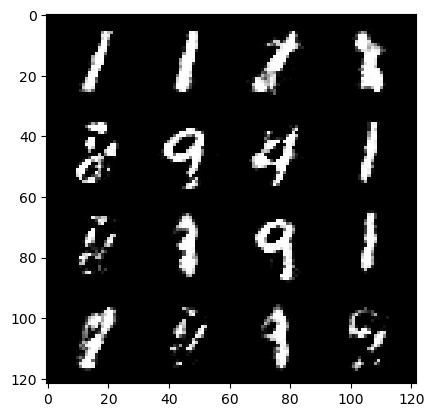

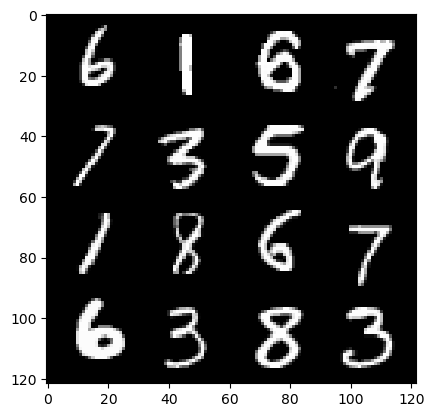

epoch: 214, step: 100800, gen loss: 1.6043693459033963, disc loss: 0.36777359882990523.


  0%|          | 0/469 [00:00<?, ?it/s]

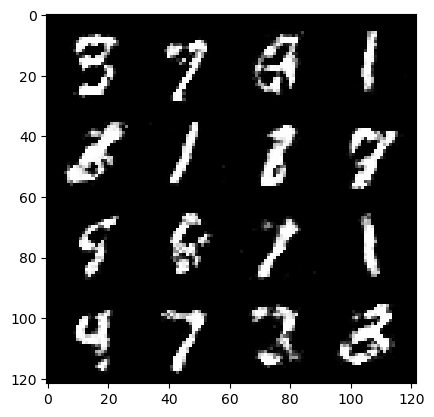

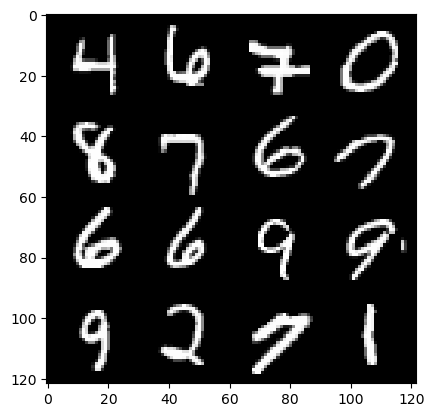

epoch: 215, step: 101100, gen loss: 1.5922185250123344, disc loss: 0.364583576420943.


  0%|          | 0/469 [00:00<?, ?it/s]

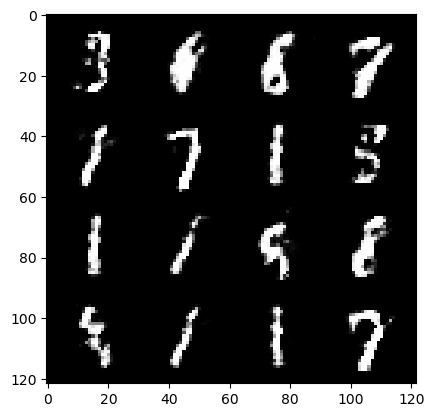

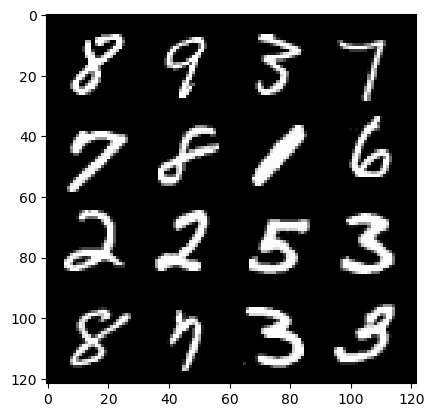

epoch: 216, step: 101400, gen loss: 1.5329102571805326, disc loss: 0.37877033929030135.


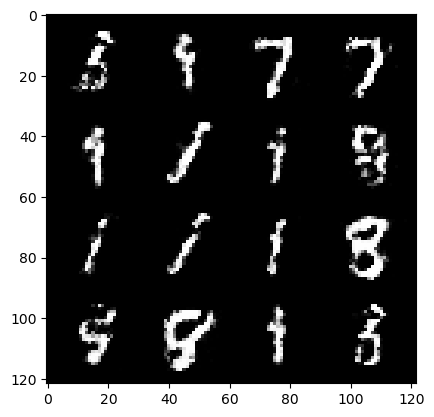

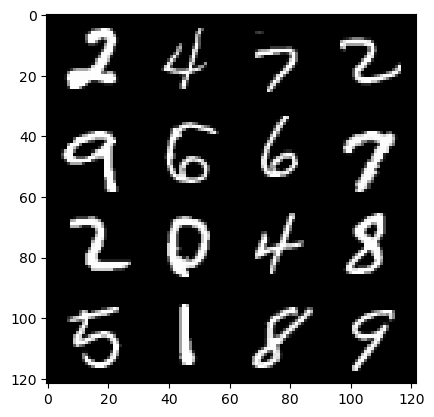

epoch: 216, step: 101700, gen loss: 1.4676859557628632, disc loss: 0.373616492450237.


  0%|          | 0/469 [00:00<?, ?it/s]

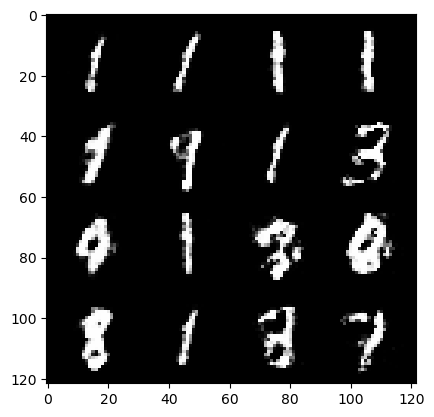

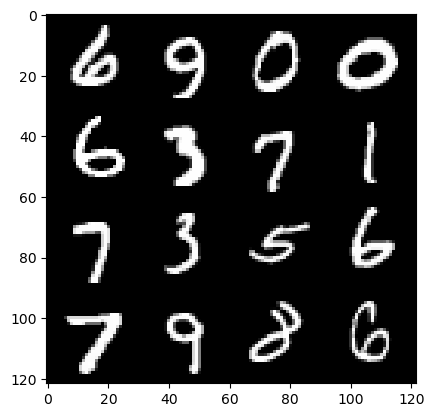

epoch: 217, step: 102000, gen loss: 1.5142084761460626, disc loss: 0.3657596590121588.


  0%|          | 0/469 [00:00<?, ?it/s]

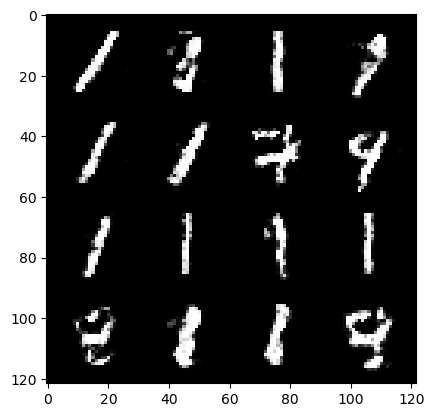

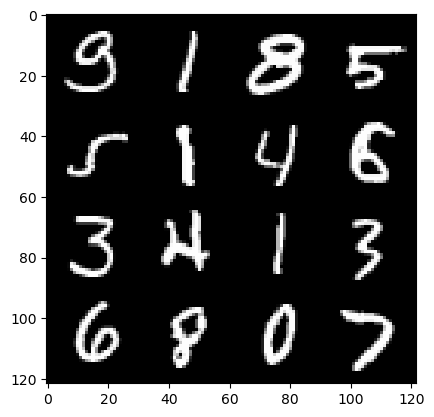

epoch: 218, step: 102300, gen loss: 1.5441067131360375, disc loss: 0.36325936307509776.


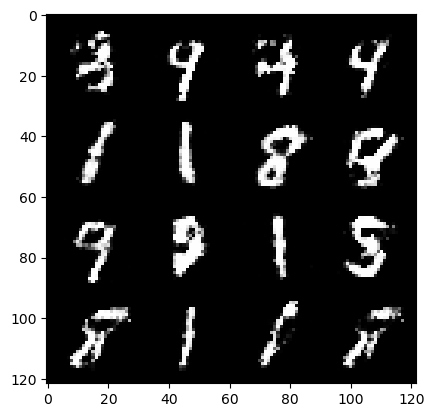

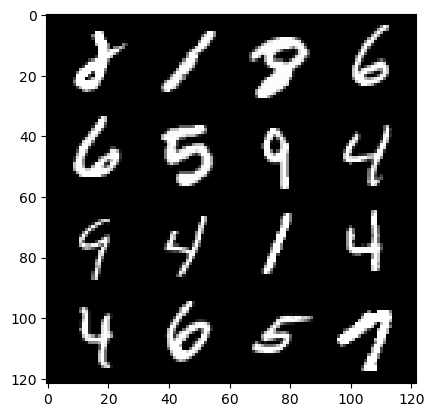

epoch: 218, step: 102600, gen loss: 1.5892439460754404, disc loss: 0.3539273849129677.


  0%|          | 0/469 [00:00<?, ?it/s]

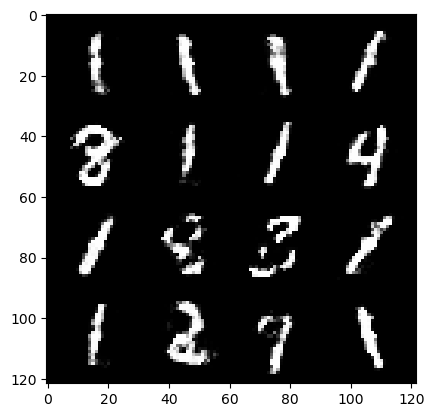

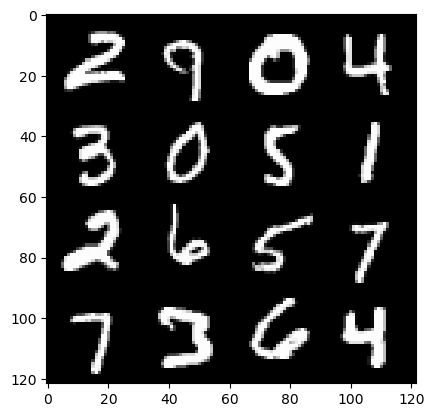

epoch: 219, step: 102900, gen loss: 1.654569431145986, disc loss: 0.3452823672691979.


  0%|          | 0/469 [00:00<?, ?it/s]

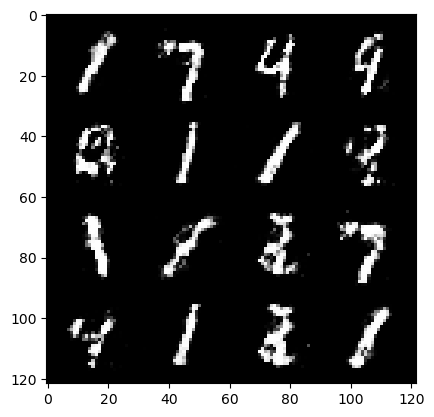

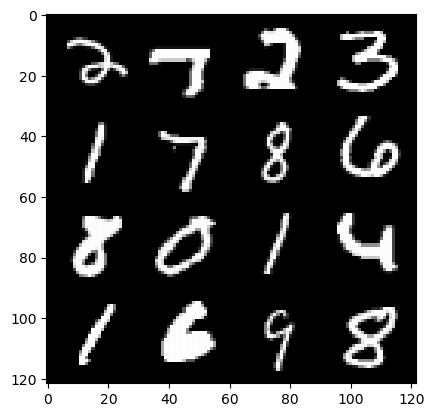

epoch: 220, step: 103200, gen loss: 1.570431528091432, disc loss: 0.3745171339313188.


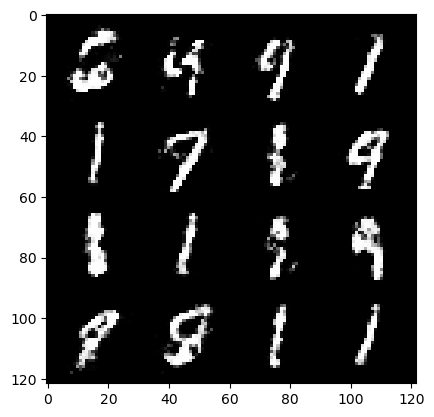

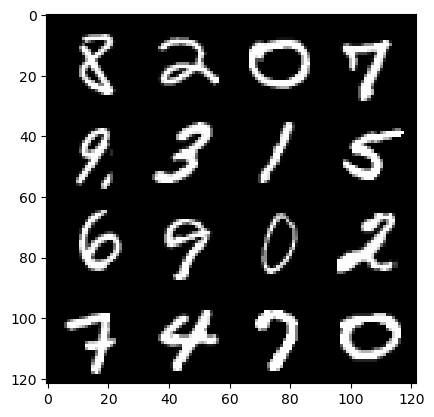

epoch: 220, step: 103500, gen loss: 1.555149241685867, disc loss: 0.3749908344944317.


  0%|          | 0/469 [00:00<?, ?it/s]

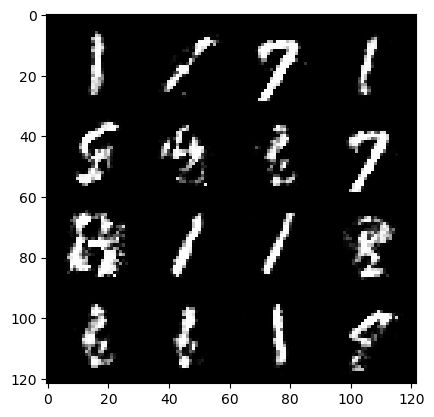

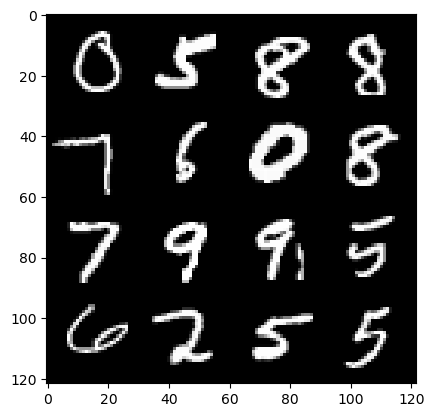

epoch: 221, step: 103800, gen loss: 1.5399843533833815, disc loss: 0.3683940550684928.


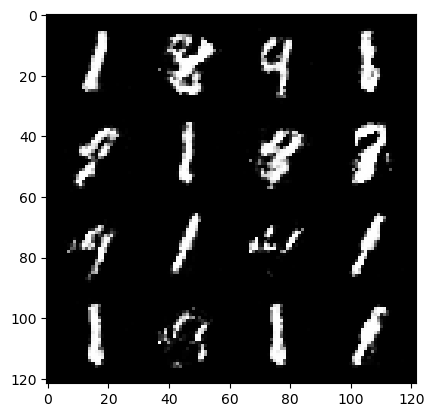

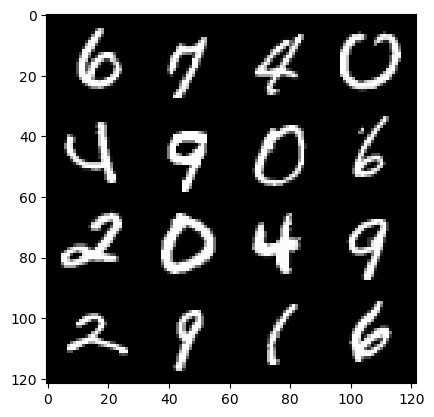

epoch: 221, step: 104100, gen loss: 1.6570396510759988, disc loss: 0.3434125167131423.


  0%|          | 0/469 [00:00<?, ?it/s]

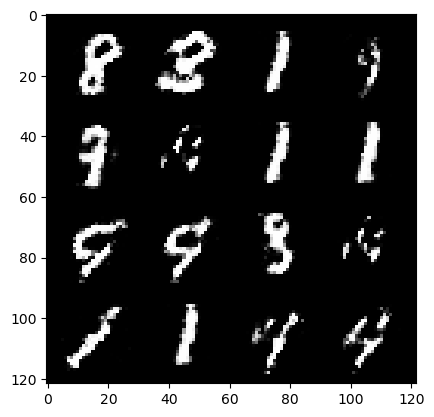

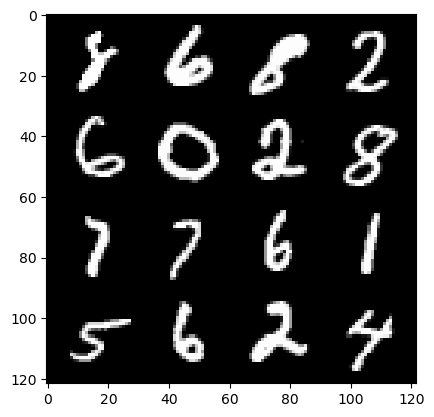

epoch: 222, step: 104400, gen loss: 1.6592266567548106, disc loss: 0.35045926491419505.


  0%|          | 0/469 [00:00<?, ?it/s]

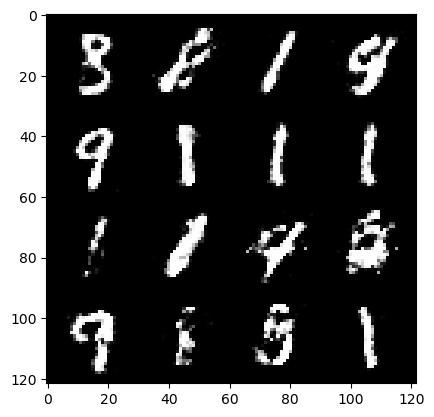

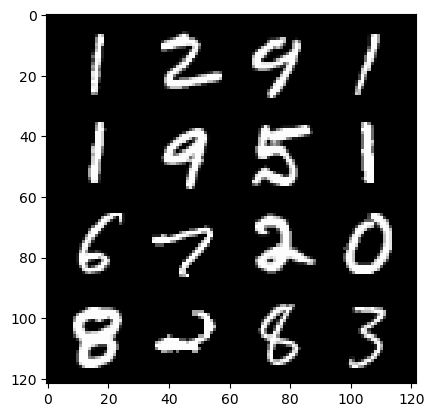

epoch: 223, step: 104700, gen loss: 1.6366574815909065, disc loss: 0.35524086972077673.


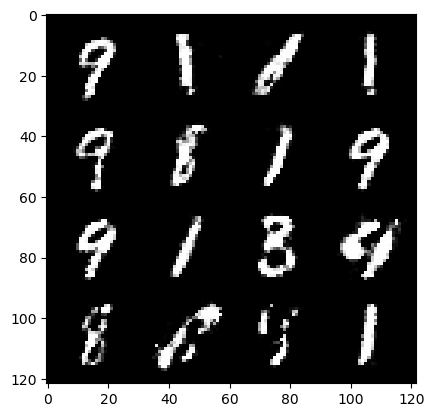

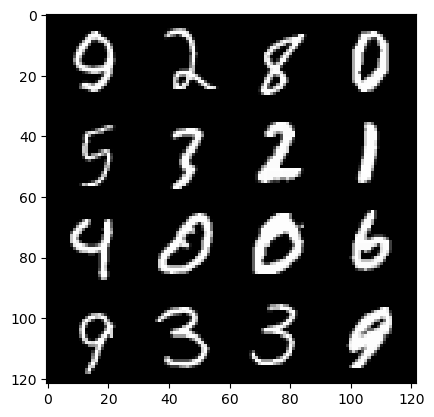

epoch: 223, step: 105000, gen loss: 1.6833119336764018, disc loss: 0.32907993117968243.


  0%|          | 0/469 [00:00<?, ?it/s]

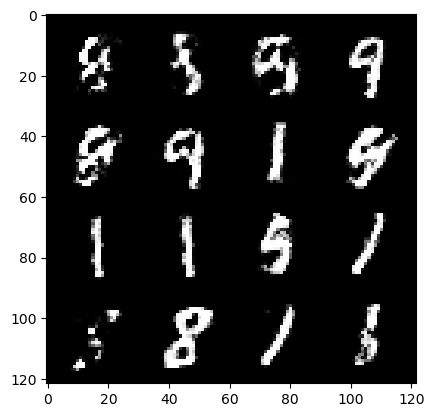

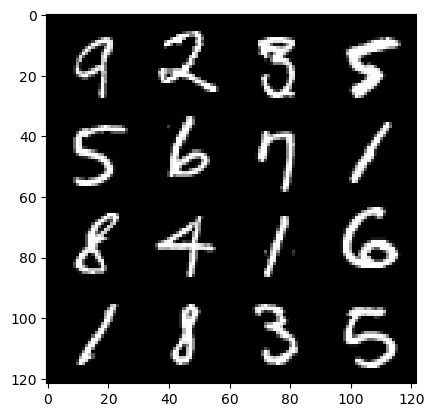

epoch: 224, step: 105300, gen loss: 1.6719352622826904, disc loss: 0.3370154824356238.


  0%|          | 0/469 [00:00<?, ?it/s]

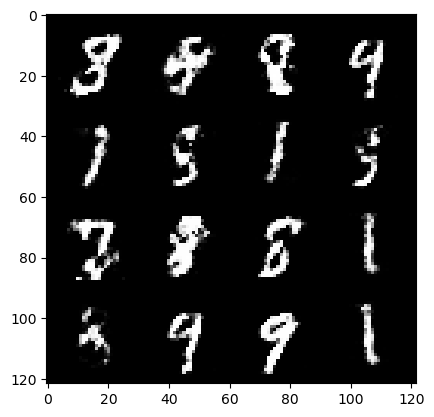

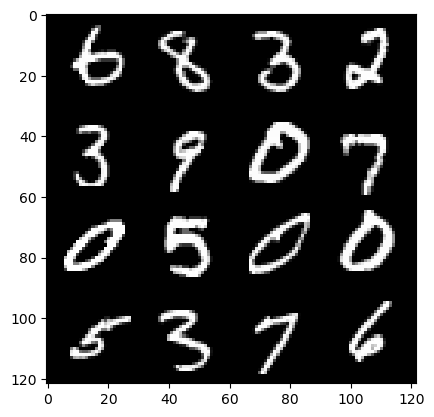

epoch: 225, step: 105600, gen loss: 1.6794972737630205, disc loss: 0.32442091315984717.


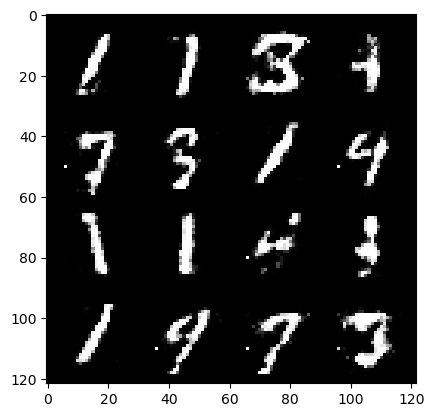

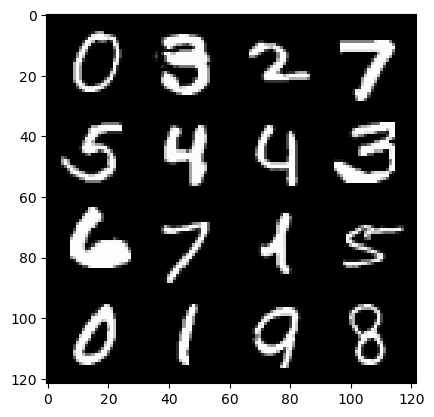

epoch: 225, step: 105900, gen loss: 1.5750500396887452, disc loss: 0.35173437277476005.


  0%|          | 0/469 [00:00<?, ?it/s]

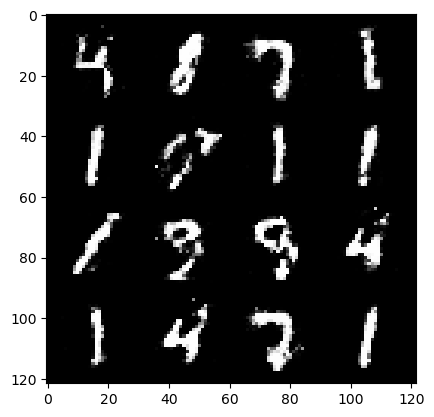

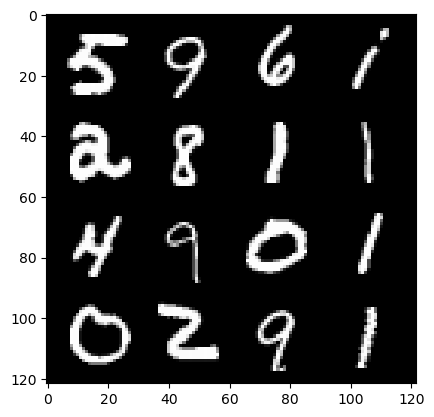

epoch: 226, step: 106200, gen loss: 1.6447777799765273, disc loss: 0.3545191845297812.


  0%|          | 0/469 [00:00<?, ?it/s]

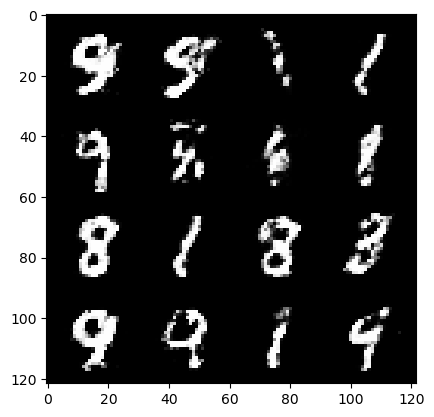

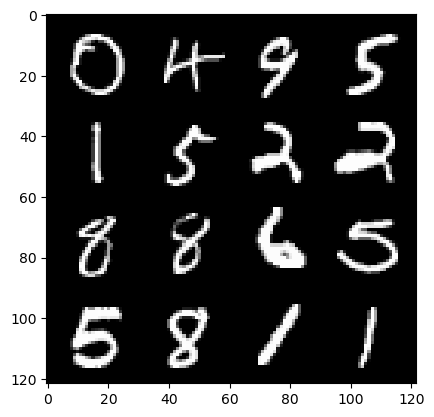

epoch: 227, step: 106500, gen loss: 1.6794125278790804, disc loss: 0.33895880103111287.


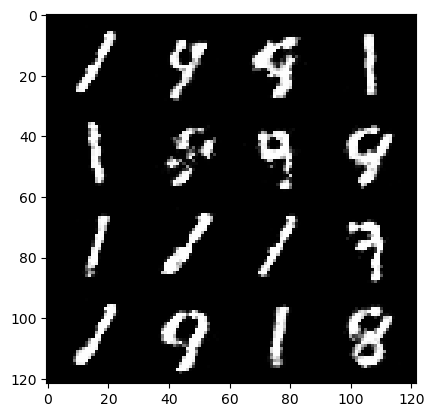

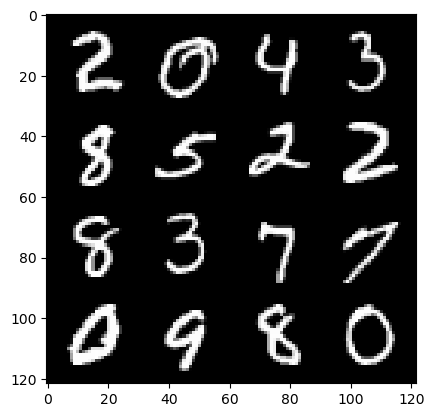

epoch: 227, step: 106800, gen loss: 1.6454742570718128, disc loss: 0.33599056442578606.


  0%|          | 0/469 [00:00<?, ?it/s]

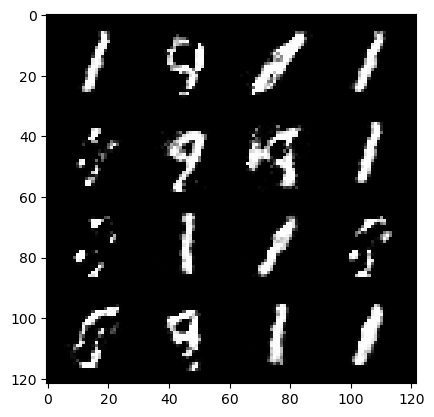

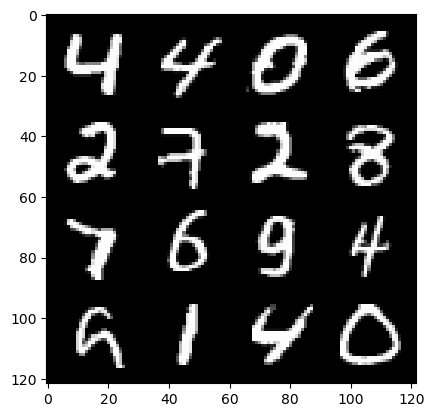

epoch: 228, step: 107100, gen loss: 1.6736575826009112, disc loss: 0.3420814322431882.


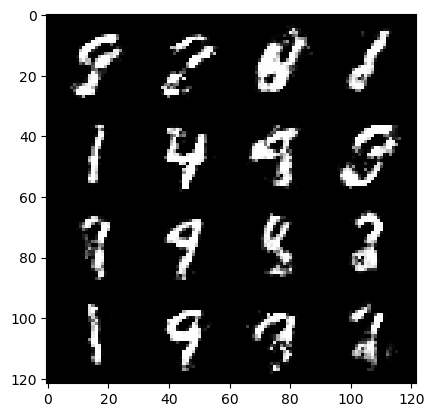

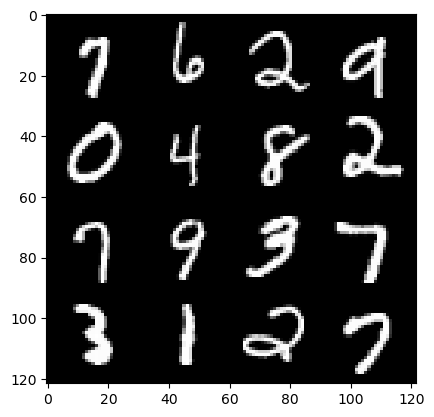

epoch: 228, step: 107400, gen loss: 1.6699992275238056, disc loss: 0.3458084814747173.


  0%|          | 0/469 [00:00<?, ?it/s]

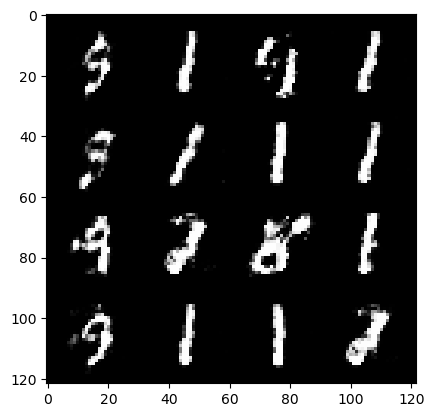

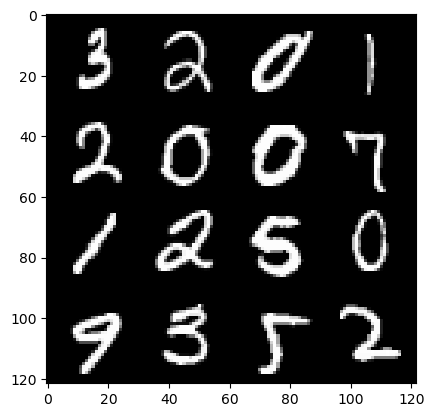

epoch: 229, step: 107700, gen loss: 1.7330702324708303, disc loss: 0.325948913147052.


  0%|          | 0/469 [00:00<?, ?it/s]

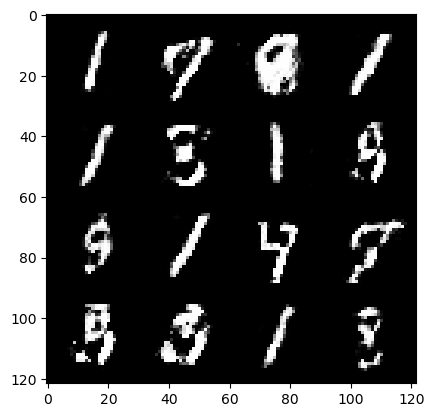

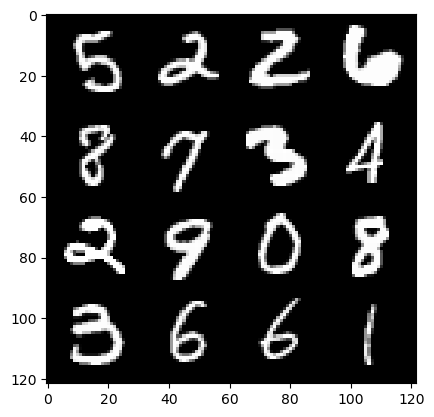

epoch: 230, step: 108000, gen loss: 1.6895523643493655, disc loss: 0.3344538853565852.


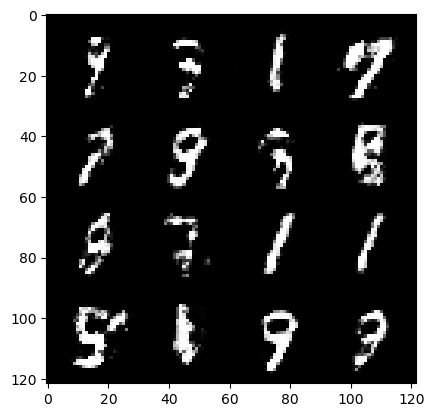

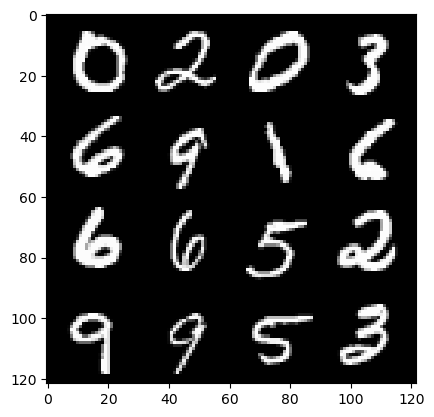

epoch: 230, step: 108300, gen loss: 1.6433392922083538, disc loss: 0.33039954528212534.


  0%|          | 0/469 [00:00<?, ?it/s]

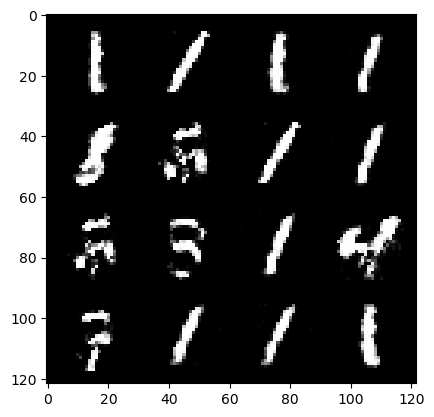

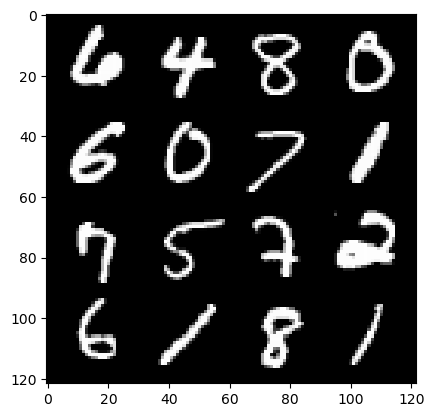

epoch: 231, step: 108600, gen loss: 1.586944356759389, disc loss: 0.3492040989796321.


  0%|          | 0/469 [00:00<?, ?it/s]

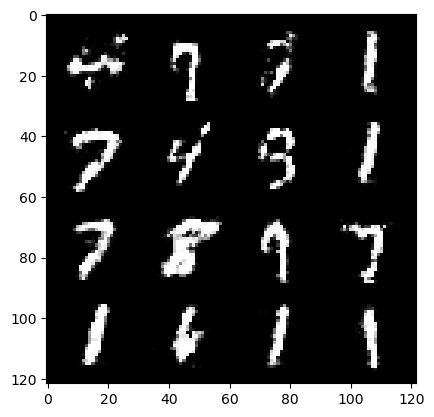

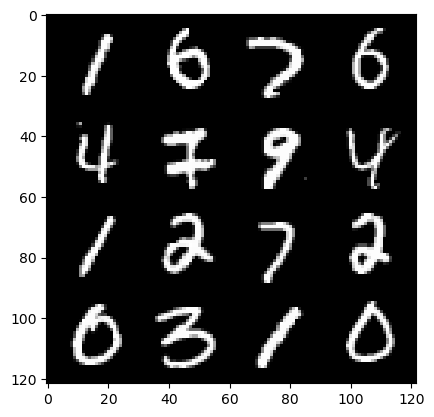

epoch: 232, step: 108900, gen loss: 1.6864747250080099, disc loss: 0.34160408616065996.


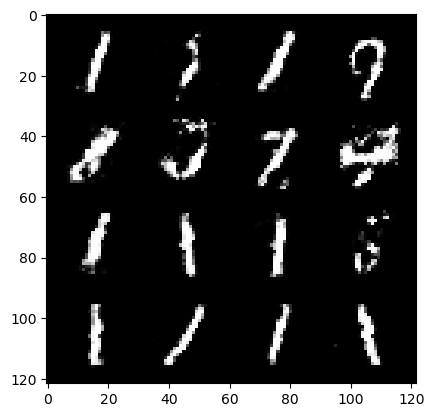

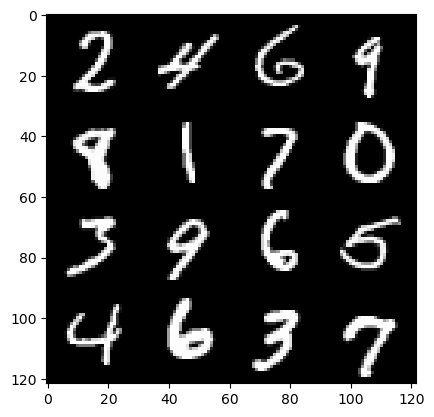

epoch: 232, step: 109200, gen loss: 1.6020777690410608, disc loss: 0.36519609640042017.


  0%|          | 0/469 [00:00<?, ?it/s]

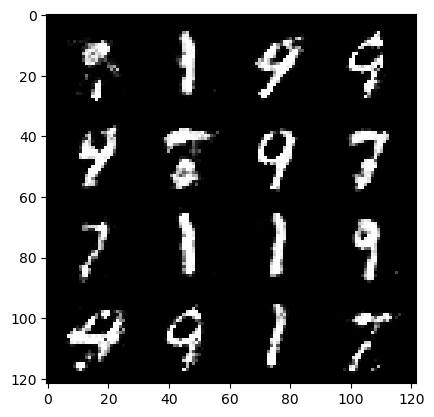

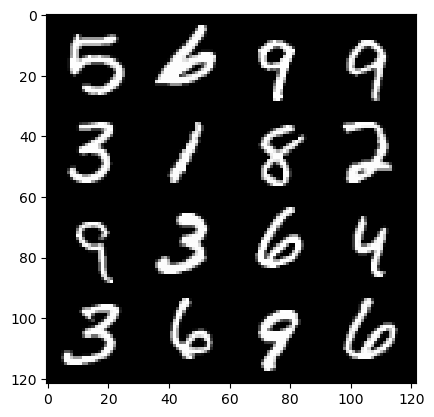

epoch: 233, step: 109500, gen loss: 1.59116439739863, disc loss: 0.3584078791737554.


  0%|          | 0/469 [00:00<?, ?it/s]

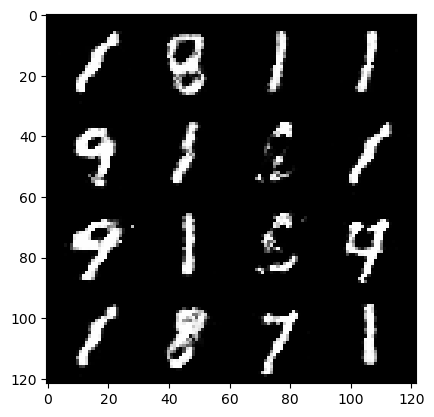

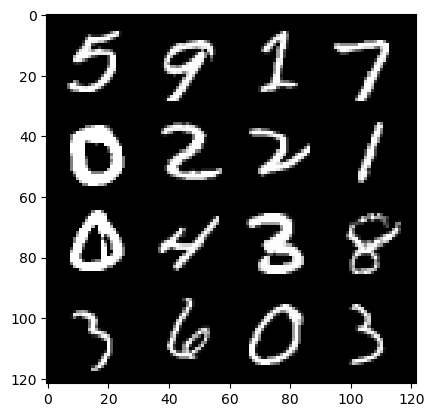

epoch: 234, step: 109800, gen loss: 1.625632435878118, disc loss: 0.3582484725117686.


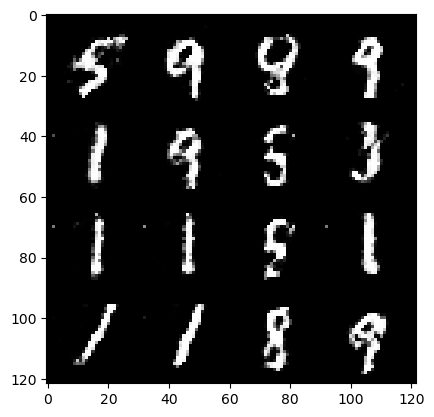

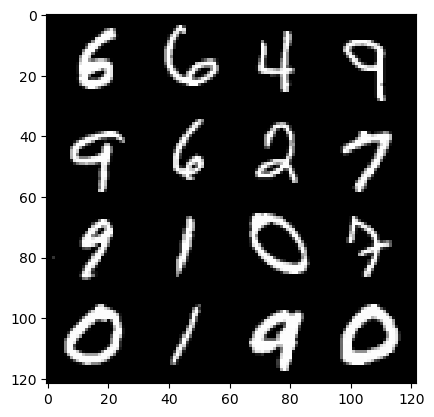

epoch: 234, step: 110100, gen loss: 1.578915124734243, disc loss: 0.3680519881844518.


  0%|          | 0/469 [00:00<?, ?it/s]

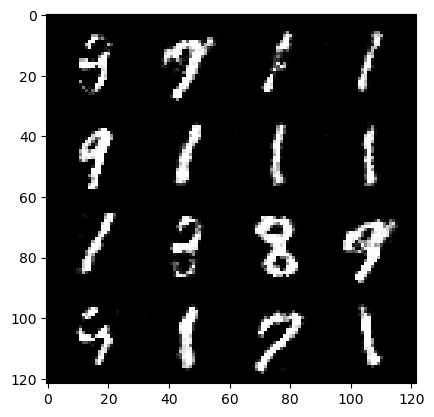

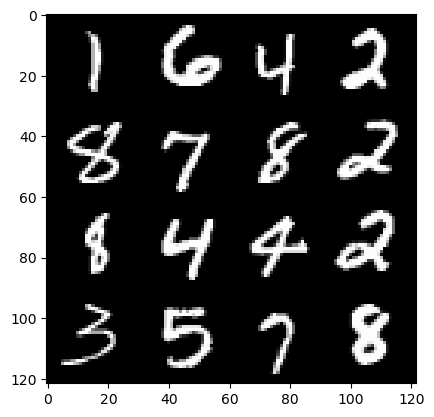

epoch: 235, step: 110400, gen loss: 1.5432781036694856, disc loss: 0.3754187299807869.


  0%|          | 0/469 [00:00<?, ?it/s]

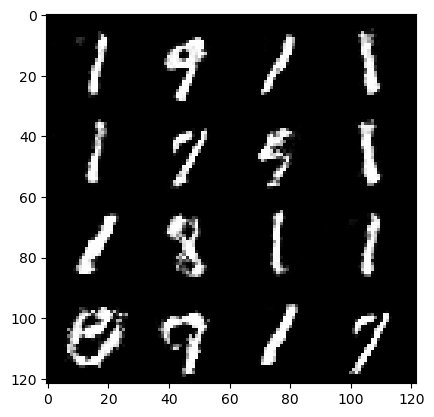

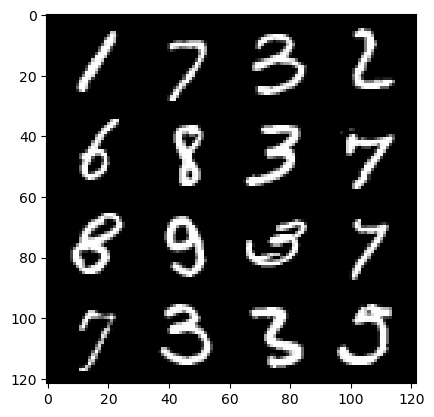

epoch: 236, step: 110700, gen loss: 1.5333873542149863, disc loss: 0.36885168015956904.


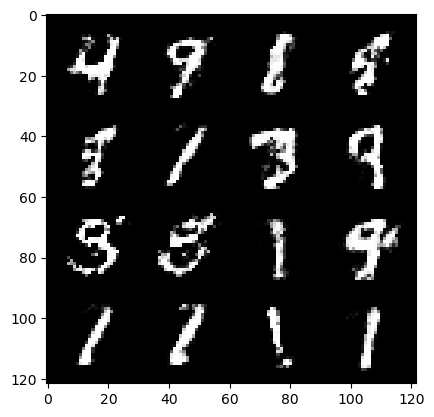

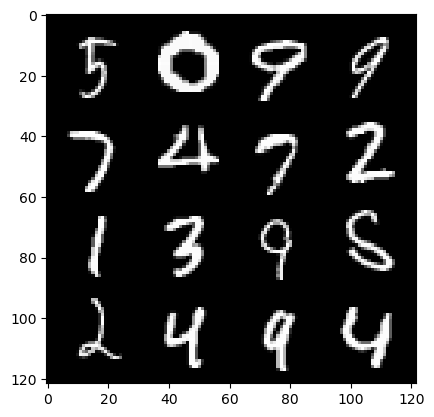

epoch: 236, step: 111000, gen loss: 1.4916724197069802, disc loss: 0.3799663088719054.


  0%|          | 0/469 [00:00<?, ?it/s]

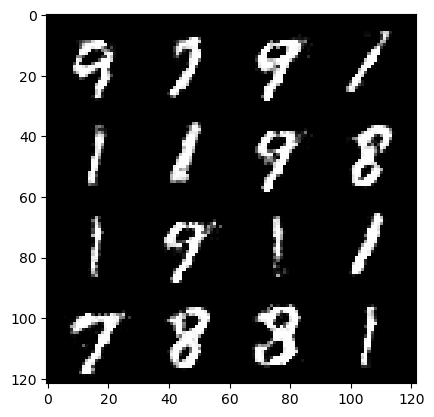

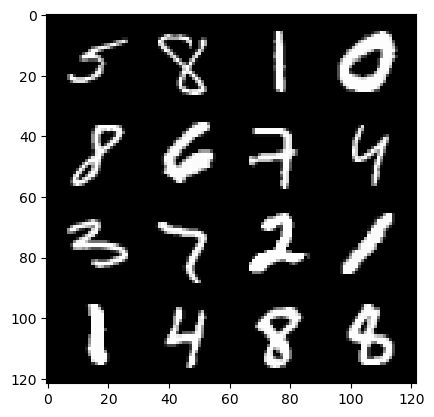

epoch: 237, step: 111300, gen loss: 1.5050105047225957, disc loss: 0.37739462107419974.


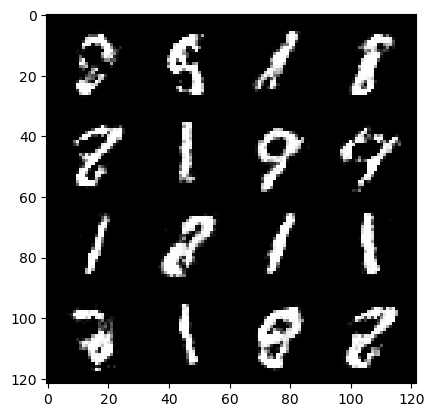

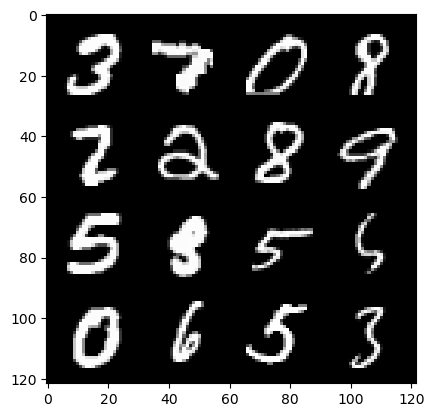

epoch: 237, step: 111600, gen loss: 1.6377689818541208, disc loss: 0.34941266546646765.


  0%|          | 0/469 [00:00<?, ?it/s]

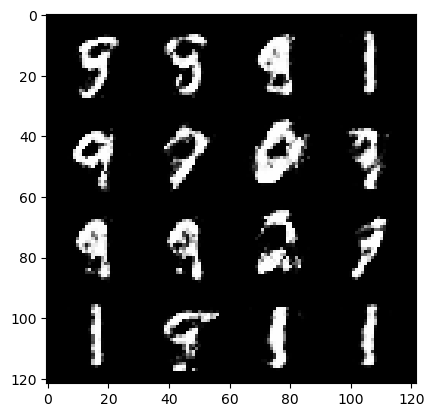

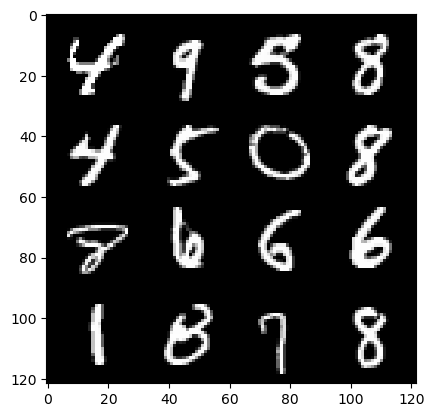

epoch: 238, step: 111900, gen loss: 1.5946628753344223, disc loss: 0.3606358967224757.


  0%|          | 0/469 [00:00<?, ?it/s]

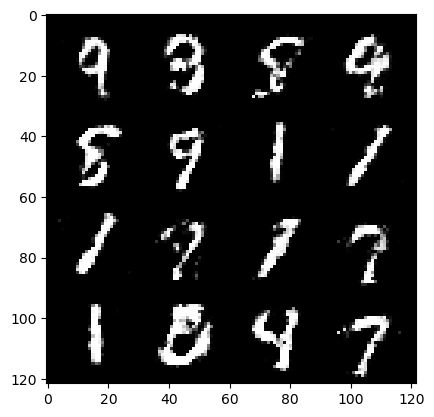

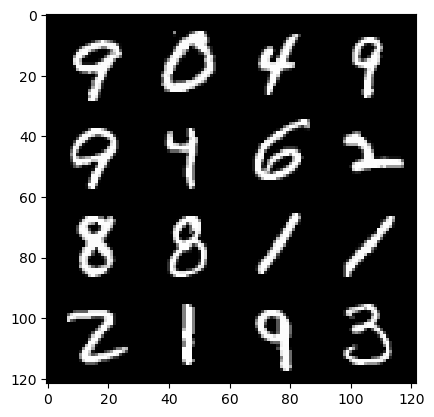

epoch: 239, step: 112200, gen loss: 1.5786389044920595, disc loss: 0.3660044461488724.


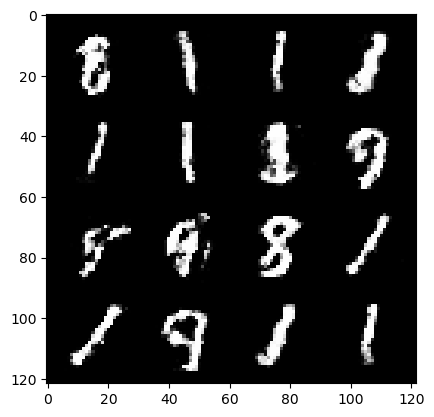

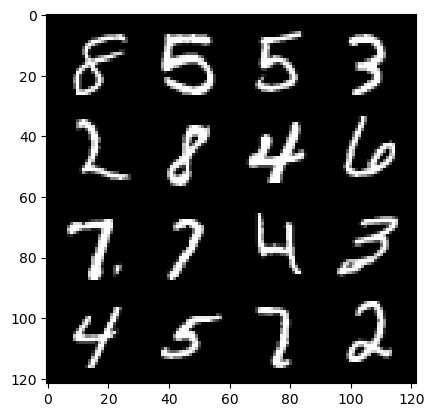

epoch: 239, step: 112500, gen loss: 1.5581711991628011, disc loss: 0.36419605781634673.


  0%|          | 0/469 [00:00<?, ?it/s]

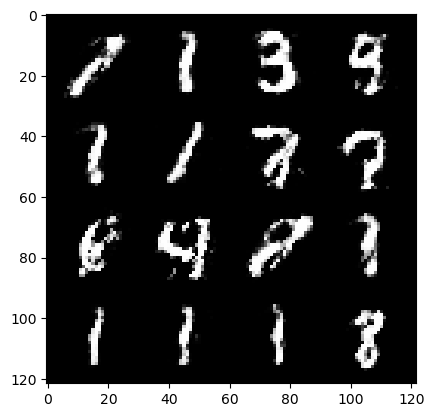

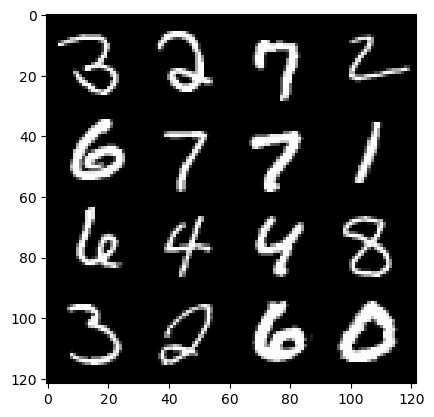

epoch: 240, step: 112800, gen loss: 1.5786305900414779, disc loss: 0.36288935740788747.


  0%|          | 0/469 [00:00<?, ?it/s]

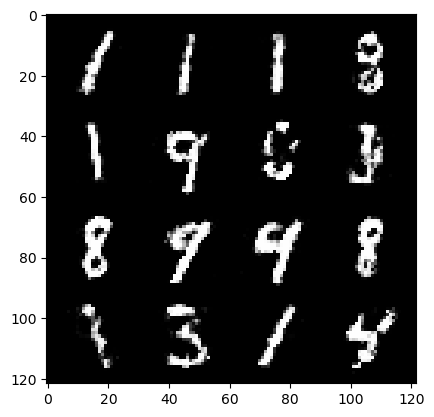

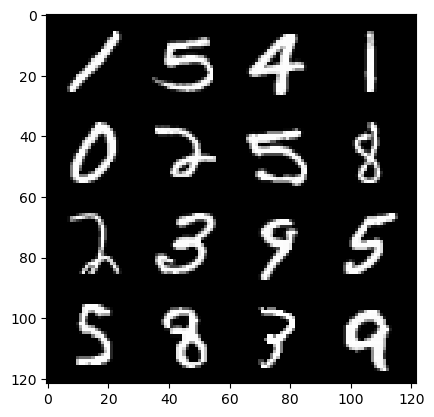

epoch: 241, step: 113100, gen loss: 1.586678932507832, disc loss: 0.38027931511402113.


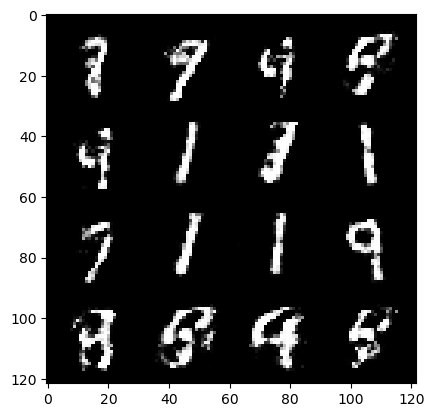

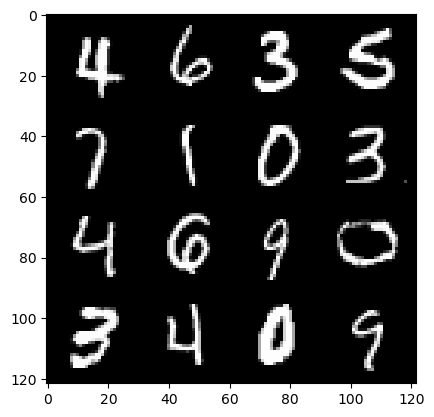

epoch: 241, step: 113400, gen loss: 1.540993897517522, disc loss: 0.37192396312952025.


  0%|          | 0/469 [00:00<?, ?it/s]

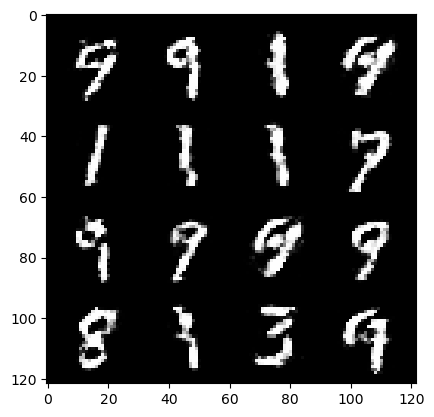

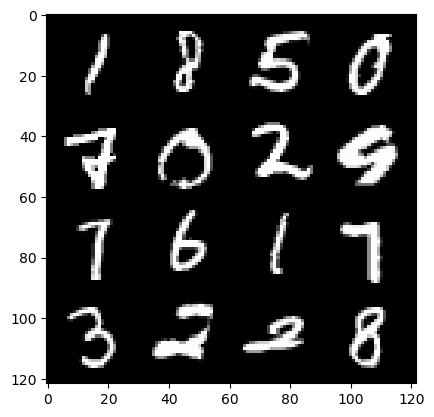

epoch: 242, step: 113700, gen loss: 1.5394983804225921, disc loss: 0.3759509195884072.


  0%|          | 0/469 [00:00<?, ?it/s]

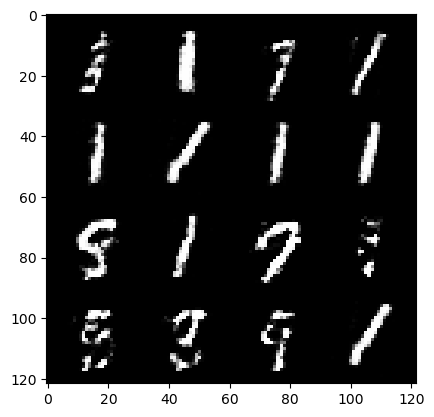

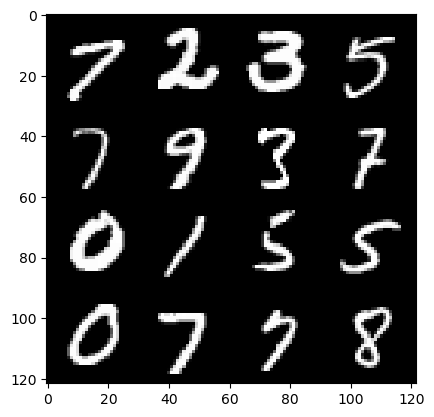

epoch: 243, step: 114000, gen loss: 1.551843194961548, disc loss: 0.3687937986850737.


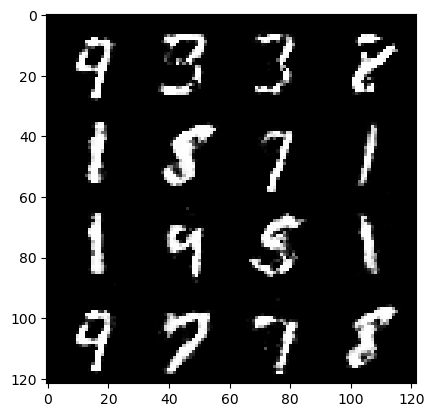

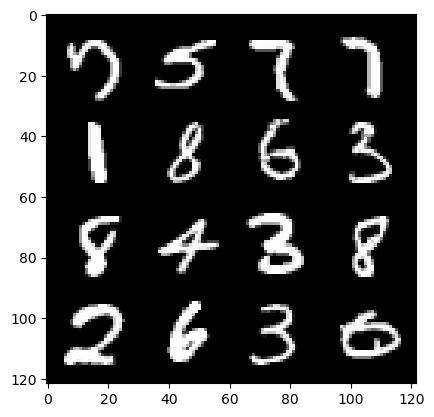

epoch: 243, step: 114300, gen loss: 1.5158307174841554, disc loss: 0.36919930060704564.


  0%|          | 0/469 [00:00<?, ?it/s]

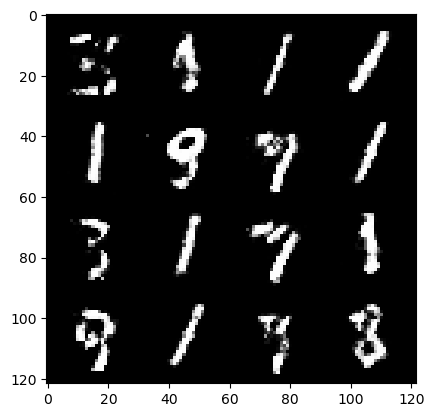

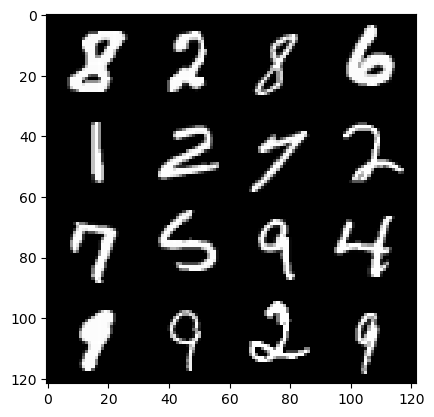

epoch: 244, step: 114600, gen loss: 1.6436269497871407, disc loss: 0.34533655862013524.


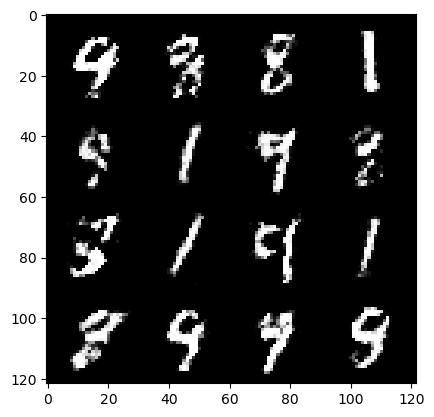

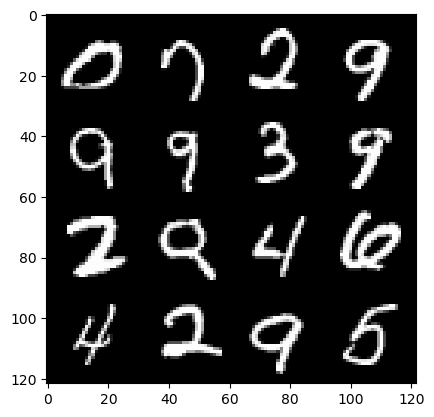

epoch: 244, step: 114900, gen loss: 1.534012629191081, disc loss: 0.3710269251465799.


  0%|          | 0/469 [00:00<?, ?it/s]

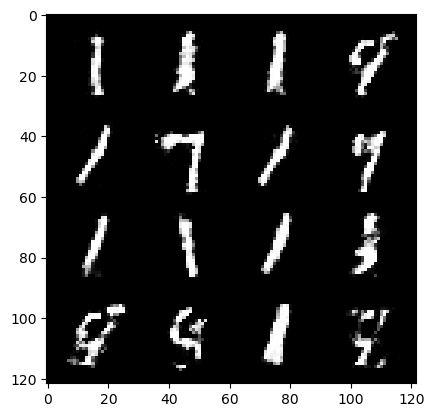

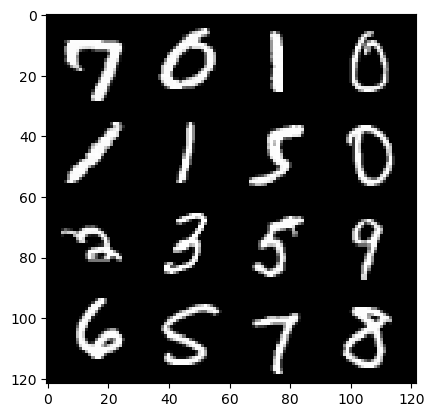

epoch: 245, step: 115200, gen loss: 1.5342952291170762, disc loss: 0.3711787930130958.


  0%|          | 0/469 [00:00<?, ?it/s]

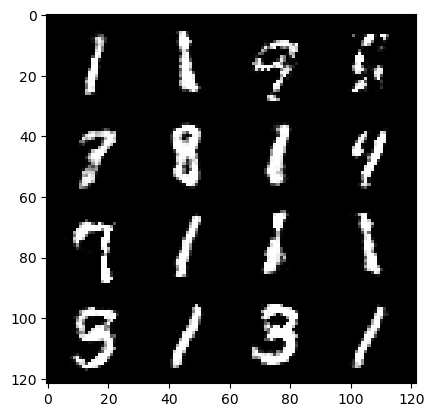

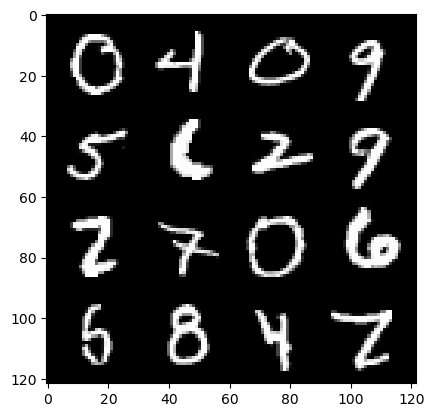

epoch: 246, step: 115500, gen loss: 1.5619143307209, disc loss: 0.3699017454187079.


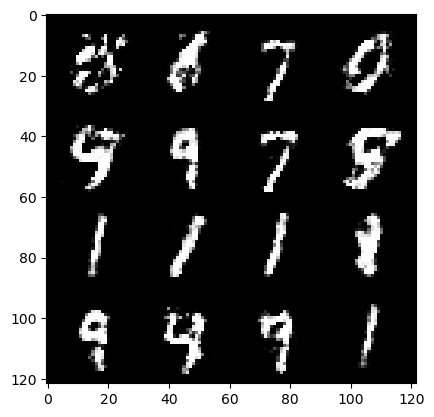

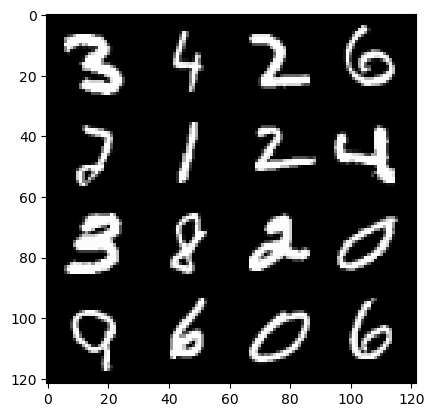

epoch: 246, step: 115800, gen loss: 1.5555522533257804, disc loss: 0.3684657427668577.


  0%|          | 0/469 [00:00<?, ?it/s]

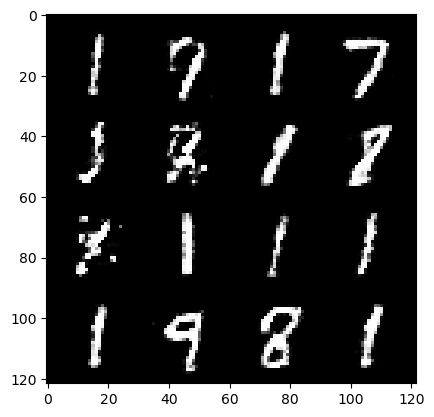

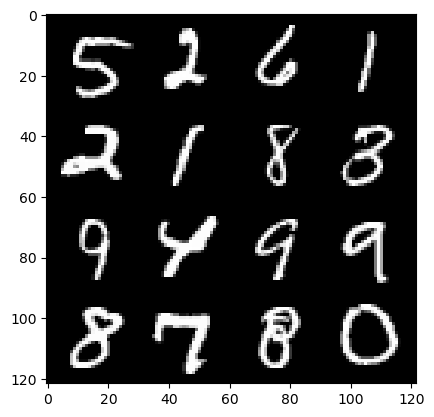

epoch: 247, step: 116100, gen loss: 1.498412383794785, disc loss: 0.3790555181105931.


  0%|          | 0/469 [00:00<?, ?it/s]

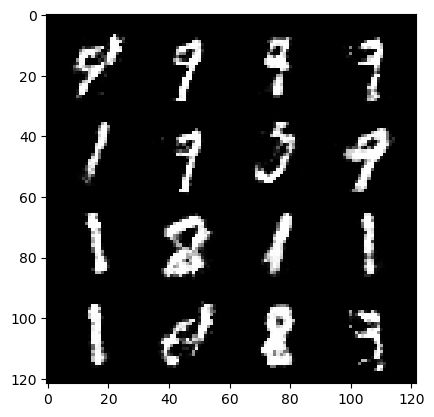

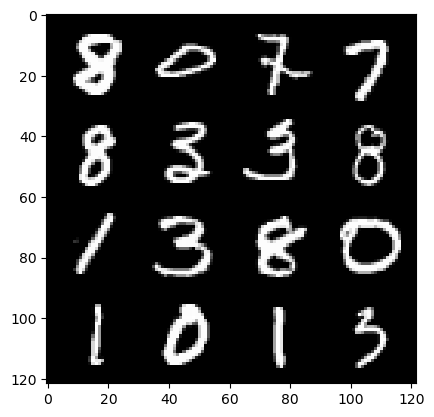

epoch: 248, step: 116400, gen loss: 1.5692920482158645, disc loss: 0.363816779255867.


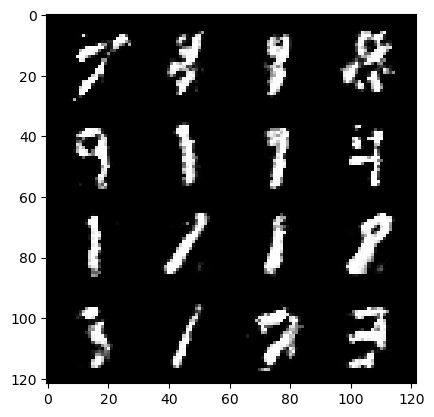

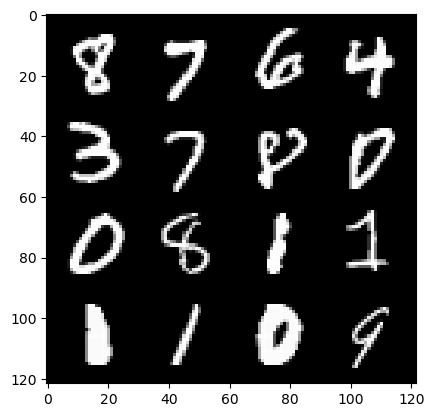

epoch: 248, step: 116700, gen loss: 1.6766660996278122, disc loss: 0.3479002558191617.


  0%|          | 0/469 [00:00<?, ?it/s]

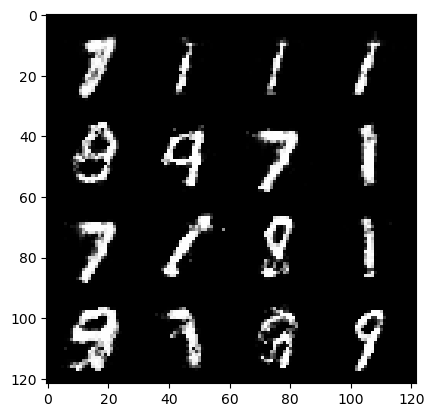

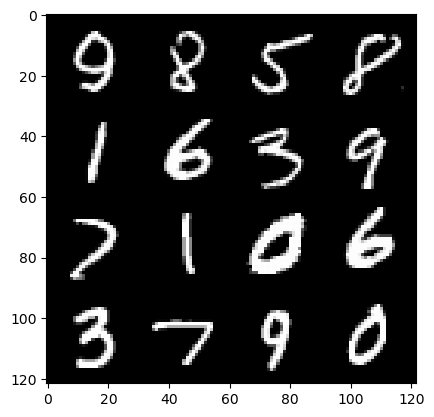

epoch: 249, step: 117000, gen loss: 1.5291150597731271, disc loss: 0.3732040346662203.


  0%|          | 0/469 [00:00<?, ?it/s]

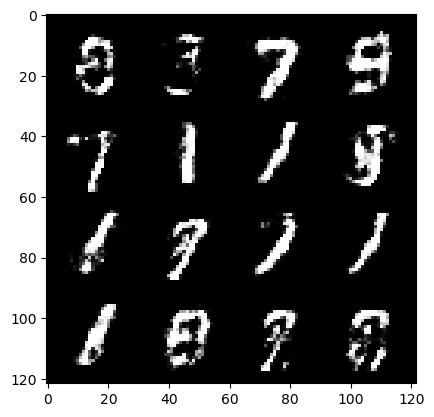

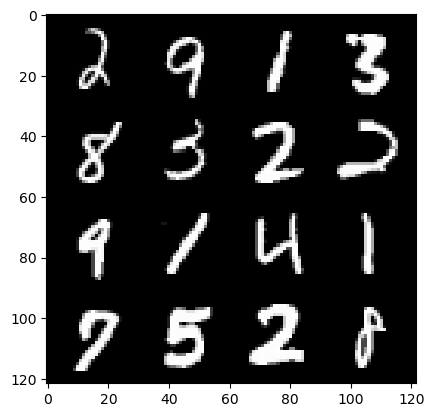

epoch: 250, step: 117300, gen loss: 1.5231218349933633, disc loss: 0.38209433645010016.


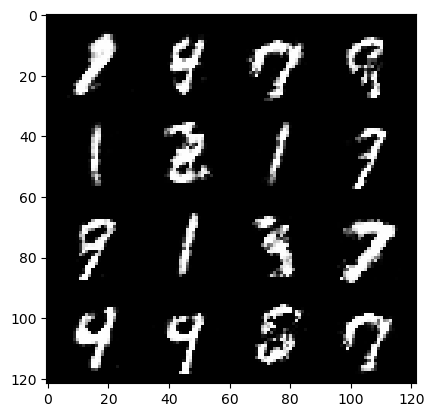

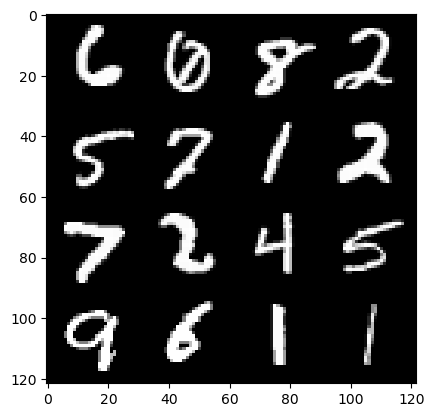

epoch: 250, step: 117600, gen loss: 1.555318364699682, disc loss: 0.3739881616830823.


  0%|          | 0/469 [00:00<?, ?it/s]

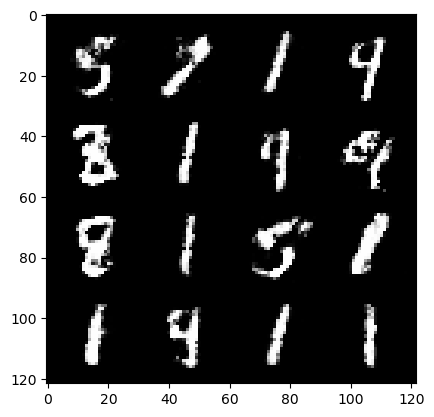

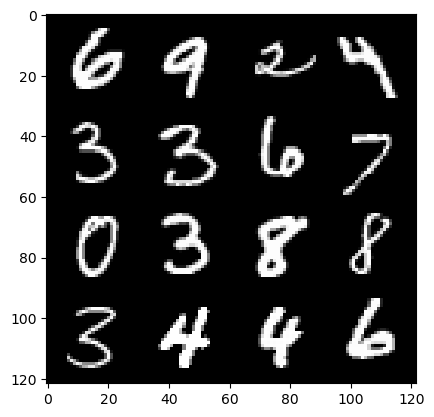

epoch: 251, step: 117900, gen loss: 1.5530828352769215, disc loss: 0.37177028824885683.


  0%|          | 0/469 [00:00<?, ?it/s]

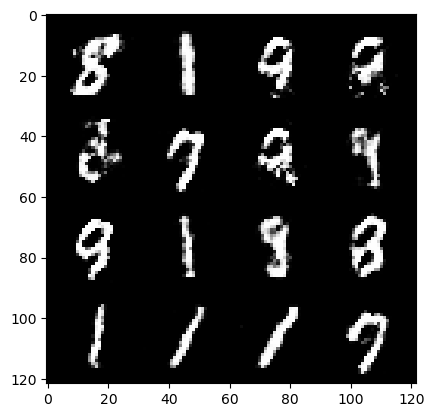

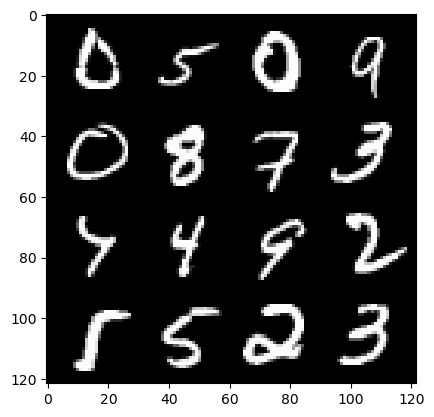

epoch: 252, step: 118200, gen loss: 1.568133008082707, disc loss: 0.364332793056965.


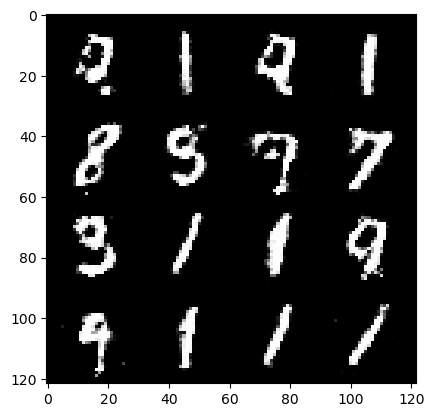

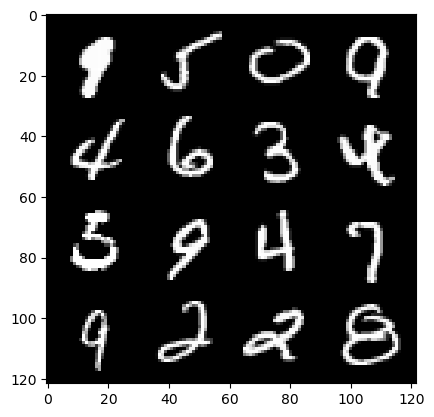

epoch: 252, step: 118500, gen loss: 1.558395303487778, disc loss: 0.3816432864467303.


  0%|          | 0/469 [00:00<?, ?it/s]

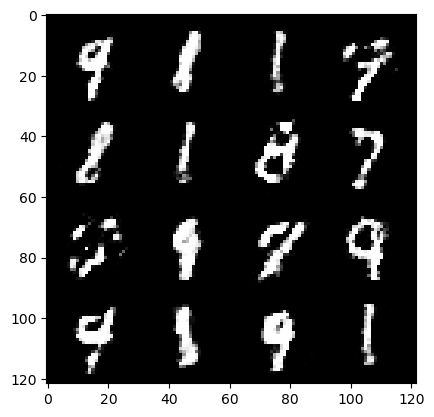

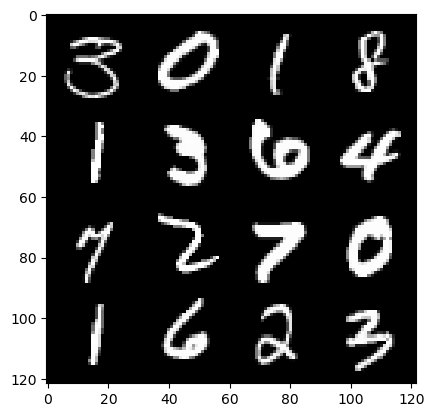

epoch: 253, step: 118800, gen loss: 1.5680140356222791, disc loss: 0.3702020784219106.


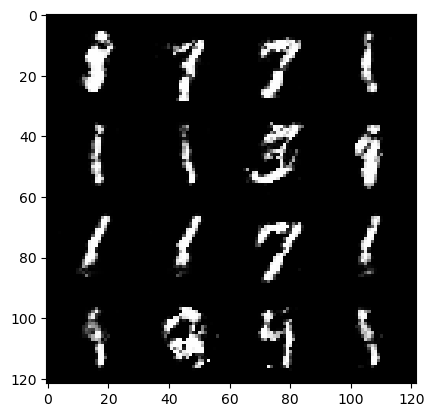

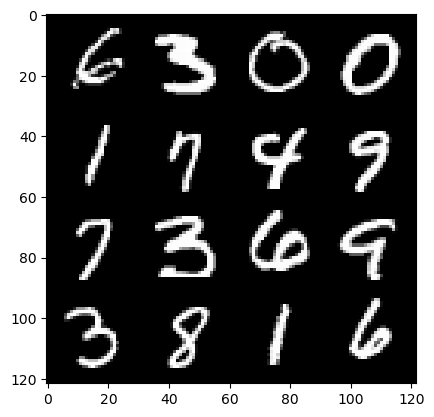

epoch: 253, step: 119100, gen loss: 1.5040510904788968, disc loss: 0.3767482877771061.


  0%|          | 0/469 [00:00<?, ?it/s]

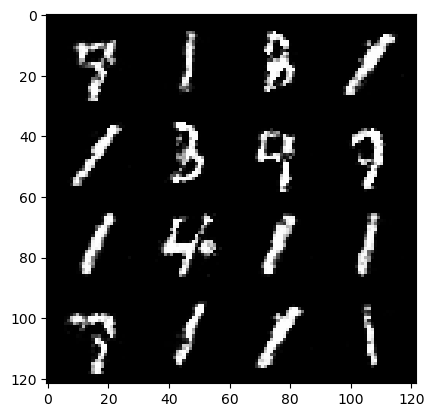

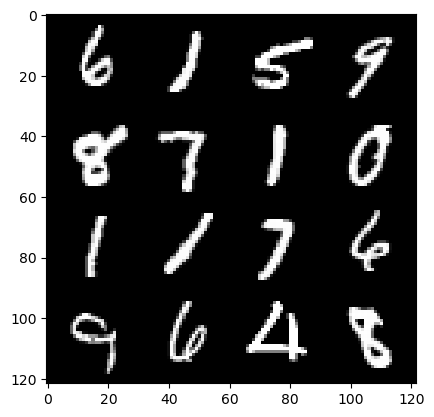

epoch: 254, step: 119400, gen loss: 1.5854641048113498, disc loss: 0.3501979878544806.


  0%|          | 0/469 [00:00<?, ?it/s]

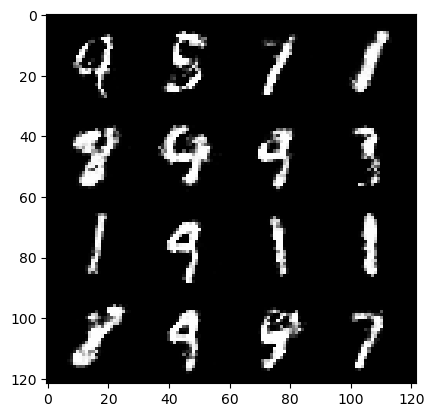

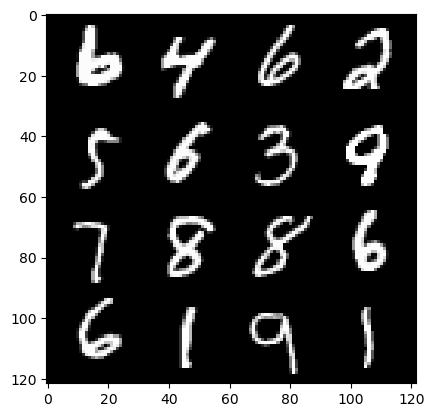

epoch: 255, step: 119700, gen loss: 1.51922198454539, disc loss: 0.381181820432345.


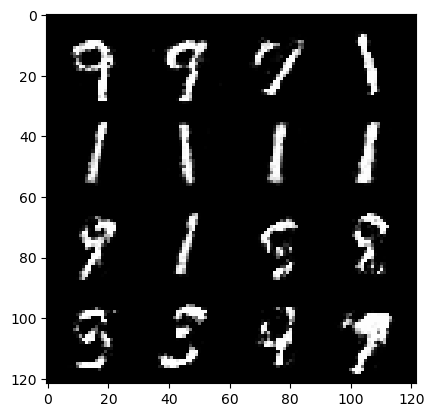

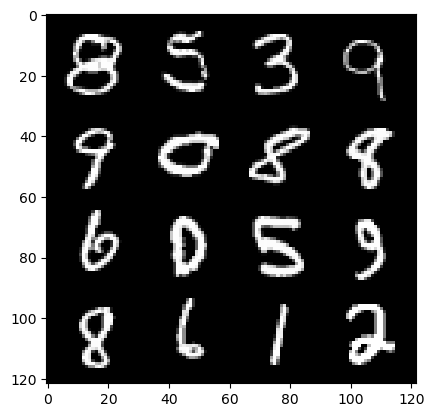

epoch: 255, step: 120000, gen loss: 1.4903103415171302, disc loss: 0.38212315330902763.


  0%|          | 0/469 [00:00<?, ?it/s]

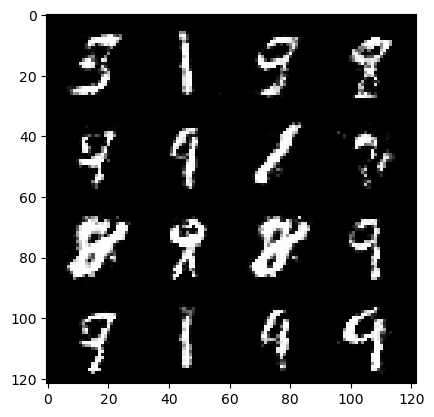

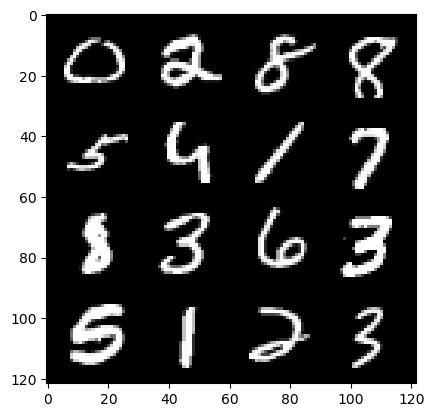

epoch: 256, step: 120300, gen loss: 1.479683080514272, disc loss: 0.38379832684993764.


  0%|          | 0/469 [00:00<?, ?it/s]

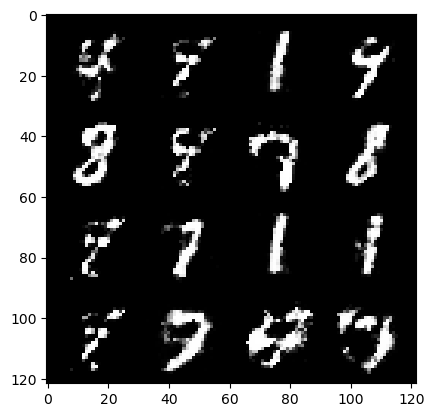

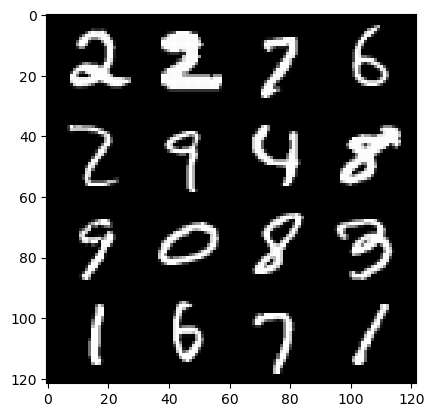

epoch: 257, step: 120600, gen loss: 1.529396734237671, disc loss: 0.37513480871915816.


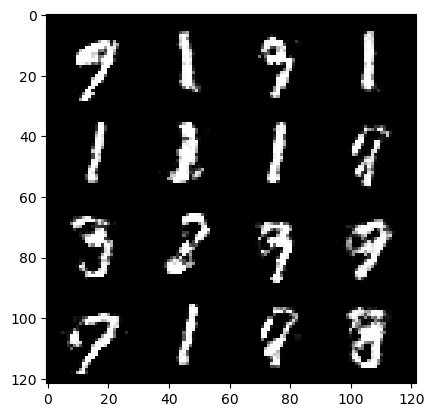

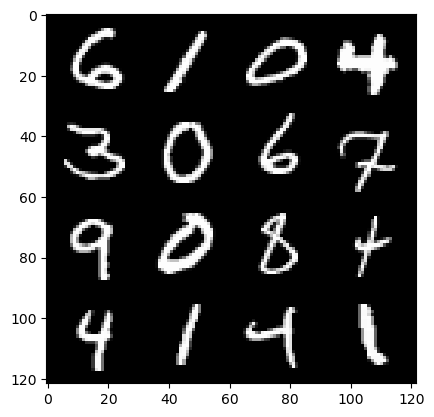

epoch: 257, step: 120900, gen loss: 1.4921320676803587, disc loss: 0.3845101433992385.


  0%|          | 0/469 [00:00<?, ?it/s]

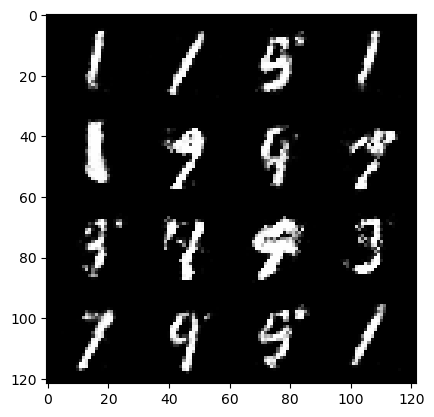

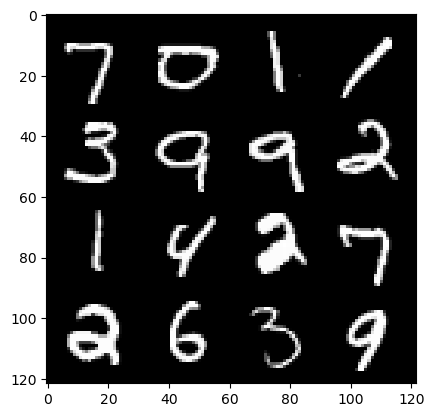

epoch: 258, step: 121200, gen loss: 1.519180331230163, disc loss: 0.3806071078777314.


  0%|          | 0/469 [00:00<?, ?it/s]

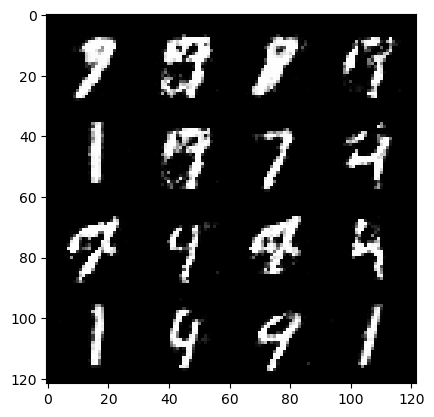

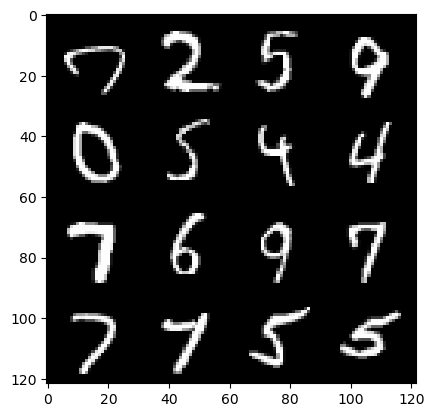

epoch: 259, step: 121500, gen loss: 1.5159094842274994, disc loss: 0.3832672123114268.


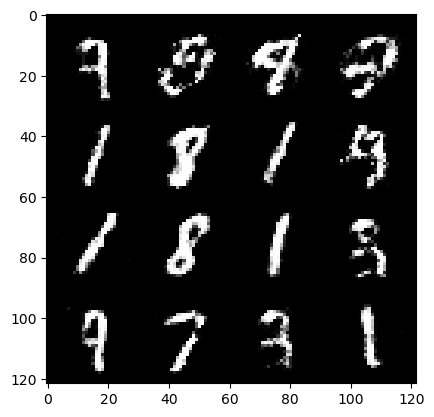

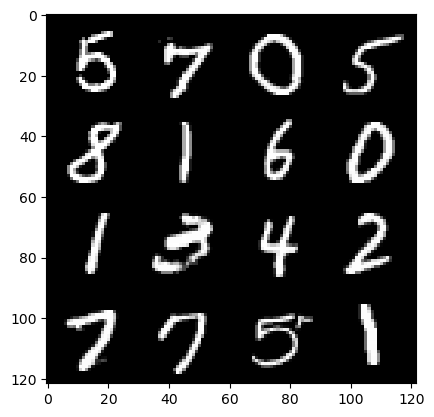

epoch: 259, step: 121800, gen loss: 1.509984877109527, disc loss: 0.3752737297614414.


  0%|          | 0/469 [00:00<?, ?it/s]

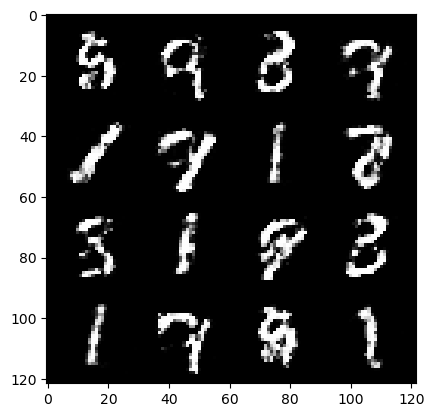

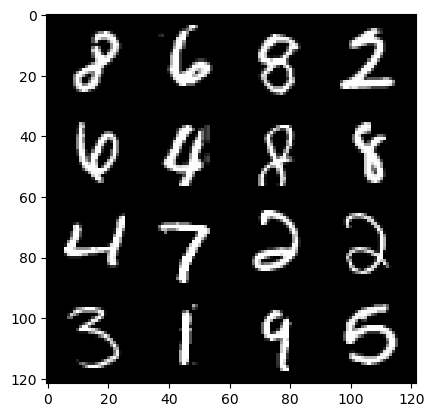

epoch: 260, step: 122100, gen loss: 1.5091031881173453, disc loss: 0.382502746085326.


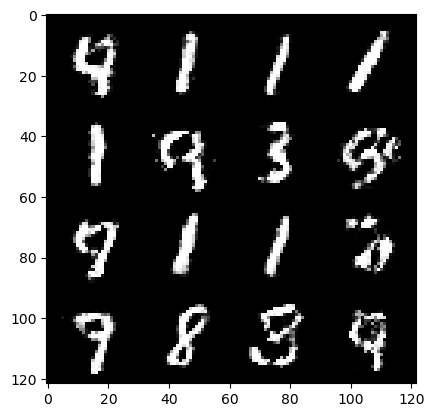

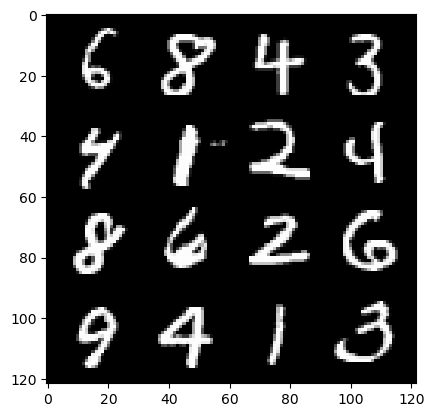

epoch: 260, step: 122400, gen loss: 1.54176573197047, disc loss: 0.37205872406562174.


  0%|          | 0/469 [00:00<?, ?it/s]

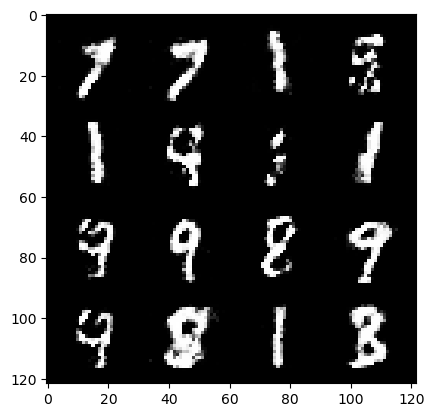

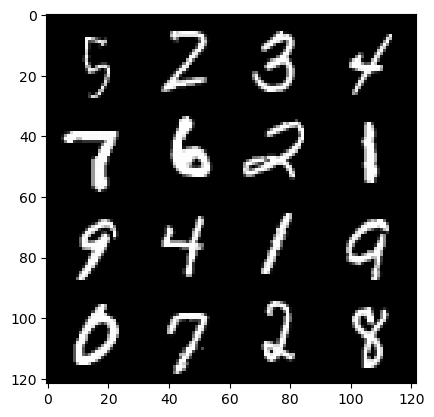

epoch: 261, step: 122700, gen loss: 1.5726753119627648, disc loss: 0.3736012511452039.


  0%|          | 0/469 [00:00<?, ?it/s]

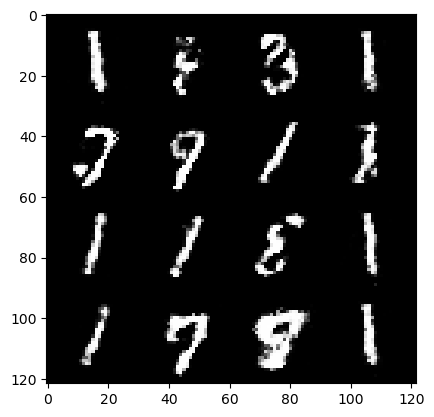

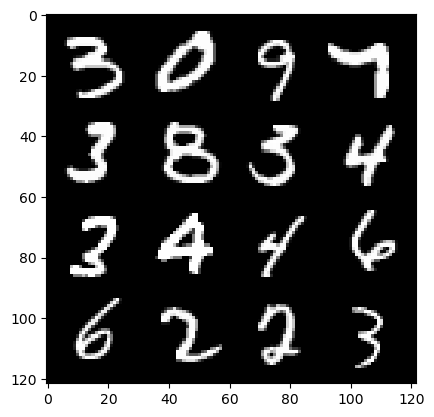

epoch: 262, step: 123000, gen loss: 1.581932075818379, disc loss: 0.3652947162588437.


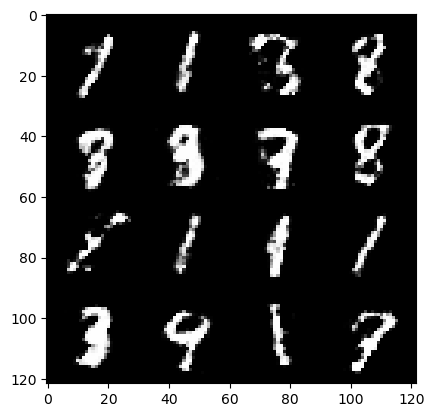

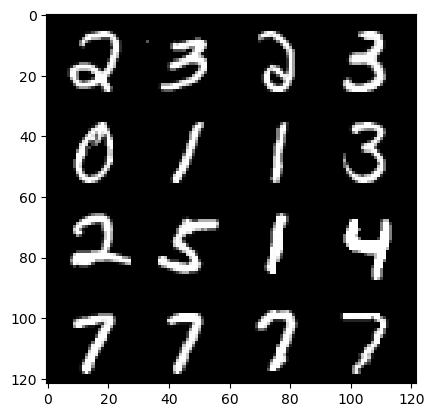

epoch: 262, step: 123300, gen loss: 1.4601242379347479, disc loss: 0.39457870781421633.


  0%|          | 0/469 [00:00<?, ?it/s]

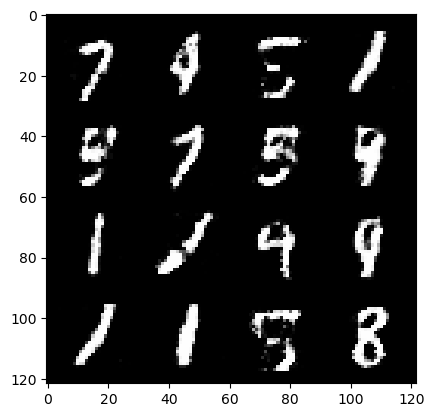

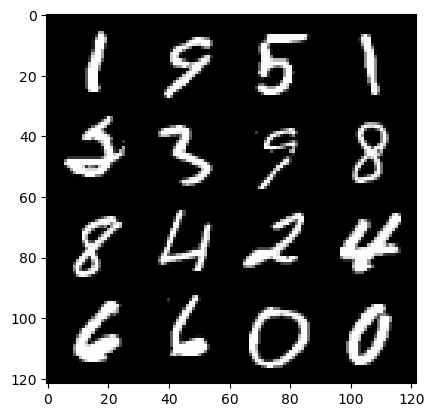

epoch: 263, step: 123600, gen loss: 1.4895342560609182, disc loss: 0.3893085162838302.


  0%|          | 0/469 [00:00<?, ?it/s]

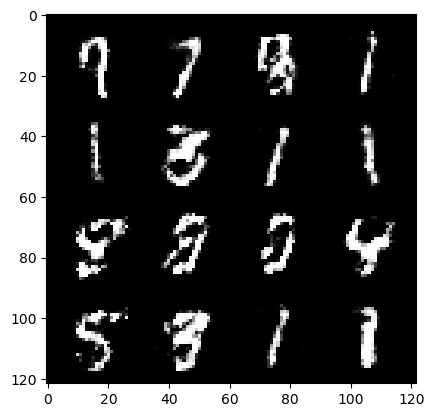

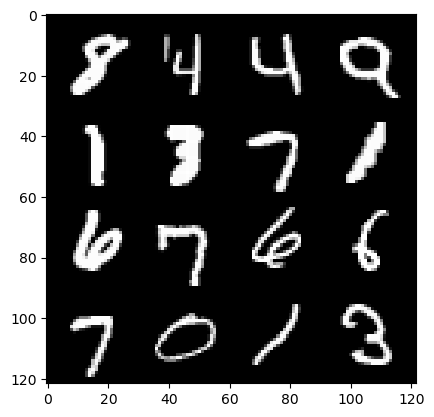

epoch: 264, step: 123900, gen loss: 1.5663281249999998, disc loss: 0.3789924591779709.


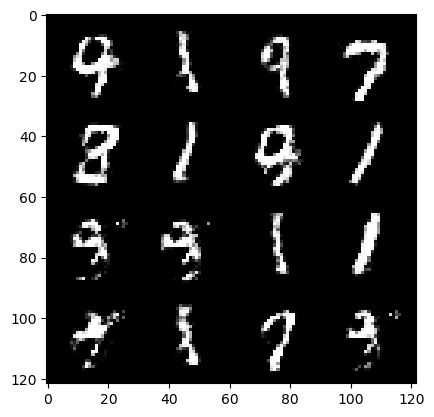

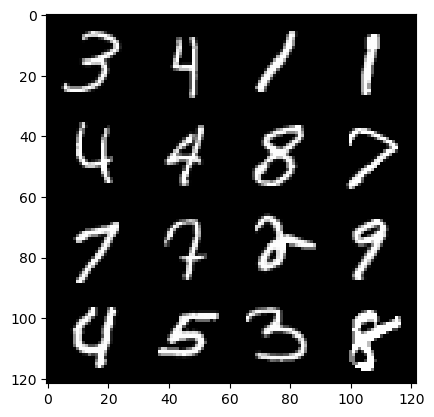

epoch: 264, step: 124200, gen loss: 1.5426115794976554, disc loss: 0.3810049740473427.


  0%|          | 0/469 [00:00<?, ?it/s]

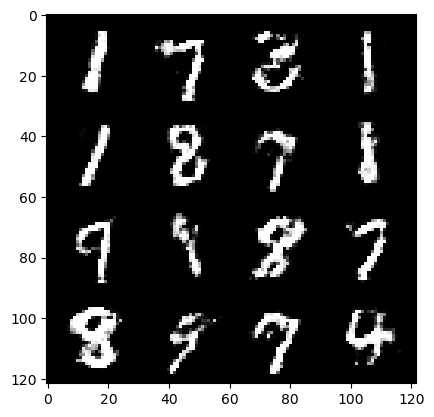

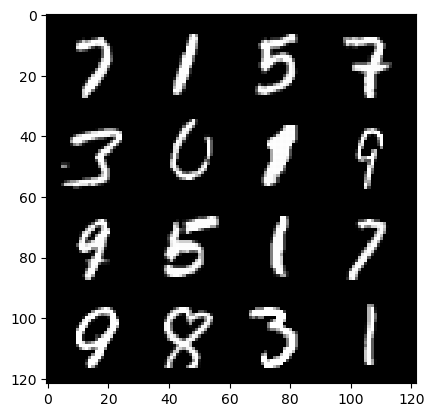

epoch: 265, step: 124500, gen loss: 1.497810469468434, disc loss: 0.3839625280102095.


  0%|          | 0/469 [00:00<?, ?it/s]

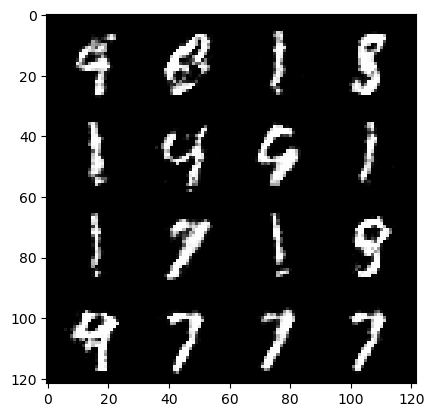

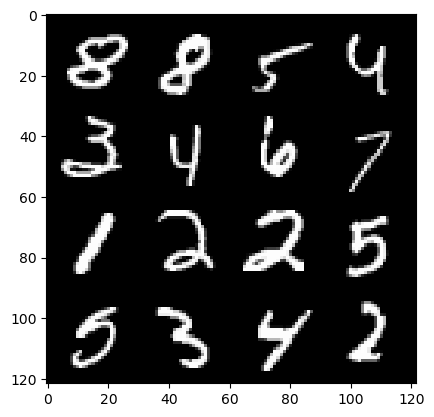

epoch: 266, step: 124800, gen loss: 1.5464385263125102, disc loss: 0.37617321183284125.


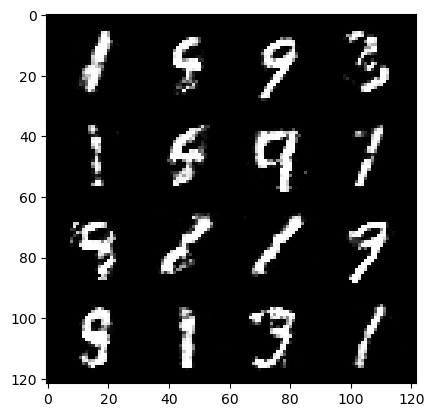

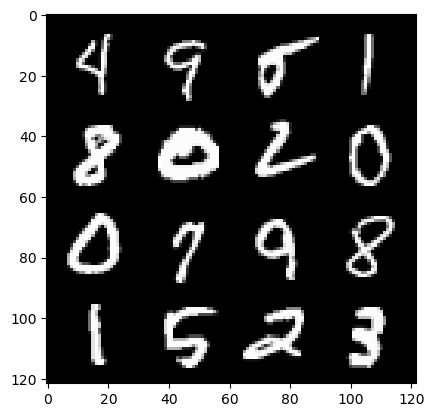

epoch: 266, step: 125100, gen loss: 1.5407554221153257, disc loss: 0.3836781304081283.


  0%|          | 0/469 [00:00<?, ?it/s]

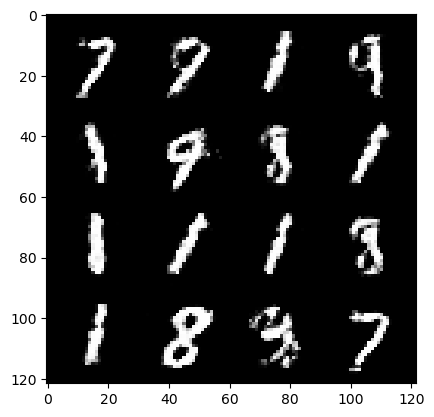

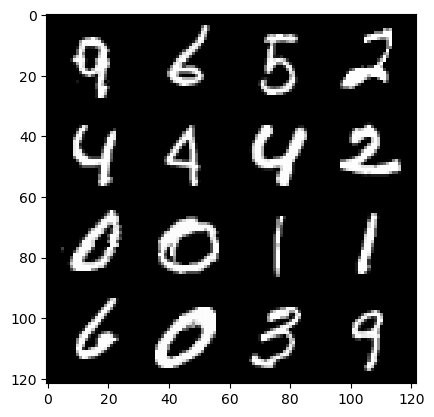

epoch: 267, step: 125400, gen loss: 1.5215475968519843, disc loss: 0.3890423528353373.


  0%|          | 0/469 [00:00<?, ?it/s]

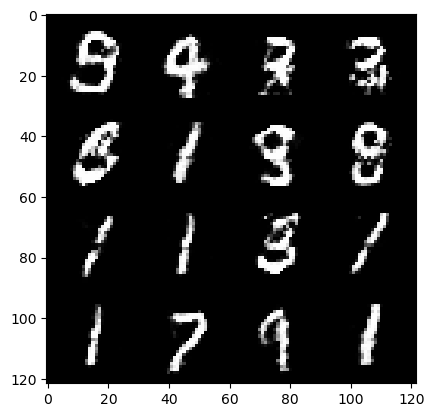

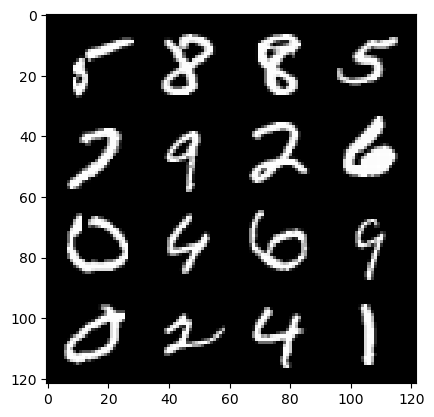

epoch: 268, step: 125700, gen loss: 1.531829229990641, disc loss: 0.3849988651275634.


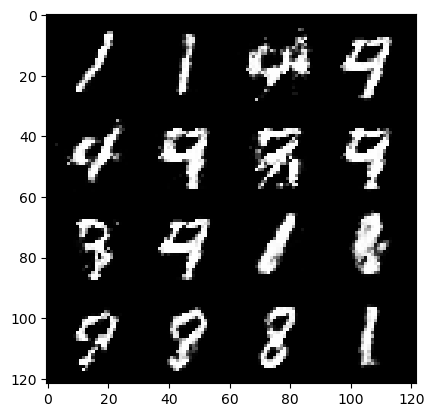

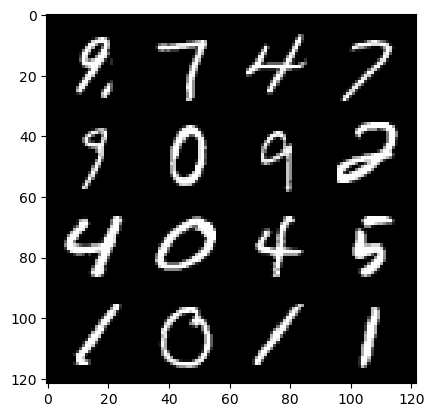

epoch: 268, step: 126000, gen loss: 1.4592657474676773, disc loss: 0.3994678257902461.


  0%|          | 0/469 [00:00<?, ?it/s]

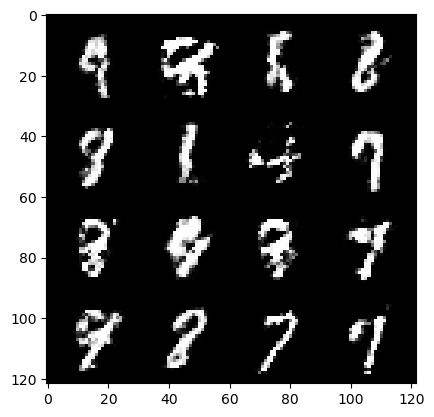

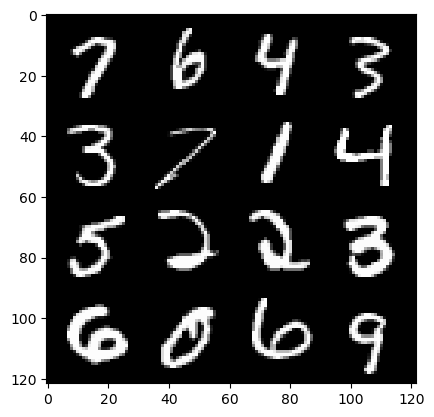

epoch: 269, step: 126300, gen loss: 1.4897262458006528, disc loss: 0.38037998249133437.


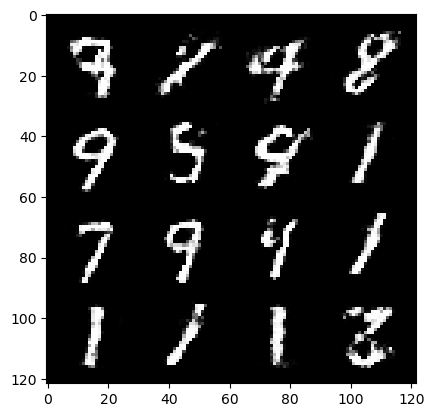

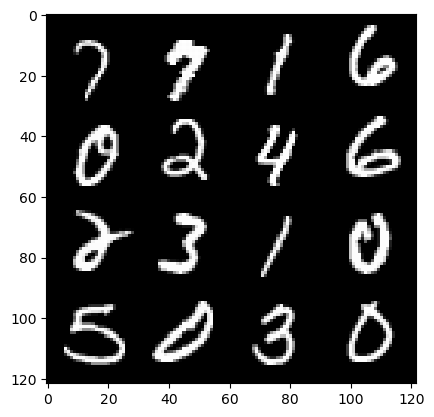

epoch: 269, step: 126600, gen loss: 1.5643911961714425, disc loss: 0.36715648750464136.


  0%|          | 0/469 [00:00<?, ?it/s]

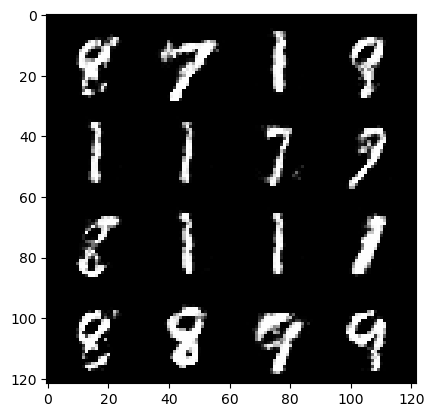

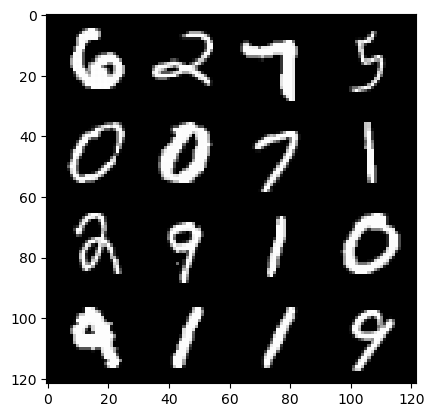

epoch: 270, step: 126900, gen loss: 1.5346748709678655, disc loss: 0.3746857342123983.


  0%|          | 0/469 [00:00<?, ?it/s]

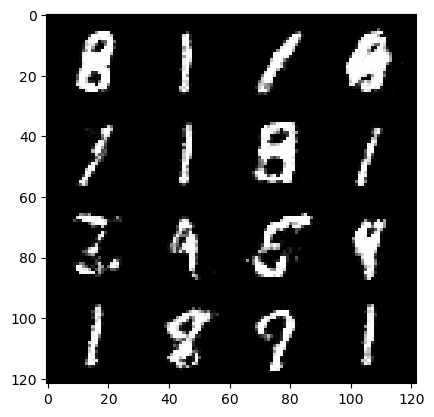

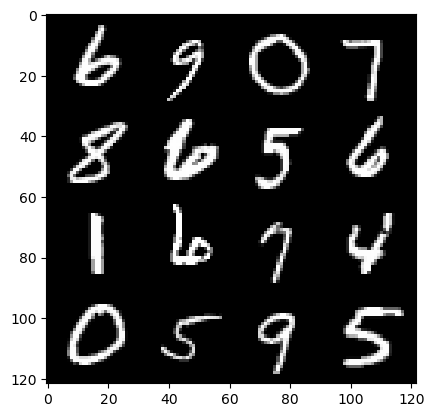

epoch: 271, step: 127200, gen loss: 1.5730717714627585, disc loss: 0.3624459835886954.


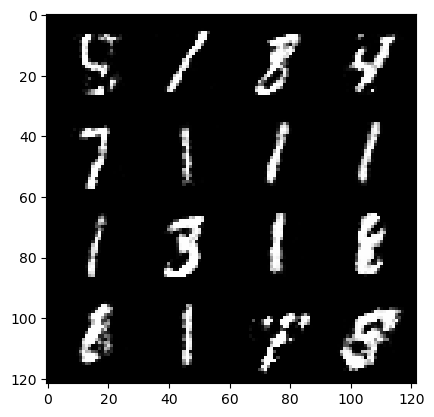

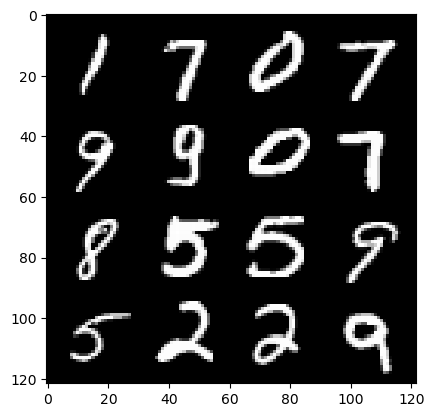

epoch: 271, step: 127500, gen loss: 1.5961460669835403, disc loss: 0.3654259222745897.


  0%|          | 0/469 [00:00<?, ?it/s]

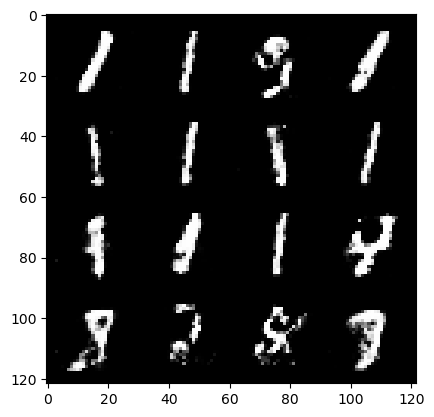

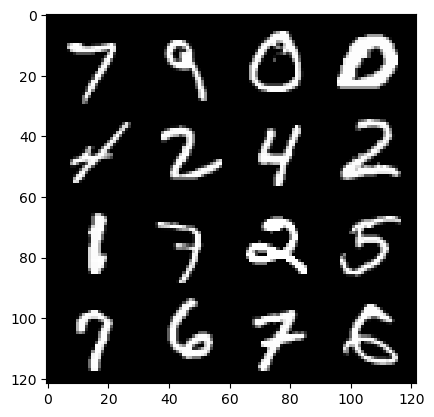

epoch: 272, step: 127800, gen loss: 1.5083233928680422, disc loss: 0.3800862925251321.


  0%|          | 0/469 [00:00<?, ?it/s]

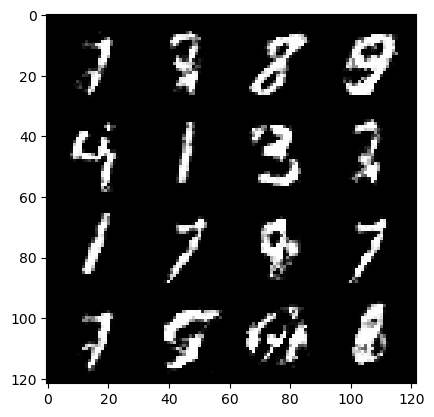

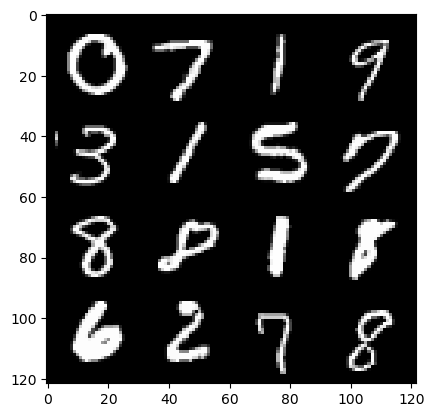

epoch: 273, step: 128100, gen loss: 1.563720107078553, disc loss: 0.3823676982522011.


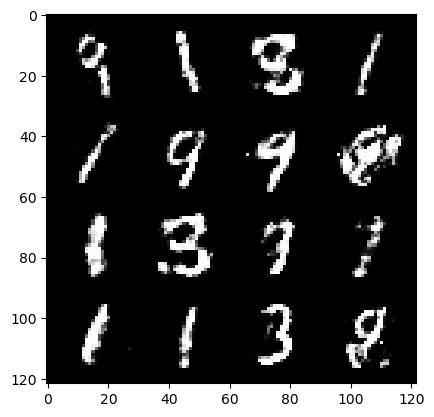

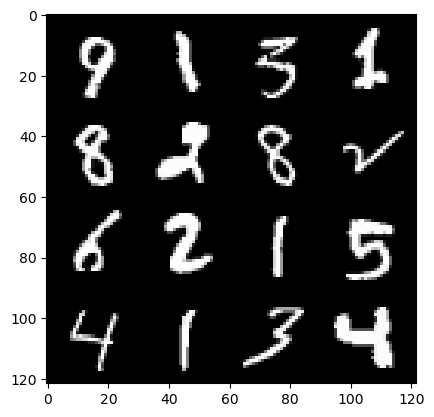

epoch: 273, step: 128400, gen loss: 1.4908005873362218, disc loss: 0.39176123450199785.


  0%|          | 0/469 [00:00<?, ?it/s]

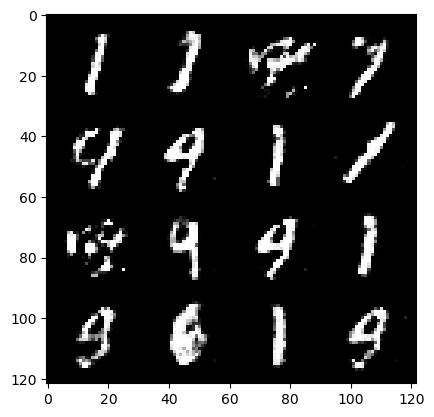

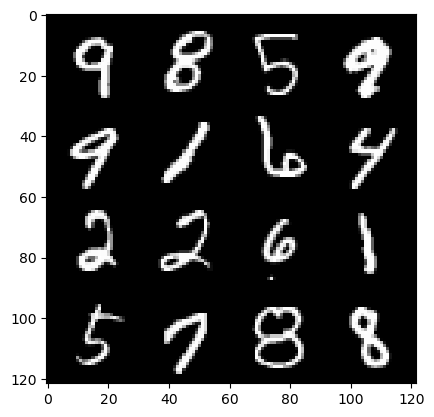

epoch: 274, step: 128700, gen loss: 1.4739593056837716, disc loss: 0.3929603680968284.


  0%|          | 0/469 [00:00<?, ?it/s]

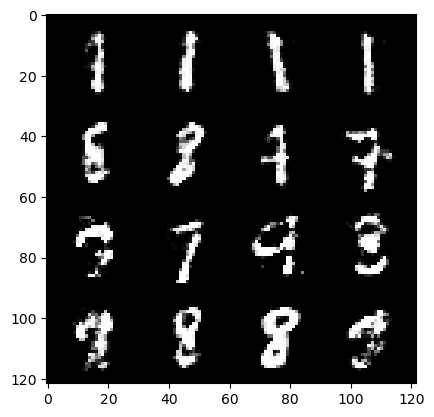

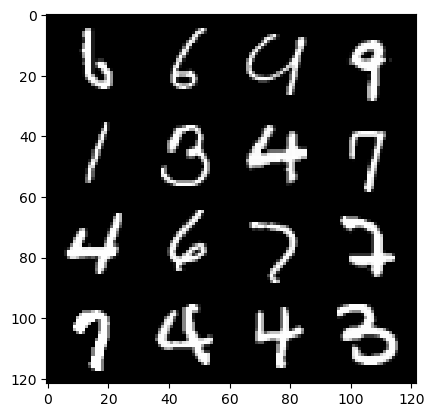

epoch: 275, step: 129000, gen loss: 1.4872073713938394, disc loss: 0.39047532339890834.


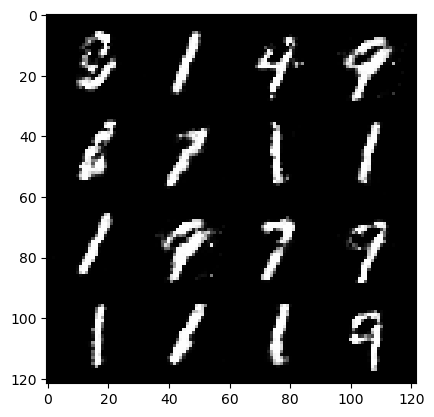

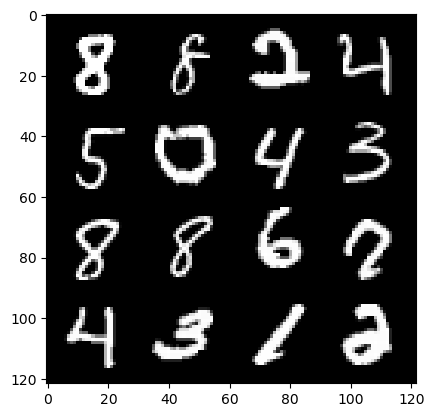

epoch: 275, step: 129300, gen loss: 1.4758978927135464, disc loss: 0.39630578577518466.


  0%|          | 0/469 [00:00<?, ?it/s]

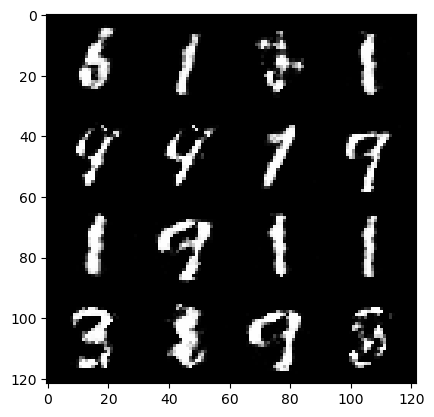

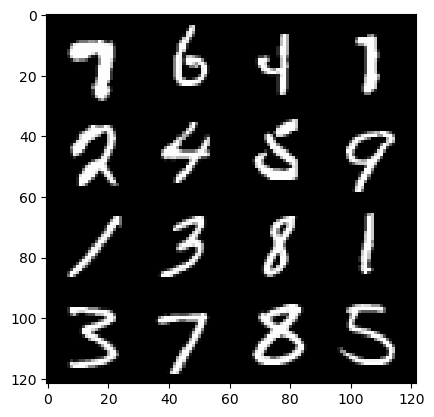

epoch: 276, step: 129600, gen loss: 1.478758175373078, disc loss: 0.4076298612356185.


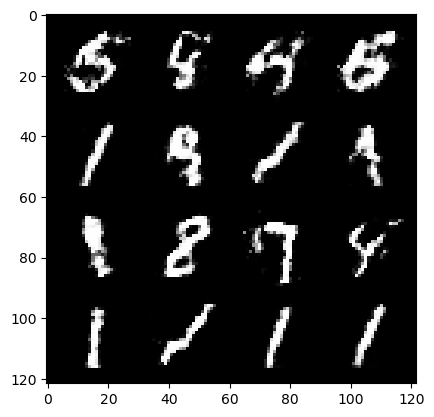

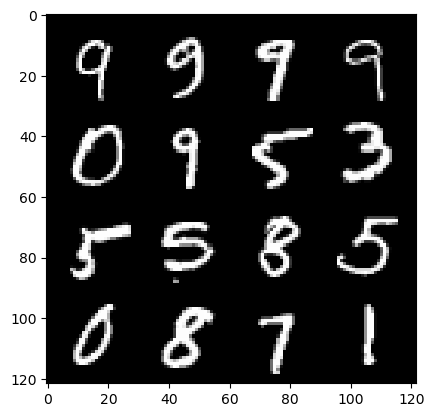

epoch: 276, step: 129900, gen loss: 1.4883974595864606, disc loss: 0.39728635430336023.


  0%|          | 0/469 [00:00<?, ?it/s]

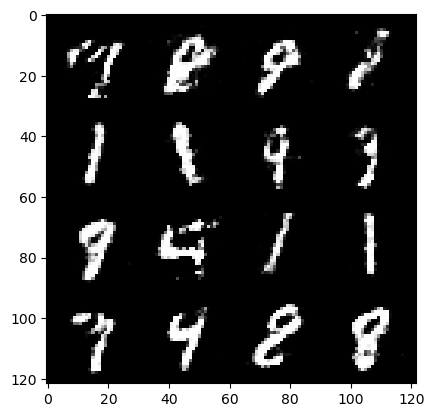

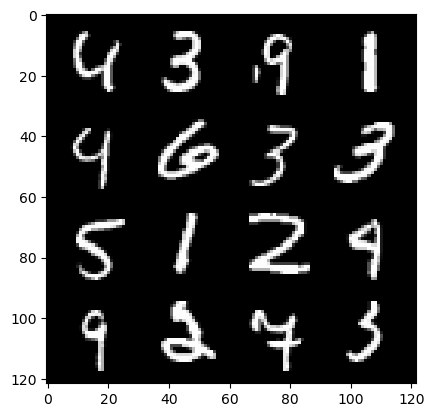

epoch: 277, step: 130200, gen loss: 1.519678070147832, disc loss: 0.3762299049894016.


  0%|          | 0/469 [00:00<?, ?it/s]

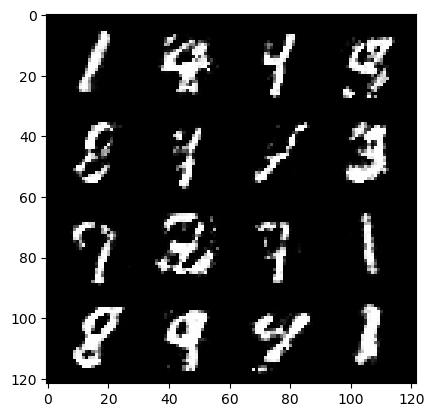

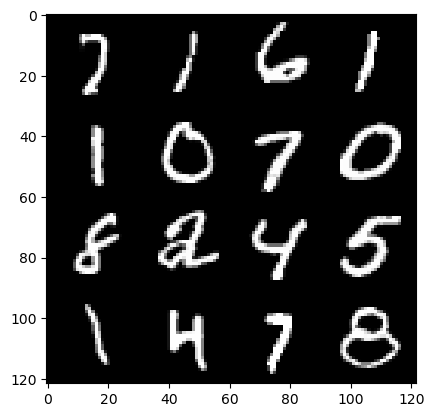

epoch: 278, step: 130500, gen loss: 1.500694695313773, disc loss: 0.38394920478264494.


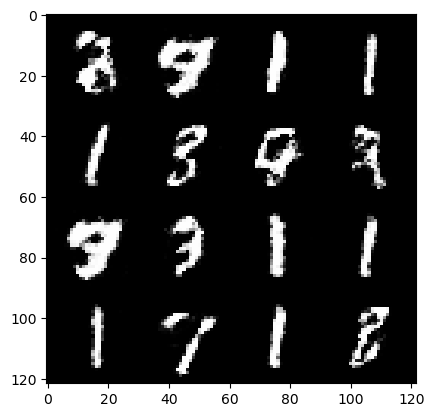

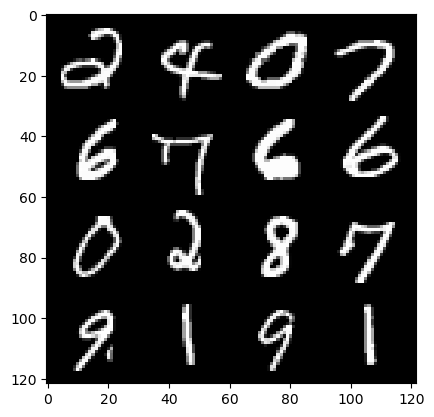

epoch: 278, step: 130800, gen loss: 1.4783758346239722, disc loss: 0.3946488625804583.


  0%|          | 0/469 [00:00<?, ?it/s]

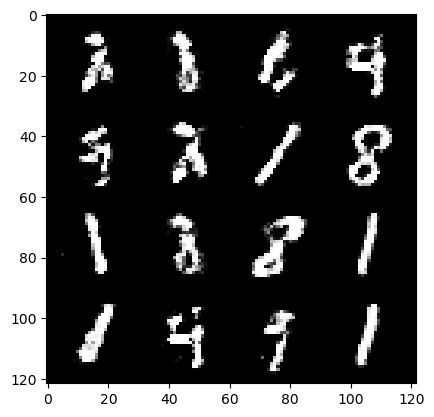

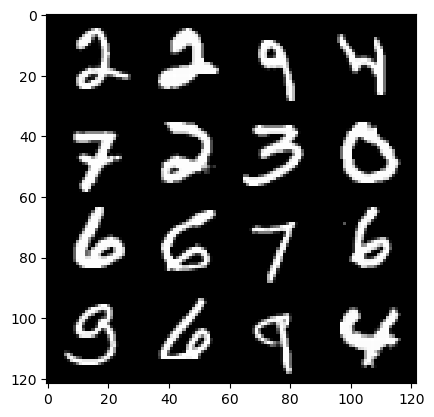

epoch: 279, step: 131100, gen loss: 1.5618465308348328, disc loss: 0.37209728668133435.


  0%|          | 0/469 [00:00<?, ?it/s]

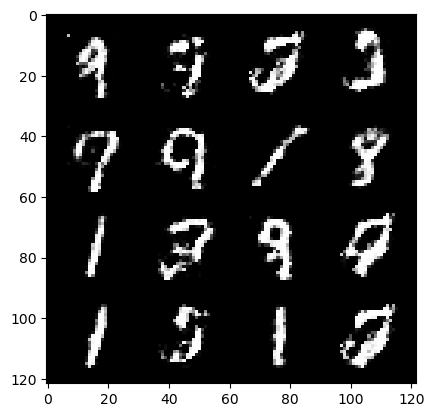

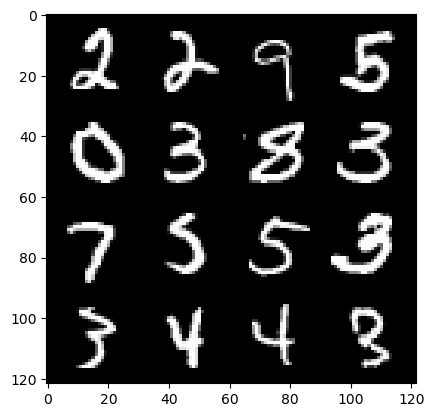

epoch: 280, step: 131400, gen loss: 1.5162936409314474, disc loss: 0.37660000383853903.


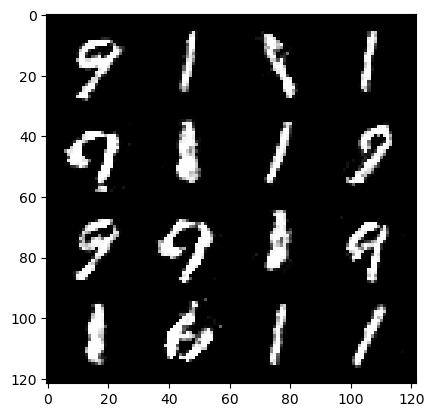

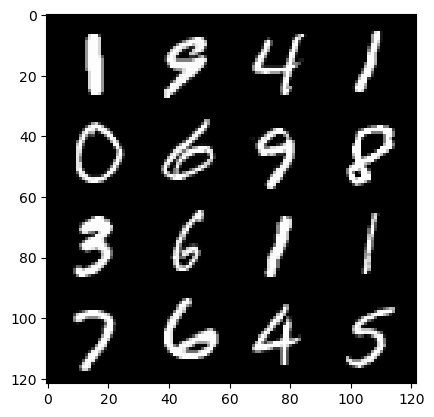

epoch: 280, step: 131700, gen loss: 1.543388563394546, disc loss: 0.36651951670646676.


  0%|          | 0/469 [00:00<?, ?it/s]

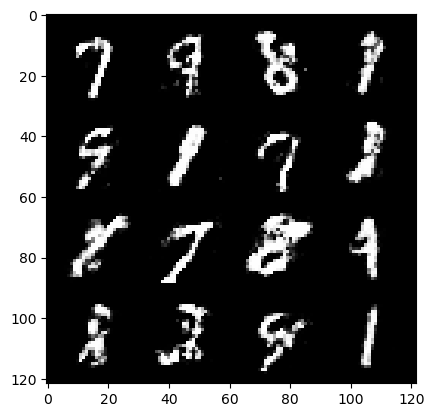

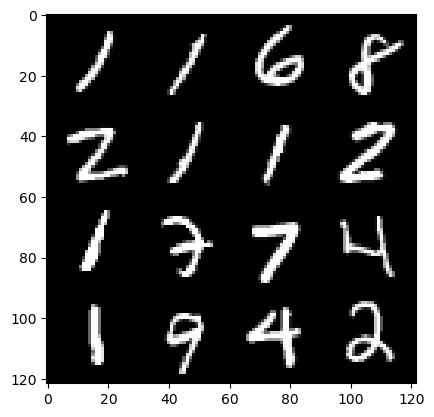

epoch: 281, step: 132000, gen loss: 1.4649235486984251, disc loss: 0.3917897312839826.


  0%|          | 0/469 [00:00<?, ?it/s]

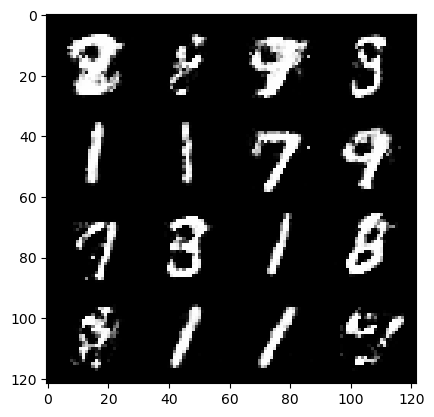

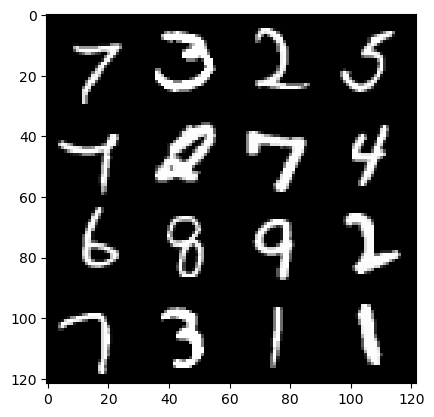

epoch: 282, step: 132300, gen loss: 1.4962803538640344, disc loss: 0.3844223426779109.


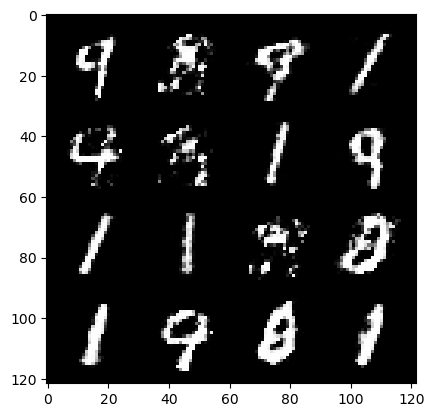

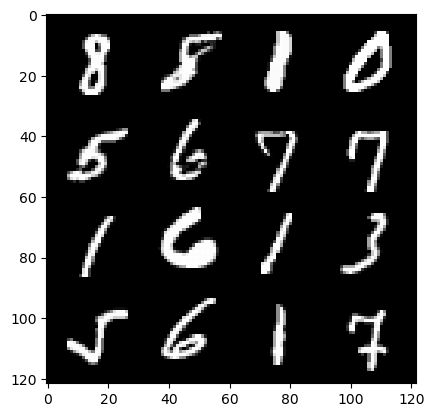

epoch: 282, step: 132600, gen loss: 1.4717337091763816, disc loss: 0.38562857737143835.


  0%|          | 0/469 [00:00<?, ?it/s]

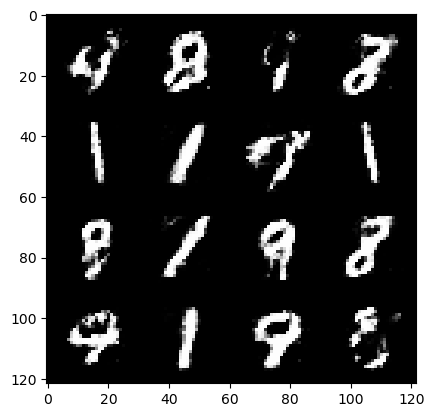

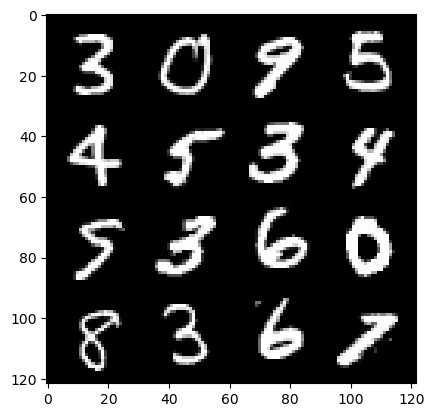

epoch: 283, step: 132900, gen loss: 1.5258466450373331, disc loss: 0.3708087929089864.


  0%|          | 0/469 [00:00<?, ?it/s]

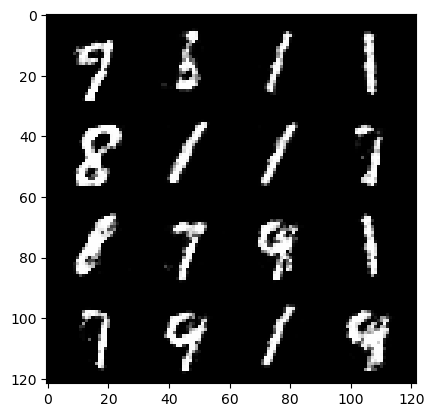

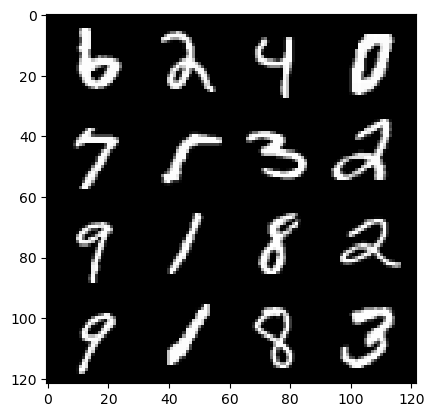

epoch: 284, step: 133200, gen loss: 1.5265080094337462, disc loss: 0.38082791010538747.


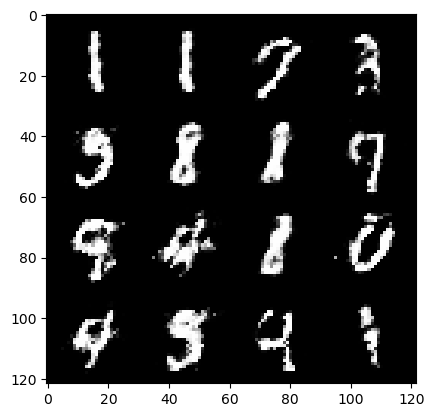

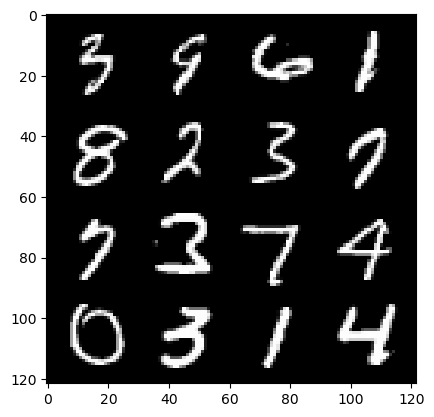

epoch: 284, step: 133500, gen loss: 1.4815753308931978, disc loss: 0.40310295373201394.


  0%|          | 0/469 [00:00<?, ?it/s]

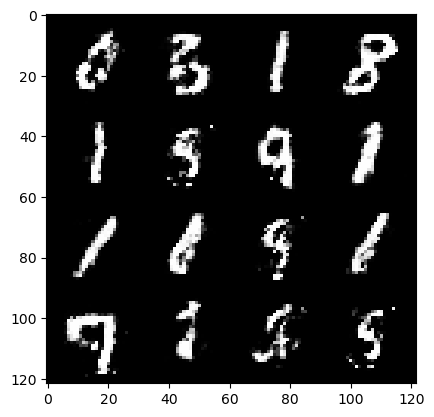

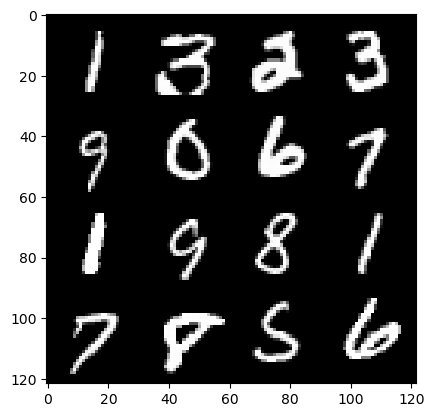

epoch: 285, step: 133800, gen loss: 1.459596385558446, disc loss: 0.4061566249529522.


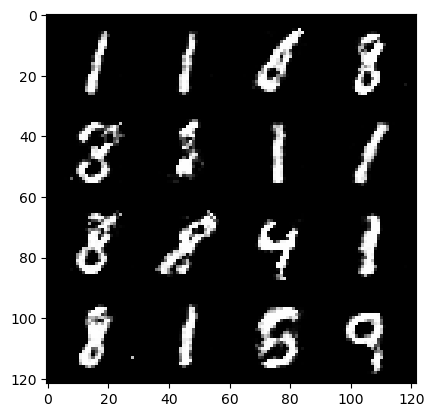

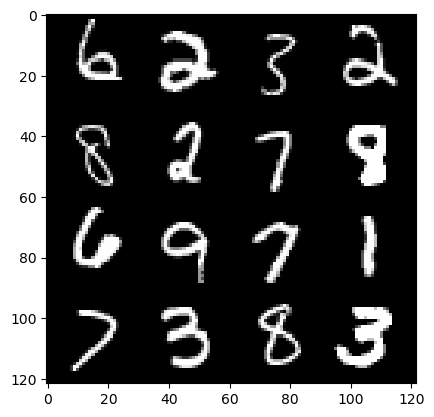

epoch: 285, step: 134100, gen loss: 1.4634841422239937, disc loss: 0.40277454127868023.


  0%|          | 0/469 [00:00<?, ?it/s]

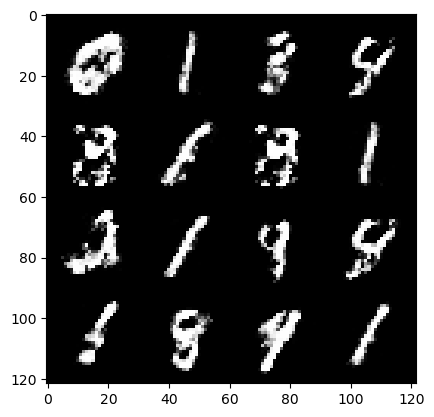

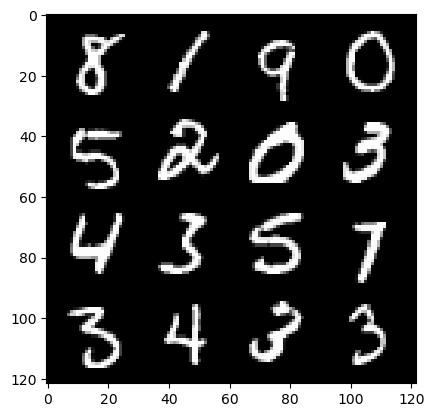

epoch: 286, step: 134400, gen loss: 1.511660868724187, disc loss: 0.3815447919567424.


  0%|          | 0/469 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [79]:
for epoch in range(epochs):
    for real, _ in tqdm(data_loader):
        # Discriminator
        disc_opt.zero_grad()
        cur_bs = len(real) # real: 128 x 1 x 28 x 28
        real = real.view(cur_bs, -1) # 128 x 784
        real = real.to(device)
        disc_loss = clac_disc_loss(loss_func, gen, disc, cur_bs, real, z_dim)
        disc_loss.backward(retain_graph=True)
        disc_opt.step()

        # Generator
        gen_opt.zero_grad()
        gen_loss = calc_gen_loss(loss_func, gen, disc, cur_bs, z_dim)
        gen_loss.backward(retain_graph=True)
        gen_opt.step()

        # Visualization & Stats
        mean_disc_loss += disc_loss.item() / info_step
        mean_gen_loss += gen_loss.item() / info_step

        if cur_step % info_step == 0 and cur_step > 0:
            fake_noise = genNoise(cur_bs, z_dim)
            fake = gen(fake_noise)
            show(fake)
            show(real)
            print(f"epoch: {epoch}, step: {cur_step}, gen loss: {mean_gen_loss}, disc loss: {mean_disc_loss}.")
            mean_disc_loss = 0
            mean_gen_loss = 0

        cur_step += 1